In [ ]:
import torch
import numpy as np
from matplotlib import pyplot as plt
import pandas as pd
import os

In [ ]:
TEST_SPLIT = 0.1
VAL_SPLIT = 0.1
BATCH_SIZE = 16
NUM_BLOCKS=9
HIDDEN_CHANNELS = 120
LEARNING_RATE = 0.001
# attention = 'soft_attention_NEW'
attention = 'No'
USE_ATTENTION = False
data_augmentation = True
WEIGHT_DECAY = 0.005
LR_PATIENCE = 5
LR_DROP_FACTOR = 0.1

In [ ]:
# Mount Google Drive
from google.colab import drive
import os

drive.mount('/content/gdrive')
# Define base folder path
base_path = '/content/gdrive/MyDrive/yoga_proj'
!ls /content/gdrive/MyDrive/yoga_proj
# base_path = '../'

In [ ]:
import os
from datetime import datetime
today = datetime.today().strftime('%Y-%m-%d')
nbase_path = '/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/'
SAVE_PATH = os.path.join(
    nbase_path,
    f'LOSS_FIXED_{today}_B{NUM_BLOCKS}_HC{HIDDEN_CHANNELS}_LR{LEARNING_RATE}_WD{WEIGHT_DECAY}_DA{data_augmentation}_VS{VAL_SPLIT}'
)
os.makedirs(SAVE_PATH, exist_ok=True)

# Create checkpoint path
FOLD_CHECKPOINT_PATH = os.path.join(SAVE_PATH, 'FOLD_CHECKPOINT')
os.makedirs(FOLD_CHECKPOINT_PATH, exist_ok=True)

# Save hyperparameters to a file
hyperparams_path = os.path.join(SAVE_PATH, 'hyperparameters.txt')
with open(hyperparams_path, 'w') as f:
    f.write(f"TEST_SPLIT: {TEST_SPLIT}\n")
    f.write(f"VAL_SPLIT: {VAL_SPLIT}\n")
    f.write(f"BATCH_SIZE: {BATCH_SIZE}\n")
    f.write(f"NUM_BLOCKS: {NUM_BLOCKS}\n")
    f.write(f"HIDDEN_CHANNELS: {HIDDEN_CHANNELS}\n")
    f.write(f"LEARNING_RATE: {LEARNING_RATE}\n")
    f.write(f"ATTENTION: {attention}\n")
    f.write(f"USE_ATTENTION: {USE_ATTENTION}\n")
    f.write(f"DATA_AUGMENTATION: {data_augmentation}\n")
    f.write(f"WEIGHT_DECAY: {WEIGHT_DECAY}\n")
    f.write(f"LR_PATIENCE: {LR_PATIENCE}\n")
    f.write(f"LR_DROP_FACTOR: {LR_DROP_FACTOR}\n")

print(f"Hyperparameters saved at: {hyperparams_path}")
print(f"Model save path: {SAVE_PATH}")

In [ ]:


# Gets label
csv_path = os.path.join(base_path,'data/3DYoga90_corrected.csv')

print(SAVE_PATH)

pose_list = ['downward-dog','standing-forward-bend','half-way-lift',
             'mountain','chair','cobra','cockerel','extended-triangle',
             'extended-side-angle','corpse','staff','wind-relieving','fish'
            ]
NUM_CLASSES = len(pose_list)

dataset_dir = os.path.join(base_path, 'official_dataset')
assert os.path.isdir(dataset_dir), f"Directory '{dataset_dir}' does not exist."


In [ ]:
print(torch.__version__)
device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [ ]:
meta_info_path = os.path.join(base_path, 'data')
pose_index = pd.read_csv(f'{meta_info_path}/pose-index.csv')
sequence_index = pd.read_csv(f'{meta_info_path}/3DYoga90_corrected.csv')

What does each file tell?

1.) pose-index.csv -> Shows Heirarchical organization (THEN NOTHING MORE)

2.) 3DYoga90.csv -> Total Main Info(i.e. along with RGB stream){
    SequneceID: Parquet_FILE_NAME,
    URL,
    Frame Start and Frame Stop,
    Pose Name, Training Test Split
} `Difference between train and test? where to get the validation set from? How to do data augmentation?

3.) Parquet Files -> {
    Frame Number {
        33 Landmarks
    },
    row-id: FrameNumber-TYPE-Landmark_index,
    Coordinates: {x, y, z}
}

`PLEASE NOTE: The landmark coordinates are all normalized`

# Getting the data ready

In [ ]:
subset_of_poses = pose_list

In [ ]:
# Keep only relevant columns
def read_meta_data():
    meta_info_path = os.path.join(base_path, 'data')
    pose_index = pd.read_csv(f'{meta_info_path}/pose-index.csv')
    sequence_index = pd.read_csv(f'{meta_info_path}/3DYoga90_corrected.csv')
    parquet_index = sequence_index[['sequence_id', 'l3_pose', 'split']]
    return parquet_index

In [ ]:
import torch
import torch.nn.functional as F
import numpy as np

def AddGaussianNoise(data, mean=0., std=0.01):
    noise = torch.randn_like(data) * std + mean
    return data + noise

def RandomRotate(data, max_angle=30):
    angle = torch.rand(1) * 2 * max_angle - max_angle  # Range: [-max_angle, max_angle] in degrees
    angle_rad = torch.deg2rad(angle)
    cos_theta = torch.cos(angle_rad)
    sin_theta = torch.sin(angle_rad)

    rotation_matrix = torch.tensor([
        [cos_theta, 0, sin_theta],
        [0, 1, 0],
        [-sin_theta, 0, cos_theta]
    ]).squeeze()

    # print(data.shape)
    # print(rotation_matrix.shape)
    # data = torch.matmul(rotation_matrix, data)
    data = torch.einsum('ij, jkl -> ikl', rotation_matrix, data)
    return data

def RandomScale(data, scale_range=(0.9, 1.1)):
    scale =  scale_range[0] + torch.rand(1) * (scale_range[1] - scale_range[0]) # 0.9 + 0.2 * percentage
    return data * scale

def RandomTranslate(data, max_translate=0.1):
    translate = torch.rand(3) * 2 * max_translate - max_translate  # Range: [-max_translate, max_translate]
    return data + translate.unsqueeze(1).unsqueeze(2)

def TimeReverse(data, p=0.5):
    if torch.rand(1) < p:
        return torch.flip(data, [1])
    else:
        return data

In [ ]:
import torch
from torch.utils.data import Dataset
import pandas as pd
import numpy as np

class Yoga3DDataset(Dataset):
    def __init__(self, parquet_index, root_dir =  dataset_dir,subset_of_poses= subset_of_poses, sub_sampling_length = 20, transform=None, max_frames=None):
        self.parquet_index = parquet_index
        self.parquet_index = self.parquet_index[self.parquet_index['l3_pose'].isin(subset_of_poses)]
        self.root_dir = root_dir
        self.transform = transform
        self.max_frames = max_frames
        self.sub_sampling_length = sub_sampling_length
        self.pose_to_label = {pose: i for i, pose in enumerate(subset_of_poses)}
        self.use_augmentation = False

        self.cache = dict()
        self.idx_to_seq = dict()
        self.train_idx = []
        self.test_idx = []
        for idx in range(len(self.parquet_index)):
            fname, pose_name, split = self.parquet_index.iloc[idx]
            if split == 'train':
                self.train_idx.append(idx)
            elif split == 'test':
                self.test_idx.append(idx)

    def __len__(self):
        return len(self.parquet_index)

    def __getitem__(self, idx):
        if idx in self.cache:
            data, label = self.cache[idx]
        else:
            fname, pose_name, _ = self.parquet_index.iloc[idx]
            label = self.pose_to_label[pose_name]
            path = os.path.join(self.root_dir, f'{fname}.parquet')

            df = pd.read_parquet(path)
            df = df.drop(columns=['frame', 'row_id', 'type','landmark_index'])

            data = self.to_tensor(df)
            data = self.sub_sample(data)
            data = data.permute(1,0,2)
            self.cache[idx] = (data, label)
            self.idx_to_seq[idx] = fname

        if self.transform and self.use_augmentation:
            data = self.transform(data.clone())

        return data, label # C, T , V

    def sub_sample(self, data):
        # data(Number_of_frames, 3, 33)
        total_frames = data.shape[0]
        indices = torch.linspace(0, total_frames -1 , self.sub_sampling_length, dtype= int)
        return data[indices]

    def to_tensor(self, df):
        # Reshape the data to (num_frames, num_landmarks, 3)  ## WHAT WHAT? this doesn't make sense remove this line you are doing (number of frames, 3 , 33)
        num_frames = len(df) // 33  # Assuming 33 landmarks per frame
        data = df.values.reshape(num_frames, 33, 3)
        return torch.FloatTensor(data).permute(0, 2, 1)

In [ ]:
class Compose:
    def __init__(self, transforms):
        self.transforms = transforms

    def __call__(self, data):
        for transform in self.transforms:
            data = transform(data)
        return data

In [ ]:
class RandomApply:
    def __init__(self, transform, p=0.5):
        self.transform = transform
        self.p = p

    def __call__(self, data):
        if torch.rand(1) < self.p:
            return self.transform(data)
        else:
            return data

In [ ]:
import numpy as np
JOINT_COUNT = 33


def edge2mat(link, num_node):
    A = np.zeros((num_node, num_node))
    for i, j in link:
        A[j, i] = 1
    return A


def normalize_digraph(A, dim=0):
    # A is a 2D square array
    Dl = np.sum(A, dim)
    h, w = A.shape
    Dn = np.zeros((w, w))

    for i in range(w):
        if Dl[i] > 0:
            Dn[i, i] = Dl[i] ** (-1)

    AD = np.dot(A, Dn)
    return AD


class Graph:
    """The Graph to model the skeletons.

    Args:
        layout (str): must be one of the following candidates: 'mediapipe'. Default: 'mediapipe'.
        mode (str): must be one of the following candidates: 'stgcn_spatial', 'spatial'. Default: 'spatial'.
        max_hop (int): the maximal distance between two connected nodes.
            Default: 1
    """

    def __init__(
        self,
        layout="mediapipe",
        mode="spatial",
        max_hop=1,
        nx_node=1,
        num_filter=3,
        init_std=0.02,
        init_off=0.04,
    ):

        self.max_hop = max_hop
        self.layout = layout
        self.mode = mode
        self.num_filter = num_filter
        self.init_std = init_std
        self.init_off = init_off
        self.nx_node = nx_node

        assert (
            nx_node == 1 or mode == "random"
        ), "nx_node can be > 1 only if mode is 'random'"
        assert layout in ["mediapipe"]

        self.get_layout(layout)
        #  self.hop_dis = get_hop_distance(self.num_node, self.inward, max_hop)

        assert hasattr(self, mode), f"Do Not Exist This Mode: {mode}"
        self.A = getattr(self, mode)()

    def __str__(self):
        return self.A

    def get_layout(self, layout):
        if layout == "mediapipe":
            self.num_node = 33
            self.inward = [
                # Torso
                (12, 11),
                (24, 12),
                (24, 23),
                (23, 11),  # shoulders to hips
                # Right arm
                (14, 12),
                (16, 14),
                (18, 16),
                (20, 18),
                (20, 22),  # shoulder to fingertip
                # Left arm
                (13, 11),
                (15, 13),
                (17, 15),
                (19, 17),
                (21, 19),  # shoulder to fingertip
                # Right leg
                (26, 24),
                (28, 26),
                (30, 28),
                (32, 30),  # hip to foot
                # Left leg
                (25, 23),
                (27, 25),
                (29, 27),
                (31, 29),  # hip to foot
                # Face
                (1, 0),
                (2, 1),
                (3, 2),
                (7, 3),  # right eye
                (4, 0),
                (5, 4),
                (6, 5),
                (8, 6),  # left eye
                (10, 9),  # mouth
                # Add connections to nose (0) from shoulders
                # (0, 11), (0, 12)  # do we include this connection dear friend?
            ]
            self.center = 11  # Left shoulder as the center
        else:
            raise ValueError(f"Do Not Exist This Layout: {layout}")
        self.self_link = [(i, i) for i in range(self.num_node)]
        self.outward = [(j, i) for (i, j) in self.inward]
        self.neighbor = self.inward + self.outward

    def spatial(self):
        Iden = edge2mat(self.self_link, self.num_node)
        In = normalize_digraph(edge2mat(self.inward, self.num_node))
        Out = normalize_digraph(edge2mat(self.outward, self.num_node))
        A = np.stack((Iden, In, Out))
        return A

import torch
import torch.nn as nn
import torch.nn.functional as F


class AGCN(nn.Module):
    def __init__(
        self, in_channels, out_channels, adaptive="init", conv_pos="pre", with_res=False
    ):
        super().__init__()
        self.in_channels = in_channels
        self.out_channels = out_channels
        self.graph = Graph()
        A = torch.tensor(self.graph.A, dtype=torch.float32, requires_grad=False)
        self.num_subsets = A.size(0)
        # print("NUM_SUBSET:", self.num_subsets)
        self.adaptive = adaptive
        self.conv_pos = conv_pos
        self.with_res = with_res

        self.A = nn.Parameter(A.clone())

        if self.conv_pos == "pre":
            self.conv = nn.Conv2d(in_channels, out_channels * self.num_subsets, 1)
        elif self.conv_pos == "post":
            self.conv = nn.Conv2d(self.num_subsets * in_channels, out_channels, 1)

        if self.with_res:
            if in_channels != out_channels:
                self.residual = nn.Sequential(
                    nn.Conv2d(in_channels, out_channels, 1),
                    nn.BatchNorm2d(out_channels),
                )
            else:
                self.residual = lambda x: x

        self.batch_norm = nn.BatchNorm2d(out_channels)

    def forward(self, x):
        n, c, t, v = x.shape
        res = self.residual(x) if self.with_res else 0

        A = self.A

        if self.conv_pos == "pre":
            x = self.conv(x)
            x = x.view(n, self.num_subsets, -1, t, v)
            x = torch.einsum("nkctv,kvw->nctw", (x, A)).contiguous()
        elif self.conv_pos == "post":
            x = torch.einsum("nctv,kvw->nkctw", (x, A)).contiguous()
            x = x.view(n, -1, t, v)
            x = self.conv(x)

        return F.relu(self.batch_norm(x) + res)


def weights_init(m):
    classname = m.__class__.__name__
    if classname.find("Conv") != -1:
        if hasattr(m, "weight"):
            # He initialization for convolutional layers
            nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
        if hasattr(m, "bias") and m.bias is not None:
            nn.init.constant_(m.bias, 0)

    elif classname.find("BatchNorm") != -1:
        if hasattr(m, "weight") and m.weight is not None:
            m.weight.data.normal_(1.0, 0.02)
        if hasattr(m, "bias") and m.bias is not None:
            m.bias.data.fill_(0)

class TemporalConv(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, stride=1, dilation=1):
        super(TemporalConv, self).__init__()
        pad = (kernel_size + (kernel_size - 1) * (dilation - 1) - 1) // 2
        self.conv = nn.Conv2d(
            in_channels,
            out_channels,
            kernel_size=(kernel_size, 1),
            padding=(pad, 0),
            stride=(stride, 1),
            dilation=(dilation, 1),
        )

        self.bn = nn.BatchNorm2d(out_channels)

    def forward(self, x):
        x = self.conv(x)
        x = self.bn(x)
        return x


class MTCN(nn.Module):
    def __init__(
        self,
        in_channels,
        out_channels,
        kernel_size=3,
        stride=1,
        dilations=[1, 2, 3, 4],
        residual=True,
        residual_kernel_size=1,
    ):

        super().__init__()
        assert (
            out_channels % (len(dilations) + 2) == 0
        ), "# out channels should be multiples of # branches"

        # Multiple branches of temporal convolution
        self.num_branches = len(dilations) + 2
        branch_channels = out_channels // self.num_branches
        if type(kernel_size) == list:
            assert len(kernel_size) == len(dilations)
        else:
            kernel_size = [kernel_size] * len(dilations)
        # Temporal Convolution branches
        self.branches = nn.ModuleList(
            [
                nn.Sequential(
                    nn.Conv2d(in_channels, branch_channels, kernel_size=1, padding=0),
                    nn.BatchNorm2d(branch_channels),
                    nn.ReLU(inplace=True),
                    TemporalConv(
                        branch_channels,
                        branch_channels,
                        kernel_size=ks,
                        stride=stride,
                        dilation=dilation,
                    ),
                )
                for ks, dilation in zip(kernel_size, dilations)
            ]
        )

        # Additional Max & 1x1 branch
        self.branches.append(
            nn.Sequential(
                nn.Conv2d(in_channels, branch_channels, kernel_size=1, padding=0),
                nn.BatchNorm2d(branch_channels),
                nn.ReLU(inplace=True),
                nn.MaxPool2d(kernel_size=(3, 1), stride=(stride, 1), padding=(1, 0)),
                nn.BatchNorm2d(branch_channels),
            )
        )

        self.branches.append(
            nn.Sequential(
                nn.Conv2d(
                    in_channels,
                    branch_channels,
                    kernel_size=1,
                    padding=0,
                    stride=(stride, 1),
                ),
                nn.BatchNorm2d(branch_channels),
            )
        )

        # Residual connection
        if not residual:
            self.residual = lambda x: 0
        elif (in_channels == out_channels) and (stride == 1):
            self.residual = lambda x: x
        else:
            self.residual = TemporalConv(
                in_channels,
                out_channels,
                kernel_size=residual_kernel_size,
                stride=stride,
            )

        # initialize
        self.apply(weights_init)
        self.bn = nn.BatchNorm2d(out_channels)

    def forward(self, x):
        # Input dim: (N,C,T,V)
        res = self.residual(x)
        branch_outs = []
        for tempconv in self.branches:
            out = tempconv(x)
            branch_outs.append(out)

        out = torch.cat(branch_outs, dim=1)
        out = self.bn(out)
        out += res
        return out




class SAM(nn.Module):
    def __init__(self, in_channels, joint_count=JOINT_COUNT):
        super(SAM, self).__init__()

        # Conv1D over joints (V), capturing spatial dependencies
        ks = (
            joint_count if joint_count % 2 else joint_count - 1
        )  # Ensure odd kernel size
        padding = (ks - 1) // 2
        self.gs = nn.Conv1d(in_channels, 1, kernel_size=ks, padding=padding)

        # Pool over time (T) only, preserve joints (V)
        self.avg_pool = nn.AdaptiveAvgPool2d(
            (1, None)
        )  # Collapses T, keeps V unchanged

        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        N, C, T, V = x.shape
        # Pool along time (T) dimension only
        t = self.avg_pool(x)  # (N, C, 1, V)

        t = t.squeeze(2)
        t = self.gs(t)  # (N, 1, V)
        Ms = self.sigmoid(t)
        Ms = Ms.unsqueeze(2)
        return (x + x * Ms), Ms


class TAM(nn.Module):
    def __init__(self, in_channels, temporal_size=9):
        super(TAM, self).__init__()
        self.avg_pool = nn.AdaptiveAvgPool2d(
            (None, 1)
        )  # Keep temporal dim, pool joints
        padding = (temporal_size) // 2
        self.gt = nn.Conv1d(in_channels, 1, kernel_size=temporal_size, padding=padding)
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        # Pool over joints (V) while keeping temporal dimension
        t = self.avg_pool(x).squeeze(-1)  # (N, C, T)

        t = self.gt(t)  # (N, 1, T)

        Mt = self.sigmoid(t).unsqueeze(-1)  # (N, 1, T, 1)

        return x * Mt + x, Mt


class CAM(nn.Module):
    def __init__(self, in_channels, reduction=2):
        super(CAM, self).__init__()
        self.avg_pool = nn.AdaptiveAvgPool2d(1)
        # Combine the operations into a single sequential block
        self.fc = nn.Sequential(
            nn.Linear(in_channels, in_channels // reduction),
            nn.ReLU(),  # δ applied to entire W1 term
            nn.Linear(in_channels // reduction, in_channels),
            nn.Sigmoid(),
        )

    def forward(self, x):
        n, c, _, _ = x.shape
        t = self.avg_pool(x).view(n, c)
        Mc = self.fc(t).view(n, c, 1, 1)
        return x * Mc + x, Mc

import torch
import torch.nn as nn
import torch.nn.functional as F


class STSAE_GCN_Block(nn.Module):
    def __init__(self, in_channels, out_channels, residual=True, stride=1):
        super(STSAE_GCN_Block, self).__init__()

        # Graph Convolution
        self.agcn = AGCN(in_channels, out_channels)
        if USE_ATTENTION:
          self.sam = SAM(out_channels)  # Spatial Attention
          self.tam = TAM(out_channels)  # Temporal Attention
          self.cam = CAM(out_channels)  # Channel Attention

        # Multi-Scale Temporal Convolution Network
        self.mtcn = MTCN(out_channels, out_channels)

        # Residual Connection
        if not residual:
            self.residual = lambda x: 0
        elif (in_channels == out_channels) and (stride == 1):
            self.residual = lambda x: x
        else:
            self.residual = TemporalConv(
                in_channels, out_channels, kernel_size=1, stride=stride
            )

        # Activation
        self.relu = nn.ReLU()
        self.bn = nn.BatchNorm2d(out_channels)

        # Store Attention Maps
        self.Ms = None  # Spatial Attention Map
        self.Mt = None  # Temporal Attention Map
        self.Mc = None  # Channel Attention Map

    def forward(self, x):
        res = self.residual(x)

        # Apply Graph Convolution
        x = self.agcn(x)

        # Apply Attention Modules and Store Attention Maps
        if USE_ATTENTION:
          x, self.Ms = self.sam(x)  # Spatial Attention
          x, self.Mt = self.tam(x)  # Temporal Attention
          x, self.Mc = self.cam(x)  # Channel Attention

        # Apply Multi-Scale Temporal Convolution
        x = self.bn(self.mtcn(x)) + res

        return self.relu(x)

    def get_attention(self):
        """
        Returns the stored attention maps.
        """
        return {"Ms": self.Ms, "Mt": self.Mt, "Mc": self.Mc}


class STSAE_GCN(nn.Module):
    def __init__(
        self, in_channels, hidden_channels, num_classes, num_frames, num_blocks=9
    ):
        super(STSAE_GCN, self).__init__()
        self.num_blocks = num_blocks
        num_nodes = 33
        self.batch_norm = nn.BatchNorm1d(in_channels * num_nodes)
        self.blocks = nn.ModuleList(
            [
                STSAE_GCN_Block(
                    in_channels if i == 0 else hidden_channels,
                    hidden_channels,
                    residual=False if i == 0 else True,
                )
                for i in range(num_blocks)
            ]
        )
        self.avg_pool = nn.AdaptiveAvgPool2d((1, 1))  # Global Average Pooling
        self.batch_norm_out = nn.BatchNorm1d(hidden_channels)
        self.fc = nn.Linear(
            hidden_channels, num_classes
        )  # Only hidden_channels remain after pooling

        # Initialize weights
        self.apply(weights_init)

    def forward(self, x):
        # x shape: (batch_size, in_channels, num_frames, num_nodes)

        # print("SHAPE X:", x.shape)
        N, C, T, V = x.size()
        x = x.permute(0, 3, 1, 2).contiguous()
        x = x.view(N, V * C, T)
        x = self.batch_norm(x)
        x = x.view(N, V, C, T).permute(0, 2, 3, 1)

        for block in self.blocks:
            x = block(x)
            # print("X SHAPE:", x.shape)

        # Apply Global Average Pooling
        x = (
            self.avg_pool(x).squeeze(-1).squeeze(-1)
        )  # Reduce to (batch_size, hidden_channels)

        x = self.batch_norm_out(x)
        # Fully connected layer
        x = self.fc(x)
        return x

    def count_parameters(self):
        total_params = 0
        param_str = ""
        for name, parameter in self.named_parameters():
            if parameter.requires_grad:
                params = parameter.numel()
                param_str += f"{name}: {params}\n"
                total_params += params
        param_str += f"Total Trainable Params: {total_params}"
        print(param_str)
        return param_str, total_params

In [ ]:
test_model = STSAE_GCN(3, HIDDEN_CHANNELS, num_frames=20, num_classes=NUM_CLASSES,num_blocks=NUM_BLOCKS)

import torch
import torch.nn as nn

# Assuming model, NUM_CLASSES, and BATCH_SIZE are defined as in the notebook

# Generate dummy data
dummy_input = torch.randn(16, 3, 20, 33)  # Batch size 10, 3 channels, 20 frames, 17 joints
dummy_labels = torch.randint(0, NUM_CLASSES, (16,))  # Batch size 10, random labels

# Define loss function and optimizer
criterion = nn.CrossEntropyLoss()
# Forward pass
outputs = test_model(dummy_input)
loss = criterion(outputs, dummy_labels)

# Print the loss
print("Loss:", loss.item())

# Calculate mean loss (if needed, though CrossEntropyLoss already returns a mean)
# mean_loss = loss.mean()
# print("Mean Loss:", mean_loss.item())
# Calculate mean and std of logits
logits_mean = outputs.mean().item()
logits_std = outputs.std().item()
print(f"Logits Mean: {logits_mean:.4f}")
print(f"Logits Std: {logits_std:.4f}")

In [ ]:
import os
import torch
def save_checkpoint(model, optimizer, epoch, history, save_path = SAVE_PATH, best_path=None):
    if best_path is not None:
        # chk_path = os.path.join(save_path, f'best_model.pth')
        chk_path = best_path
        print(f"Saving checkpoint to {chk_path}")
    else:
        chk_path = os.path.join(save_path, f'checkpath_model.pth')
        print(f"Saving checkpoint to {chk_path}")

    # Combine model, optimizer, and history into one dictionary
    checkpoint = {
        'epoch': epoch + 1,  # Save the next epoch number for resuming
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'history': history  # Save history along with the model and optimizer
    }

    # Save everything in a single file using torch.save
    torch.save(checkpoint, chk_path)
    print(f"Checkpoint saved at epoch {epoch + 1}")

In [ ]:
def load_checkpoint(model, optimizer, checkpoint_path):
    """
    Load model and training state from a checkpoint
    """
    print(f"Loading checkpoint from {checkpoint_path}")
    checkpoint = torch.load(checkpoint_path, weights_only = False)

    # Load model and optimizer states
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])

    # Get the epoch number to resume from
    start_epoch = checkpoint['epoch']

    # Load training history with new metrics
    history = checkpoint.get('history', {
        'train_loss': [], 'val_loss': [],
        'train_acc': [], 'val_acc': [],
        'train_precision': [], 'train_recall': [], 'train_f1': [],
        'val_precision': [], 'val_recall': [], 'val_f1': [],
        'learning_rates': []
    })

    return model, optimizer, start_epoch, history


In [ ]:
class EarlyStopping:
    """Early stopping to prevent overfitting"""
    def __init__(self, patience=7, min_delta=0):
        self.patience = patience
        self.min_delta = min_delta
        self.counter = 0
        self.best_loss = None
        self.early_stop = False

    def __call__(self, val_loss):
        if self.best_loss is None:
            self.best_loss = val_loss
        # on default = 7 successive val_loss increase stop
        elif val_loss > self.best_loss - self.min_delta:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_loss = val_loss
            self.counter = 0

In [ ]:
from sklearn.metrics import precision_score, recall_score, f1_score
import os
import matplotlib.pyplot as plt

def plot_per_class_metric(precision, recall, f1, epoch=0, pose_list=None, master_save_path=SAVE_PATH, fold=None):
    """
    Plots and saves per-class metrics (Precision, Recall, F1-score) for the given epoch.

    Args:
        precision (list): Per-class precision values.
        recall (list): Per-class recall values.
        f1 (list): Per-class F1-score values.
        epoch (int): Current epoch number.
        pose_list (list): List of class names (strings) corresponding to class indices.
        master_save_path (str): Directory to save the plot.
    """
    if pose_list is None:
        pose_list = [str(i) for i in range(len(precision))]  # Default to numeric labels

    save_dir = os.path.join(master_save_path, f'per_class_metric_fold_{fold}')
    os.makedirs(save_dir, exist_ok=True)

    save_file_path = os.path.join(save_dir, f'per_class_metric_epoch_{epoch}.png')

    # Adjust x-axis positions for grouped bars
    x = range(len(pose_list))

    plt.bar([i - 0.2 for i in x], precision, width=0.2, label='Precision', align='center')
    plt.bar(x, recall, width=0.2, label='Recall', align='center')
    plt.bar([i + 0.2 for i in x], f1, width=0.2, label='F1-Score', align='center')

    plt.xlabel('Class')
    plt.ylabel('Score')
    plt.title(f'Per-Class Metrics - Epoch {epoch}')
    plt.xticks(x, pose_list, rotation=45, ha='right')  # Use pose_list for x-axis labels
    plt.legend()
    plt.tight_layout()  # Adjust layout to fit rotated labels
    plt.savefig(save_file_path)
    plt.show()

def per_class_metric(true, pred, epoch, pose_list=pose_list, average=None, fold=None):
    """
    Computes and logs per-class metrics (Precision, Recall, F1-score).

    Args:
        true (list): Ground-truth labels.
        pred (list): Predicted labels.
        epoch (int): Current epoch number.
        pose_list (list): List of class names (strings) corresponding to class indices.
        average (str or None): Averaging method for sklearn metrics (None for per-class).
    """
    per_class_precision = precision_score(true, pred, average=average, zero_division=0)
    per_class_recall = recall_score(true, pred, average=average, zero_division=0)
    per_class_f1 = f1_score(true, pred, average=average, zero_division=0)

    print(f"Per-Class Metrics for Epoch {epoch}:")
    for i, (prec, rec, f1) in enumerate(zip(per_class_precision, per_class_recall, per_class_f1)):
        class_name = pose_list[i] if pose_list else f"Class {i}"
        print(f"{class_name}: Precision={prec:.2f}, Recall={rec:.2f}, F1-Score={f1:.2f}")

    plot_per_class_metric(per_class_precision, per_class_recall, per_class_f1, epoch, pose_list, fold=fold)


In [ ]:
import os
import torch
from torch.optim import lr_scheduler
from sklearn.metrics import precision_score, recall_score, f1_score
from tqdm import tqdm

def train_model(model, train_loader, val_loader, criterion, optimizer, dataset,fold, num_epochs=50, patience=18, log_interval=10, checkpoint_path=None, unfreeze_epoch=5, num_layers_unfreeze=3):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = model.to(device)
    print("Using device:", device)

    # Initialize scheduler
    scheduler = lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=LR_DROP_FACTOR, patience=LR_PATIENCE)

    # Initialize early stopping
    early_stopping = EarlyStopping(patience=patience, min_delta=1e-4)

    start_epoch = 0
    best_val_loss = float('inf')

    # Initialize history for loss, accuracy, precision, recall, and F1
    history = {
        'train_loss': [], 'val_loss': [],
        'train_acc': [], 'val_acc': [],
        'train_precision': [], 'train_recall': [], 'train_f1': [],
        'val_precision': [], 'val_recall': [], 'val_f1': [],
        'learning_rates': []
    }

    # Check for checkpoint and load if available
    if checkpoint_path and os.path.exists(checkpoint_path):
        model, optimizer, start_epoch, history = load_checkpoint(model, optimizer, checkpoint_path)
        print(f"Resuming training from epoch {start_epoch}")
        torch.cuda.empty_cache()

    for epoch in range(start_epoch, num_epochs):
        dataset.use_augmentation = True #############
        print(f'\nEpoch {epoch + 1}/{num_epochs}')

        current_lr = optimizer.param_groups[0]['lr']
        history['learning_rates'].append(current_lr)
        print(f"Current Learning Rate: {current_lr}")

        # Training phase
        model.train()
        train_loss, train_correct, train_total = 0.0, 0, 0
        train_true, train_pred = [], []

        train_loader_tqdm = tqdm(enumerate(train_loader), total=len(train_loader), desc="Training")
        for batch_idx, (inputs, labels) in train_loader_tqdm:
            inputs, labels = inputs.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()

            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
            optimizer.step()

            train_loss += loss.item() * inputs.size(0)
            _, predicted = torch.max(outputs, 1)
            train_correct += (predicted == labels).sum().item()
            train_total += labels.size(0)

            # Collect true and predicted labels for precision/recall
            train_true.extend(labels.cpu().numpy())
            train_pred.extend(predicted.cpu().numpy())

            # Log batch-level updates
            if batch_idx % log_interval == 0:
                train_loader_tqdm.set_postfix({
                    'loss': train_loss / (BATCH_SIZE * (batch_idx + 1)),
                    'accuracy': 100.0 * train_correct / train_total
                })

        # Calculate training metrics
        train_loss /= len(train_loader.dataset)
        train_acc = 100.0 * train_correct / train_total
        train_precision = precision_score(train_true, train_pred, average='macro')
        train_recall = recall_score(train_true, train_pred, average='macro')
        train_f1 = f1_score(train_true, train_pred, average='macro')

        per_class_metric(train_true, train_pred, epoch, fold=fold)

        dataset.use_augmentation = False
        # Validation phase
        model.eval()
        val_loss, val_correct, val_total = 0.0, 0, 0
        val_true, val_pred = [], []

        val_loader_tqdm = tqdm(enumerate(val_loader), total=len(val_loader), desc="Validation")
        with torch.no_grad():
            for batch_idx, (inputs, labels) in val_loader_tqdm:
                inputs, labels = inputs.to(device), labels.to(device)
                outputs = model(inputs)  # Pass sequence lengths to model forward function
                loss = criterion(outputs, labels)

                val_loss += loss.item() * inputs.size(0)
                _, predicted = torch.max(outputs, 1)
                val_correct += (predicted == labels).sum().item()
                val_total += labels.size(0)

                # Collect true and predicted labels for precision/recall
                val_true.extend(labels.cpu().numpy())
                val_pred.extend(predicted.cpu().numpy())

                # Log batch-level updates for validation
                if batch_idx % log_interval == 0:
                    val_loader_tqdm.set_postfix({
                        'loss': val_loss / (BATCH_SIZE * (batch_idx + 1)),
                        'accuracy': 100.0 * val_correct / val_total
                    })

        # Calculate validation metrics
        val_loss /= len(val_loader.dataset)
        val_acc = 100.0 * val_correct / val_total
        val_precision = precision_score(val_true, val_pred, average='macro')
        val_recall = recall_score(val_true, val_pred, average='macro')
        val_f1 = f1_score(val_true, val_pred, average='macro')
        # Per-class metrics for validation
        # per_class_metric(val_true, val_pred, epoch)
        per_class_metric(train_true, train_pred, epoch, fold=fold)
        # Update history
        history['train_loss'].append(train_loss)
        history['val_loss'].append(val_loss)
        history['train_acc'].append(train_acc)
        history['val_acc'].append(val_acc)
        history['train_precision'].append(train_precision)
        history['train_recall'].append(train_recall)
        history['train_f1'].append(train_f1)
        history['val_precision'].append(val_precision)
        history['val_recall'].append(val_recall)
        history['val_f1'].append(val_f1)

        # Print metrics at the end of the epoch
        print(f'\nEpoch {epoch + 1}/{num_epochs} Summary:')
        print(f'Train Loss: {train_loss:.4f} | Train Acc: {train_acc:.2f}% | Train Precision: {train_precision:.2f} | Train Recall: {train_recall:.2f} | Train F1: {train_f1:.2f}')
        print(f'Val Loss: {val_loss:.4f} | Val Acc: {val_acc:.2f}% | Val Precision: {val_precision:.2f} | Val Recall: {val_recall:.2f} | Val F1: {val_f1:.2f}')

        # Save the best model checkpoint
        if val_loss < best_val_loss:
            best_val_loss = val_loss
            best_model_path = os.path.join(SAVE_PATH, f'best_model_fold_{fold}.pth')
            if best_model_path is not None:
                print(best_model_path)
            save_checkpoint(model, optimizer, epoch, history, SAVE_PATH, best_model_path)
            print(f"New best model saved! Validation Loss: {best_val_loss:.4f}")

        # Adjust learning rate based on validation loss
        scheduler.step(val_loss)

        # Check for early stopping
        # early_stopping(val_loss)
        # if early_stopping.early_stop:
        #     print("Early stopping triggered")
        #     break

    return model, history

In [ ]:
# import matplotlib.pyplot as plt
# from sklearn.metrics import confusion_matrix
# import seaborn as sns
# import torch
# import numpy as np
# import os
# from tqdm import tqdm

# def evaluate_model(model, test_loader, criterion, class_names,spath=SAVE_PATH, fsave='confusion_matrix.png'):
#     """
#     Evaluate model on test set

#     Args:
#         model: PyTorch model
#         test_loader: DataLoader for test data
#         criterion: Loss function
#         class_names: List of class names
#         save_path: Directory to save the plot
#         fsave: Filename for confusion matrix plot
#     """
#     csave = os.path.join(spath, fsave)
#     device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#     model = model.to(device)
#     model.eval()

#     test_loss = 0.0
#     test_correct = 0
#     test_total = 0
#     all_predictions = []
#     all_labels = []

#     # Create progress bar
#     test_loader_tqdm = tqdm(test_loader, desc="Testing")

#     with torch.no_grad():
#         for inputs, labels in test_loader_tqdm:
#             inputs = inputs.to(device)
#             labels = labels.to(device)
#             # Forward pass
#             outputs = model(inputs)
#             loss = criterion(outputs, labels)
#             test_loss += loss.item() * inputs.size(0)

#             # Get predictions
#             _, predicted = torch.max(outputs, 1)
#             # Calculate accuracy
#             test_correct += (predicted == labels).sum().item()
#             test_total += labels.size(0)

#             # Store predictions and labels for confusion matrix
#             all_predictions.extend(predicted.cpu().numpy())
#             all_labels.extend(labels.cpu().numpy())

#     # Calculate metrics
#     test_loss = test_loss / len(test_loader.dataset)
#     accuracy = 100 * test_correct / test_total

#     # Create confusion matrix
#     cm = confusion_matrix(all_labels, all_predictions)

#     # Plot confusion matrix
#     plt.figure(figsize=(10, 8))
#     sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
#                 xticklabels=class_names, yticklabels=class_names)
#     plt.title('Confusion Matrix')
#     plt.xlabel('Predicted')
#     plt.ylabel('True')

#     # Save the plot
#     plt.savefig(csave)
#     plt.show()
#     plt.close()

#     print(f'Test Loss: {test_loss:.4f}')
#     print(f'Test Accuracy: {accuracy:.2f}%')

#     return test_loss, accuracy

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, precision_score, recall_score, f1_score
import seaborn as sns
import torch
import numpy as np
import os
from tqdm import tqdm

def evaluate_model(model, test_loader, criterion, class_names, spath=SAVE_PATH, fsave='confusion_matrix.png', fold=None):
    """
    Evaluate model on test set

    Args:
        model: PyTorch model
        test_loader: DataLoader for test data
        criterion: Loss function
        class_names: List of class names
        spath: Directory to save the plot
        fsave: Filename for confusion matrix plot

    Returns:
        test_loss: Average test loss
        accuracy: Test accuracy
        precision: Macro precision score
        recall: Macro recall score
        f1: Macro F1 score
    """
    # ffsave = f'{fsave}_fold_{fold}'
    ffsave = f'fold_{fold}_{fsave}'
    # csave = os.path.join(spath, fsave)
    csave = os.path.join(spath, ffsave)

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = model.to(device)
    model.eval()

    test_loss = 0.0
    test_correct = 0
    test_total = 0
    all_predictions = []
    all_labels = []

    test_loader_tqdm = tqdm(test_loader, desc="Testing")

    with torch.no_grad():
        for inputs, labels in test_loader_tqdm:
            inputs = inputs.to(device)
            labels = labels.to(device)
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            test_loss += loss.item() * inputs.size(0)

            _, predicted = torch.max(outputs, 1)
            test_correct += (predicted == labels).sum().item()
            test_total += labels.size(0)

            all_predictions.extend(predicted.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())

    test_loss = test_loss / len(test_loader.dataset)
    accuracy = 100 * test_correct / test_total

        # Calculate metrics with weighted averaging
    precision = precision_score(all_labels, all_predictions, average='weighted')
    recall = recall_score(all_labels, all_predictions, average='weighted')
    f1 = f1_score(all_labels, all_predictions, average='weighted')

    plt.figure(figsize=(12, 10))  # Increased figure size
    plt.subplot(111, position=[0.1, 0.2, 0.8, 0.7])  # Adjust main plot position to leave room for text
    cm = confusion_matrix(all_labels, all_predictions)

    # plt.figure(figsize=(10, 8))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=class_names, yticklabels=class_names)
    plt.title('Confusion Matrix')
    plt.xlabel('Predicted')
    plt.ylabel('True')

    # Prepare metrics text
    metrics_text = (f'Test Loss: {test_loss:.4f}\n'
                    f'Test Accuracy: {accuracy:.2f}%\n'
                    f'Precision (Weighted): {precision:.4f}\n'
                    f'Recall (Weighted): {recall:.4f}\n'
                    f'F1 Score (Weighted): {f1:.4f}')

    # Add metrics text to the figure
    plt.gcf().text(0, 0.01, metrics_text, fontsize=12, ha='left', va='bottom')

    plt.tight_layout()
    plt.subplots_adjust(bottom=0.2)  # Leave space at bottom for metrics
    # Save with tight layout to include all elements
    plt.savefig(csave, bbox_inches='tight')
    plt.show()
    plt.close()

    print(f'Test Loss: {test_loss:.4f}')
    print(f'Test Accuracy: {accuracy:.2f}%')
    print(f'Precision (Weighted): {precision:.4f}')
    print(f'Recall (Weighted): {recall:.4f}')
    print(f'F1 Score (Weighted): {f1:.4f}')

    # return test_loss, accuracy, precision, recall, f1
    metrics = {
    'loss': test_loss,       # Test loss value
    'accuracy': accuracy,    # Test accuracy percentage
    'precision': precision,  # Weighted-averaged precision
    'recall': recall,        # Weighted-averaged recall
    'f1': f1                 # Weighted-averaged F1 score
    }

    # return test_loss, accuracy, precision, recall, f1
    return metrics

    # Calculate metrics with macro averaging
    # precision = precision_score(all_labels, all_predictions, average='macro')
    # recall = recall_score(all_labels, all_predictions, average='macro')
    # f1 = f1_score(all_labels, all_predictions, average='macro')

    # plt.figure(figsize=(12, 10))  # Increased figure size
    # plt.subplot(111, position=[0.1, 0.2, 0.8, 0.7])  # Adjust main plot position to leave room for text
    # cm = confusion_matrix(all_labels, all_predictions)

    # # plt.figure(figsize=(10, 8))
    # sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
    #             xticklabels=class_names, yticklabels=class_names)
    # plt.title('Confusion Matrix')
    # plt.xlabel('Predicted')
    # plt.ylabel('True')

    # # Prepare metrics text
    # metrics_text = (f'Test Loss: {test_loss:.4f}\n'
    #                 f'Test Accuracy: {accuracy:.2f}%\n'
    #                 f'Precision (Macro): {precision:.4f}\n'
    #                 f'Recall (Macro): {recall:.4f}\n'
    #                 f'F1 Score (Macro): {f1:.4f}')

    # # Add metrics text to the figure
    # plt.gcf().text(0, 0.01, metrics_text, fontsize=12, ha='left', va='bottom')

    # plt.tight_layout()
    # plt.subplots_adjust(bottom=0.2)  # Leave space at bottom for metrics
    # # Save with tight layout to include all elements
    # plt.savefig(csave, bbox_inches='tight')
    # plt.show()
    # plt.close()

    # print(f'Test Loss: {test_loss:.4f}')
    # print(f'Test Accuracy: {accuracy:.2f}%')
    # print(f'Precision (Macro): {precision:.4f}')
    # print(f'Recall (Macro): {recall:.4f}')
    # print(f'F1 Score (Macro): {f1:.4f}')

    # # return test_loss, accuracy, precision, recall, f1
    # metrics = {
    # 'loss': test_loss,       # Test loss value
    # 'accuracy': accuracy,    # Test accuracy percentage
    # 'precision': precision,  # Macro-averaged precision
    # 'recall': recall,        # Macro-averaged recall
    # 'f1': f1                 # Macro-averaged F1 score
    # }

    # # return test_loss, accuracy, precision, recall, f1
    # return metrics

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, precision_score, recall_score, f1_score
import seaborn as sns
import torch
import numpy as np
import os
from tqdm import tqdm

def evaluate_model_normalized(model, test_loader, criterion, class_names, spath=SAVE_PATH, fsave='confusion_matrix_normalized.png', fold=None):
    """
    Evaluate model on test set with normalized confusion matrix

    Args:
        model: PyTorch model
        test_loader: DataLoader for test data
        criterion: Loss function
        class_names: List of class names
        spath: Directory to save the plot
        fsave: Filename for confusion matrix plot

    Returns:
        test_loss: Average test loss
        accuracy: Test accuracy
        precision: Macro precision score
        recall: Macro recall score
        f1: Macro F1 score
    """
    ffsave = f'fold_{fold}_{fsave}'
    # csave = os.path.join(spath, fsave)
    csave = os.path.join(spath, ffsave)
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = model.to(device)
    model.eval()

    test_loss = 0.0
    test_correct = 0
    test_total = 0
    all_predictions = []
    all_labels = []

    test_loader_tqdm = tqdm(test_loader, desc="Testing")

    with torch.no_grad():
        for inputs, labels in test_loader_tqdm:
            inputs = inputs.to(device)
            labels = labels.to(device)
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            test_loss += loss.item() * inputs.size(0)

            _, predicted = torch.max(outputs, 1)
            test_correct += (predicted == labels).sum().item()
            test_total += labels.size(0)

            all_predictions.extend(predicted.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())

    test_loss = test_loss / len(test_loader.dataset)
    accuracy = 100 * test_correct / test_total

    # Calculate metrics with macro averaging
    precision = precision_score(all_labels, all_predictions, average='macro')
    recall = recall_score(all_labels, all_predictions, average='macro')
    f1 = f1_score(all_labels, all_predictions, average='macro')

    plt.figure(figsize=(12, 10))  # Increased figure size
    plt.subplot(111, position=[0.1, 0.2, 0.8, 0.7])  # Adjust main plot position to leave room for text

    # Calculate confusion matrix and normalize it
    cm = confusion_matrix(all_labels, all_predictions)
    cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    # Replace NaN values (from division by zero) with 0
    cm_normalized = np.nan_to_num(cm_normalized)

    # plt.figure(figsize=(10, 8))
    sns.heatmap(cm_normalized, annot=True, fmt='.2f', cmap='Blues',
                xticklabels=class_names, yticklabels=class_names)
    plt.title('Normalized Confusion Matrix')
    plt.xlabel('Predicted')
    plt.ylabel('True')

    # Prepare metrics text
    metrics_text = (f'Test Loss: {test_loss:.4f}\n'
                    f'Test Accuracy: {accuracy:.2f}%\n'
                    f'Precision (Macro): {precision:.4f}\n'
                    f'Recall (Macro): {recall:.4f}\n'
                    f'F1 Score (Macro): {f1:.4f}')

    # Add metrics text to the figure
    # plt.gcf().text(0, 0, metrics_text, fontsize=12, ha='left', va='bottom')
    plt.tight_layout()
    plt.subplots_adjust(bottom=0.2)  # Leave space at bottom for metrics

    # Save with tight layout to include all elements
    plt.savefig(csave, bbox_inches='tight')
    plt.show()
    plt.close()

    print(f'Test Loss: {test_loss:.4f}')
    print(f'Test Accuracy: {accuracy:.2f}%')
    print(f'Precision (Macro): {precision:.4f}')
    print(f'Recall (Macro): {recall:.4f}')
    print(f'F1 Score (Macro): {f1:.4f}')

    metrics = {
    'loss': test_loss,       # Test loss value
    'accuracy': accuracy,    # Test accuracy percentage
    'precision': precision,  # Macro-averaged precision
    'recall': recall,        # Macro-averaged recall
    'f1': f1                 # Macro-averaged F1 score
    }

    # return test_loss, accuracy, precision, recall, f1
    return metrics

In [ ]:
from torch.utils.data import random_split, DataLoader

def train_val_test_split(dataset, test_split = TEST_SPLIT):
    total_size = len(dataset)
    test_size = int(test_split * total_size)
    train_size = total_size - test_size

    train_dataset, test_dataset = random_split(
        dataset,
        [train_size, test_size],
        generator=torch.Generator().manual_seed(42)  # For reproducibility
    )

    return train_dataset, test_dataset

def create_data_loaders(train_dataset, test_dataset, batch_size = BATCH_SIZE):
    train_loader = DataLoader(
        train_dataset,
        batch_size=batch_size,
        shuffle=True,
        num_workers=2,
        pin_memory= True
    )

    test_loader = DataLoader(
        test_dataset,
        batch_size=batch_size,
        shuffle=False,
        num_workers=2
    )

    return train_loader, test_loader

In [ ]:

def plot_training_curves(history, fold):
    fsave=f'training_curves_fold_{fold}.png'
    tsave = os.path.join(SAVE_PATH, fsave)
    # plt.style.use('seaborn')
    fig, axs = plt.subplots(2, 3, figsize=(18, 10))

    # Loss curves
    axs[0, 0].plot(history['train_loss'], label='Train Loss', marker='o')
    axs[0, 0].plot(history['val_loss'], label='Validation Loss', marker='o')
    axs[0, 0].set_title('Loss')
    axs[0, 0].legend()

    # Accuracy curves
    axs[0, 1].plot(history['train_acc'], label='Train Accuracy', marker='o')
    axs[0, 1].plot(history['val_acc'], label='Validation Accuracy', marker='o')
    axs[0, 1].set_title('Accuracy')
    axs[0, 1].legend()

    # Learning rate
    axs[0, 2].plot(history['learning_rates'], label='Learning Rate', marker='o')
    axs[0, 2].set_title('Learning Rate')
    axs[0, 2].set_yscale('log')
    axs[0, 2].legend()

    # Precision
    axs[1, 0].plot(history['train_precision'], label='Train Precision', marker='o')
    axs[1, 0].plot(history['val_precision'], label='Validation Precision', marker='o')
    axs[1, 0].set_title('Precision')
    axs[1, 0].legend()

    # Recall
    axs[1, 1].plot(history['train_recall'], label='Train Recall', marker='o')
    axs[1, 1].plot(history['val_recall'], label='Validation Recall', marker='o')
    axs[1, 1].set_title('Recall')
    axs[1, 1].legend()

    # F1 Score
    axs[1, 2].plot(history['train_f1'], label='Train F1', marker='o')
    axs[1, 2].plot(history['val_f1'], label='Validation F1', marker='o')
    axs[1, 2].set_title('F1 Score')
    axs[1, 2].legend()

    for ax in axs.flat:
        ax.set_xlabel('Epoch')
        ax.grid(True)

    plt.tight_layout()
    plt.savefig(tsave)
    plt.show()
    plt.close()


In [ ]:
import numpy as np
import torch
from collections import Counter
from sklearn.utils.class_weight import compute_class_weight

def get_class_weights(pose_list, num_classes, strategy='balanced'):
    """
    Calculate class weights with proper class index alignment.

    Args:
        pose_list: List of labels/poses in the dataset
        num_classes: Total number of classes
        strategy: Weighting strategy ('balanced', 'inverse', 'effective_samples', 'sqrt_inverse')

    Returns:
        torch.Tensor: Class weights tensor aligned with class indices
    """
    # Count samples per class
    class_counts = Counter(pose_list)
    total_samples = len(pose_list)

    # Initialize weights array with zeros for all possible classes
    weights = np.zeros(num_classes)

    if strategy == 'balanced':
        # Use sklearn's balanced weighting
        unique_classes = sorted(class_counts.keys())
        sklearn_weights = compute_class_weight(
            class_weight='balanced',
            classes=np.array(unique_classes),
            y=pose_list
        )
        # Map weights to correct indices
        for idx, class_label in enumerate(unique_classes):
            weights[class_label] = sklearn_weights[idx]

    elif strategy == 'inverse':
        # Inverse of sample frequency
        for class_label, count in class_counts.items():
            weights[class_label] = total_samples / (num_classes * count)

    elif strategy == 'effective_samples':
        # Effective number of samples weighting
        beta = 0.9999
        for class_label, count in class_counts.items():
            weights[class_label] = (1 - beta) / (1 - beta ** count)

    elif strategy == 'sqrt_inverse':
        # Square root of inverse frequency
        for class_label, count in class_counts.items():
            weights[class_label] = np.sqrt(total_samples / (num_classes * count))

    else:
        raise ValueError(f"Unknown weighting strategy: {strategy}")

    # Convert to tensor and normalize
    weights = torch.FloatTensor(weights)
    weights = weights / weights.sum() * len(weights)

    return weights

def create_weighted_criterion(pose_list, num_classes, strategy='balanced'):
    """
    Create a weighted CrossEntropyLoss criterion.

    Args:
        pose_list: List of labels/poses in the dataset
        num_classes: Total number of classes
        strategy: Weighting strategy for calculating class weights

    Returns:
        nn.CrossEntropyLoss: Weighted loss criterion
    """
    weights = get_class_weights(pose_list, num_classes, strategy)
    print("Class weights aligned with indices:", weights)
    if torch.cuda.is_available():
        weights = weights.cuda()
    return nn.CrossEntropyLoss(weight=weights)

def analyze_class_distribution(pose_list):
    """
    Analyze and print class distribution information.

    Args:
        pose_list: List of labels/poses in the dataset
    """
    class_counts = Counter(pose_list)
    total_samples = len(pose_list)

    print("\nClass Distribution Analysis:")
    print("-" * 50)
    for class_idx, count in sorted(class_counts.items()):
        percentage = (count / total_samples) * 100
        print(f"Class {class_idx}: {count} samples ({percentage:.2f}%)")

    # Calculate imbalance metrics
    max_count = max(class_counts.values())
    min_count = min(class_counts.values())
    imbalance_ratio = max_count / min_count

    print("\nImbalance Statistics:")
    print(f"Imbalance Ratio (max/min): {imbalance_ratio:.2f}")
    print(f"Maximum class size: {max_count}")
    print(f"Minimum class size: {min_count}")
    print(f"Average class size: {total_samples/len(class_counts):.2f}")

In [ ]:
from torch.utils.data import Subset

def create_data_loaders(train_idx, val_idx, dataset, batch_size=BATCH_SIZE):
    # Create subsets for this fold
    train_subset = Subset(dataset, train_idx)
    val_subset = Subset(dataset, val_idx)

    # Create data loaders
    train_loader = DataLoader(
        train_subset,
        batch_size=batch_size,
        shuffle=True,
        pin_memory=True
    )
    val_loader = DataLoader(
        val_subset,
        batch_size=batch_size,
        shuffle=False,
        pin_memory=True
    )

    return train_loader, val_loader


In [ ]:
def compute_average_history(histories):
    """
    Compute the average history across multiple folds.

    Args:
        histories (list of dict): List of history dictionaries from all folds. Each dictionary contains
                                  metrics like 'train_loss', 'val_loss', 'train_accuracy', etc., as lists.

    Returns:
        dict: Averaged history containing the same keys as the input histories.
    """
    avg_history = {}
    num_folds = len(histories)

    for key in histories[0]:  # Iterate over metric names
        # Initialize a list for each metric
        avg_history[key] = [0.0] * len(histories[0][key])  # Assume all folds have same length histories

        # Sum across all folds
        for fold_history in histories:
            for i, value in enumerate(fold_history[key]):
                avg_history[key][i] += value

        # Divide by the number of folds to compute the average
        avg_history[key] = [val / num_folds for val in avg_history[key]]

    return avg_history

In [ ]:
import os
import pickle
from sklearn.model_selection import StratifiedKFold

def save_folds(meta_info_path, skf, folds):
    folds_path = os.path.join(meta_info_path, "folds_new.pkl")
    skf_path = os.path.join(meta_info_path, "skf_new.pkl")

    with open(folds_path, "wb") as f:
        pickle.dump(folds, f)

    with open(skf_path, "wb") as f:
        pickle.dump(skf, f)

def load_folds(meta_info_path):
    folds_path = os.path.join(meta_info_path, "folds_new.pkl")
    skf_path = os.path.join(meta_info_path, "skf_new.pkl")

    if os.path.exists(folds_path) and os.path.exists(skf_path):
        with open(folds_path, "rb") as f:
            folds = pickle.load(f)
        with open(skf_path, "rb") as f:
            skf = pickle.load(f)
        return skf, folds
    return None, None

In [ ]:
import torch
import os
import json
import pickle

def get_weighted_loss_criterion(train_dataset, train_indices=None, meta_info_path=None, fold=None):
    """
    Get or compute weighted loss criterion, with caching support.

    Args:
        train_dataset: The training dataset
        train_indices: Optional indices for cross-validation fold
        meta_info_path: Path to save/load cached criteria
        fold: Current fold number (required if using caching)

    Returns:
        torch.nn.CrossEntropyLoss with computed weights
    """
    if meta_info_path and fold is not None:
        criterion_cache_path = os.path.join(meta_info_path, f'new_criterion_fold_{fold}.pkl')

        # Try to load cached criterion
        if os.path.exists(criterion_cache_path):
            try:
                with open(criterion_cache_path, 'rb') as f:
                    cached_data = pickle.load(f)

                # Verify the cached criterion matches current data
                if verify_criterion_cache(cached_data, train_indices):
                    print(f"Loading cached criterion for fold {fold}")
                    return cached_data['criterion']
                else:
                    print(f"Cached criterion for fold {fold} is invalid, recomputing...")
            except Exception as e:
                print(f"Error loading cached criterion: {e}, recomputing...")

    # Compute criterion if no cache exists or verification failed
    if train_indices is not None:
        labels = [train_dataset[i][1] for i in train_indices]
    else:
        labels = [train_dataset[i][1] for i in range(len(train_dataset))]

    analyze_class_distribution(labels)
    criterion = create_weighted_criterion(
        labels,
        num_classes=NUM_CLASSES,
        strategy='effective_samples'
    )

    # Cache the computed criterion if path is provided
    if meta_info_path and fold is not None:
        os.makedirs(meta_info_path, exist_ok=True)
        cache_data = {
            'criterion': criterion,
            'train_indices': train_indices,
            'fold': fold
        }
        with open(criterion_cache_path, 'wb') as f:
            pickle.dump(cache_data, f)
        print(f"Cached criterion for fold {fold}")

    return criterion

def verify_criterion_cache(cached_data, current_train_indices):
    """
    Verify that cached criterion matches current training indices.

    Args:
        cached_data: Dictionary containing cached criterion and metadata
        current_train_indices: Current training indices to verify against

    Returns:
        bool: True if cache is valid, False otherwise
    """
    cached_indices = cached_data['train_indices']
    if cached_indices is None and current_train_indices is None:
        return True
    if cached_indices is None or current_train_indices is None:
        return False
    return len(cached_indices) == len(current_train_indices) and all(
        a == b for a, b in zip(sorted(cached_indices), sorted(current_train_indices))
    )

In [ ]:
import matplotlib.pyplot as plt
import os

def plot_test_metrics(avg_test_loss, avg_test_acc, avg_test_precision, avg_test_recall, avg_test_f1, save_path=SAVE_PATH, filename='test_metrics_average.png'):
    """
    Plot average test metrics as text and save to a PNG file.

    Args:
        avg_test_loss (float): Average test loss across folds
        avg_test_acc (float): Average test accuracy across folds (percentage)
        avg_test_precision (float): Average macro precision across folds
        avg_test_recall (float): Average macro recall across folds
        avg_test_f1 (float): Average macro F1 score across folds
        save_path (str): Directory to save the plot
        filename (str): Filename for the plot (default: 'test_metrics_average.png')
    """
    # Create figure without axes
    fig, ax = plt.subplots(figsize=(8, 4))  # Adjust size as needed
    ax.axis('off')  # Hide axes

    # Define the text to display
    metrics_text = (
        f'Average Test Metrics Across Folds:\n\n'
        f'Test Loss: {avg_test_loss:.4f}\n'
        f'Test Accuracy: {avg_test_acc:.2f}%\n'
        f'Precision (Macro): {avg_test_precision:.4f}\n'
        f'Recall (Macro): {avg_test_recall:.4f}\n'
        f'F1 Score (Macro): {avg_test_f1:.4f}'
    )

    # Place text in the center of the figure
    ax.text(0.5, 0.5, metrics_text, ha='center', va='center', fontsize=12, fontfamily='monospace')

    # Construct the full save path
    save_file = os.path.join(save_path, filename)

    # Ensure the directory exists
    os.makedirs(save_path, exist_ok=True)

    # Save the plot
    plt.savefig(save_file, bbox_inches='tight', dpi=300)
    print(f"Saved test metrics plot to {save_file}")
    plt.show()
    # Close the figure to free memory
    plt.close(fig)

In [ ]:
class CustomLRScheduler:
    def __init__(self, optimizer, lr_schedule):
        self.optimizer = optimizer
        self.lr_schedule = lr_schedule
        
    def step(self, epoch):
        if epoch in self.lr_schedule:
            for param_group in self.optimizer.param_groups:
                param_group['lr'] = self.lr_schedule[epoch]

In [ ]:
import matplotlib.pyplot as plt

def plot_final_history(history, title='Final Model Training History'):
    """
    Plot the training history of the final model.

    Parameters:
    - history: Dictionary containing lists of metrics over epochs.
    - title: Title for the plot (default: 'Final Model Training History').
    """
    epochs = range(1, len(history['train_loss']) + 1)

    plt.figure(figsize=(12, 8))

    # Plot training loss
    plt.subplot(2, 2, 1)
    plt.plot(epochs, history['train_loss'], label='Train Loss', color='blue')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title('Training Loss')
    plt.legend()

    # Plot training accuracy
    plt.subplot(2, 2, 2)
    plt.plot(epochs, history['train_accuracy'], label='Train Accuracy', color='green')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.title('Training Accuracy')
    plt.legend()

    # Plot precision, recall, and F1-score
    plt.subplot(2, 2, 3)
    plt.plot(epochs, history['train_precision'], label='Train Precision', color='orange')
    plt.plot(epochs, history['train_recall'], label='Train Recall', color='red')
    plt.plot(epochs, history['train_f1'], label='Train F1', color='purple')
    plt.xlabel('Epochs')
    plt.ylabel('Score')
    plt.title('Training Precision, Recall, and F1-Score')
    plt.legend()

    # Plot learning rates
    plt.subplot(2, 2, 4)
    plt.plot(epochs, history['learning_rates'], label='Learning Rate', color='black')
    plt.xlabel('Epochs')
    plt.ylabel('Learning Rate')
    plt.title('Learning Rate Schedule')
    plt.legend()

    plt.suptitle(title)
    plt.tight_layout()
    plt.show()

In [ ]:
from tqdm import tqdm
from sklearn.metrics import precision_score, recall_score, f1_score
import torch

def train_final_model(model, train_loader, criterion, optimizer, dataset, num_epochs, learning_rates):
    """Train the final model with a specified learning rate schedule."""
    history = {
        'train_loss': [], 'train_accuracy': [], 'train_precision': [],
        'train_recall': [], 'train_f1': [], 'learning_rates': learning_rates
    }
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.to(device)
    dataset.use_augmentation = True  # Enable augmentation during training

    for epoch in range(num_epochs):
        # Set learning rate for this epoch
        for param_group in optimizer.param_groups:
            param_group['lr'] = learning_rates[epoch]

        model.train()
        running_loss = 0.0
        correct_predictions = 0
        all_labels = []
        all_predictions = []

        progress_bar = tqdm(train_loader, desc=f"Final Model Epoch {epoch + 1}/{num_epochs}", leave=False)
        for inputs, labels in progress_bar:
            inputs, labels = inputs.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            running_loss += loss.item() * inputs.size(0)

            # Calculate accuracy
            _, predicted = torch.max(outputs.data, 1)
            correct_predictions += (predicted == labels).sum().item()

            # Store labels and predictions for metrics
            all_labels.extend(labels.cpu().numpy())
            all_predictions.extend(predicted.cpu().numpy())

            # Update progress bar with batch-level metrics
            progress_bar.set_postfix({
                'Loss': loss.item(),
                'Batch Accuracy': (correct_predictions / ((progress_bar.n + 1) * train_loader.batch_size)) * 100
            })

        # Epoch-level metrics
        epoch_loss = running_loss / len(train_loader.dataset)
        epoch_accuracy = correct_predictions / len(train_loader.dataset)
        epoch_precision = precision_score(all_labels, all_predictions, average='macro', zero_division=0)
        epoch_recall = recall_score(all_labels, all_predictions, average='macro', zero_division=0)
        epoch_f1 = f1_score(all_labels, all_predictions, average='macro', zero_division=0)

        # Log metrics to history
        history['train_loss'].append(epoch_loss)
        history['train_accuracy'].append(epoch_accuracy)
        history['train_precision'].append(epoch_precision)
        history['train_recall'].append(epoch_recall)
        history['train_f1'].append(epoch_f1)

        # Print epoch results
        print(f"Final Model Epoch {epoch + 1}/{num_epochs}, "
              f"Train Loss: {epoch_loss:.4f}, Train Accuracy: {epoch_accuracy:.4f}, "
              f"Train Precision: {epoch_precision:.4f}, Train Recall: {epoch_recall:.4f}, "
              f"Train F1: {epoch_f1:.4f}")

    dataset.use_augmentation = False  # Disable augmentation after training
    return model, history

In [ ]:
from sklearn.model_selection import train_test_split
from torch.utils.data import DataLoader, Subset
from torch.utils.tensorboard import SummaryWriter
import torch
import os
import numpy as np
import pandas as pd

import os
import numpy as np
from sklearn.model_selection import StratifiedKFold
from torch.utils.data import DataLoader, Subset
from torch.utils.tensorboard import SummaryWriter
import torch

def main(in_channels=3, hidden_channels=HIDDEN_CHANNELS, num_classes=NUM_CLASSES, num_frames=20,
         LR=LEARNING_RATE, Epochs=NUM_EPOCHS):
    # Initialize TensorBoard writer
    writer = SummaryWriter(log_dir=os.path.join(SAVE_PATH, 'runs'))

    # Set up dataset and transforms
    transforms = Compose([
        RandomApply(AddGaussianNoise, p=0.5),
        RandomApply(RandomRotate, p=0.5),
        RandomApply(RandomScale, p=0.5),
        RandomApply(RandomTranslate, p=0.5),
    ])
    dataset = prepare_dataset(transforms)
    train_idx = dataset.train_idx # Indices from train_val_test_split
    test_idx = dataset.test_idx
    labels = get_all_the_labels(dataset)
    train_labels = [labels[i] for i in train_idx]

    # Create checkpoint directory
    FOLD_CHECKPOINT = os.path.join(SAVE_PATH, 'FOLD_CHECKPOINT')
    os.makedirs(FOLD_CHECKPOINT, exist_ok=True)

    # 5-Fold Cross-Validation Setup
    k_folds = 5
    skf = StratifiedKFold(n_splits=k_folds, shuffle=True, random_state=42)
    all_histories = []

    print('Starting 5-Fold Cross-Validation')
    for fold, (train_fold_idx, val_fold_idx) in enumerate(skf.split(np.zeros(len(train_idx)), train_labels)):
        print(f"Fold {fold + 1}/{k_folds}")
        # Map fold indices to actual training indices
        actual_train_idx = [train_idx[i] for i in train_fold_idx]
        val_idx = [train_idx[i] for i in val_fold_idx]

        # Create data loaders for this fold
        # train_sub_dataset = Subset(dataset, actual_train_idx)
        # val_sub_dataset = Subset(dataset, val_idx)
        # train_loader = DataLoader(train_sub_dataset, batch_size=BATCH_SIZE, shuffle=True)
        # val_loader = DataLoader(val_sub_dataset, batch_size=BATCH_SIZE, shuffle=False)
        train_loader, val_loader = create_data_loaders(train_idx, val_idx, dataset)
        # Define checkpoint path for this fold
        checkpoint_path = os.path.join(FOLD_CHECKPOINT, f'fold_{fold}_checkpoint.pth')

        # Check if checkpoint exists
        if os.path.exists(checkpoint_path):
            print(f"Loading checkpoint for Fold {fold + 1}")
            checkpoint = torch.load(checkpoint_path)
            model = STSAE_GCN(in_channels, hidden_channels, num_classes, num_frames, num_blocks=NUM_BLOCKS).to(device)
            model.load_state_dict(checkpoint['model_state_dict'])
            optimizer = torch.optim.Adam(model.parameters(), lr=LR, weight_decay=WEIGHT_DECAY)
            optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
            history = checkpoint['history']
            print(f"Resumed Fold {fold + 1} from checkpoint")
        else:
            print(f"No checkpoint found for Fold {fold + 1}, starting training")
            # Initialize model, criterion, and optimizer
            criterion = get_weighted_loss_criterion(dataset, actual_train_idx, meta_info_path, fold=fold).to(device)
            model = STSAE_GCN(in_channels, hidden_channels, num_classes, num_frames, num_blocks=NUM_BLOCKS).to(device)
            optimizer = torch.optim.Adam(model.parameters(), lr=LR, weight_decay=WEIGHT_DECAY)

            # Train model for this fold (no early stopping)
            model, history = train_model(
                model, train_loader, val_loader, criterion, optimizer, dataset,
                fold=fold, num_epochs=Epochs, patience=None, log_interval=1, checkpoint_path=None
            )

            # Save checkpoint after training
            torch.save({
                'fold': fold,
                'model_state_dict': model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'history': history
            }, checkpoint_path)
            print(f"Saved checkpoint for Fold {fold + 1} at {checkpoint_path}")

        # Log metrics for this fold to TensorBoard
        for epoch in range(Epochs):
            writer.add_scalar(f'Fold_{fold}/train_loss', history['train_loss'][epoch], epoch)
            writer.add_scalar(f'Fold_{fold}/val_loss', history['val_loss'][epoch], epoch)
            writer.add_scalar(f'Fold_{fold}/train_accuracy', history['train_acc'][epoch], epoch)
            writer.add_scalar(f'Fold_{fold}/val_accuracy', history['val_acc'][epoch], epoch)
            writer.add_scalar(f'Fold_{fold}/train_precision', history['train_precision'][epoch], epoch)
            writer.add_scalar(f'Fold_{fold}/val_precision', history['val_precision'][epoch], epoch)
            writer.add_scalar(f'Fold_{fold}/train_recall', history['train_recall'][epoch], epoch)
            writer.add_scalar(f'Fold_{fold}/val_recall', history['val_recall'][epoch], epoch)
            writer.add_scalar(f'Fold_{fold}/train_f1', history['train_f1'][epoch], epoch)
            writer.add_scalar(f'Fold_{fold}/val_f1', history['val_f1'][epoch], epoch)

        all_histories.append(history)
        plot_training_curves(history, fold)

    # Compute average history across folds
    avg_history = compute_average_history(all_histories)
    for epoch in range(Epochs):
        writer.add_scalar('Average/train_loss', avg_history['train_loss'][epoch], epoch)
        writer.add_scalar('Average/val_loss', avg_history['val_loss'][epoch], epoch)
        writer.add_scalar('Average/train_acc', avg_history['train_acc'][epoch], epoch)
        writer.add_scalar('Average/val_acc', avg_history['val_acc'][epoch], epoch)
        writer.add_scalar('Average/train_precision', avg_history['train_precision'][epoch], epoch)
        writer.add_scalar('Average/train_recall', avg_history['train_recall'][epoch], epoch)
        writer.add_scalar('Average/train_f1', avg_history['train_f1'][epoch], epoch)
        writer.add_scalar('Average/val_precision', avg_history['val_precision'][epoch], epoch)
        writer.add_scalar('Average/val_recall', avg_history['val_recall'][epoch], epoch)
        writer.add_scalar('Average/val_f1', avg_history['val_f1'][epoch], epoch)

    plot_training_curves(avg_history, 'average')

    # Determine best epoch based on minimum average validation loss
    best_epoch_avg = np.argmin(avg_history['val_loss'])
    print(f"Best average epoch: {best_epoch_avg + 1} with val_loss: {avg_history['val_loss'][best_epoch_avg]:.4f}")

    # Train final model on entire training set
    final_train = Subset(dataset, train_idx)
    train_loader = DataLoader(final_train, batch_size=BATCH_SIZE, shuffle=True)
    criterion = get_weighted_loss_criterion(dataset, train_idx, meta_info_path, fold='final').to(device)
    final_model = STSAE_GCN(in_channels, hidden_channels, num_classes, num_frames, num_blocks=NUM_BLOCKS).to(device)
    optimizer = torch.optim.Adam(final_model.parameters(), lr=LR, weight_decay=WEIGHT_DECAY)
    num_epochs_final = min(best_epoch_avg + 5, Epochs)
    avg_learning_rates = avg_history['learning_rates'][:num_epochs_final]

    final_model, final_history = train_final_model(
        final_model, train_loader, criterion, optimizer, dataset,
        num_epochs=num_epochs_final, learning_rates=avg_learning_rates
    )

    plot_final_history(final_history, 'Final Run')

    # Evaluate final model on test set
    test_dataset = Subset(dataset, test_idx)
    test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)
    evaluate_model(final_model, test_loader, criterion, pose_list)
    test_metrics = evaluate_model_normalized(final_model, test_loader, criterion, pose_list)
    writer.add_scalar('Final/test_loss', test_metrics['loss'], 0)
    writer.add_scalar('Final/test_accuracy', test_metrics['accuracy'], 0)
    writer.add_scalar('Final/test_precision', test_metrics['precision'], 0)
    writer.add_scalar('Final/test_recall', test_metrics['recall'], 0)
    writer.add_scalar('Final/test_f1', test_metrics['f1'], 0)

    # Save final model
    model_save_path = os.path.join(SAVE_PATH, 'final_model.pth')
    torch.save(final_model.state_dict(), model_save_path)
    print(f"Final model saved to {model_save_path}")

    # Save test metrics
    with open(os.path.join(SAVE_PATH, 'test_metrics.txt'), 'w') as f:
        for key, value in test_metrics.items():
            f.write(f"{key}: {value}\n")

    writer.close()
def get_all_the_labels(dataset):
    return [label for _, label in dataset]

def prepare_dataset(transforms=None):
    if transforms is None:
        print("NO DATA AUGMENTATION BEING USED")
    dataset = Yoga3DDataset(read_meta_data(), transform=transforms)
    return dataset

Starting cross-validation...
Fold 1/5
Loading cached criterion for fold 0
batch_norm.weight: 99
batch_norm.bias: 99
blocks.0.agcn.A: 3267
blocks.0.agcn.conv.weight: 1080
blocks.0.agcn.conv.bias: 360
blocks.0.agcn.batch_norm.weight: 120
blocks.0.agcn.batch_norm.bias: 120
blocks.0.sam.gs.weight: 3960
blocks.0.sam.gs.bias: 1
blocks.0.tam.gt.weight: 1080
blocks.0.tam.gt.bias: 1
blocks.0.cam.fc.0.weight: 7200
blocks.0.cam.fc.0.bias: 60
blocks.0.cam.fc.2.weight: 7200
blocks.0.cam.fc.2.bias: 120
blocks.0.mtcn.branches.0.0.weight: 2400
blocks.0.mtcn.branches.0.0.bias: 20
blocks.0.mtcn.branches.0.1.weight: 20
blocks.0.mtcn.branches.0.1.bias: 20
blocks.0.mtcn.branches.0.3.conv.weight: 1200
blocks.0.mtcn.branches.0.3.conv.bias: 20
blocks.0.mtcn.branches.0.3.bn.weight: 20
blocks.0.mtcn.branches.0.3.bn.bias: 20
blocks.0.mtcn.branches.1.0.weight: 2400
blocks.0.mtcn.branches.1.0.bias: 20
blocks.0.mtcn.branches.1.1.weight: 20
blocks.0.mtcn.branches.1.1.bias: 20
blocks.0.mtcn.branches.1.3.conv.weight: 

Training: 100%|██████████| 82/82 [00:09<00:00,  8.78it/s, loss=1.43, accuracy=56.8]


Per-Class Metrics for Epoch 0:
downward-dog: Precision=0.82, Recall=0.63, F1-Score=0.71
standing-forward-bend: Precision=0.88, Recall=0.36, F1-Score=0.52
half-way-lift: Precision=0.68, Recall=0.75, F1-Score=0.72
mountain: Precision=0.53, Recall=0.68, F1-Score=0.60
chair: Precision=0.43, Recall=0.49, F1-Score=0.45
cobra: Precision=0.58, Recall=0.73, F1-Score=0.64
cockerel: Precision=0.63, Recall=0.59, F1-Score=0.61
extended-triangle: Precision=0.46, Recall=0.44, F1-Score=0.45
extended-side-angle: Precision=0.37, Recall=0.44, F1-Score=0.40
corpse: Precision=0.29, Recall=0.32, F1-Score=0.30
staff: Precision=0.54, Recall=0.68, F1-Score=0.60
wind-relieving: Precision=0.53, Recall=0.68, F1-Score=0.60
fish: Precision=0.49, Recall=0.46, F1-Score=0.48


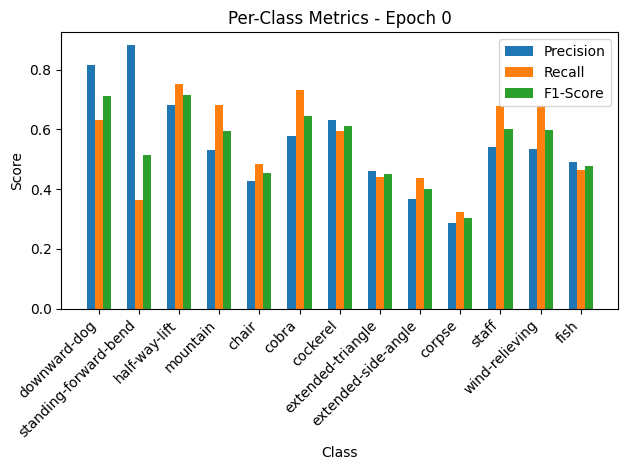

Validation: 100%|██████████| 10/10 [00:00<00:00, 30.79it/s, loss=0.739, accuracy=77.4]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 0:
downward-dog: Precision=0.82, Recall=0.63, F1-Score=0.71
standing-forward-bend: Precision=0.88, Recall=0.36, F1-Score=0.52
half-way-lift: Precision=0.68, Recall=0.75, F1-Score=0.72
mountain: Precision=0.53, Recall=0.68, F1-Score=0.60
chair: Precision=0.43, Recall=0.49, F1-Score=0.45
cobra: Precision=0.58, Recall=0.73, F1-Score=0.64
cockerel: Precision=0.63, Recall=0.59, F1-Score=0.61
extended-triangle: Precision=0.46, Recall=0.44, F1-Score=0.45
extended-side-angle: Precision=0.37, Recall=0.44, F1-Score=0.40
corpse: Precision=0.29, Recall=0.32, F1-Score=0.30
staff: Precision=0.54, Recall=0.68, F1-Score=0.60
wind-relieving: Precision=0.53, Recall=0.68, F1-Score=0.60
fish: Precision=0.49, Recall=0.46, F1-Score=0.48


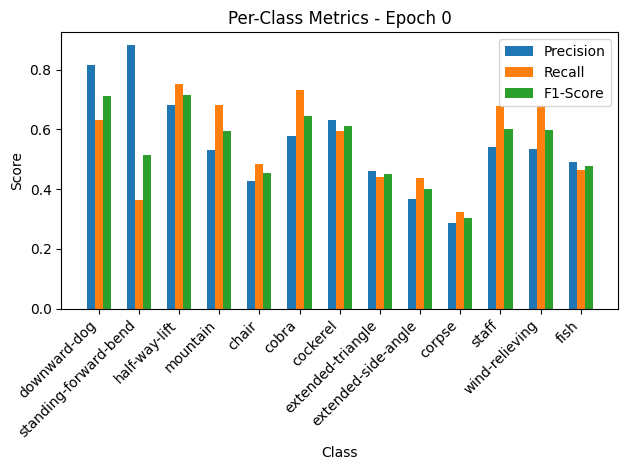


Epoch 1/50 Summary:
Train Loss: 1.4303 | Train Acc: 56.80% | Train Precision: 0.56 | Train Recall: 0.56 | Train F1: 0.54
Val Loss: 0.8103 | Val Acc: 77.40% | Val Precision: 0.76 | Val Recall: 0.78 | Val F1: 0.75
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_0.pth
Checkpoint saved at epoch 1
New best model saved! Validation Loss: 0.8103

Epoch 2/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.86it/s, loss=0.738, accuracy=77.5]


Per-Class Metrics for Epoch 1:
downward-dog: Precision=0.92, Recall=0.90, F1-Score=0.91
standing-forward-bend: Precision=0.90, Recall=0.71, F1-Score=0.79
half-way-lift: Precision=0.79, Recall=0.86, F1-Score=0.82
mountain: Precision=0.75, Recall=0.80, F1-Score=0.77
chair: Precision=0.65, Recall=0.64, F1-Score=0.65
cobra: Precision=0.84, Recall=0.91, F1-Score=0.88
cockerel: Precision=0.83, Recall=0.87, F1-Score=0.85
extended-triangle: Precision=0.63, Recall=0.62, F1-Score=0.63
extended-side-angle: Precision=0.59, Recall=0.66, F1-Score=0.62
corpse: Precision=0.61, Recall=0.53, F1-Score=0.57
staff: Precision=0.79, Recall=0.90, F1-Score=0.84
wind-relieving: Precision=0.85, Recall=0.85, F1-Score=0.85
fish: Precision=0.61, Recall=0.60, F1-Score=0.60


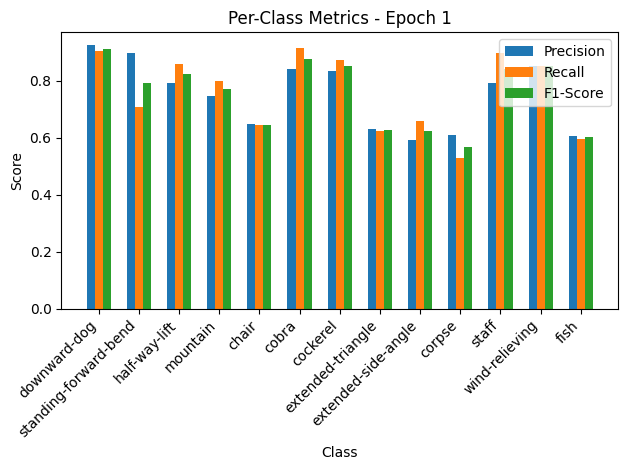

Validation: 100%|██████████| 10/10 [00:00<00:00, 36.41it/s, loss=0.564, accuracy=82.2]


Per-Class Metrics for Epoch 1:
downward-dog: Precision=0.92, Recall=0.90, F1-Score=0.91
standing-forward-bend: Precision=0.90, Recall=0.71, F1-Score=0.79
half-way-lift: Precision=0.79, Recall=0.86, F1-Score=0.82
mountain: Precision=0.75, Recall=0.80, F1-Score=0.77
chair: Precision=0.65, Recall=0.64, F1-Score=0.65
cobra: Precision=0.84, Recall=0.91, F1-Score=0.88
cockerel: Precision=0.83, Recall=0.87, F1-Score=0.85
extended-triangle: Precision=0.63, Recall=0.62, F1-Score=0.63
extended-side-angle: Precision=0.59, Recall=0.66, F1-Score=0.62
corpse: Precision=0.61, Recall=0.53, F1-Score=0.57
staff: Precision=0.79, Recall=0.90, F1-Score=0.84
wind-relieving: Precision=0.85, Recall=0.85, F1-Score=0.85
fish: Precision=0.61, Recall=0.60, F1-Score=0.60


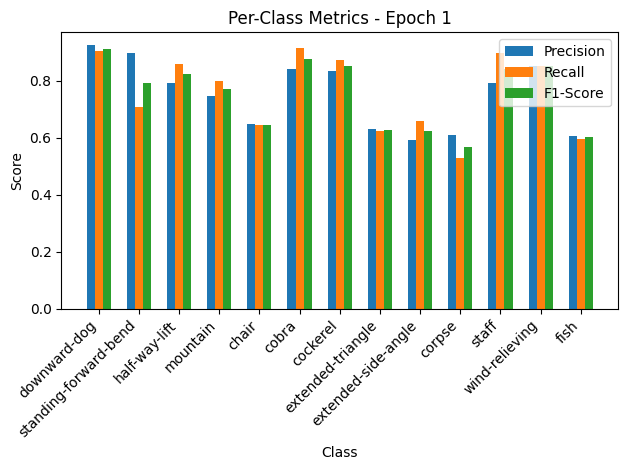


Epoch 2/50 Summary:
Train Loss: 0.7405 | Train Acc: 77.52% | Train Precision: 0.75 | Train Recall: 0.76 | Train F1: 0.75
Val Loss: 0.6176 | Val Acc: 82.19% | Val Precision: 0.86 | Val Recall: 0.80 | Val F1: 0.79
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_0.pth
Checkpoint saved at epoch 2
New best model saved! Validation Loss: 0.6176

Epoch 3/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.92it/s, loss=0.571, accuracy=83]


Per-Class Metrics for Epoch 2:
downward-dog: Precision=0.93, Recall=0.88, F1-Score=0.90
standing-forward-bend: Precision=0.89, Recall=0.79, F1-Score=0.84
half-way-lift: Precision=0.80, Recall=0.88, F1-Score=0.84
mountain: Precision=0.86, Recall=0.87, F1-Score=0.87
chair: Precision=0.81, Recall=0.82, F1-Score=0.81
cobra: Precision=0.90, Recall=0.95, F1-Score=0.92
cockerel: Precision=0.90, Recall=0.97, F1-Score=0.93
extended-triangle: Precision=0.75, Recall=0.73, F1-Score=0.74
extended-side-angle: Precision=0.69, Recall=0.71, F1-Score=0.70
corpse: Precision=0.68, Recall=0.50, F1-Score=0.58
staff: Precision=0.87, Recall=0.90, F1-Score=0.88
wind-relieving: Precision=0.89, Recall=0.93, F1-Score=0.91
fish: Precision=0.60, Recall=0.72, F1-Score=0.65


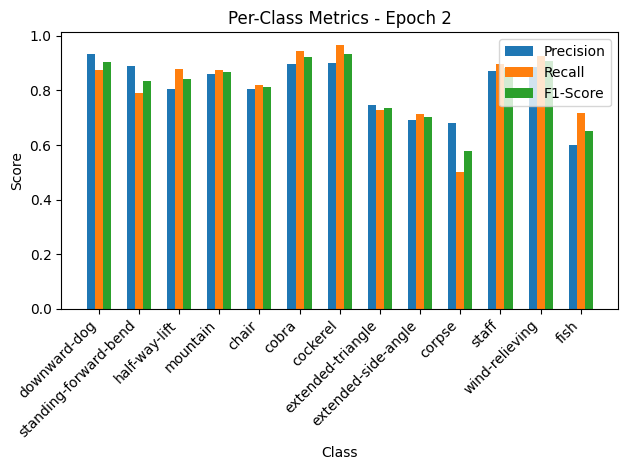

Validation: 100%|██████████| 10/10 [00:00<00:00, 33.19it/s, loss=0.469, accuracy=83.6]


Per-Class Metrics for Epoch 2:
downward-dog: Precision=0.93, Recall=0.88, F1-Score=0.90
standing-forward-bend: Precision=0.89, Recall=0.79, F1-Score=0.84
half-way-lift: Precision=0.80, Recall=0.88, F1-Score=0.84
mountain: Precision=0.86, Recall=0.87, F1-Score=0.87
chair: Precision=0.81, Recall=0.82, F1-Score=0.81
cobra: Precision=0.90, Recall=0.95, F1-Score=0.92
cockerel: Precision=0.90, Recall=0.97, F1-Score=0.93
extended-triangle: Precision=0.75, Recall=0.73, F1-Score=0.74
extended-side-angle: Precision=0.69, Recall=0.71, F1-Score=0.70
corpse: Precision=0.68, Recall=0.50, F1-Score=0.58
staff: Precision=0.87, Recall=0.90, F1-Score=0.88
wind-relieving: Precision=0.89, Recall=0.93, F1-Score=0.91
fish: Precision=0.60, Recall=0.72, F1-Score=0.65


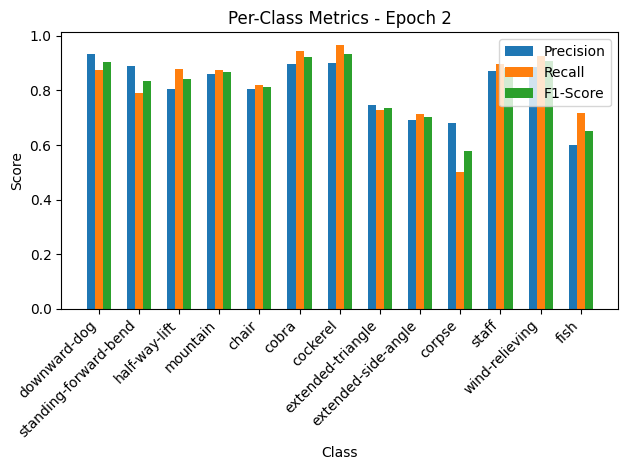


Epoch 3/50 Summary:
Train Loss: 0.5731 | Train Acc: 83.03% | Train Precision: 0.81 | Train Recall: 0.82 | Train F1: 0.81
Val Loss: 0.5142 | Val Acc: 83.56% | Val Precision: 0.86 | Val Recall: 0.82 | Val F1: 0.81
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_0.pth
Checkpoint saved at epoch 3
New best model saved! Validation Loss: 0.5142

Epoch 4/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:07<00:00, 11.08it/s, loss=0.464, accuracy=85.7]


Per-Class Metrics for Epoch 3:
downward-dog: Precision=0.96, Recall=0.91, F1-Score=0.94
standing-forward-bend: Precision=0.90, Recall=0.80, F1-Score=0.85
half-way-lift: Precision=0.82, Recall=0.91, F1-Score=0.86
mountain: Precision=0.90, Recall=0.89, F1-Score=0.89
chair: Precision=0.84, Recall=0.90, F1-Score=0.87
cobra: Precision=0.91, Recall=0.98, F1-Score=0.94
cockerel: Precision=0.91, Recall=0.93, F1-Score=0.92
extended-triangle: Precision=0.77, Recall=0.71, F1-Score=0.74
extended-side-angle: Precision=0.72, Recall=0.73, F1-Score=0.72
corpse: Precision=0.68, Recall=0.71, F1-Score=0.69
staff: Precision=0.90, Recall=0.94, F1-Score=0.92
wind-relieving: Precision=0.93, Recall=0.94, F1-Score=0.93
fish: Precision=0.69, Recall=0.64, F1-Score=0.67


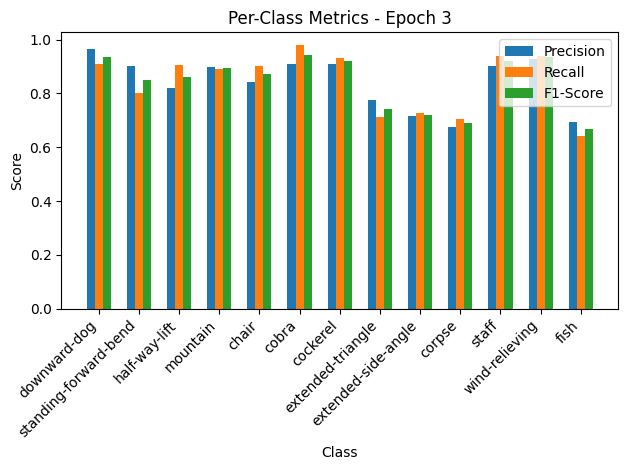

Validation: 100%|██████████| 10/10 [00:00<00:00, 23.21it/s, loss=0.432, accuracy=84.9]


Per-Class Metrics for Epoch 3:
downward-dog: Precision=0.96, Recall=0.91, F1-Score=0.94
standing-forward-bend: Precision=0.90, Recall=0.80, F1-Score=0.85
half-way-lift: Precision=0.82, Recall=0.91, F1-Score=0.86
mountain: Precision=0.90, Recall=0.89, F1-Score=0.89
chair: Precision=0.84, Recall=0.90, F1-Score=0.87
cobra: Precision=0.91, Recall=0.98, F1-Score=0.94
cockerel: Precision=0.91, Recall=0.93, F1-Score=0.92
extended-triangle: Precision=0.77, Recall=0.71, F1-Score=0.74
extended-side-angle: Precision=0.72, Recall=0.73, F1-Score=0.72
corpse: Precision=0.68, Recall=0.71, F1-Score=0.69
staff: Precision=0.90, Recall=0.94, F1-Score=0.92
wind-relieving: Precision=0.93, Recall=0.94, F1-Score=0.93
fish: Precision=0.69, Recall=0.64, F1-Score=0.67


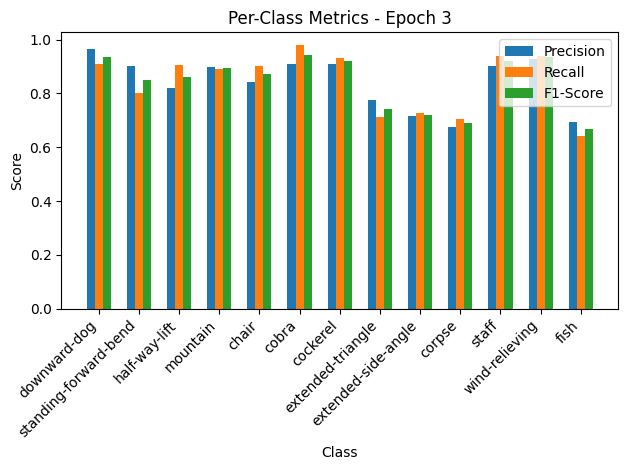


Epoch 4/50 Summary:
Train Loss: 0.4657 | Train Acc: 85.70% | Train Precision: 0.84 | Train Recall: 0.85 | Train F1: 0.84
Val Loss: 0.4735 | Val Acc: 84.93% | Val Precision: 0.84 | Val Recall: 0.84 | Val F1: 0.84
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_0.pth
Checkpoint saved at epoch 4
New best model saved! Validation Loss: 0.4735

Epoch 5/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.25it/s, loss=0.378, accuracy=89.4]


Per-Class Metrics for Epoch 4:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.96, Recall=0.83, F1-Score=0.89
half-way-lift: Precision=0.86, Recall=0.93, F1-Score=0.89
mountain: Precision=0.91, Recall=0.93, F1-Score=0.92
chair: Precision=0.88, Recall=0.90, F1-Score=0.89
cobra: Precision=0.94, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.94, Recall=0.94, F1-Score=0.94
extended-triangle: Precision=0.88, Recall=0.84, F1-Score=0.86
extended-side-angle: Precision=0.83, Recall=0.89, F1-Score=0.86
corpse: Precision=0.66, Recall=0.66, F1-Score=0.66
staff: Precision=0.94, Recall=0.99, F1-Score=0.96
wind-relieving: Precision=0.96, Recall=0.99, F1-Score=0.97
fish: Precision=0.68, Recall=0.69, F1-Score=0.68


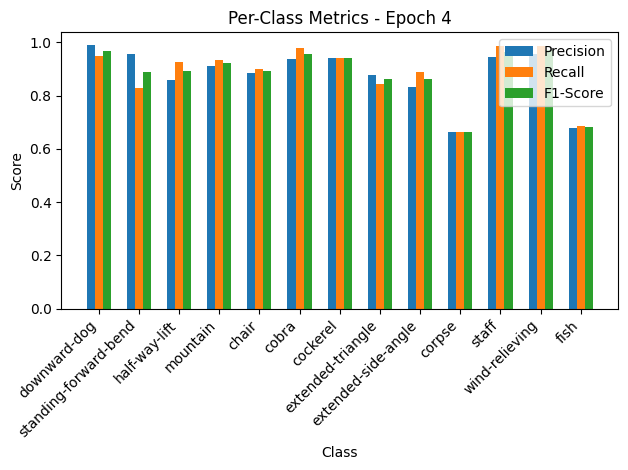

Validation: 100%|██████████| 10/10 [00:00<00:00, 32.34it/s, loss=0.342, accuracy=90.4]


Per-Class Metrics for Epoch 4:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.96, Recall=0.83, F1-Score=0.89
half-way-lift: Precision=0.86, Recall=0.93, F1-Score=0.89
mountain: Precision=0.91, Recall=0.93, F1-Score=0.92
chair: Precision=0.88, Recall=0.90, F1-Score=0.89
cobra: Precision=0.94, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.94, Recall=0.94, F1-Score=0.94
extended-triangle: Precision=0.88, Recall=0.84, F1-Score=0.86
extended-side-angle: Precision=0.83, Recall=0.89, F1-Score=0.86
corpse: Precision=0.66, Recall=0.66, F1-Score=0.66
staff: Precision=0.94, Recall=0.99, F1-Score=0.96
wind-relieving: Precision=0.96, Recall=0.99, F1-Score=0.97
fish: Precision=0.68, Recall=0.69, F1-Score=0.68


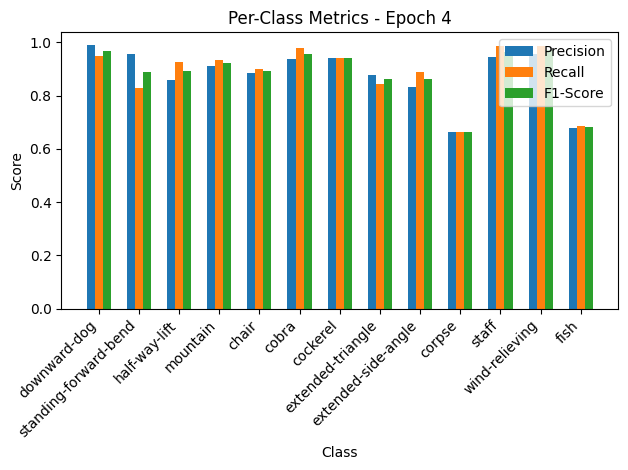


Epoch 5/50 Summary:
Train Loss: 0.3794 | Train Acc: 89.37% | Train Precision: 0.88 | Train Recall: 0.89 | Train F1: 0.88
Val Loss: 0.3747 | Val Acc: 90.41% | Val Precision: 0.91 | Val Recall: 0.90 | Val F1: 0.90
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_0.pth
Checkpoint saved at epoch 5
New best model saved! Validation Loss: 0.3747

Epoch 6/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.57it/s, loss=0.331, accuracy=90.7]


Per-Class Metrics for Epoch 5:
downward-dog: Precision=0.96, Recall=0.97, F1-Score=0.96
standing-forward-bend: Precision=0.97, Recall=0.85, F1-Score=0.90
half-way-lift: Precision=0.87, Recall=0.95, F1-Score=0.90
mountain: Precision=0.89, Recall=0.93, F1-Score=0.91
chair: Precision=0.91, Recall=0.89, F1-Score=0.90
cobra: Precision=0.95, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.94, Recall=0.95, F1-Score=0.95
extended-triangle: Precision=0.91, Recall=0.88, F1-Score=0.89
extended-side-angle: Precision=0.87, Recall=0.89, F1-Score=0.88
corpse: Precision=0.73, Recall=0.75, F1-Score=0.74
staff: Precision=0.99, Recall=0.97, F1-Score=0.98
wind-relieving: Precision=0.94, Recall=0.99, F1-Score=0.96
fish: Precision=0.77, Recall=0.70, F1-Score=0.73


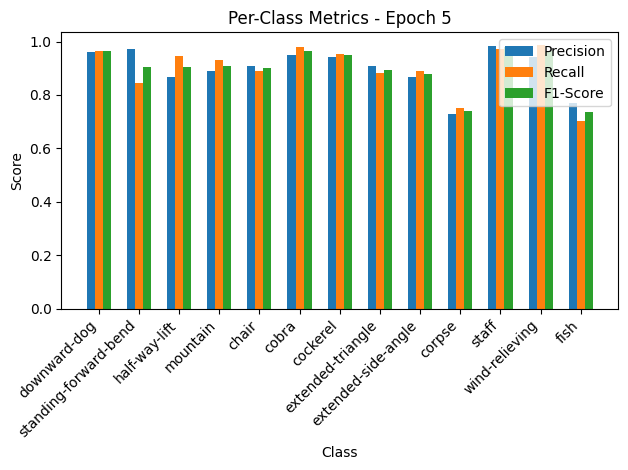

Validation: 100%|██████████| 10/10 [00:00<00:00, 32.30it/s, loss=0.324, accuracy=89]


Per-Class Metrics for Epoch 5:
downward-dog: Precision=0.96, Recall=0.97, F1-Score=0.96
standing-forward-bend: Precision=0.97, Recall=0.85, F1-Score=0.90
half-way-lift: Precision=0.87, Recall=0.95, F1-Score=0.90
mountain: Precision=0.89, Recall=0.93, F1-Score=0.91
chair: Precision=0.91, Recall=0.89, F1-Score=0.90
cobra: Precision=0.95, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.94, Recall=0.95, F1-Score=0.95
extended-triangle: Precision=0.91, Recall=0.88, F1-Score=0.89
extended-side-angle: Precision=0.87, Recall=0.89, F1-Score=0.88
corpse: Precision=0.73, Recall=0.75, F1-Score=0.74
staff: Precision=0.99, Recall=0.97, F1-Score=0.98
wind-relieving: Precision=0.94, Recall=0.99, F1-Score=0.96
fish: Precision=0.77, Recall=0.70, F1-Score=0.73


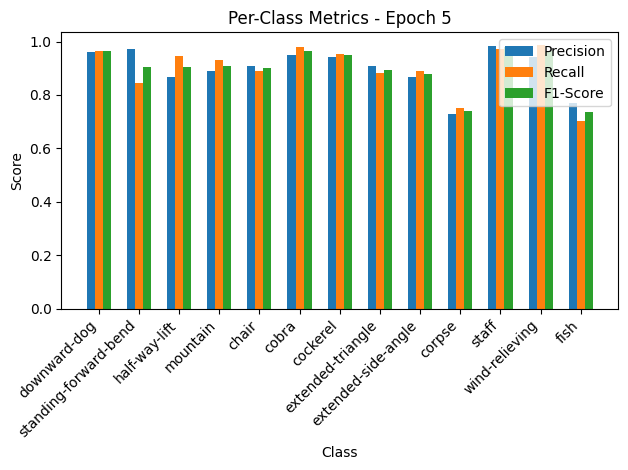


Epoch 6/50 Summary:
Train Loss: 0.3322 | Train Acc: 90.75% | Train Precision: 0.90 | Train Recall: 0.90 | Train F1: 0.90
Val Loss: 0.3554 | Val Acc: 89.04% | Val Precision: 0.90 | Val Recall: 0.88 | Val F1: 0.88
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_0.pth
Checkpoint saved at epoch 6
New best model saved! Validation Loss: 0.3554

Epoch 7/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.59it/s, loss=0.344, accuracy=90.4]


Per-Class Metrics for Epoch 6:
downward-dog: Precision=0.99, Recall=0.94, F1-Score=0.96
standing-forward-bend: Precision=0.94, Recall=0.84, F1-Score=0.89
half-way-lift: Precision=0.85, Recall=0.97, F1-Score=0.90
mountain: Precision=0.93, Recall=0.94, F1-Score=0.94
chair: Precision=0.91, Recall=0.91, F1-Score=0.91
cobra: Precision=0.94, Recall=0.97, F1-Score=0.95
cockerel: Precision=0.93, Recall=0.95, F1-Score=0.94
extended-triangle: Precision=0.87, Recall=0.87, F1-Score=0.87
extended-side-angle: Precision=0.83, Recall=0.85, F1-Score=0.84
corpse: Precision=0.78, Recall=0.76, F1-Score=0.77
staff: Precision=0.94, Recall=0.96, F1-Score=0.95
wind-relieving: Precision=0.95, Recall=0.93, F1-Score=0.94
fish: Precision=0.75, Recall=0.76, F1-Score=0.76


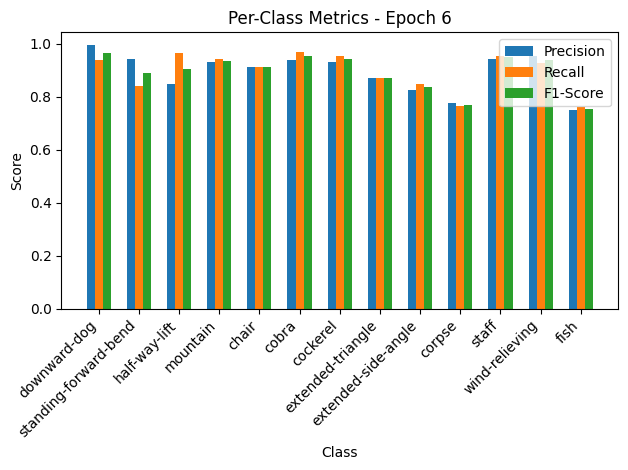

Validation: 100%|██████████| 10/10 [00:00<00:00, 28.41it/s, loss=0.313, accuracy=91.1]


Per-Class Metrics for Epoch 6:
downward-dog: Precision=0.99, Recall=0.94, F1-Score=0.96
standing-forward-bend: Precision=0.94, Recall=0.84, F1-Score=0.89
half-way-lift: Precision=0.85, Recall=0.97, F1-Score=0.90
mountain: Precision=0.93, Recall=0.94, F1-Score=0.94
chair: Precision=0.91, Recall=0.91, F1-Score=0.91
cobra: Precision=0.94, Recall=0.97, F1-Score=0.95
cockerel: Precision=0.93, Recall=0.95, F1-Score=0.94
extended-triangle: Precision=0.87, Recall=0.87, F1-Score=0.87
extended-side-angle: Precision=0.83, Recall=0.85, F1-Score=0.84
corpse: Precision=0.78, Recall=0.76, F1-Score=0.77
staff: Precision=0.94, Recall=0.96, F1-Score=0.95
wind-relieving: Precision=0.95, Recall=0.93, F1-Score=0.94
fish: Precision=0.75, Recall=0.76, F1-Score=0.76


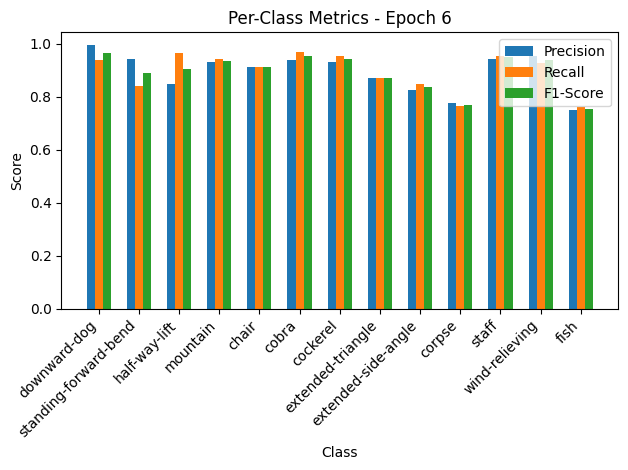


Epoch 7/50 Summary:
Train Loss: 0.3448 | Train Acc: 90.37% | Train Precision: 0.89 | Train Recall: 0.90 | Train F1: 0.89
Val Loss: 0.3428 | Val Acc: 91.10% | Val Precision: 0.91 | Val Recall: 0.91 | Val F1: 0.91
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_0.pth
Checkpoint saved at epoch 7
New best model saved! Validation Loss: 0.3428

Epoch 8/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.73it/s, loss=0.304, accuracy=91.1]


Per-Class Metrics for Epoch 7:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.92, Recall=0.88, F1-Score=0.90
half-way-lift: Precision=0.88, Recall=0.92, F1-Score=0.90
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.96, Recall=0.90, F1-Score=0.93
cobra: Precision=0.94, Recall=0.95, F1-Score=0.94
cockerel: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-triangle: Precision=0.88, Recall=0.83, F1-Score=0.85
extended-side-angle: Precision=0.80, Recall=0.88, F1-Score=0.84
corpse: Precision=0.77, Recall=0.81, F1-Score=0.79
staff: Precision=0.94, Recall=0.97, F1-Score=0.96
wind-relieving: Precision=0.96, Recall=0.99, F1-Score=0.97
fish: Precision=0.81, Recall=0.76, F1-Score=0.78


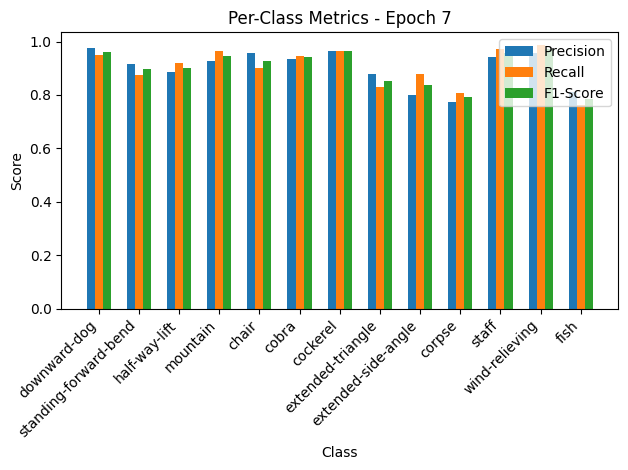

Validation: 100%|██████████| 10/10 [00:00<00:00, 31.37it/s, loss=0.355, accuracy=89]


Per-Class Metrics for Epoch 7:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.92, Recall=0.88, F1-Score=0.90
half-way-lift: Precision=0.88, Recall=0.92, F1-Score=0.90
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.96, Recall=0.90, F1-Score=0.93
cobra: Precision=0.94, Recall=0.95, F1-Score=0.94
cockerel: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-triangle: Precision=0.88, Recall=0.83, F1-Score=0.85
extended-side-angle: Precision=0.80, Recall=0.88, F1-Score=0.84
corpse: Precision=0.77, Recall=0.81, F1-Score=0.79
staff: Precision=0.94, Recall=0.97, F1-Score=0.96
wind-relieving: Precision=0.96, Recall=0.99, F1-Score=0.97
fish: Precision=0.81, Recall=0.76, F1-Score=0.78


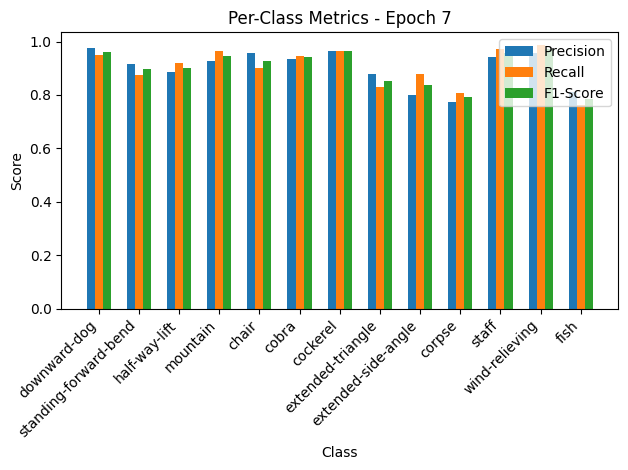


Epoch 8/50 Summary:
Train Loss: 0.3046 | Train Acc: 91.06% | Train Precision: 0.90 | Train Recall: 0.90 | Train F1: 0.90
Val Loss: 0.3886 | Val Acc: 89.04% | Val Precision: 0.90 | Val Recall: 0.88 | Val F1: 0.86

Epoch 9/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.33it/s, loss=0.302, accuracy=91.9]


Per-Class Metrics for Epoch 8:
downward-dog: Precision=1.00, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.95, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.90, Recall=0.95, F1-Score=0.93
mountain: Precision=0.94, Recall=0.94, F1-Score=0.94
chair: Precision=0.92, Recall=0.93, F1-Score=0.93
cobra: Precision=0.95, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.98, Recall=0.97, F1-Score=0.97
extended-triangle: Precision=0.89, Recall=0.88, F1-Score=0.89
extended-side-angle: Precision=0.88, Recall=0.90, F1-Score=0.89
corpse: Precision=0.71, Recall=0.69, F1-Score=0.70
staff: Precision=0.94, Recall=0.99, F1-Score=0.96
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.70, Recall=0.70, F1-Score=0.70


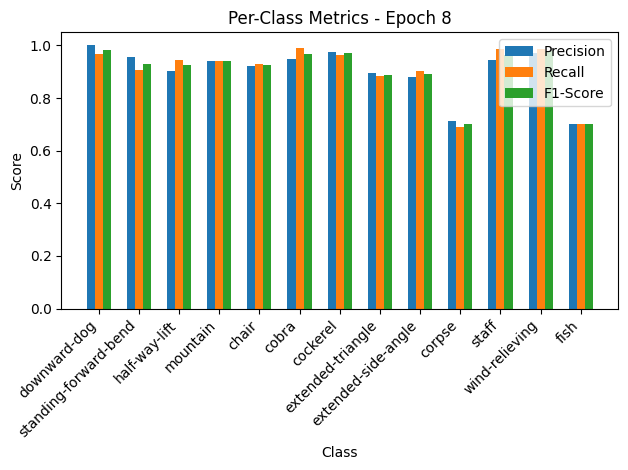

Validation: 100%|██████████| 10/10 [00:00<00:00, 30.26it/s, loss=0.187, accuracy=95.9]


Per-Class Metrics for Epoch 8:
downward-dog: Precision=1.00, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.95, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.90, Recall=0.95, F1-Score=0.93
mountain: Precision=0.94, Recall=0.94, F1-Score=0.94
chair: Precision=0.92, Recall=0.93, F1-Score=0.93
cobra: Precision=0.95, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.98, Recall=0.97, F1-Score=0.97
extended-triangle: Precision=0.89, Recall=0.88, F1-Score=0.89
extended-side-angle: Precision=0.88, Recall=0.90, F1-Score=0.89
corpse: Precision=0.71, Recall=0.69, F1-Score=0.70
staff: Precision=0.94, Recall=0.99, F1-Score=0.96
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.70, Recall=0.70, F1-Score=0.70


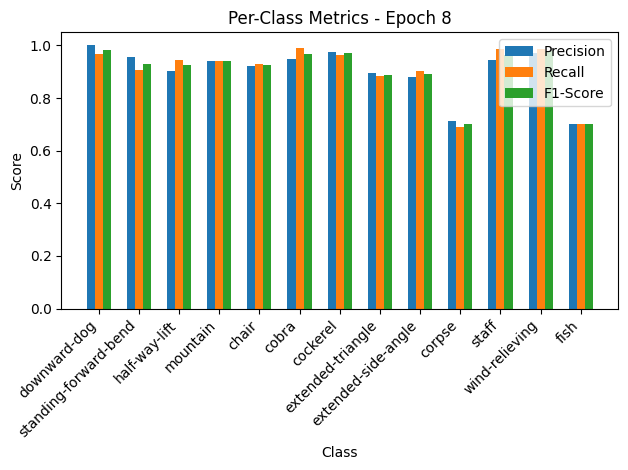


Epoch 9/50 Summary:
Train Loss: 0.3031 | Train Acc: 91.90% | Train Precision: 0.90 | Train Recall: 0.91 | Train F1: 0.91
Val Loss: 0.2048 | Val Acc: 95.89% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_0.pth
Checkpoint saved at epoch 9
New best model saved! Validation Loss: 0.2048

Epoch 10/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  9.04it/s, loss=0.266, accuracy=92.9]


Per-Class Metrics for Epoch 9:
downward-dog: Precision=0.96, Recall=0.94, F1-Score=0.95
standing-forward-bend: Precision=0.94, Recall=0.89, F1-Score=0.91
half-way-lift: Precision=0.91, Recall=0.91, F1-Score=0.91
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.92, Recall=0.93, F1-Score=0.93
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.93, Recall=0.97, F1-Score=0.95
extended-triangle: Precision=0.92, Recall=0.90, F1-Score=0.91
extended-side-angle: Precision=0.88, Recall=0.93, F1-Score=0.91
corpse: Precision=0.89, Recall=0.85, F1-Score=0.87
staff: Precision=0.96, Recall=0.99, F1-Score=0.97
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.86, Recall=0.85, F1-Score=0.86


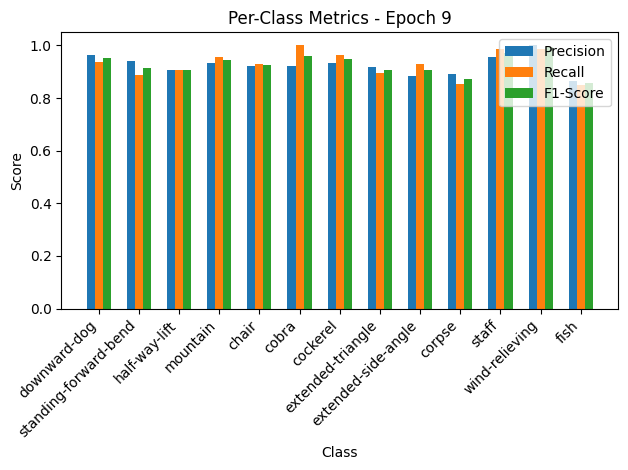

Validation: 100%|██████████| 10/10 [00:00<00:00, 28.20it/s, loss=0.19, accuracy=95.2]


Per-Class Metrics for Epoch 9:
downward-dog: Precision=0.96, Recall=0.94, F1-Score=0.95
standing-forward-bend: Precision=0.94, Recall=0.89, F1-Score=0.91
half-way-lift: Precision=0.91, Recall=0.91, F1-Score=0.91
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.92, Recall=0.93, F1-Score=0.93
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.93, Recall=0.97, F1-Score=0.95
extended-triangle: Precision=0.92, Recall=0.90, F1-Score=0.91
extended-side-angle: Precision=0.88, Recall=0.93, F1-Score=0.91
corpse: Precision=0.89, Recall=0.85, F1-Score=0.87
staff: Precision=0.96, Recall=0.99, F1-Score=0.97
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.86, Recall=0.85, F1-Score=0.86


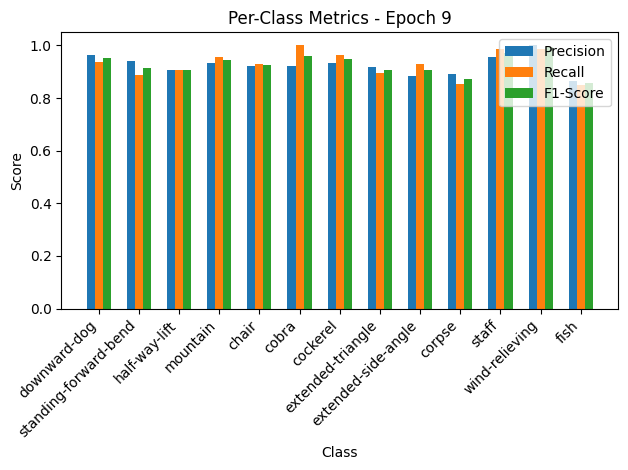


Epoch 10/50 Summary:
Train Loss: 0.2671 | Train Acc: 92.89% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.2084 | Val Acc: 95.21% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 11/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.18it/s, loss=0.251, accuracy=93.4]


Per-Class Metrics for Epoch 10:
downward-dog: Precision=0.99, Recall=0.93, F1-Score=0.96
standing-forward-bend: Precision=0.93, Recall=0.88, F1-Score=0.90
half-way-lift: Precision=0.90, Recall=0.94, F1-Score=0.92
mountain: Precision=0.92, Recall=0.96, F1-Score=0.94
chair: Precision=0.93, Recall=0.93, F1-Score=0.93
cobra: Precision=0.91, Recall=0.98, F1-Score=0.94
cockerel: Precision=0.96, Recall=0.94, F1-Score=0.95
extended-triangle: Precision=0.96, Recall=0.91, F1-Score=0.93
extended-side-angle: Precision=0.88, Recall=0.95, F1-Score=0.91
corpse: Precision=0.88, Recall=0.93, F1-Score=0.90
staff: Precision=0.96, Recall=1.00, F1-Score=0.98
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.94, Recall=0.87, F1-Score=0.90


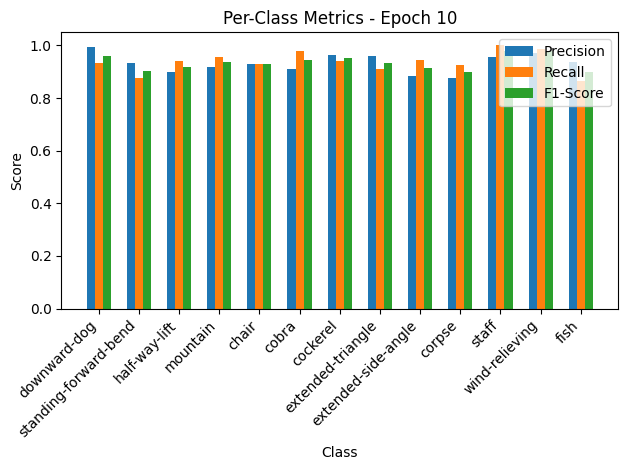

Validation: 100%|██████████| 10/10 [00:00<00:00, 29.29it/s, loss=0.365, accuracy=89]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 10:
downward-dog: Precision=0.99, Recall=0.93, F1-Score=0.96
standing-forward-bend: Precision=0.93, Recall=0.88, F1-Score=0.90
half-way-lift: Precision=0.90, Recall=0.94, F1-Score=0.92
mountain: Precision=0.92, Recall=0.96, F1-Score=0.94
chair: Precision=0.93, Recall=0.93, F1-Score=0.93
cobra: Precision=0.91, Recall=0.98, F1-Score=0.94
cockerel: Precision=0.96, Recall=0.94, F1-Score=0.95
extended-triangle: Precision=0.96, Recall=0.91, F1-Score=0.93
extended-side-angle: Precision=0.88, Recall=0.95, F1-Score=0.91
corpse: Precision=0.88, Recall=0.93, F1-Score=0.90
staff: Precision=0.96, Recall=1.00, F1-Score=0.98
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.94, Recall=0.87, F1-Score=0.90


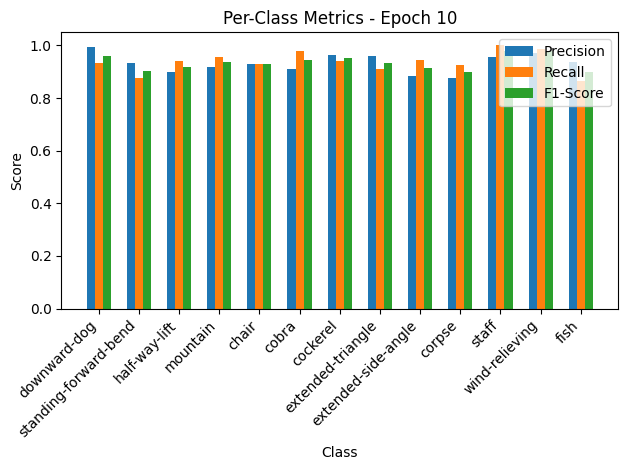


Epoch 11/50 Summary:
Train Loss: 0.2518 | Train Acc: 93.43% | Train Precision: 0.93 | Train Recall: 0.94 | Train F1: 0.93
Val Loss: 0.3995 | Val Acc: 89.04% | Val Precision: 0.84 | Val Recall: 0.88 | Val F1: 0.85

Epoch 12/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.27it/s, loss=0.246, accuracy=94.1]


Per-Class Metrics for Epoch 11:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.90, Recall=0.96, F1-Score=0.93
mountain: Precision=0.96, Recall=0.95, F1-Score=0.95
chair: Precision=0.97, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-triangle: Precision=0.95, Recall=0.92, F1-Score=0.93
extended-side-angle: Precision=0.91, Recall=0.96, F1-Score=0.93
corpse: Precision=0.87, Recall=0.81, F1-Score=0.84
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.82, Recall=0.90, F1-Score=0.86


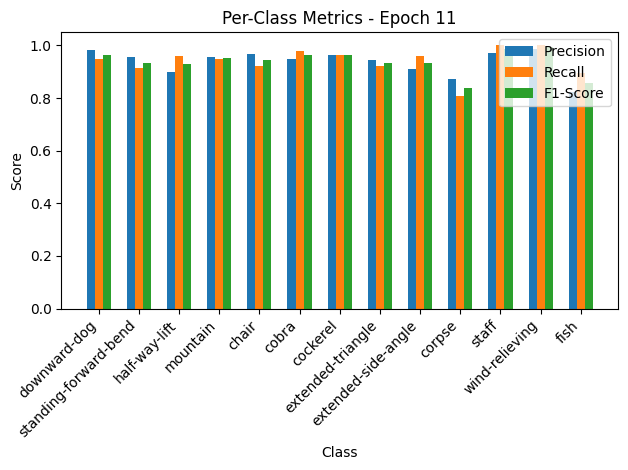

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.83it/s, loss=0.219, accuracy=94.5]


Per-Class Metrics for Epoch 11:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.90, Recall=0.96, F1-Score=0.93
mountain: Precision=0.96, Recall=0.95, F1-Score=0.95
chair: Precision=0.97, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-triangle: Precision=0.95, Recall=0.92, F1-Score=0.93
extended-side-angle: Precision=0.91, Recall=0.96, F1-Score=0.93
corpse: Precision=0.87, Recall=0.81, F1-Score=0.84
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.82, Recall=0.90, F1-Score=0.86


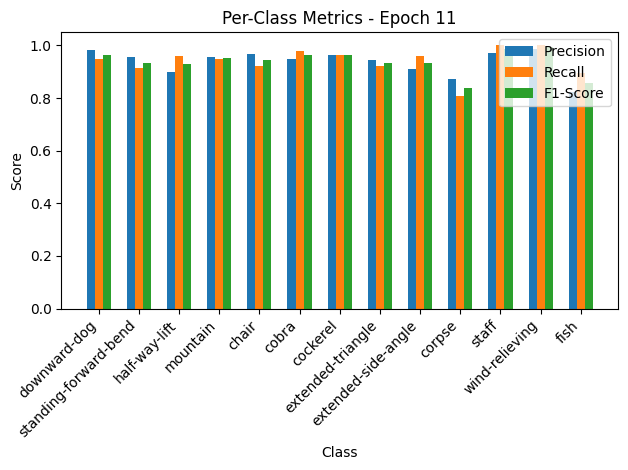


Epoch 12/50 Summary:
Train Loss: 0.2469 | Train Acc: 94.11% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.2404 | Val Acc: 94.52% | Val Precision: 0.96 | Val Recall: 0.95 | Val F1: 0.95

Epoch 13/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  9.09it/s, loss=0.244, accuracy=93.5]


Per-Class Metrics for Epoch 12:
downward-dog: Precision=0.99, Recall=0.96, F1-Score=0.98
standing-forward-bend: Precision=0.92, Recall=0.88, F1-Score=0.90
half-way-lift: Precision=0.90, Recall=0.92, F1-Score=0.91
mountain: Precision=0.91, Recall=0.96, F1-Score=0.93
chair: Precision=0.96, Recall=0.93, F1-Score=0.94
cobra: Precision=0.95, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.84, Recall=0.92, F1-Score=0.88
extended-side-angle: Precision=0.91, Recall=0.85, F1-Score=0.88
corpse: Precision=0.88, Recall=0.90, F1-Score=0.89
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.91, Recall=0.88, F1-Score=0.89


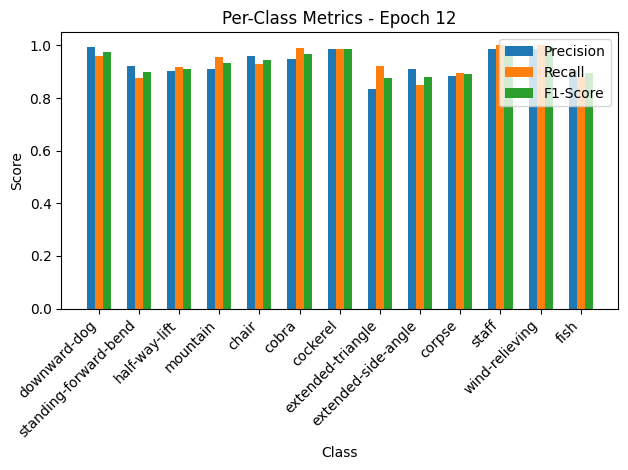

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.89it/s, loss=0.227, accuracy=92.5]


Per-Class Metrics for Epoch 12:
downward-dog: Precision=0.99, Recall=0.96, F1-Score=0.98
standing-forward-bend: Precision=0.92, Recall=0.88, F1-Score=0.90
half-way-lift: Precision=0.90, Recall=0.92, F1-Score=0.91
mountain: Precision=0.91, Recall=0.96, F1-Score=0.93
chair: Precision=0.96, Recall=0.93, F1-Score=0.94
cobra: Precision=0.95, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.84, Recall=0.92, F1-Score=0.88
extended-side-angle: Precision=0.91, Recall=0.85, F1-Score=0.88
corpse: Precision=0.88, Recall=0.90, F1-Score=0.89
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.91, Recall=0.88, F1-Score=0.89


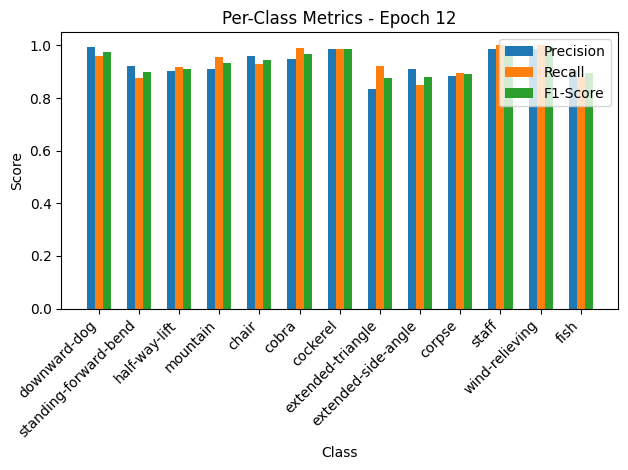


Epoch 13/50 Summary:
Train Loss: 0.2450 | Train Acc: 93.50% | Train Precision: 0.93 | Train Recall: 0.94 | Train F1: 0.93
Val Loss: 0.2491 | Val Acc: 92.47% | Val Precision: 0.94 | Val Recall: 0.93 | Val F1: 0.93

Epoch 14/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  8.08it/s, loss=0.229, accuracy=94.9]


Per-Class Metrics for Epoch 13:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.90, F1-Score=0.94
half-way-lift: Precision=0.89, Recall=0.95, F1-Score=0.92
mountain: Precision=0.95, Recall=0.98, F1-Score=0.97
chair: Precision=0.96, Recall=0.95, F1-Score=0.96
cobra: Precision=0.96, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.92, Recall=0.92, F1-Score=0.92
extended-side-angle: Precision=0.92, Recall=0.93, F1-Score=0.93
corpse: Precision=0.88, Recall=0.90, F1-Score=0.89
staff: Precision=0.97, Recall=0.97, F1-Score=0.97
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.88, Recall=0.88, F1-Score=0.88


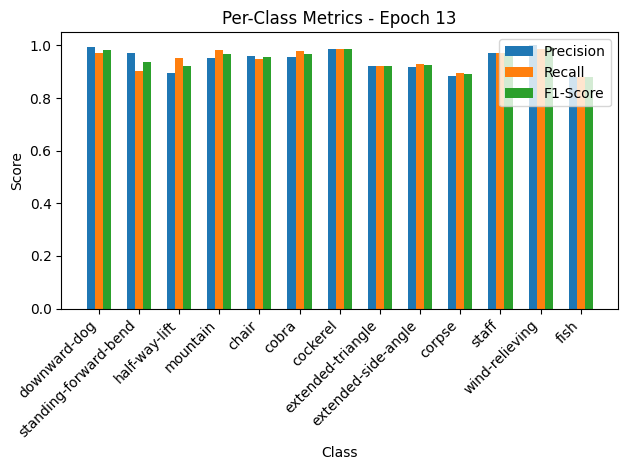

Validation: 100%|██████████| 10/10 [00:00<00:00, 22.79it/s, loss=0.207, accuracy=95.2]


Per-Class Metrics for Epoch 13:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.90, F1-Score=0.94
half-way-lift: Precision=0.89, Recall=0.95, F1-Score=0.92
mountain: Precision=0.95, Recall=0.98, F1-Score=0.97
chair: Precision=0.96, Recall=0.95, F1-Score=0.96
cobra: Precision=0.96, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.92, Recall=0.92, F1-Score=0.92
extended-side-angle: Precision=0.92, Recall=0.93, F1-Score=0.93
corpse: Precision=0.88, Recall=0.90, F1-Score=0.89
staff: Precision=0.97, Recall=0.97, F1-Score=0.97
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.88, Recall=0.88, F1-Score=0.88


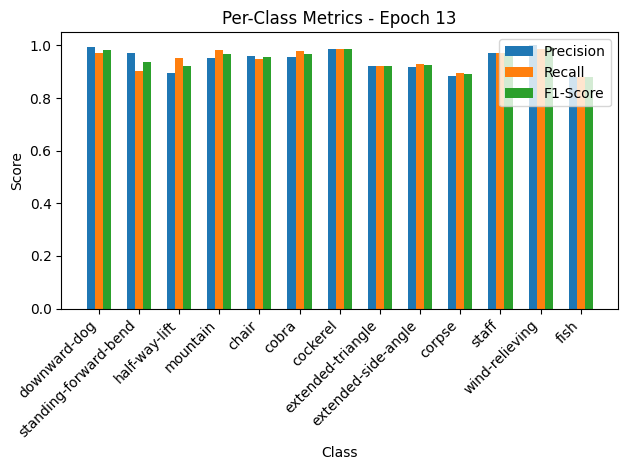


Epoch 14/50 Summary:
Train Loss: 0.2296 | Train Acc: 94.88% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2264 | Val Acc: 95.21% | Val Precision: 0.96 | Val Recall: 0.95 | Val F1: 0.96

Epoch 15/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.32it/s, loss=0.248, accuracy=93.3]


Per-Class Metrics for Epoch 14:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.91, Recall=0.86, F1-Score=0.89
half-way-lift: Precision=0.87, Recall=0.92, F1-Score=0.90
mountain: Precision=0.90, Recall=0.96, F1-Score=0.93
chair: Precision=0.94, Recall=0.89, F1-Score=0.91
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.91, F1-Score=0.94
extended-side-angle: Precision=0.91, Recall=0.97, F1-Score=0.94
corpse: Precision=0.85, Recall=0.88, F1-Score=0.86
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.98, Recall=0.96, F1-Score=0.97
fish: Precision=0.86, Recall=0.85, F1-Score=0.86


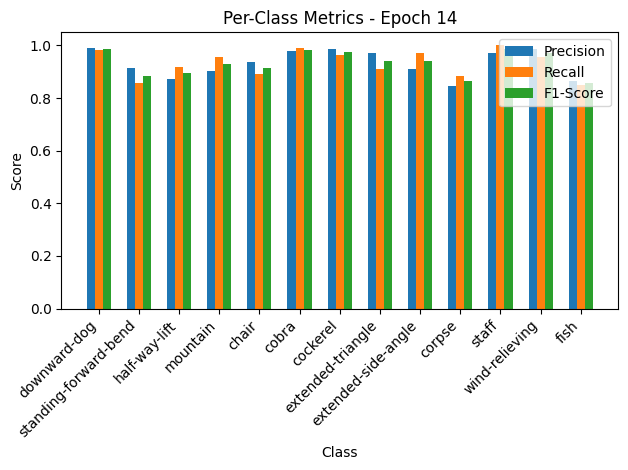

Validation: 100%|██████████| 10/10 [00:00<00:00, 24.76it/s, loss=0.233, accuracy=93.2]


Per-Class Metrics for Epoch 14:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.91, Recall=0.86, F1-Score=0.89
half-way-lift: Precision=0.87, Recall=0.92, F1-Score=0.90
mountain: Precision=0.90, Recall=0.96, F1-Score=0.93
chair: Precision=0.94, Recall=0.89, F1-Score=0.91
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.91, F1-Score=0.94
extended-side-angle: Precision=0.91, Recall=0.97, F1-Score=0.94
corpse: Precision=0.85, Recall=0.88, F1-Score=0.86
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.98, Recall=0.96, F1-Score=0.97
fish: Precision=0.86, Recall=0.85, F1-Score=0.86


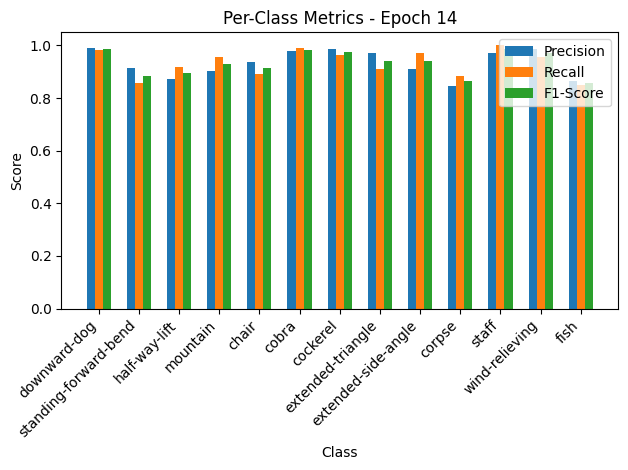


Epoch 15/50 Summary:
Train Loss: 0.2492 | Train Acc: 93.27% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.2549 | Val Acc: 93.15% | Val Precision: 0.95 | Val Recall: 0.93 | Val F1: 0.93

Epoch 16/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.58it/s, loss=0.169, accuracy=96]


Per-Class Metrics for Epoch 15:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.99, Recall=0.93, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.99, F1-Score=0.96
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.97, Recall=0.94, F1-Score=0.95
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.98, Recall=0.95, F1-Score=0.96
extended-triangle: Precision=0.96, Recall=0.96, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.96, F1-Score=0.95
corpse: Precision=0.90, Recall=0.91, F1-Score=0.91
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.91, Recall=0.91, F1-Score=0.91


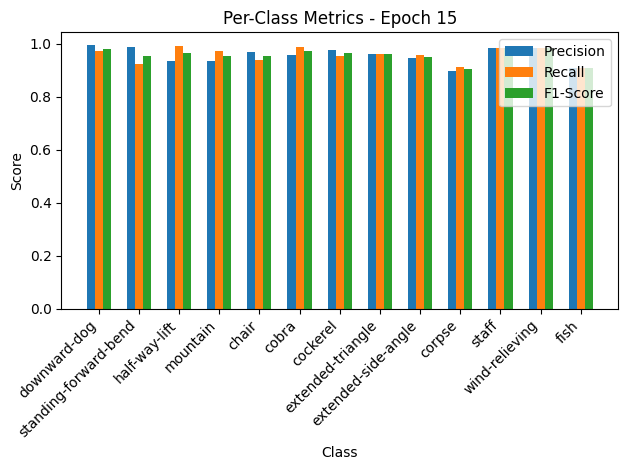

Validation: 100%|██████████| 10/10 [00:00<00:00, 19.50it/s, loss=0.136, accuracy=97.3]


Per-Class Metrics for Epoch 15:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.99, Recall=0.93, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.99, F1-Score=0.96
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.97, Recall=0.94, F1-Score=0.95
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.98, Recall=0.95, F1-Score=0.96
extended-triangle: Precision=0.96, Recall=0.96, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.96, F1-Score=0.95
corpse: Precision=0.90, Recall=0.91, F1-Score=0.91
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.91, Recall=0.91, F1-Score=0.91


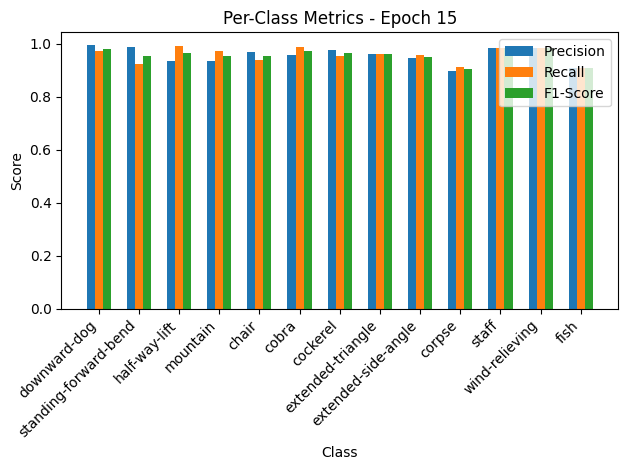


Epoch 16/50 Summary:
Train Loss: 0.1694 | Train Acc: 96.02% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.1490 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_0.pth
Checkpoint saved at epoch 16
New best model saved! Validation Loss: 0.1490

Epoch 17/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.87it/s, loss=0.131, accuracy=97.3]


Per-Class Metrics for Epoch 16:
downward-dog: Precision=1.00, Recall=0.97, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.95, Recall=0.98, F1-Score=0.97
mountain: Precision=0.95, Recall=0.98, F1-Score=0.97
chair: Precision=0.99, Recall=0.95, F1-Score=0.97
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.96, Recall=0.94, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.94, Recall=0.96, F1-Score=0.95


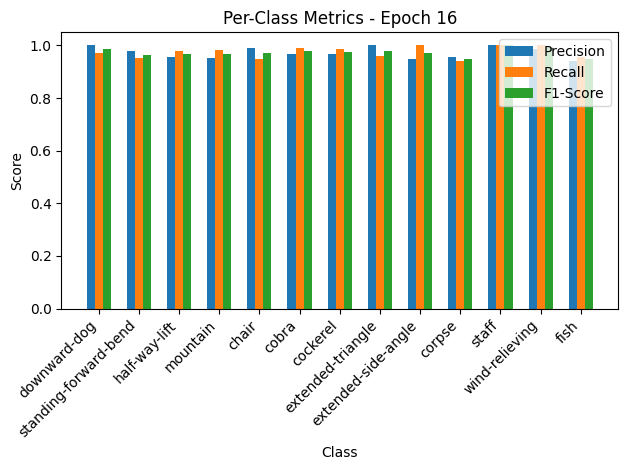

Validation: 100%|██████████| 10/10 [00:00<00:00, 21.07it/s, loss=0.146, accuracy=96.6]


Per-Class Metrics for Epoch 16:
downward-dog: Precision=1.00, Recall=0.97, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.95, Recall=0.98, F1-Score=0.97
mountain: Precision=0.95, Recall=0.98, F1-Score=0.97
chair: Precision=0.99, Recall=0.95, F1-Score=0.97
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.96, Recall=0.94, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.94, Recall=0.96, F1-Score=0.95


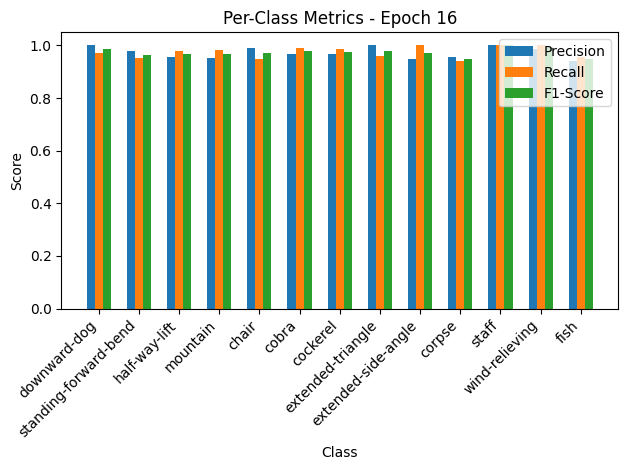


Epoch 17/50 Summary:
Train Loss: 0.1318 | Train Acc: 97.32% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.1605 | Val Acc: 96.58% | Val Precision: 0.98 | Val Recall: 0.97 | Val F1: 0.97

Epoch 18/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.60it/s, loss=0.13, accuracy=97.2]


Per-Class Metrics for Epoch 17:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.93, F1-Score=0.95
half-way-lift: Precision=0.94, Recall=0.99, F1-Score=0.96
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.98, Recall=0.96, F1-Score=0.97
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=0.98, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.93, Recall=0.96, F1-Score=0.94
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.95, Recall=0.93, F1-Score=0.94


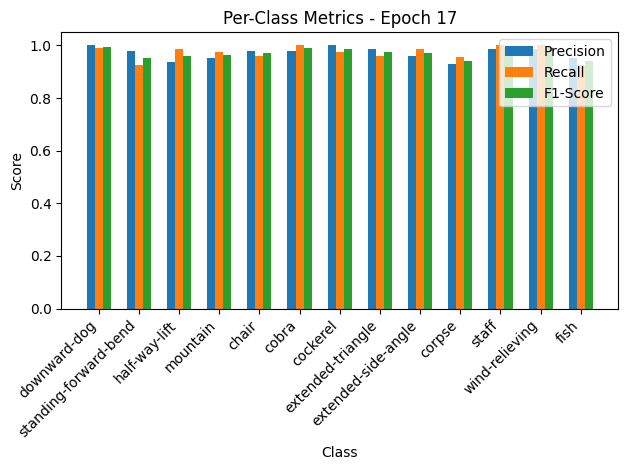

Validation: 100%|██████████| 10/10 [00:00<00:00, 24.34it/s, loss=0.127, accuracy=96.6]


Per-Class Metrics for Epoch 17:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.93, F1-Score=0.95
half-way-lift: Precision=0.94, Recall=0.99, F1-Score=0.96
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.98, Recall=0.96, F1-Score=0.97
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=0.98, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.93, Recall=0.96, F1-Score=0.94
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.95, Recall=0.93, F1-Score=0.94


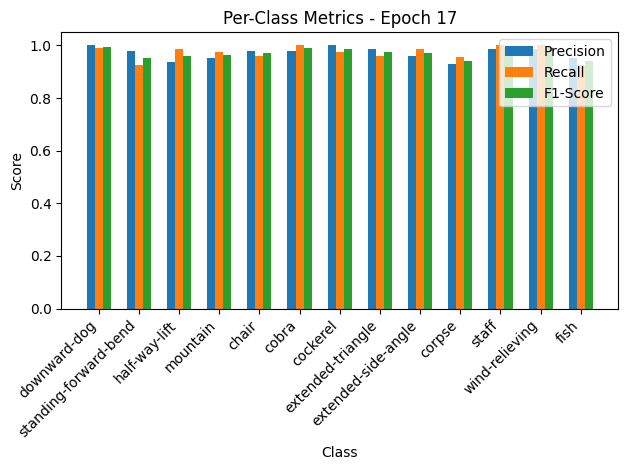


Epoch 18/50 Summary:
Train Loss: 0.1302 | Train Acc: 97.17% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.1395 | Val Acc: 96.58% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_0.pth
Checkpoint saved at epoch 18
New best model saved! Validation Loss: 0.1395

Epoch 19/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.58it/s, loss=0.114, accuracy=97.4]


Per-Class Metrics for Epoch 18:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.95, Recall=0.99, F1-Score=0.97
mountain: Precision=0.95, Recall=0.98, F1-Score=0.97
chair: Precision=0.98, Recall=0.95, F1-Score=0.96
cobra: Precision=0.99, Recall=0.99, F1-Score=0.99
cockerel: Precision=1.00, Recall=0.98, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.93, Recall=0.96, F1-Score=0.94
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.95, Recall=0.93, F1-Score=0.94


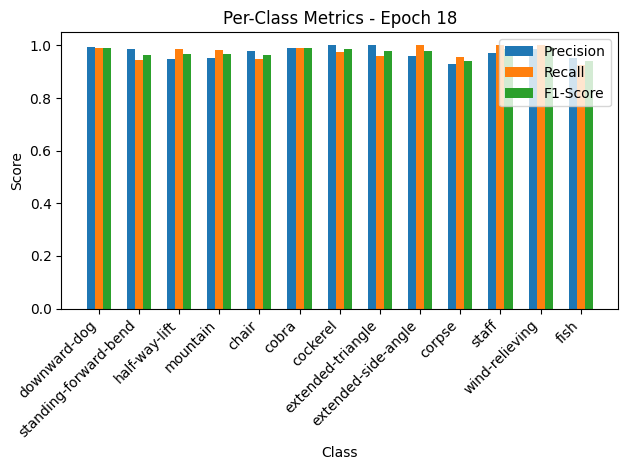

Validation: 100%|██████████| 10/10 [00:00<00:00, 25.93it/s, loss=0.134, accuracy=96.6]


Per-Class Metrics for Epoch 18:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.95, Recall=0.99, F1-Score=0.97
mountain: Precision=0.95, Recall=0.98, F1-Score=0.97
chair: Precision=0.98, Recall=0.95, F1-Score=0.96
cobra: Precision=0.99, Recall=0.99, F1-Score=0.99
cockerel: Precision=1.00, Recall=0.98, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.93, Recall=0.96, F1-Score=0.94
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.95, Recall=0.93, F1-Score=0.94


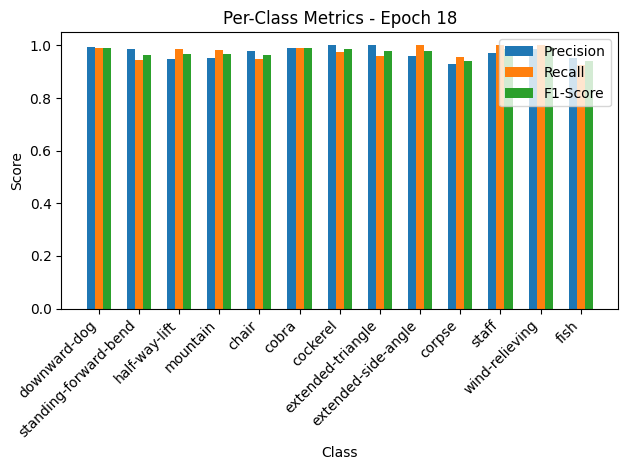


Epoch 19/50 Summary:
Train Loss: 0.1147 | Train Acc: 97.40% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.1471 | Val Acc: 96.58% | Val Precision: 0.98 | Val Recall: 0.97 | Val F1: 0.97

Epoch 20/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.32it/s, loss=0.102, accuracy=97.8]


Per-Class Metrics for Epoch 19:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.96, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.93, Recall=0.97, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.97, Recall=0.93, F1-Score=0.95


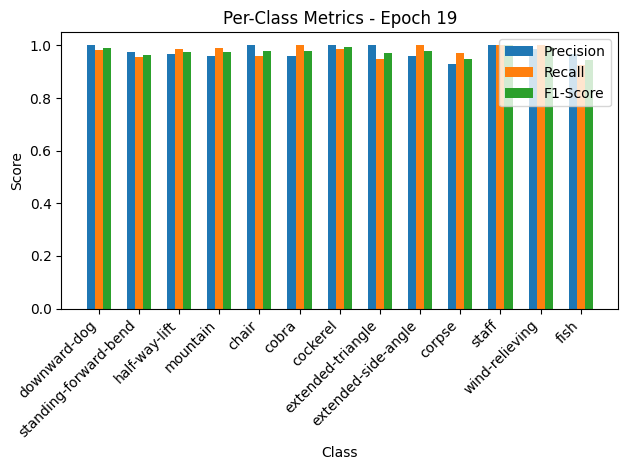

Validation: 100%|██████████| 10/10 [00:00<00:00, 25.37it/s, loss=0.127, accuracy=95.9]


Per-Class Metrics for Epoch 19:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.96, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.93, Recall=0.97, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.97, Recall=0.93, F1-Score=0.95


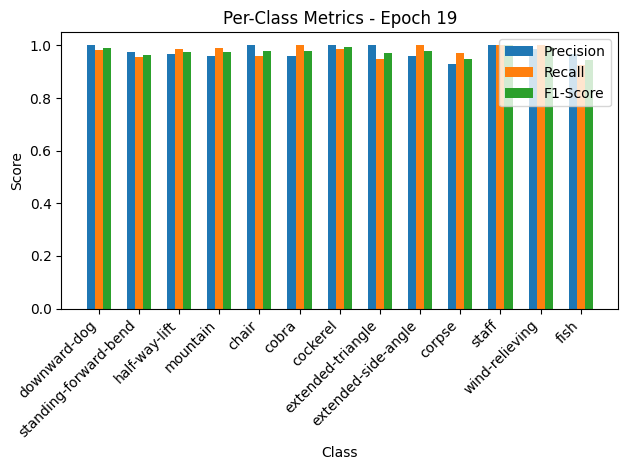


Epoch 20/50 Summary:
Train Loss: 0.1020 | Train Acc: 97.78% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1397 | Val Acc: 95.89% | Val Precision: 0.97 | Val Recall: 0.96 | Val F1: 0.97

Epoch 21/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.36it/s, loss=0.12, accuracy=97.2]


Per-Class Metrics for Epoch 20:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.93, F1-Score=0.95
half-way-lift: Precision=0.95, Recall=0.97, F1-Score=0.96
mountain: Precision=0.94, Recall=0.98, F1-Score=0.96
chair: Precision=0.98, Recall=0.95, F1-Score=0.96
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.96, Recall=0.96, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.96, Recall=0.96, F1-Score=0.96


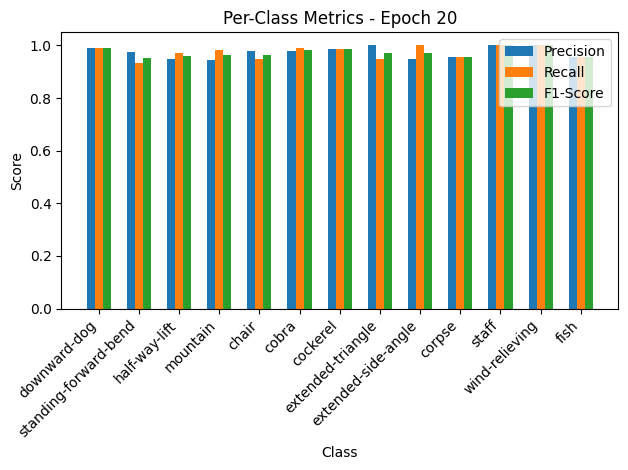

Validation: 100%|██████████| 10/10 [00:00<00:00, 24.46it/s, loss=0.139, accuracy=95.2]


Per-Class Metrics for Epoch 20:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.93, F1-Score=0.95
half-way-lift: Precision=0.95, Recall=0.97, F1-Score=0.96
mountain: Precision=0.94, Recall=0.98, F1-Score=0.96
chair: Precision=0.98, Recall=0.95, F1-Score=0.96
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.96, Recall=0.96, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.96, Recall=0.96, F1-Score=0.96


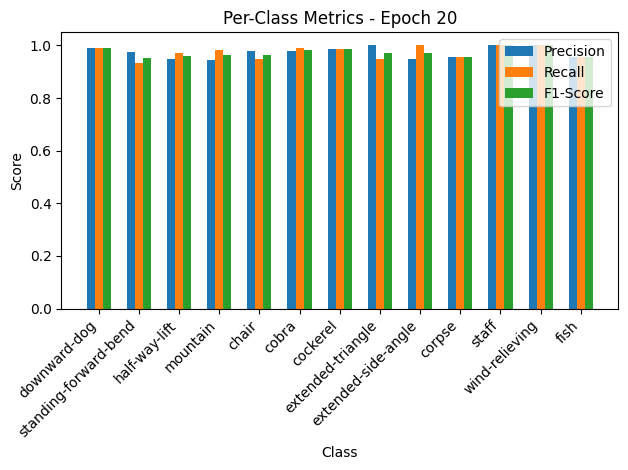


Epoch 21/50 Summary:
Train Loss: 0.1200 | Train Acc: 97.25% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.1523 | Val Acc: 95.21% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 22/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.27it/s, loss=0.107, accuracy=97.8]


Per-Class Metrics for Epoch 21:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.97, Recall=0.95, F1-Score=0.96
half-way-lift: Precision=0.95, Recall=0.97, F1-Score=0.96
mountain: Precision=0.95, Recall=0.98, F1-Score=0.97
chair: Precision=0.99, Recall=0.94, F1-Score=0.96
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.93, Recall=0.99, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.93, F1-Score=0.95


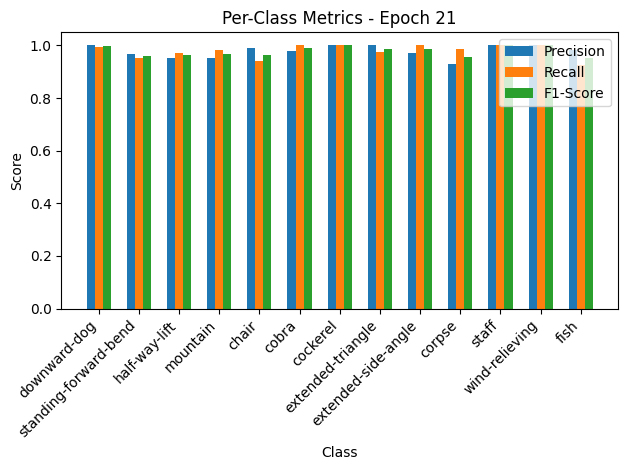

Validation: 100%|██████████| 10/10 [00:00<00:00, 25.87it/s, loss=0.117, accuracy=95.9]


Per-Class Metrics for Epoch 21:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.97, Recall=0.95, F1-Score=0.96
half-way-lift: Precision=0.95, Recall=0.97, F1-Score=0.96
mountain: Precision=0.95, Recall=0.98, F1-Score=0.97
chair: Precision=0.99, Recall=0.94, F1-Score=0.96
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.93, Recall=0.99, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.93, F1-Score=0.95


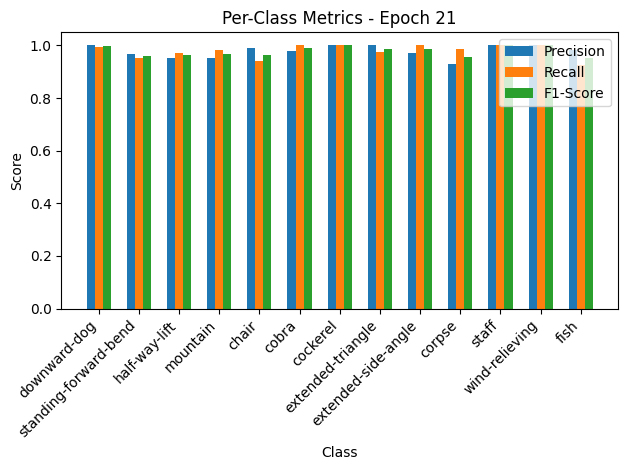


Epoch 22/50 Summary:
Train Loss: 0.1075 | Train Acc: 97.78% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1277 | Val Acc: 95.89% | Val Precision: 0.97 | Val Recall: 0.96 | Val F1: 0.97
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_0.pth
Checkpoint saved at epoch 22
New best model saved! Validation Loss: 0.1277

Epoch 23/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.45it/s, loss=0.119, accuracy=97.6]


Per-Class Metrics for Epoch 22:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.95, Recall=0.97, F1-Score=0.96
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=0.99, Recall=0.96, F1-Score=0.97
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.91, Recall=0.93, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.92, Recall=0.91, F1-Score=0.92


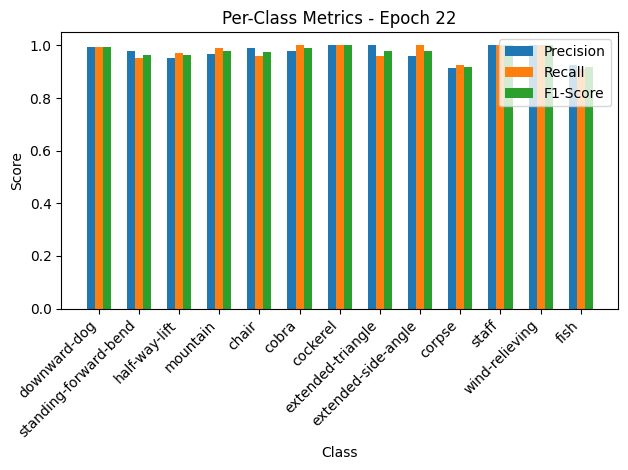

Validation: 100%|██████████| 10/10 [00:00<00:00, 24.78it/s, loss=0.131, accuracy=95.2]


Per-Class Metrics for Epoch 22:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.95, Recall=0.97, F1-Score=0.96
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=0.99, Recall=0.96, F1-Score=0.97
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.91, Recall=0.93, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.92, Recall=0.91, F1-Score=0.92


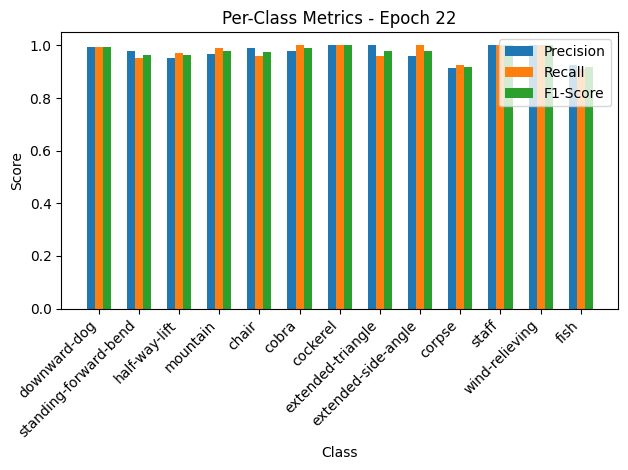


Epoch 23/50 Summary:
Train Loss: 0.1195 | Train Acc: 97.55% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.1439 | Val Acc: 95.21% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 24/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.92it/s, loss=0.103, accuracy=97.6]


Per-Class Metrics for Epoch 23:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.96, Recall=0.99, F1-Score=0.97
mountain: Precision=0.95, Recall=0.99, F1-Score=0.97
chair: Precision=0.99, Recall=0.96, F1-Score=0.97
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.94, Recall=0.96, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.95, Recall=0.94, F1-Score=0.95


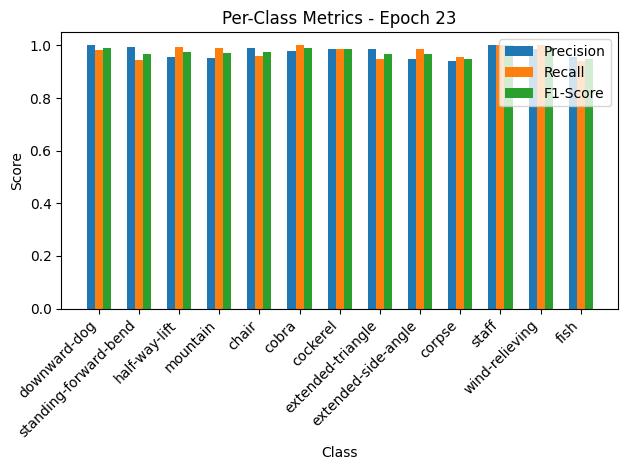

Validation: 100%|██████████| 10/10 [00:00<00:00, 25.04it/s, loss=0.124, accuracy=95.9]


Per-Class Metrics for Epoch 23:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.96, Recall=0.99, F1-Score=0.97
mountain: Precision=0.95, Recall=0.99, F1-Score=0.97
chair: Precision=0.99, Recall=0.96, F1-Score=0.97
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.94, Recall=0.96, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.95, Recall=0.94, F1-Score=0.95


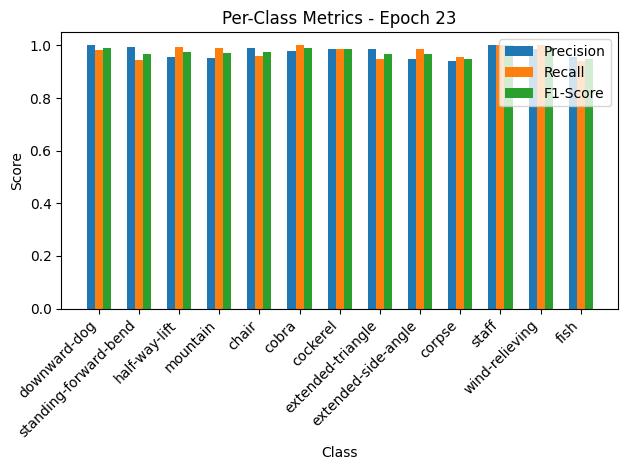


Epoch 24/50 Summary:
Train Loss: 0.1034 | Train Acc: 97.63% | Train Precision: 0.97 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1363 | Val Acc: 95.89% | Val Precision: 0.97 | Val Recall: 0.96 | Val F1: 0.97

Epoch 25/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.83it/s, loss=0.105, accuracy=97.7]


Per-Class Metrics for Epoch 24:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.96, Recall=0.98, F1-Score=0.97
mountain: Precision=0.96, Recall=0.98, F1-Score=0.97
chair: Precision=0.98, Recall=0.95, F1-Score=0.96
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.92, Recall=0.99, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.91, F1-Score=0.95


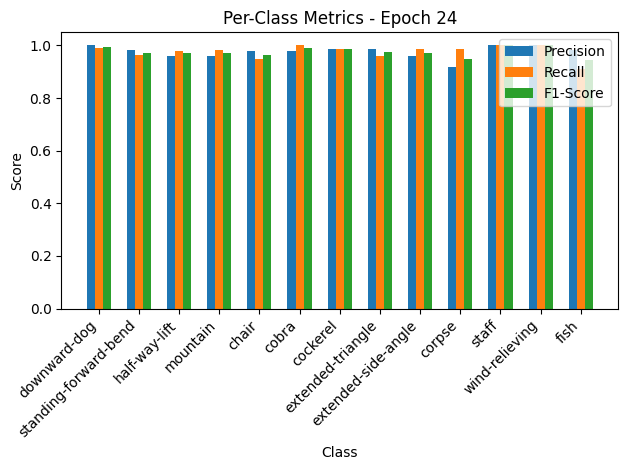

Validation: 100%|██████████| 10/10 [00:00<00:00, 25.82it/s, loss=0.14, accuracy=95.9]


Per-Class Metrics for Epoch 24:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.96, Recall=0.98, F1-Score=0.97
mountain: Precision=0.96, Recall=0.98, F1-Score=0.97
chair: Precision=0.98, Recall=0.95, F1-Score=0.96
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.92, Recall=0.99, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.91, F1-Score=0.95


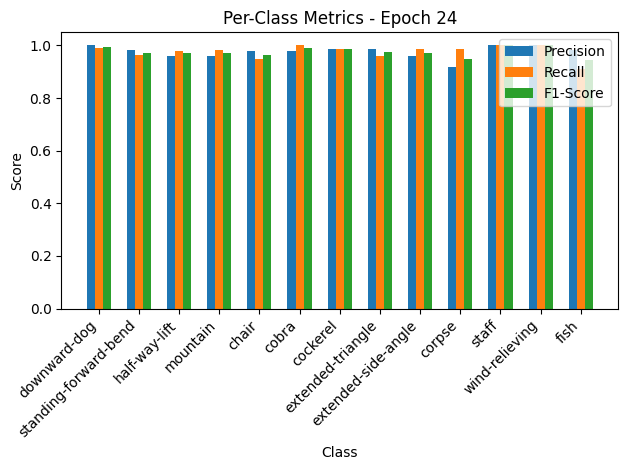


Epoch 25/50 Summary:
Train Loss: 0.1048 | Train Acc: 97.71% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1534 | Val Acc: 95.89% | Val Precision: 0.97 | Val Recall: 0.96 | Val F1: 0.97

Epoch 26/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.43it/s, loss=0.106, accuracy=98.1]


Per-Class Metrics for Epoch 25:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.98
mountain: Precision=0.95, Recall=0.98, F1-Score=0.97
chair: Precision=1.00, Recall=0.94, F1-Score=0.97
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.96, Recall=0.97, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.97, Recall=0.96, F1-Score=0.96


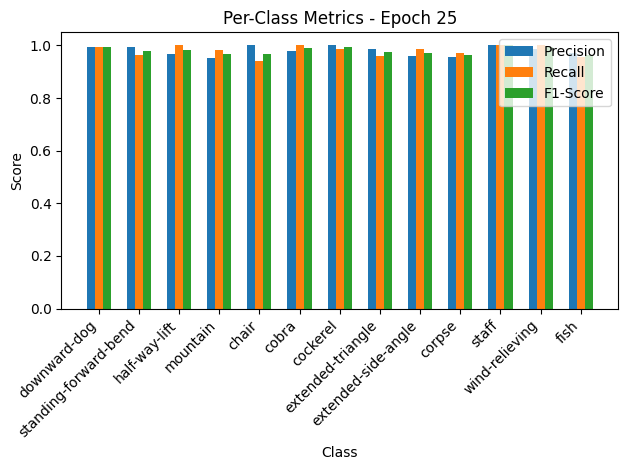

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.44it/s, loss=0.19, accuracy=93.8]


Per-Class Metrics for Epoch 25:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.98
mountain: Precision=0.95, Recall=0.98, F1-Score=0.97
chair: Precision=1.00, Recall=0.94, F1-Score=0.97
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.96, Recall=0.97, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.97, Recall=0.96, F1-Score=0.96


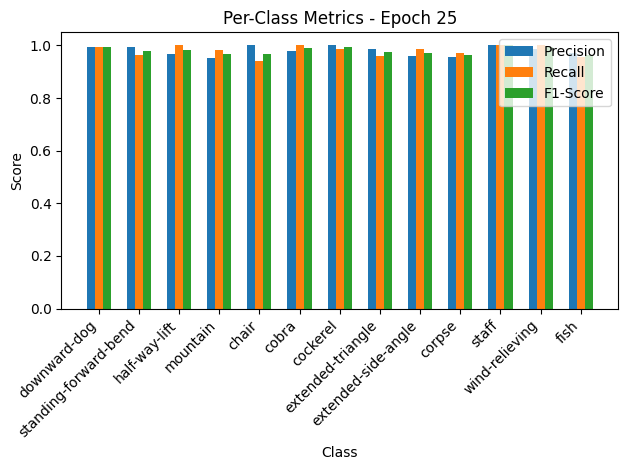


Epoch 26/50 Summary:
Train Loss: 0.1065 | Train Acc: 98.09% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.2083 | Val Acc: 93.84% | Val Precision: 0.95 | Val Recall: 0.94 | Val F1: 0.94

Epoch 27/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.28it/s, loss=0.0868, accuracy=98.4]


Per-Class Metrics for Epoch 26:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.96, Recall=0.99, F1-Score=0.97
mountain: Precision=0.98, Recall=0.98, F1-Score=0.98
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.94, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.97, F1-Score=0.96


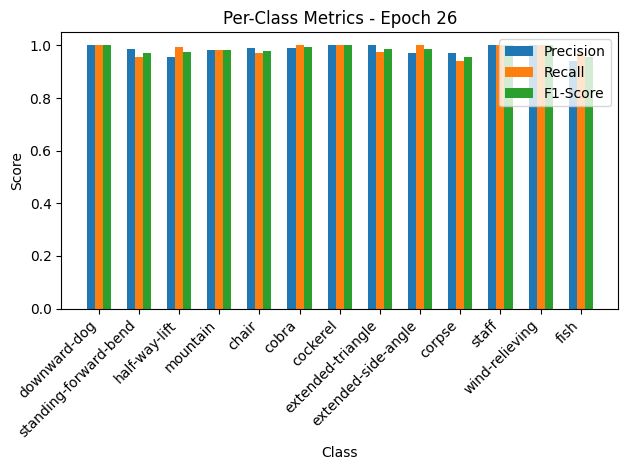

Validation: 100%|██████████| 10/10 [00:00<00:00, 26.79it/s, loss=0.136, accuracy=96.6]


Per-Class Metrics for Epoch 26:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.96, Recall=0.99, F1-Score=0.97
mountain: Precision=0.98, Recall=0.98, F1-Score=0.98
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.94, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.97, F1-Score=0.96


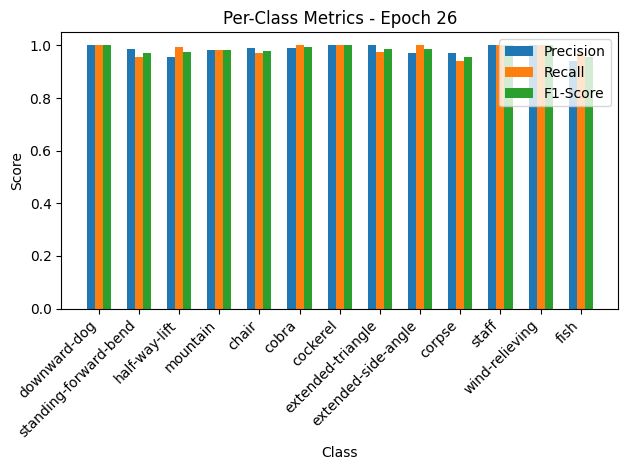


Epoch 27/50 Summary:
Train Loss: 0.0871 | Train Acc: 98.39% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1494 | Val Acc: 96.58% | Val Precision: 0.98 | Val Recall: 0.97 | Val F1: 0.98

Epoch 28/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.26it/s, loss=0.0963, accuracy=98]


Per-Class Metrics for Epoch 27:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.97, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=0.98, F1-Score=0.97
chair: Precision=1.00, Recall=0.95, F1-Score=0.97
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.92, Recall=0.96, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.95, Recall=0.91, F1-Score=0.93


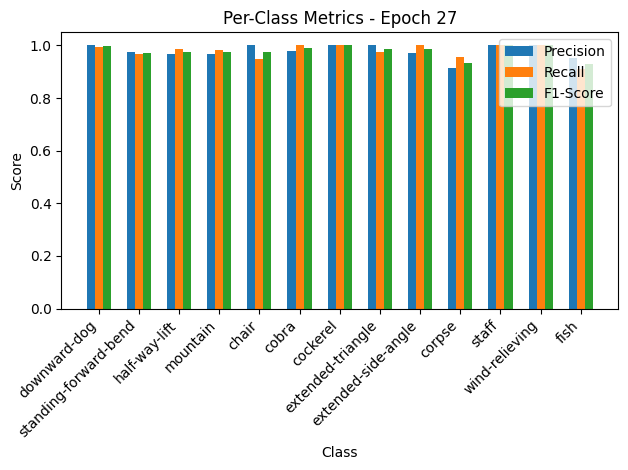

Validation: 100%|██████████| 10/10 [00:00<00:00, 25.84it/s, loss=0.145, accuracy=94.5]


Per-Class Metrics for Epoch 27:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.97, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=0.98, F1-Score=0.97
chair: Precision=1.00, Recall=0.95, F1-Score=0.97
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.92, Recall=0.96, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.95, Recall=0.91, F1-Score=0.93


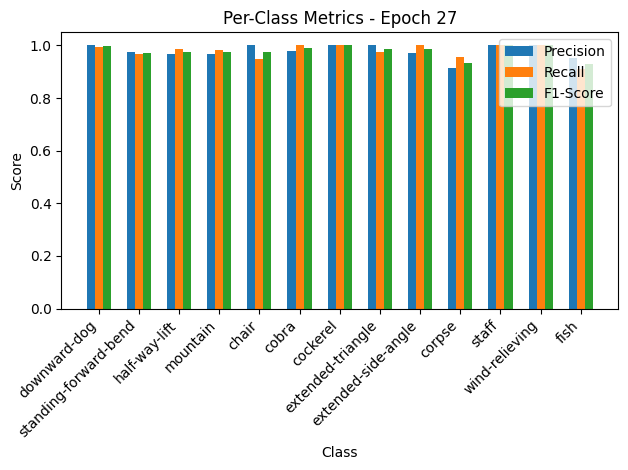


Epoch 28/50 Summary:
Train Loss: 0.0966 | Train Acc: 98.01% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1588 | Val Acc: 94.52% | Val Precision: 0.96 | Val Recall: 0.95 | Val F1: 0.95

Epoch 29/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:10<00:00,  7.52it/s, loss=0.089, accuracy=98.2]


Per-Class Metrics for Epoch 28:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=1.00, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.96, Recall=1.00, F1-Score=0.98
mountain: Precision=0.97, Recall=1.00, F1-Score=0.98
chair: Precision=0.99, Recall=0.95, F1-Score=0.97
cobra: Precision=0.99, Recall=0.99, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.93, Recall=1.00, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.93, F1-Score=0.96


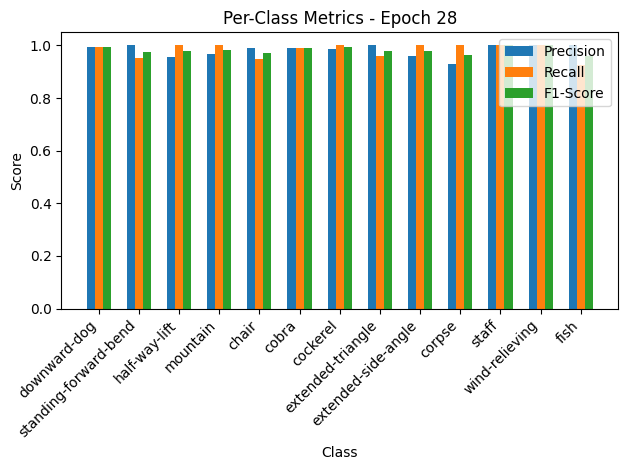

Validation: 100%|██████████| 10/10 [00:00<00:00, 21.79it/s, loss=0.138, accuracy=95.2]


Per-Class Metrics for Epoch 28:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=1.00, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.96, Recall=1.00, F1-Score=0.98
mountain: Precision=0.97, Recall=1.00, F1-Score=0.98
chair: Precision=0.99, Recall=0.95, F1-Score=0.97
cobra: Precision=0.99, Recall=0.99, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.93, Recall=1.00, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.93, F1-Score=0.96


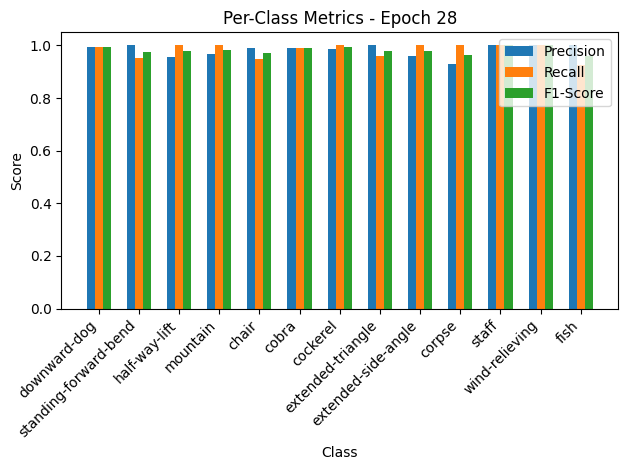


Epoch 29/50 Summary:
Train Loss: 0.0892 | Train Acc: 98.24% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1517 | Val Acc: 95.21% | Val Precision: 0.96 | Val Recall: 0.95 | Val F1: 0.96

Epoch 30/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:10<00:00,  8.05it/s, loss=0.0751, accuracy=98.5]


Per-Class Metrics for Epoch 29:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.96, Recall=1.00, F1-Score=0.98
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.92, Recall=1.00, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.91, F1-Score=0.95


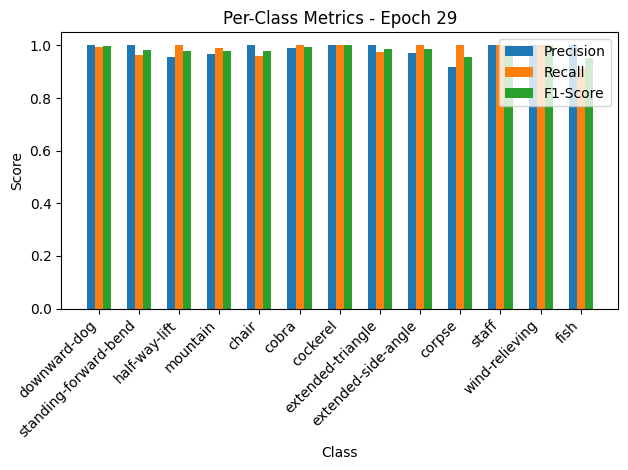

Validation: 100%|██████████| 10/10 [00:00<00:00, 22.51it/s, loss=0.141, accuracy=95.2]


Per-Class Metrics for Epoch 29:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.96, Recall=1.00, F1-Score=0.98
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.92, Recall=1.00, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.91, F1-Score=0.95


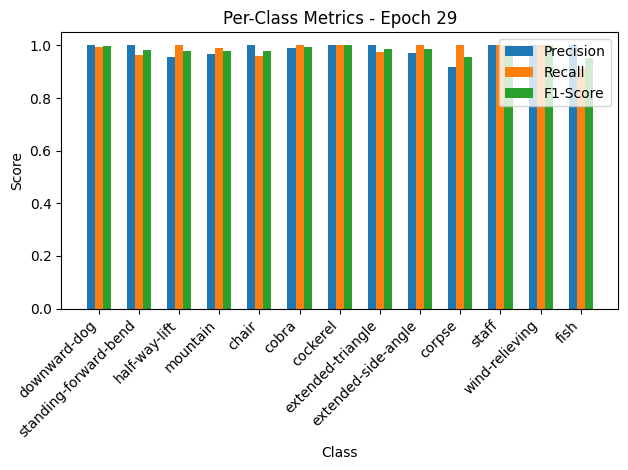


Epoch 30/50 Summary:
Train Loss: 0.0753 | Train Acc: 98.47% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1546 | Val Acc: 95.21% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 31/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:10<00:00,  7.56it/s, loss=0.0877, accuracy=98.2]


Per-Class Metrics for Epoch 30:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=0.98, F1-Score=0.98
chair: Precision=0.99, Recall=0.96, F1-Score=0.97
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.96, Recall=0.96, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.96, Recall=0.96, F1-Score=0.96


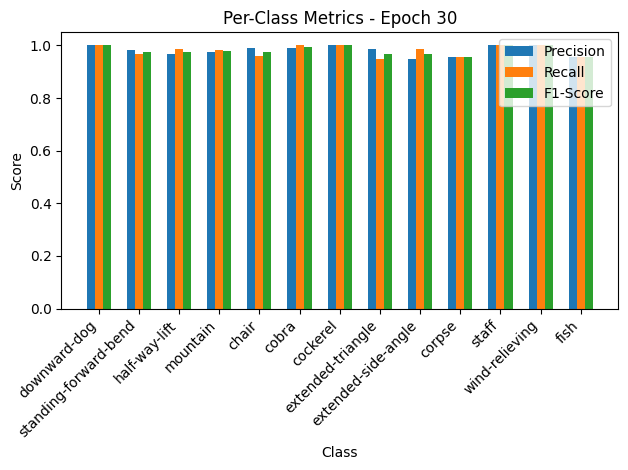

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.06it/s, loss=0.142, accuracy=95.2]


Per-Class Metrics for Epoch 30:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=0.98, F1-Score=0.98
chair: Precision=0.99, Recall=0.96, F1-Score=0.97
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.96, Recall=0.96, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.96, Recall=0.96, F1-Score=0.96


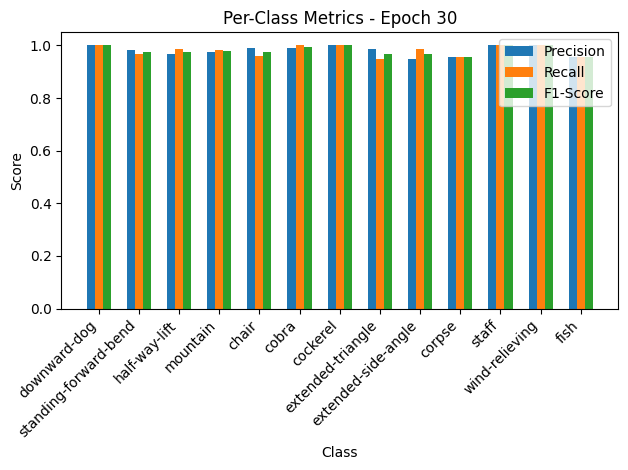


Epoch 31/50 Summary:
Train Loss: 0.0879 | Train Acc: 98.17% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1557 | Val Acc: 95.21% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 32/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:11<00:00,  7.08it/s, loss=0.0798, accuracy=98.4]


Per-Class Metrics for Epoch 31:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.98
mountain: Precision=0.96, Recall=0.98, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.99, Recall=0.99, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.93, Recall=1.00, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.93, F1-Score=0.96


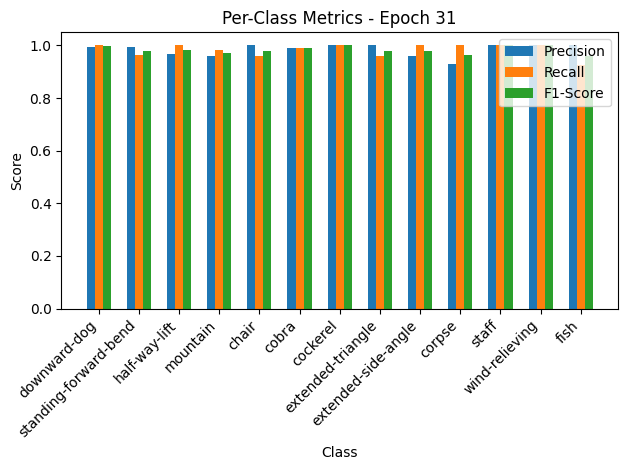

Validation: 100%|██████████| 10/10 [00:00<00:00, 25.01it/s, loss=0.143, accuracy=95.9]


Per-Class Metrics for Epoch 31:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.98
mountain: Precision=0.96, Recall=0.98, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.99, Recall=0.99, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.93, Recall=1.00, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.93, F1-Score=0.96


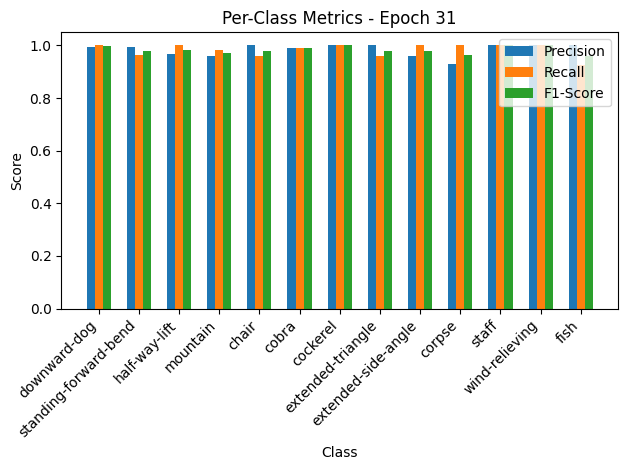


Epoch 32/50 Summary:
Train Loss: 0.0800 | Train Acc: 98.39% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1572 | Val Acc: 95.89% | Val Precision: 0.97 | Val Recall: 0.96 | Val F1: 0.97

Epoch 33/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:11<00:00,  7.08it/s, loss=0.081, accuracy=98.3]


Per-Class Metrics for Epoch 32:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.96, Recall=1.00, F1-Score=0.98
chair: Precision=0.99, Recall=0.95, F1-Score=0.97
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.94, Recall=0.99, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.94, F1-Score=0.96


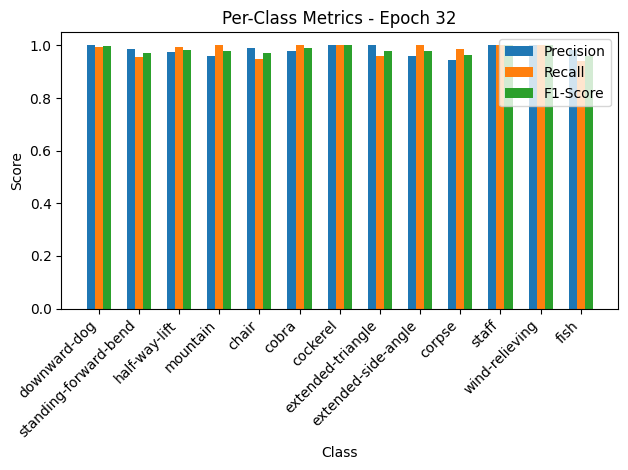

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.74it/s, loss=0.133, accuracy=95.9]


Per-Class Metrics for Epoch 32:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.96, Recall=1.00, F1-Score=0.98
chair: Precision=0.99, Recall=0.95, F1-Score=0.97
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.94, Recall=0.99, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.94, F1-Score=0.96


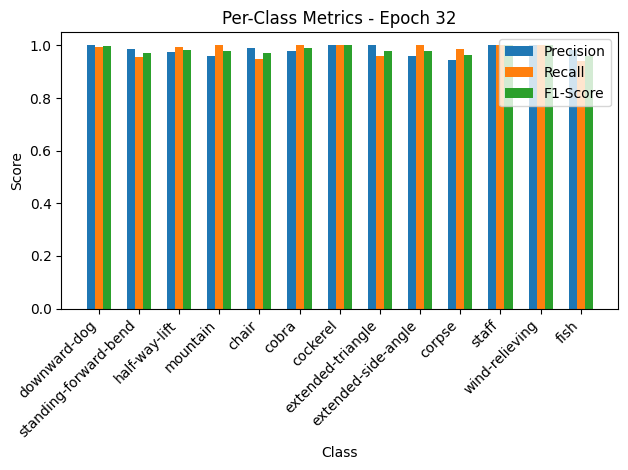


Epoch 33/50 Summary:
Train Loss: 0.0813 | Train Acc: 98.32% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1462 | Val Acc: 95.89% | Val Precision: 0.97 | Val Recall: 0.96 | Val F1: 0.97

Epoch 34/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:11<00:00,  7.13it/s, loss=0.0712, accuracy=98.6]


Per-Class Metrics for Epoch 33:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.98
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.93, Recall=0.99, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.98, Recall=0.94, F1-Score=0.96


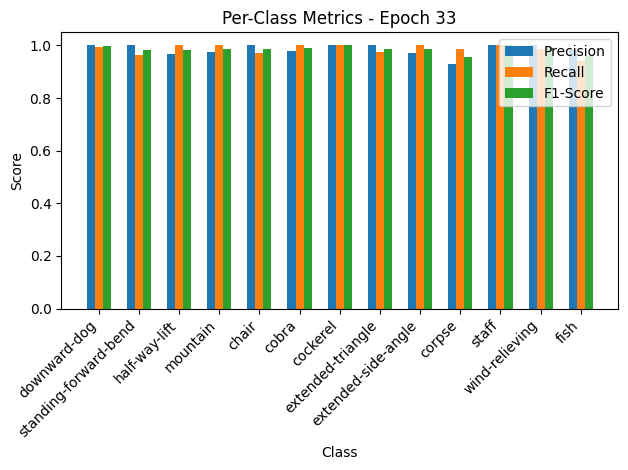

Validation: 100%|██████████| 10/10 [00:00<00:00, 25.97it/s, loss=0.138, accuracy=95.9]


Per-Class Metrics for Epoch 33:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.98
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.93, Recall=0.99, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.98, Recall=0.94, F1-Score=0.96


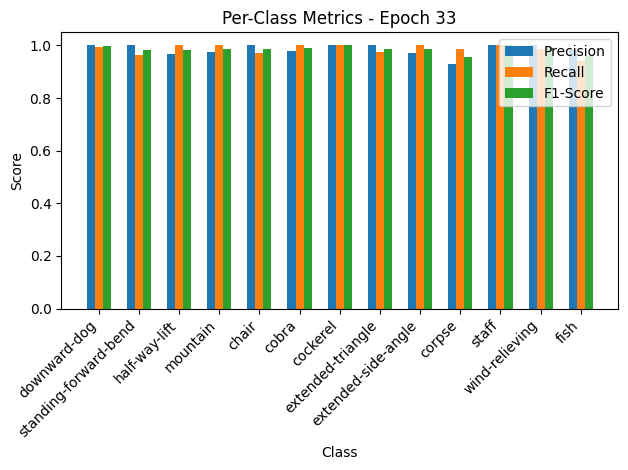


Epoch 34/50 Summary:
Train Loss: 0.0714 | Train Acc: 98.62% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1508 | Val Acc: 95.89% | Val Precision: 0.97 | Val Recall: 0.96 | Val F1: 0.97

Epoch 35/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:11<00:00,  7.25it/s, loss=0.0646, accuracy=98.9]


Per-Class Metrics for Epoch 34:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.99, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.97, F1-Score=0.98


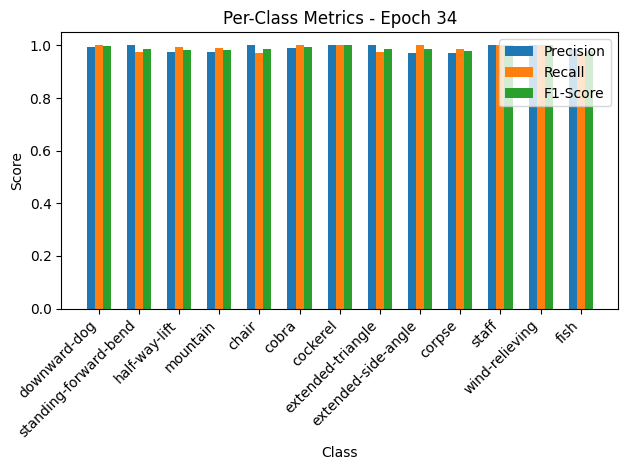

Validation: 100%|██████████| 10/10 [00:00<00:00, 20.47it/s, loss=0.131, accuracy=95.9]


Per-Class Metrics for Epoch 34:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.99, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.97, F1-Score=0.98


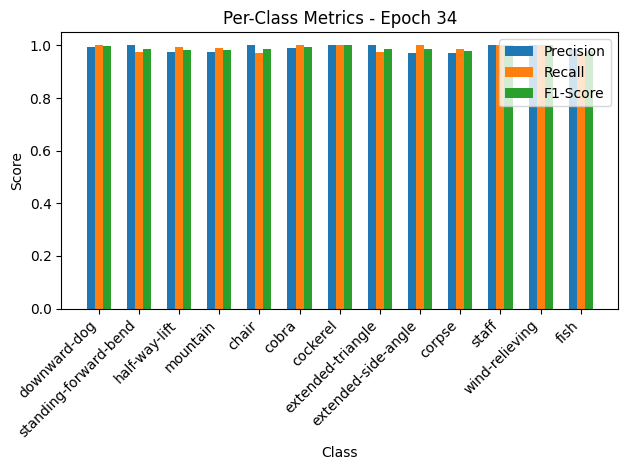


Epoch 35/50 Summary:
Train Loss: 0.0648 | Train Acc: 98.93% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1441 | Val Acc: 95.89% | Val Precision: 0.97 | Val Recall: 0.96 | Val F1: 0.97

Epoch 36/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:10<00:00,  7.62it/s, loss=0.063, accuracy=98.6]


Per-Class Metrics for Epoch 35:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.96, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.97, Recall=0.99, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.97, F1-Score=0.98


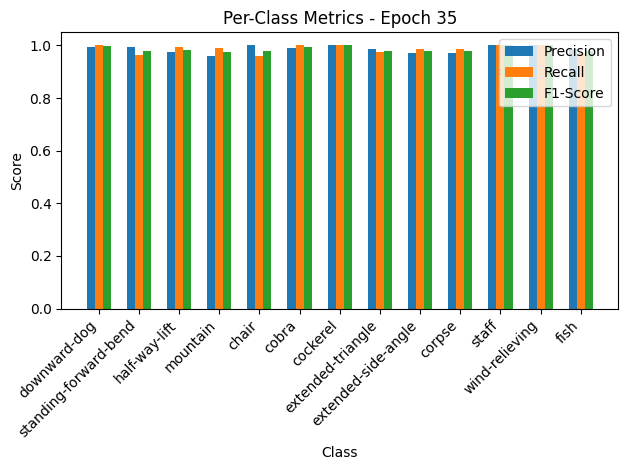

Validation: 100%|██████████| 10/10 [00:00<00:00, 24.75it/s, loss=0.135, accuracy=95.2]


Per-Class Metrics for Epoch 35:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.96, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.97, Recall=0.99, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.97, F1-Score=0.98


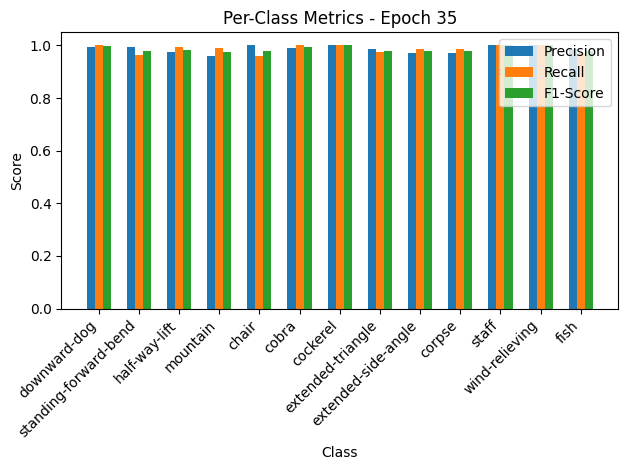


Epoch 36/50 Summary:
Train Loss: 0.0632 | Train Acc: 98.62% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1481 | Val Acc: 95.21% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 37/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:11<00:00,  7.33it/s, loss=0.074, accuracy=98.5]


Per-Class Metrics for Epoch 36:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.96, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.97, Recall=0.97, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.97, F1-Score=0.97


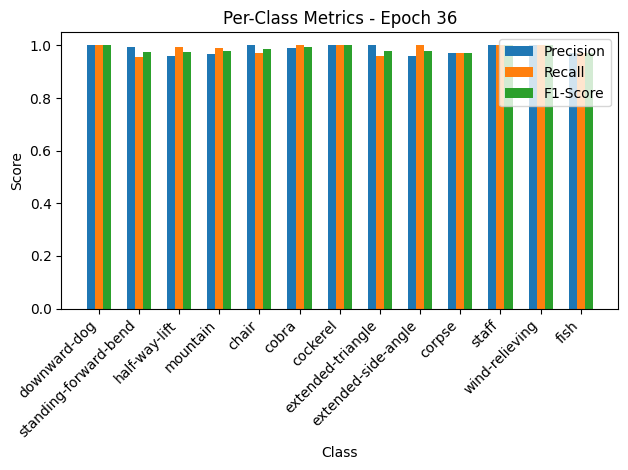

Validation: 100%|██████████| 10/10 [00:00<00:00, 26.72it/s, loss=0.141, accuracy=95.2]


Per-Class Metrics for Epoch 36:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.96, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.97, Recall=0.97, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.97, F1-Score=0.97


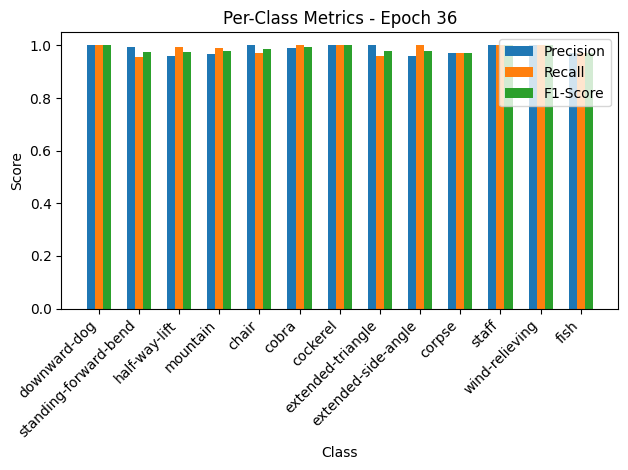


Epoch 37/50 Summary:
Train Loss: 0.0743 | Train Acc: 98.55% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1547 | Val Acc: 95.21% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 38/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:11<00:00,  7.21it/s, loss=0.0765, accuracy=98.3]


Per-Class Metrics for Epoch 37:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=1.00, F1-Score=0.98
chair: Precision=0.99, Recall=0.96, F1-Score=0.97
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.96, Recall=0.96, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.96, Recall=0.96, F1-Score=0.96


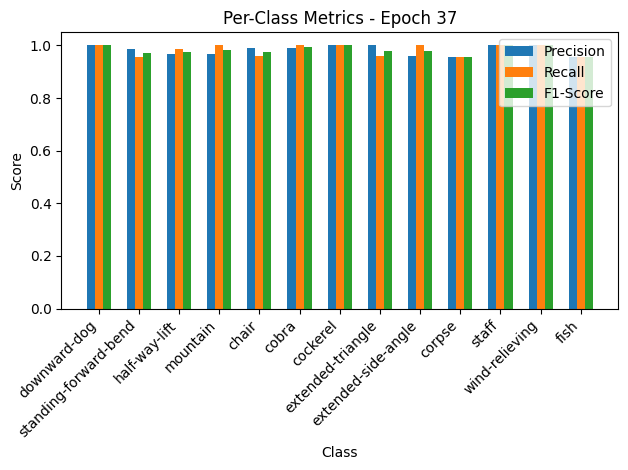

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.14it/s, loss=0.138, accuracy=95.2]


Per-Class Metrics for Epoch 37:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=1.00, F1-Score=0.98
chair: Precision=0.99, Recall=0.96, F1-Score=0.97
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.96, Recall=0.96, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.96, Recall=0.96, F1-Score=0.96


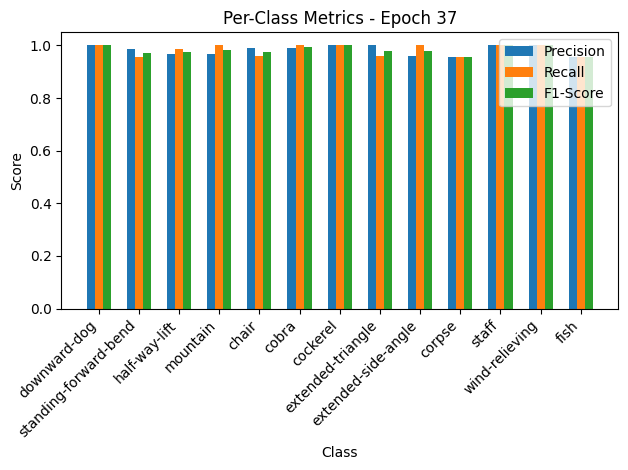


Epoch 38/50 Summary:
Train Loss: 0.0767 | Train Acc: 98.32% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1518 | Val Acc: 95.21% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 39/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:11<00:00,  7.18it/s, loss=0.0709, accuracy=98.7]


Per-Class Metrics for Epoch 38:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.99, Recall=0.99, F1-Score=0.99
mountain: Precision=0.97, Recall=1.00, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.96, Recall=0.97, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.96, F1-Score=0.96


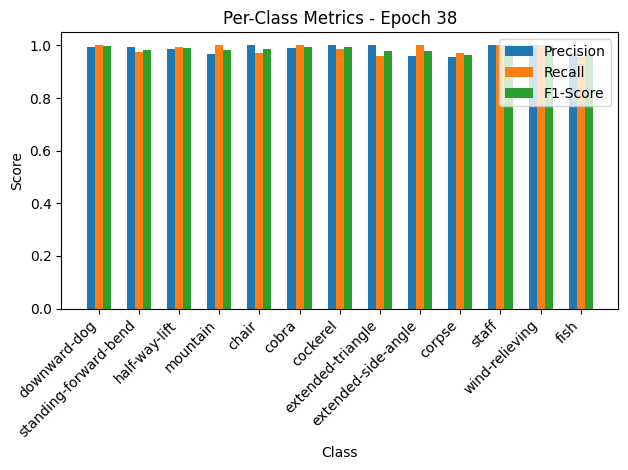

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.15it/s, loss=0.141, accuracy=95.9]


Per-Class Metrics for Epoch 38:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.99, Recall=0.99, F1-Score=0.99
mountain: Precision=0.97, Recall=1.00, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.96, Recall=0.97, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.96, F1-Score=0.96


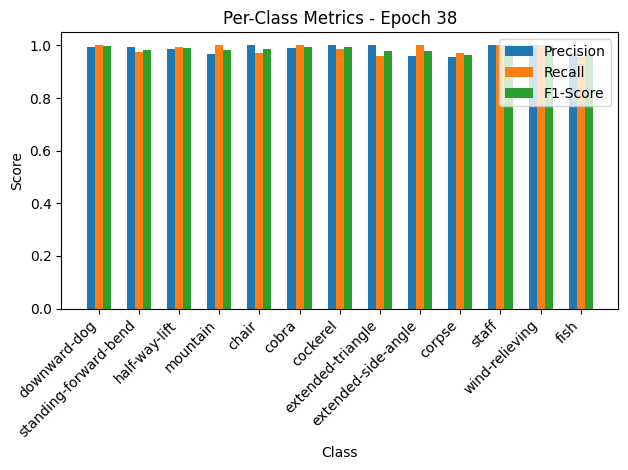


Epoch 39/50 Summary:
Train Loss: 0.0711 | Train Acc: 98.70% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1545 | Val Acc: 95.89% | Val Precision: 0.97 | Val Recall: 0.96 | Val F1: 0.97

Epoch 40/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:11<00:00,  6.89it/s, loss=0.0735, accuracy=98.5]


Per-Class Metrics for Epoch 39:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.98, F1-Score=0.98
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.94, Recall=0.99, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.94, F1-Score=0.96


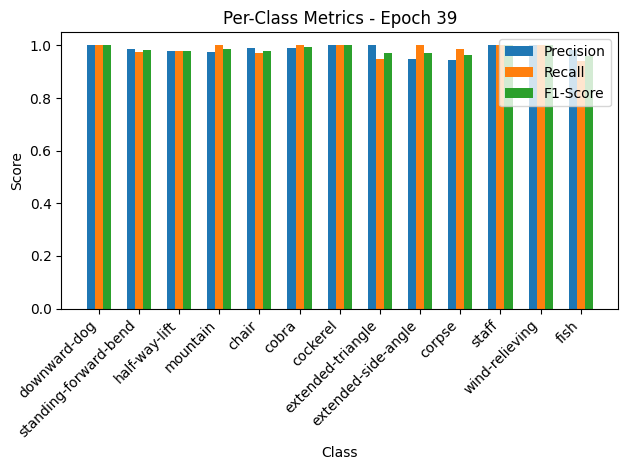

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.28it/s, loss=0.142, accuracy=95.9]


Per-Class Metrics for Epoch 39:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.98, F1-Score=0.98
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.94, Recall=0.99, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.94, F1-Score=0.96


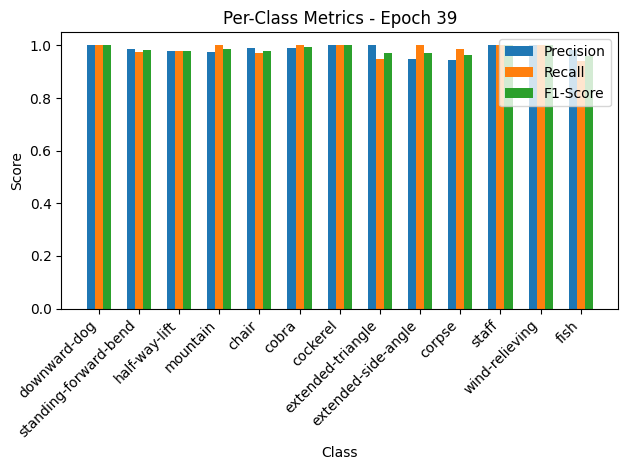


Epoch 40/50 Summary:
Train Loss: 0.0738 | Train Acc: 98.55% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1556 | Val Acc: 95.89% | Val Precision: 0.97 | Val Recall: 0.96 | Val F1: 0.97

Epoch 41/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:11<00:00,  7.20it/s, loss=0.0626, accuracy=98.9]


Per-Class Metrics for Epoch 40:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.98, Recall=1.00, F1-Score=0.99
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.96, Recall=1.00, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.96, F1-Score=0.98


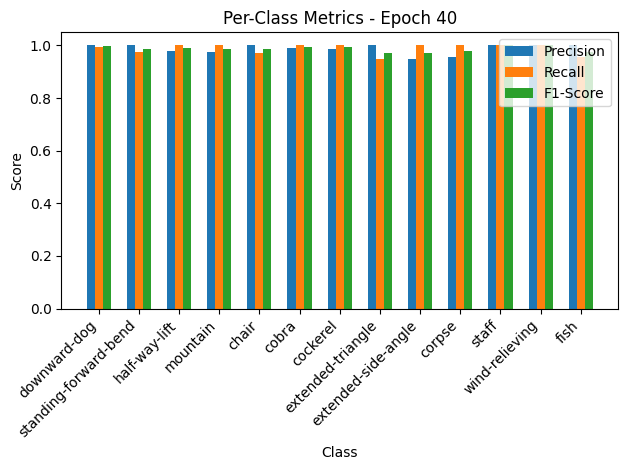

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.41it/s, loss=0.139, accuracy=95.9]


Per-Class Metrics for Epoch 40:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.98, Recall=1.00, F1-Score=0.99
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.96, Recall=1.00, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.96, F1-Score=0.98


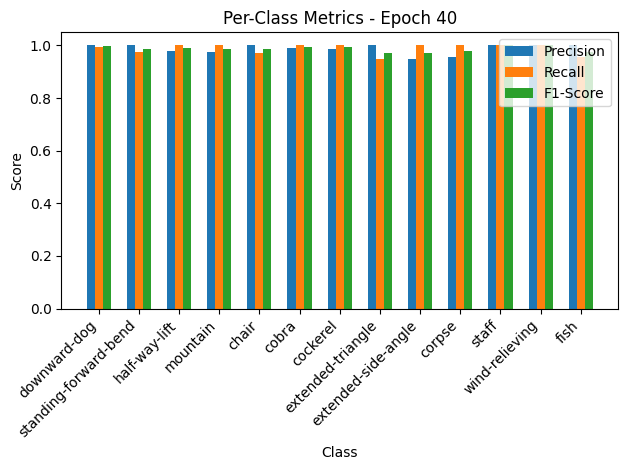


Epoch 41/50 Summary:
Train Loss: 0.0628 | Train Acc: 98.85% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1520 | Val Acc: 95.89% | Val Precision: 0.97 | Val Recall: 0.96 | Val F1: 0.97

Epoch 42/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:10<00:00,  7.50it/s, loss=0.0716, accuracy=98.5]


Per-Class Metrics for Epoch 41:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.94, Recall=1.00, F1-Score=0.97
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.94, F1-Score=0.97


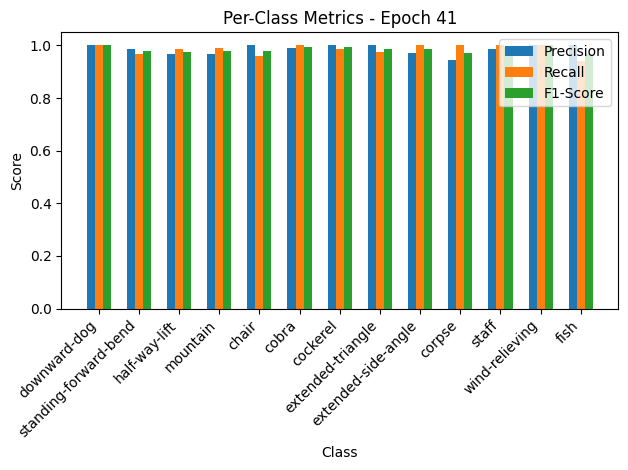

Validation: 100%|██████████| 10/10 [00:00<00:00, 25.91it/s, loss=0.134, accuracy=95.9]


Per-Class Metrics for Epoch 41:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.94, Recall=1.00, F1-Score=0.97
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.94, F1-Score=0.97


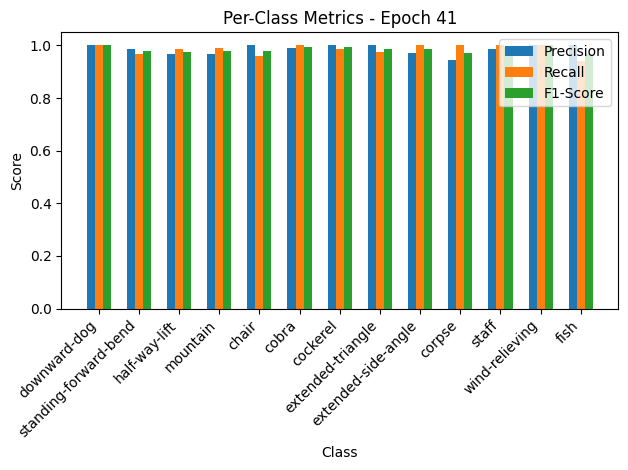


Epoch 42/50 Summary:
Train Loss: 0.0718 | Train Acc: 98.55% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1467 | Val Acc: 95.89% | Val Precision: 0.97 | Val Recall: 0.96 | Val F1: 0.97

Epoch 43/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:10<00:00,  7.66it/s, loss=0.0708, accuracy=98.7]


Per-Class Metrics for Epoch 42:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=0.99, F1-Score=0.98
chair: Precision=0.99, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.93, Recall=1.00, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.93, F1-Score=0.96


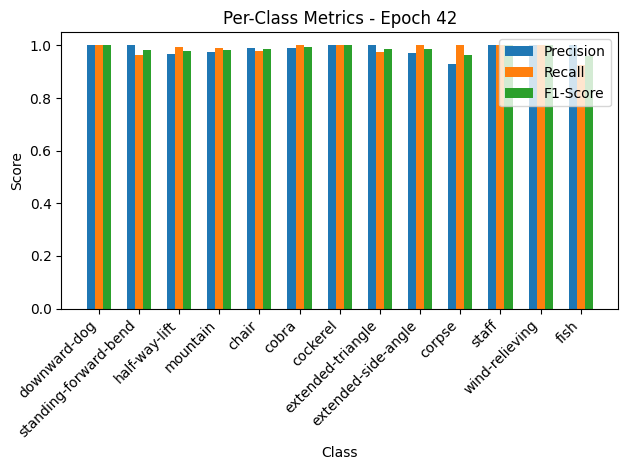

Validation: 100%|██████████| 10/10 [00:00<00:00, 26.43it/s, loss=0.134, accuracy=95.9]


Per-Class Metrics for Epoch 42:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=0.99, F1-Score=0.98
chair: Precision=0.99, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.93, Recall=1.00, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.93, F1-Score=0.96


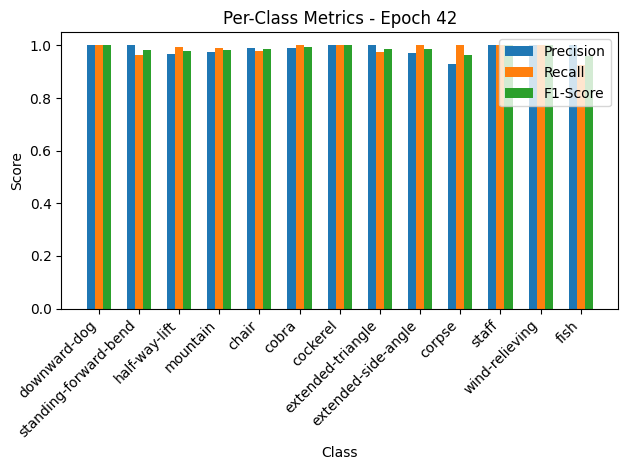


Epoch 43/50 Summary:
Train Loss: 0.0710 | Train Acc: 98.70% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1474 | Val Acc: 95.89% | Val Precision: 0.97 | Val Recall: 0.96 | Val F1: 0.97

Epoch 44/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:11<00:00,  7.23it/s, loss=0.0677, accuracy=98.8]


Per-Class Metrics for Epoch 43:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=0.99, F1-Score=0.99
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.96, Recall=0.99, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.96, F1-Score=0.98


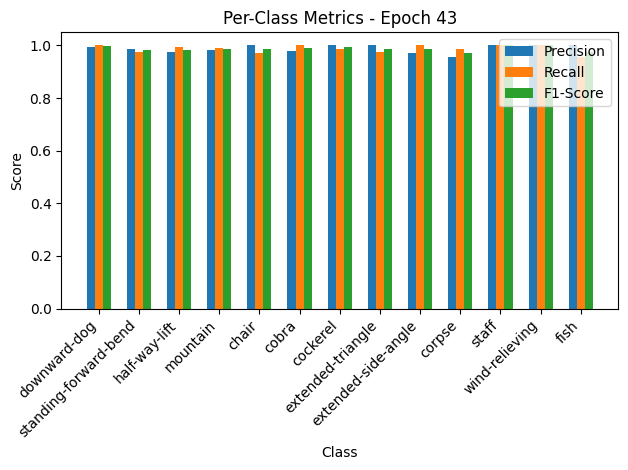

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.72it/s, loss=0.14, accuracy=95.2]


Per-Class Metrics for Epoch 43:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=0.99, F1-Score=0.99
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.96, Recall=0.99, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.96, F1-Score=0.98


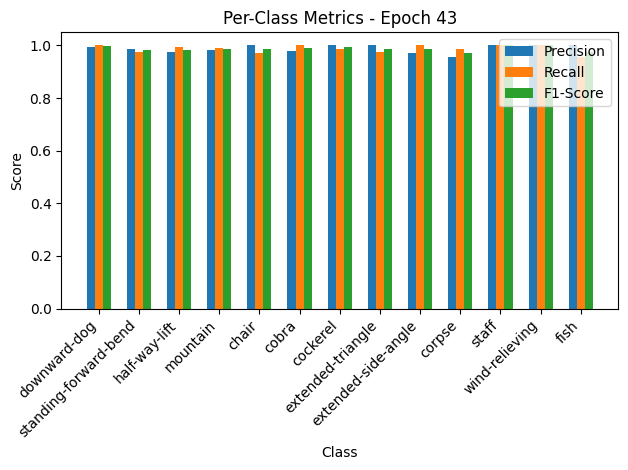


Epoch 44/50 Summary:
Train Loss: 0.0679 | Train Acc: 98.78% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1532 | Val Acc: 95.21% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 45/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:11<00:00,  6.98it/s, loss=0.074, accuracy=98.3]


Per-Class Metrics for Epoch 44:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.96, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.95, F1-Score=0.97
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.94, Recall=0.97, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.94, F1-Score=0.95


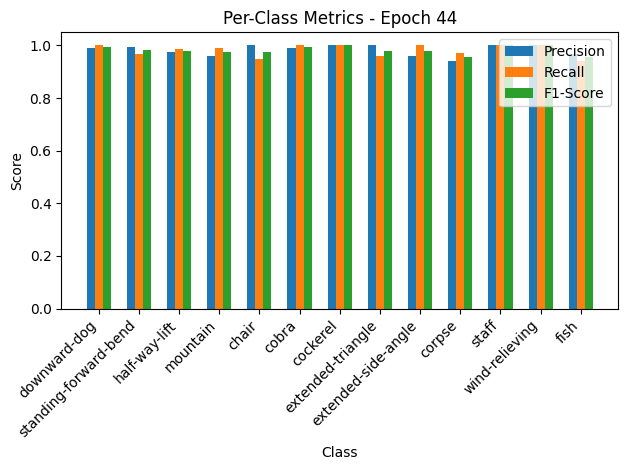

Validation: 100%|██████████| 10/10 [00:00<00:00, 28.17it/s, loss=0.141, accuracy=95.2]


Per-Class Metrics for Epoch 44:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.96, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.95, F1-Score=0.97
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.94, Recall=0.97, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.94, F1-Score=0.95


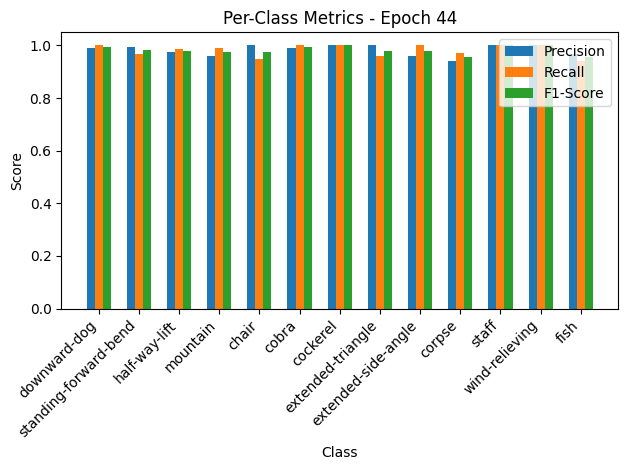


Epoch 45/50 Summary:
Train Loss: 0.0743 | Train Acc: 98.32% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1548 | Val Acc: 95.21% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 46/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:10<00:00,  7.46it/s, loss=0.0765, accuracy=98.4]


Per-Class Metrics for Epoch 45:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.93, Recall=0.97, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.93, F1-Score=0.95


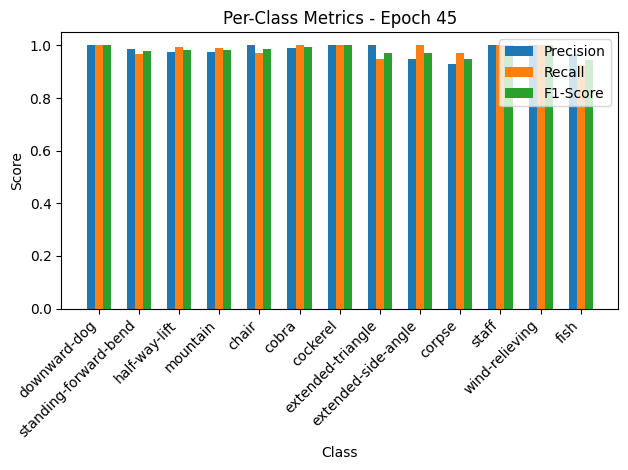

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.78it/s, loss=0.135, accuracy=95.2]


Per-Class Metrics for Epoch 45:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.93, Recall=0.97, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.93, F1-Score=0.95


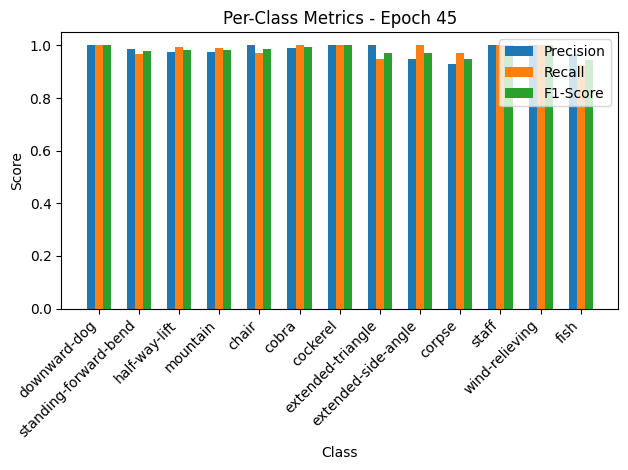


Epoch 46/50 Summary:
Train Loss: 0.0767 | Train Acc: 98.39% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1480 | Val Acc: 95.21% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 47/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:10<00:00,  7.56it/s, loss=0.0722, accuracy=98.8]


Per-Class Metrics for Epoch 46:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=1.00, F1-Score=0.98
chair: Precision=0.99, Recall=0.96, F1-Score=0.97
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.96, Recall=1.00, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.96, F1-Score=0.98


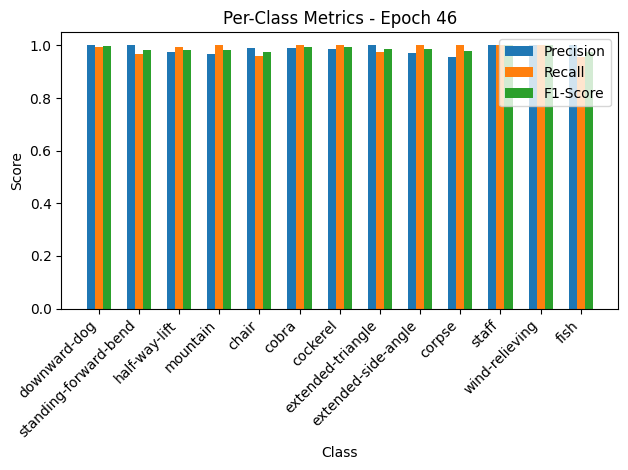

Validation: 100%|██████████| 10/10 [00:00<00:00, 22.30it/s, loss=0.142, accuracy=95.9]


Per-Class Metrics for Epoch 46:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=1.00, F1-Score=0.98
chair: Precision=0.99, Recall=0.96, F1-Score=0.97
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.96, Recall=1.00, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.96, F1-Score=0.98


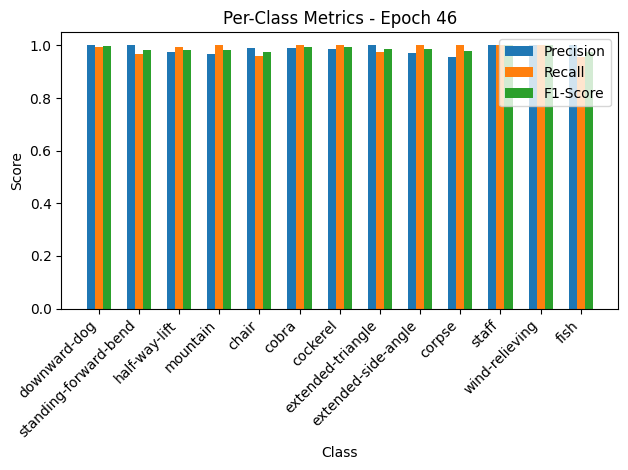


Epoch 47/50 Summary:
Train Loss: 0.0725 | Train Acc: 98.78% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1557 | Val Acc: 95.89% | Val Precision: 0.97 | Val Recall: 0.96 | Val F1: 0.97

Epoch 48/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:10<00:00,  7.60it/s, loss=0.0715, accuracy=98.8]


Per-Class Metrics for Epoch 47:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.96, Recall=1.00, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.96, F1-Score=0.98


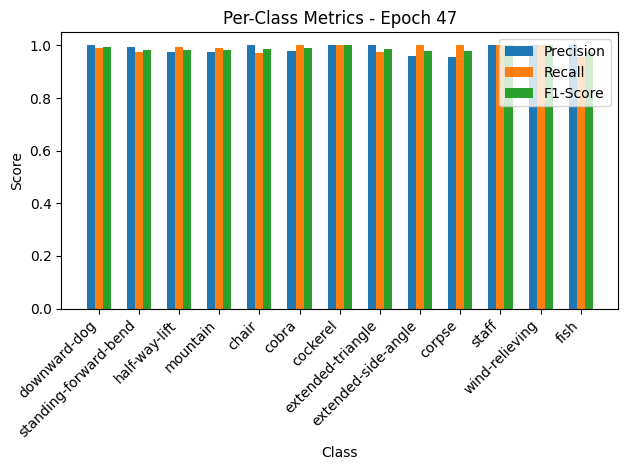

Validation: 100%|██████████| 10/10 [00:00<00:00, 22.30it/s, loss=0.143, accuracy=95.9]


Per-Class Metrics for Epoch 47:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.96, Recall=1.00, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.96, F1-Score=0.98


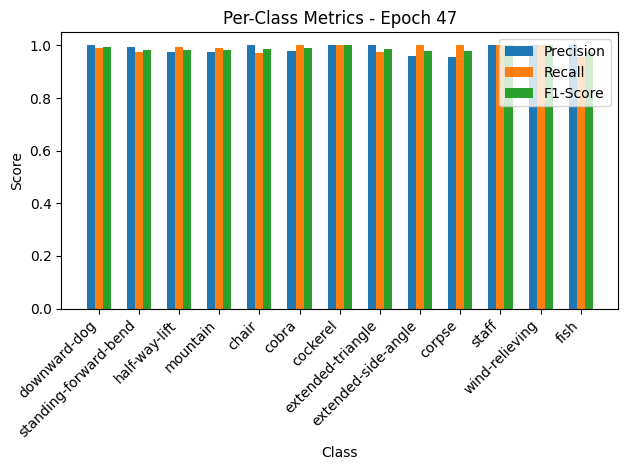


Epoch 48/50 Summary:
Train Loss: 0.0717 | Train Acc: 98.78% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1565 | Val Acc: 95.89% | Val Precision: 0.97 | Val Recall: 0.96 | Val F1: 0.97

Epoch 49/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:11<00:00,  7.39it/s, loss=0.076, accuracy=98.6]


Per-Class Metrics for Epoch 48:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.99
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=0.99, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.93, Recall=0.97, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.97, Recall=0.94, F1-Score=0.95


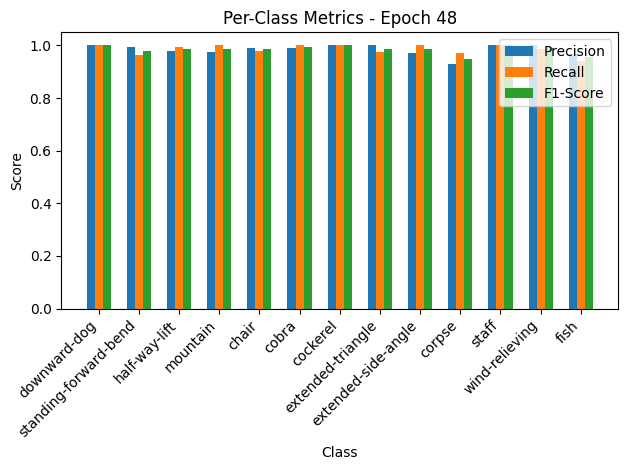

Validation: 100%|██████████| 10/10 [00:00<00:00, 26.75it/s, loss=0.136, accuracy=95.9]


Per-Class Metrics for Epoch 48:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.99
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=0.99, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.93, Recall=0.97, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.97, Recall=0.94, F1-Score=0.95


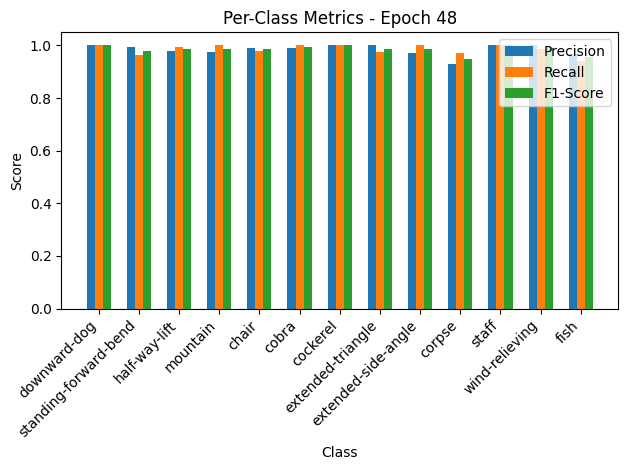


Epoch 49/50 Summary:
Train Loss: 0.0762 | Train Acc: 98.62% | Train Precision: 0.98 | Train Recall: 0.99 | Train F1: 0.98
Val Loss: 0.1495 | Val Acc: 95.89% | Val Precision: 0.97 | Val Recall: 0.96 | Val F1: 0.97

Epoch 50/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:11<00:00,  7.15it/s, loss=0.0685, accuracy=98.6]


Per-Class Metrics for Epoch 49:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.99
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.96, Recall=0.97, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.96, F1-Score=0.96


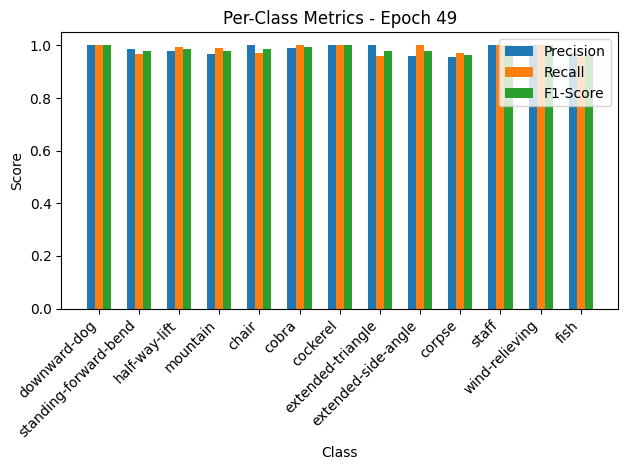

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.22it/s, loss=0.137, accuracy=95.2]


Per-Class Metrics for Epoch 49:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.99
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.96, Recall=0.97, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.96, F1-Score=0.96


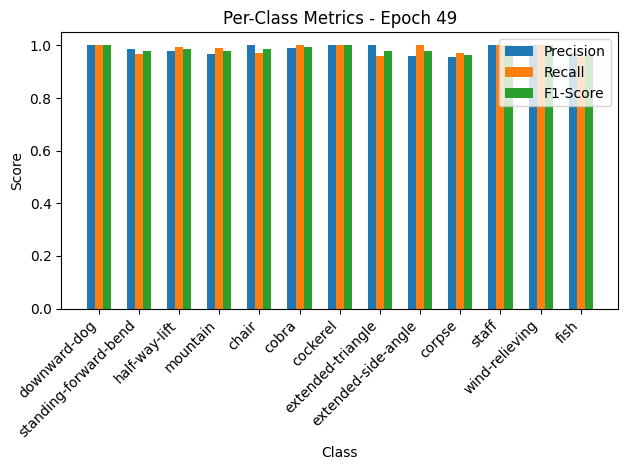


Epoch 50/50 Summary:
Train Loss: 0.0687 | Train Acc: 98.62% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1500 | Val Acc: 95.21% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96


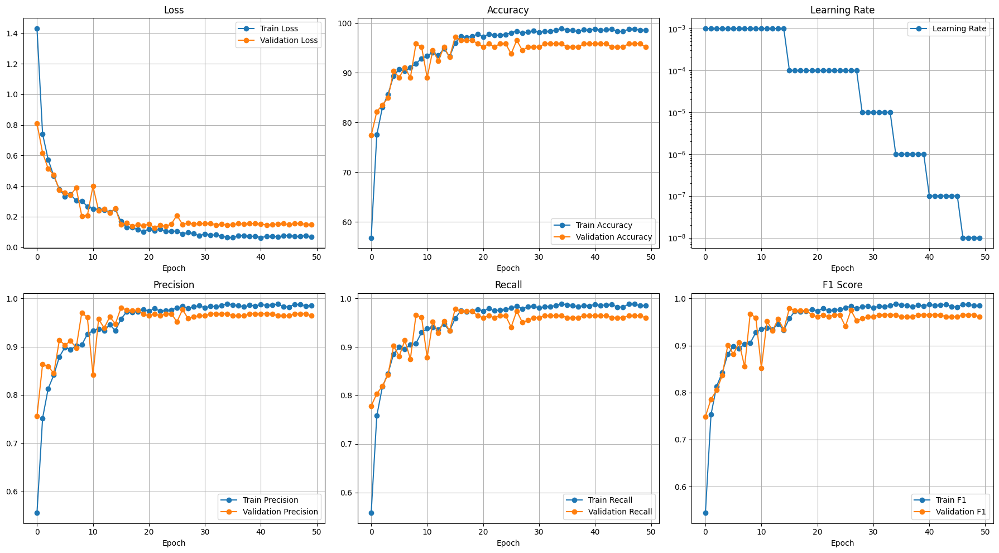

Testing: 100%|██████████| 23/23 [00:00<00:00, 24.68it/s]


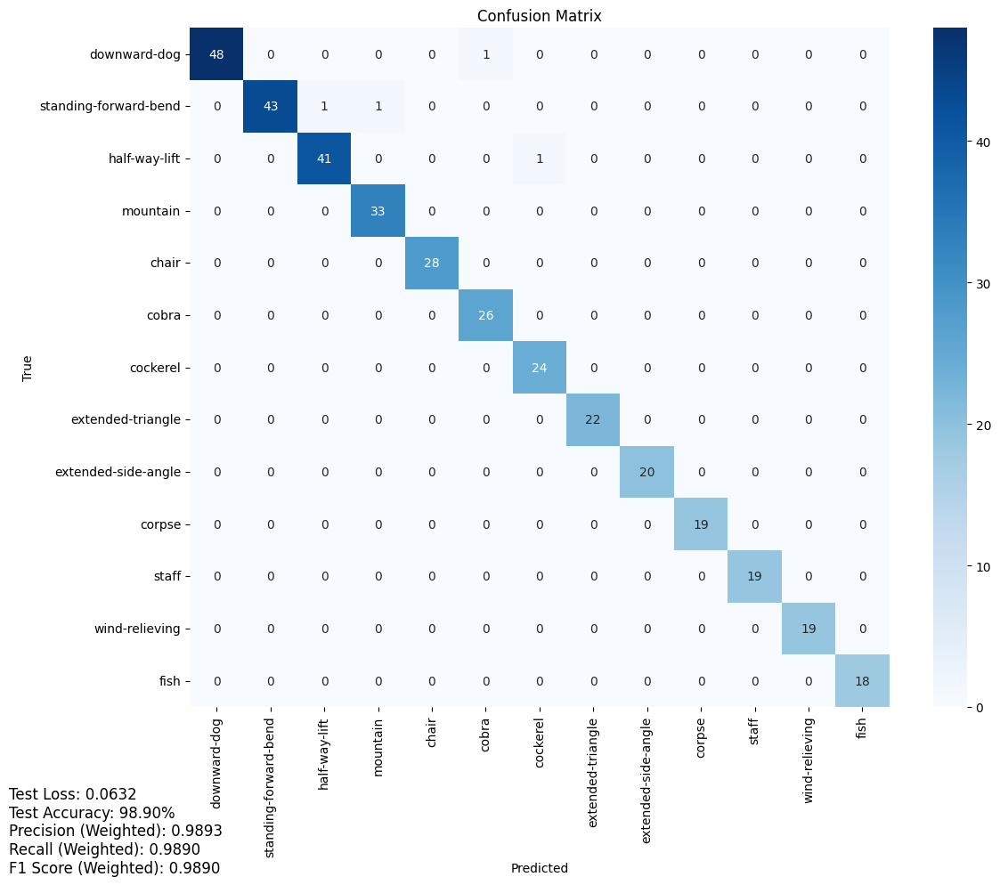

Test Loss: 0.0632
Test Accuracy: 98.90%
Precision (Weighted): 0.9893
Recall (Weighted): 0.9890
F1 Score (Weighted): 0.9890


Testing: 100%|██████████| 23/23 [00:00<00:00, 25.29it/s]


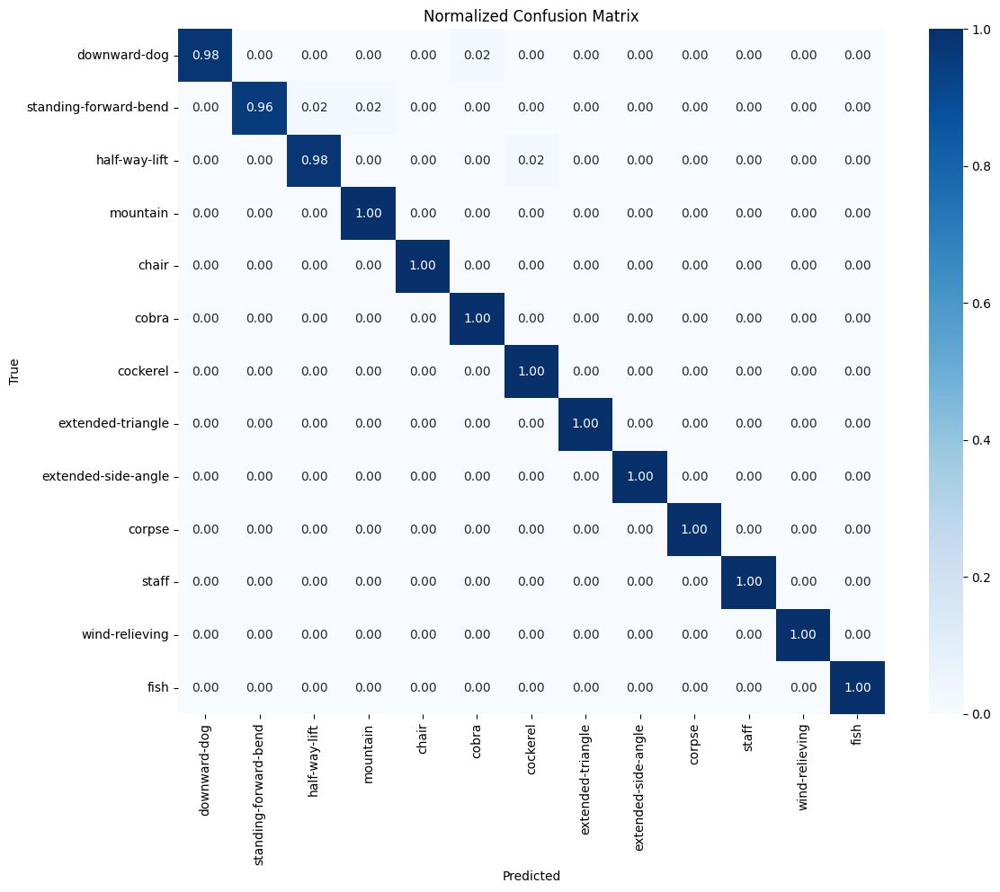

Test Loss: 0.0632
Test Accuracy: 98.90%
Precision (Macro): 0.9900
Recall (Macro): 0.9932
F1 Score (Macro): 0.9915
Saved checkpoint for fold 1
Fold 2/5
Loading cached criterion for fold 1
batch_norm.weight: 99
batch_norm.bias: 99
blocks.0.agcn.A: 3267
blocks.0.agcn.conv.weight: 1080
blocks.0.agcn.conv.bias: 360
blocks.0.agcn.batch_norm.weight: 120
blocks.0.agcn.batch_norm.bias: 120
blocks.0.sam.gs.weight: 3960
blocks.0.sam.gs.bias: 1
blocks.0.tam.gt.weight: 1080
blocks.0.tam.gt.bias: 1
blocks.0.cam.fc.0.weight: 7200
blocks.0.cam.fc.0.bias: 60
blocks.0.cam.fc.2.weight: 7200
blocks.0.cam.fc.2.bias: 120
blocks.0.mtcn.branches.0.0.weight: 2400
blocks.0.mtcn.branches.0.0.bias: 20
blocks.0.mtcn.branches.0.1.weight: 20
blocks.0.mtcn.branches.0.1.bias: 20
blocks.0.mtcn.branches.0.3.conv.weight: 1200
blocks.0.mtcn.branches.0.3.conv.bias: 20
blocks.0.mtcn.branches.0.3.bn.weight: 20
blocks.0.mtcn.branches.0.3.bn.bias: 20
blocks.0.mtcn.branches.1.0.weight: 2400
blocks.0.mtcn.branches.1.0.bias: 20
b

Training: 100%|██████████| 82/82 [00:11<00:00,  7.43it/s, loss=1.47, accuracy=54.8]


Per-Class Metrics for Epoch 0:
downward-dog: Precision=0.69, Recall=0.57, F1-Score=0.62
standing-forward-bend: Precision=0.82, Recall=0.40, F1-Score=0.53
half-way-lift: Precision=0.63, Recall=0.81, F1-Score=0.71
mountain: Precision=0.60, Recall=0.76, F1-Score=0.67
chair: Precision=0.53, Recall=0.43, F1-Score=0.47
cobra: Precision=0.50, Recall=0.61, F1-Score=0.55
cockerel: Precision=0.60, Recall=0.57, F1-Score=0.58
extended-triangle: Precision=0.39, Recall=0.38, F1-Score=0.38
extended-side-angle: Precision=0.35, Recall=0.29, F1-Score=0.32
corpse: Precision=0.34, Recall=0.32, F1-Score=0.33
staff: Precision=0.43, Recall=0.63, F1-Score=0.51
wind-relieving: Precision=0.57, Recall=0.71, F1-Score=0.63
fish: Precision=0.36, Recall=0.45, F1-Score=0.40


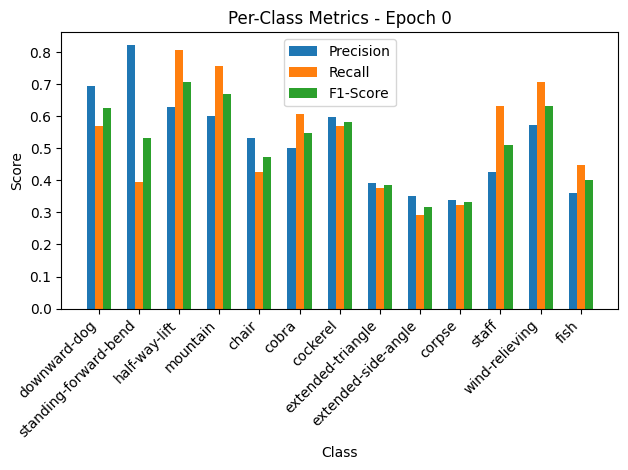

Validation: 100%|██████████| 10/10 [00:00<00:00, 22.24it/s, loss=0.857, accuracy=71.2]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 0:
downward-dog: Precision=0.69, Recall=0.57, F1-Score=0.62
standing-forward-bend: Precision=0.82, Recall=0.40, F1-Score=0.53
half-way-lift: Precision=0.63, Recall=0.81, F1-Score=0.71
mountain: Precision=0.60, Recall=0.76, F1-Score=0.67
chair: Precision=0.53, Recall=0.43, F1-Score=0.47
cobra: Precision=0.50, Recall=0.61, F1-Score=0.55
cockerel: Precision=0.60, Recall=0.57, F1-Score=0.58
extended-triangle: Precision=0.39, Recall=0.38, F1-Score=0.38
extended-side-angle: Precision=0.35, Recall=0.29, F1-Score=0.32
corpse: Precision=0.34, Recall=0.32, F1-Score=0.33
staff: Precision=0.43, Recall=0.63, F1-Score=0.51
wind-relieving: Precision=0.57, Recall=0.71, F1-Score=0.63
fish: Precision=0.36, Recall=0.45, F1-Score=0.40


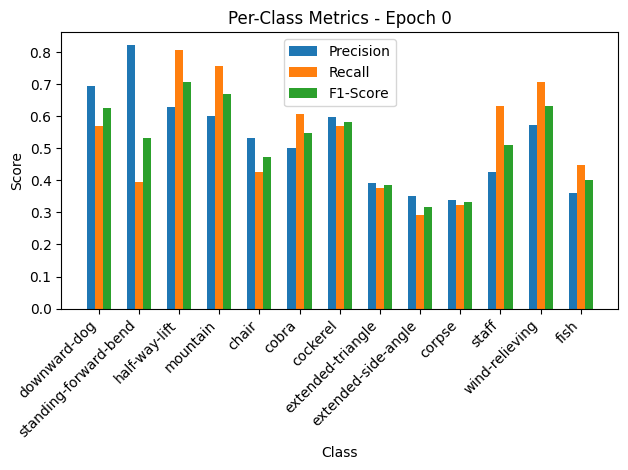


Epoch 1/50 Summary:
Train Loss: 1.4721 | Train Acc: 54.82% | Train Precision: 0.52 | Train Recall: 0.53 | Train F1: 0.52
Val Loss: 0.9395 | Val Acc: 71.23% | Val Precision: 0.73 | Val Recall: 0.71 | Val F1: 0.66
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_1.pth
Checkpoint saved at epoch 1
New best model saved! Validation Loss: 0.9395

Epoch 2/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.10it/s, loss=0.798, accuracy=76.7]


Per-Class Metrics for Epoch 1:
downward-dog: Precision=0.89, Recall=0.80, F1-Score=0.84
standing-forward-bend: Precision=0.89, Recall=0.73, F1-Score=0.80
half-way-lift: Precision=0.80, Recall=0.89, F1-Score=0.84
mountain: Precision=0.77, Recall=0.86, F1-Score=0.81
chair: Precision=0.77, Recall=0.69, F1-Score=0.73
cobra: Precision=0.75, Recall=0.90, F1-Score=0.82
cockerel: Precision=0.82, Recall=0.87, F1-Score=0.85
extended-triangle: Precision=0.61, Recall=0.70, F1-Score=0.65
extended-side-angle: Precision=0.61, Recall=0.51, F1-Score=0.56
corpse: Precision=0.52, Recall=0.35, F1-Score=0.42
staff: Precision=0.79, Recall=0.93, F1-Score=0.85
wind-relieving: Precision=0.81, Recall=0.85, F1-Score=0.83
fish: Precision=0.59, Recall=0.64, F1-Score=0.61


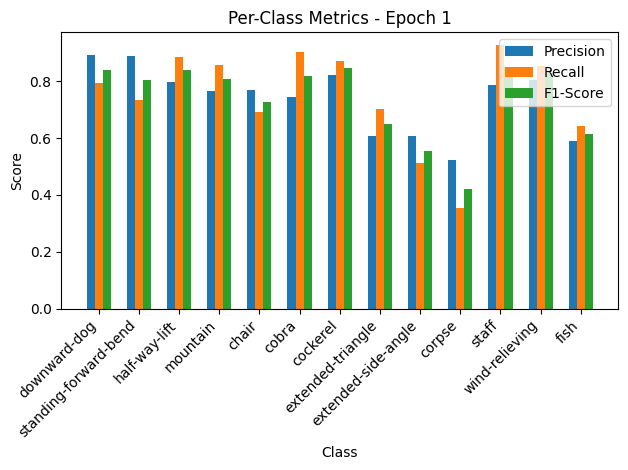

Validation: 100%|██████████| 10/10 [00:00<00:00, 20.34it/s, loss=0.543, accuracy=80.8]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 1:
downward-dog: Precision=0.89, Recall=0.80, F1-Score=0.84
standing-forward-bend: Precision=0.89, Recall=0.73, F1-Score=0.80
half-way-lift: Precision=0.80, Recall=0.89, F1-Score=0.84
mountain: Precision=0.77, Recall=0.86, F1-Score=0.81
chair: Precision=0.77, Recall=0.69, F1-Score=0.73
cobra: Precision=0.75, Recall=0.90, F1-Score=0.82
cockerel: Precision=0.82, Recall=0.87, F1-Score=0.85
extended-triangle: Precision=0.61, Recall=0.70, F1-Score=0.65
extended-side-angle: Precision=0.61, Recall=0.51, F1-Score=0.56
corpse: Precision=0.52, Recall=0.35, F1-Score=0.42
staff: Precision=0.79, Recall=0.93, F1-Score=0.85
wind-relieving: Precision=0.81, Recall=0.85, F1-Score=0.83
fish: Precision=0.59, Recall=0.64, F1-Score=0.61


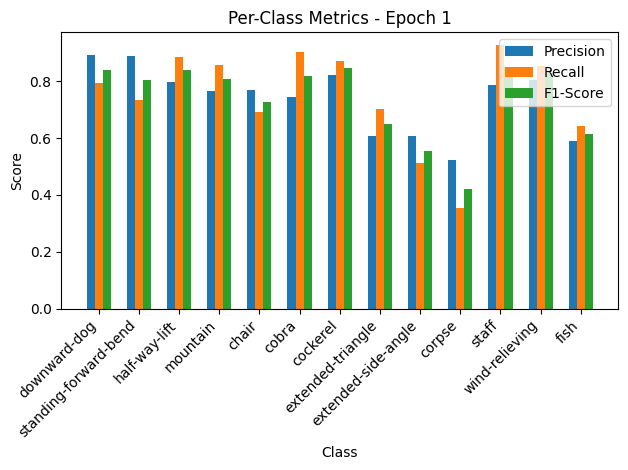


Epoch 2/50 Summary:
Train Loss: 0.8008 | Train Acc: 76.68% | Train Precision: 0.74 | Train Recall: 0.75 | Train F1: 0.74
Val Loss: 0.5952 | Val Acc: 80.82% | Val Precision: 0.76 | Val Recall: 0.78 | Val F1: 0.76
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_1.pth
Checkpoint saved at epoch 2
New best model saved! Validation Loss: 0.5952

Epoch 3/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  6.99it/s, loss=0.643, accuracy=79.1]


Per-Class Metrics for Epoch 2:
downward-dog: Precision=0.89, Recall=0.83, F1-Score=0.86
standing-forward-bend: Precision=0.85, Recall=0.72, F1-Score=0.78
half-way-lift: Precision=0.81, Recall=0.87, F1-Score=0.84
mountain: Precision=0.78, Recall=0.84, F1-Score=0.81
chair: Precision=0.68, Recall=0.66, F1-Score=0.67
cobra: Precision=0.80, Recall=0.89, F1-Score=0.84
cockerel: Precision=0.89, Recall=0.94, F1-Score=0.92
extended-triangle: Precision=0.78, Recall=0.75, F1-Score=0.77
extended-side-angle: Precision=0.69, Recall=0.75, F1-Score=0.72
corpse: Precision=0.57, Recall=0.50, F1-Score=0.53
staff: Precision=0.82, Recall=0.93, F1-Score=0.87
wind-relieving: Precision=0.91, Recall=0.93, F1-Score=0.92
fish: Precision=0.58, Recall=0.55, F1-Score=0.56


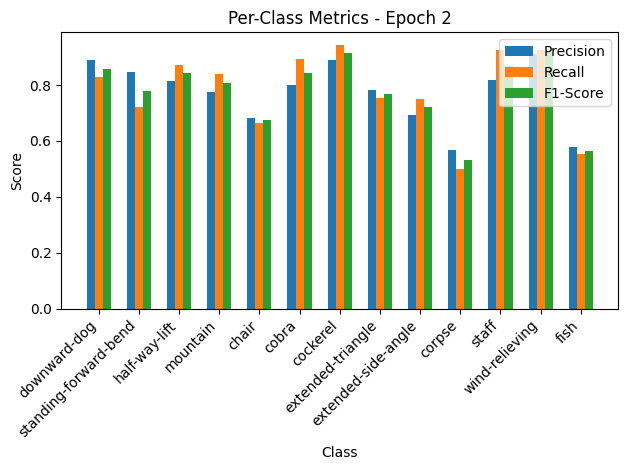

Validation: 100%|██████████| 10/10 [00:00<00:00, 26.05it/s, loss=0.56, accuracy=80.8]


Per-Class Metrics for Epoch 2:
downward-dog: Precision=0.89, Recall=0.83, F1-Score=0.86
standing-forward-bend: Precision=0.85, Recall=0.72, F1-Score=0.78
half-way-lift: Precision=0.81, Recall=0.87, F1-Score=0.84
mountain: Precision=0.78, Recall=0.84, F1-Score=0.81
chair: Precision=0.68, Recall=0.66, F1-Score=0.67
cobra: Precision=0.80, Recall=0.89, F1-Score=0.84
cockerel: Precision=0.89, Recall=0.94, F1-Score=0.92
extended-triangle: Precision=0.78, Recall=0.75, F1-Score=0.77
extended-side-angle: Precision=0.69, Recall=0.75, F1-Score=0.72
corpse: Precision=0.57, Recall=0.50, F1-Score=0.53
staff: Precision=0.82, Recall=0.93, F1-Score=0.87
wind-relieving: Precision=0.91, Recall=0.93, F1-Score=0.92
fish: Precision=0.58, Recall=0.55, F1-Score=0.56


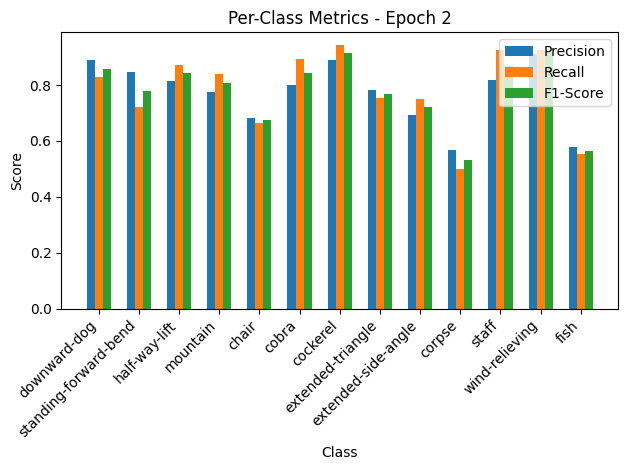


Epoch 3/50 Summary:
Train Loss: 0.6449 | Train Acc: 79.13% | Train Precision: 0.77 | Train Recall: 0.78 | Train F1: 0.78
Val Loss: 0.6140 | Val Acc: 80.82% | Val Precision: 0.82 | Val Recall: 0.78 | Val F1: 0.78

Epoch 4/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:12<00:00,  6.75it/s, loss=0.539, accuracy=84.3]


Per-Class Metrics for Epoch 3:
downward-dog: Precision=0.94, Recall=0.91, F1-Score=0.92
standing-forward-bend: Precision=0.91, Recall=0.77, F1-Score=0.83
half-way-lift: Precision=0.83, Recall=0.90, F1-Score=0.87
mountain: Precision=0.88, Recall=0.88, F1-Score=0.88
chair: Precision=0.79, Recall=0.85, F1-Score=0.82
cobra: Precision=0.88, Recall=0.94, F1-Score=0.91
cockerel: Precision=0.91, Recall=0.92, F1-Score=0.91
extended-triangle: Precision=0.77, Recall=0.73, F1-Score=0.75
extended-side-angle: Precision=0.72, Recall=0.75, F1-Score=0.73
corpse: Precision=0.66, Recall=0.69, F1-Score=0.68
staff: Precision=0.81, Recall=0.96, F1-Score=0.88
wind-relieving: Precision=0.94, Recall=0.94, F1-Score=0.94
fish: Precision=0.68, Recall=0.58, F1-Score=0.63


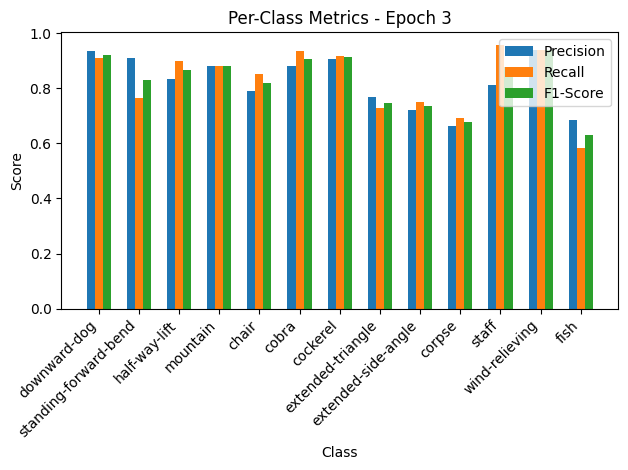

Validation: 100%|██████████| 10/10 [00:00<00:00, 26.14it/s, loss=0.322, accuracy=87.7]


Per-Class Metrics for Epoch 3:
downward-dog: Precision=0.94, Recall=0.91, F1-Score=0.92
standing-forward-bend: Precision=0.91, Recall=0.77, F1-Score=0.83
half-way-lift: Precision=0.83, Recall=0.90, F1-Score=0.87
mountain: Precision=0.88, Recall=0.88, F1-Score=0.88
chair: Precision=0.79, Recall=0.85, F1-Score=0.82
cobra: Precision=0.88, Recall=0.94, F1-Score=0.91
cockerel: Precision=0.91, Recall=0.92, F1-Score=0.91
extended-triangle: Precision=0.77, Recall=0.73, F1-Score=0.75
extended-side-angle: Precision=0.72, Recall=0.75, F1-Score=0.73
corpse: Precision=0.66, Recall=0.69, F1-Score=0.68
staff: Precision=0.81, Recall=0.96, F1-Score=0.88
wind-relieving: Precision=0.94, Recall=0.94, F1-Score=0.94
fish: Precision=0.68, Recall=0.58, F1-Score=0.63


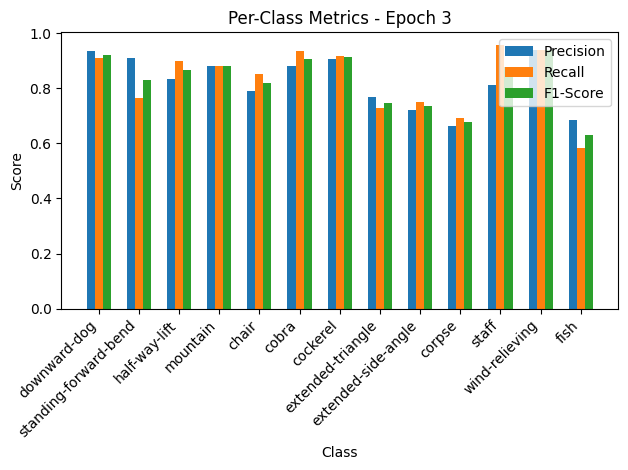


Epoch 4/50 Summary:
Train Loss: 0.5407 | Train Acc: 84.25% | Train Precision: 0.83 | Train Recall: 0.83 | Train F1: 0.83
Val Loss: 0.3531 | Val Acc: 87.67% | Val Precision: 0.87 | Val Recall: 0.87 | Val F1: 0.86
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_1.pth
Checkpoint saved at epoch 4
New best model saved! Validation Loss: 0.3531

Epoch 5/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:12<00:00,  6.72it/s, loss=0.463, accuracy=86.7]


Per-Class Metrics for Epoch 4:
downward-dog: Precision=0.95, Recall=0.94, F1-Score=0.95
standing-forward-bend: Precision=0.93, Recall=0.80, F1-Score=0.86
half-way-lift: Precision=0.80, Recall=0.88, F1-Score=0.84
mountain: Precision=0.88, Recall=0.92, F1-Score=0.90
chair: Precision=0.86, Recall=0.84, F1-Score=0.85
cobra: Precision=0.94, Recall=0.96, F1-Score=0.95
cockerel: Precision=0.93, Recall=0.95, F1-Score=0.94
extended-triangle: Precision=0.81, Recall=0.87, F1-Score=0.84
extended-side-angle: Precision=0.85, Recall=0.79, F1-Score=0.82
corpse: Precision=0.66, Recall=0.65, F1-Score=0.65
staff: Precision=0.90, Recall=0.97, F1-Score=0.94
wind-relieving: Precision=0.94, Recall=0.96, F1-Score=0.95
fish: Precision=0.65, Recall=0.61, F1-Score=0.63


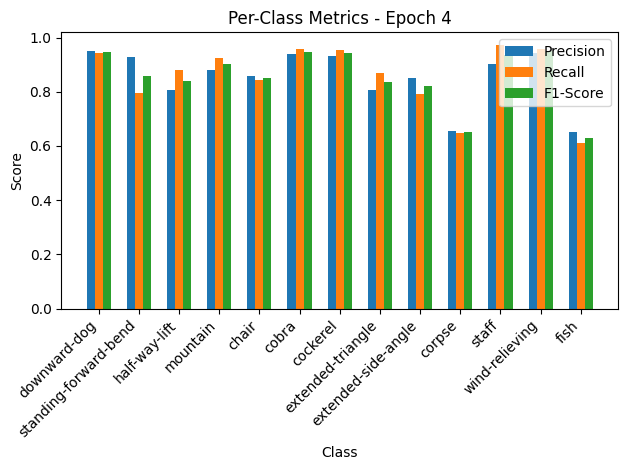

Validation: 100%|██████████| 10/10 [00:00<00:00, 26.18it/s, loss=0.29, accuracy=89]


Per-Class Metrics for Epoch 4:
downward-dog: Precision=0.95, Recall=0.94, F1-Score=0.95
standing-forward-bend: Precision=0.93, Recall=0.80, F1-Score=0.86
half-way-lift: Precision=0.80, Recall=0.88, F1-Score=0.84
mountain: Precision=0.88, Recall=0.92, F1-Score=0.90
chair: Precision=0.86, Recall=0.84, F1-Score=0.85
cobra: Precision=0.94, Recall=0.96, F1-Score=0.95
cockerel: Precision=0.93, Recall=0.95, F1-Score=0.94
extended-triangle: Precision=0.81, Recall=0.87, F1-Score=0.84
extended-side-angle: Precision=0.85, Recall=0.79, F1-Score=0.82
corpse: Precision=0.66, Recall=0.65, F1-Score=0.65
staff: Precision=0.90, Recall=0.97, F1-Score=0.94
wind-relieving: Precision=0.94, Recall=0.96, F1-Score=0.95
fish: Precision=0.65, Recall=0.61, F1-Score=0.63


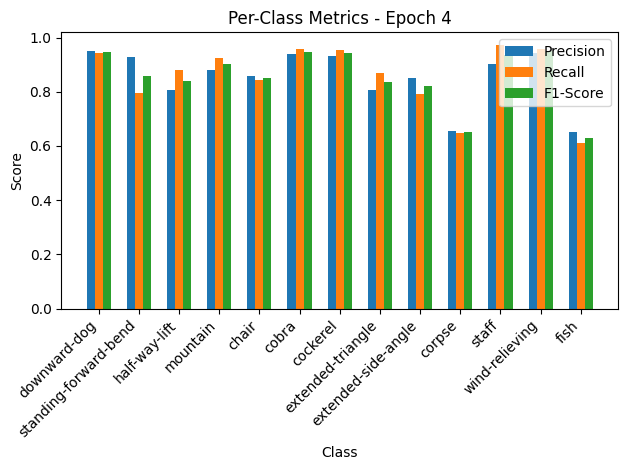


Epoch 5/50 Summary:
Train Loss: 0.4642 | Train Acc: 86.70% | Train Precision: 0.85 | Train Recall: 0.86 | Train F1: 0.85
Val Loss: 0.3182 | Val Acc: 89.04% | Val Precision: 0.90 | Val Recall: 0.89 | Val F1: 0.88
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_1.pth
Checkpoint saved at epoch 5
New best model saved! Validation Loss: 0.3182

Epoch 6/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  6.96it/s, loss=0.421, accuracy=87.4]


Per-Class Metrics for Epoch 5:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=0.91, Recall=0.80, F1-Score=0.85
half-way-lift: Precision=0.87, Recall=0.91, F1-Score=0.89
mountain: Precision=0.90, Recall=0.96, F1-Score=0.93
chair: Precision=0.87, Recall=0.89, F1-Score=0.88
cobra: Precision=0.89, Recall=0.98, F1-Score=0.93
cockerel: Precision=0.95, Recall=0.95, F1-Score=0.95
extended-triangle: Precision=0.81, Recall=0.79, F1-Score=0.80
extended-side-angle: Precision=0.74, Recall=0.78, F1-Score=0.76
corpse: Precision=0.71, Recall=0.62, F1-Score=0.66
staff: Precision=0.94, Recall=0.97, F1-Score=0.96
wind-relieving: Precision=0.98, Recall=0.96, F1-Score=0.97
fish: Precision=0.65, Recall=0.75, F1-Score=0.69


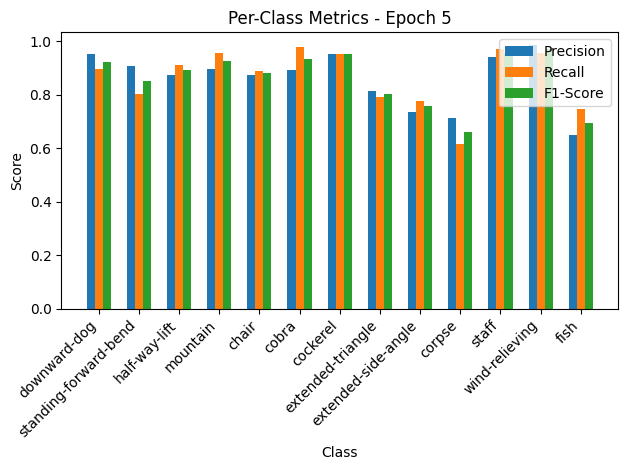

Validation: 100%|██████████| 10/10 [00:00<00:00, 26.21it/s, loss=0.271, accuracy=89]


Per-Class Metrics for Epoch 5:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=0.91, Recall=0.80, F1-Score=0.85
half-way-lift: Precision=0.87, Recall=0.91, F1-Score=0.89
mountain: Precision=0.90, Recall=0.96, F1-Score=0.93
chair: Precision=0.87, Recall=0.89, F1-Score=0.88
cobra: Precision=0.89, Recall=0.98, F1-Score=0.93
cockerel: Precision=0.95, Recall=0.95, F1-Score=0.95
extended-triangle: Precision=0.81, Recall=0.79, F1-Score=0.80
extended-side-angle: Precision=0.74, Recall=0.78, F1-Score=0.76
corpse: Precision=0.71, Recall=0.62, F1-Score=0.66
staff: Precision=0.94, Recall=0.97, F1-Score=0.96
wind-relieving: Precision=0.98, Recall=0.96, F1-Score=0.97
fish: Precision=0.65, Recall=0.75, F1-Score=0.69


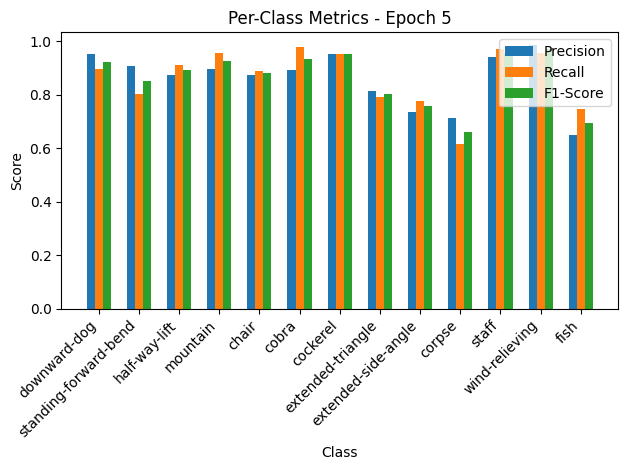


Epoch 6/50 Summary:
Train Loss: 0.4223 | Train Acc: 87.39% | Train Precision: 0.86 | Train Recall: 0.87 | Train F1: 0.86
Val Loss: 0.2974 | Val Acc: 89.04% | Val Precision: 0.91 | Val Recall: 0.87 | Val F1: 0.86
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_1.pth
Checkpoint saved at epoch 6
New best model saved! Validation Loss: 0.2974

Epoch 7/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:12<00:00,  6.82it/s, loss=0.386, accuracy=88.5]


Per-Class Metrics for Epoch 6:
downward-dog: Precision=0.95, Recall=0.92, F1-Score=0.94
standing-forward-bend: Precision=0.89, Recall=0.82, F1-Score=0.86
half-way-lift: Precision=0.83, Recall=0.90, F1-Score=0.86
mountain: Precision=0.93, Recall=0.98, F1-Score=0.96
chair: Precision=0.93, Recall=0.93, F1-Score=0.93
cobra: Precision=0.95, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.93, Recall=0.91, F1-Score=0.92
extended-triangle: Precision=0.89, Recall=0.87, F1-Score=0.88
extended-side-angle: Precision=0.85, Recall=0.88, F1-Score=0.86
corpse: Precision=0.69, Recall=0.59, F1-Score=0.63
staff: Precision=0.94, Recall=0.96, F1-Score=0.95
wind-relieving: Precision=0.94, Recall=0.94, F1-Score=0.94
fish: Precision=0.64, Recall=0.70, F1-Score=0.67


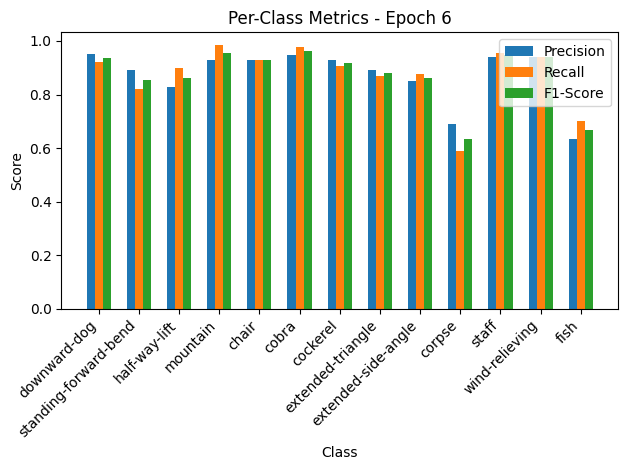

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.82it/s, loss=0.225, accuracy=94.5]


Per-Class Metrics for Epoch 6:
downward-dog: Precision=0.95, Recall=0.92, F1-Score=0.94
standing-forward-bend: Precision=0.89, Recall=0.82, F1-Score=0.86
half-way-lift: Precision=0.83, Recall=0.90, F1-Score=0.86
mountain: Precision=0.93, Recall=0.98, F1-Score=0.96
chair: Precision=0.93, Recall=0.93, F1-Score=0.93
cobra: Precision=0.95, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.93, Recall=0.91, F1-Score=0.92
extended-triangle: Precision=0.89, Recall=0.87, F1-Score=0.88
extended-side-angle: Precision=0.85, Recall=0.88, F1-Score=0.86
corpse: Precision=0.69, Recall=0.59, F1-Score=0.63
staff: Precision=0.94, Recall=0.96, F1-Score=0.95
wind-relieving: Precision=0.94, Recall=0.94, F1-Score=0.94
fish: Precision=0.64, Recall=0.70, F1-Score=0.67


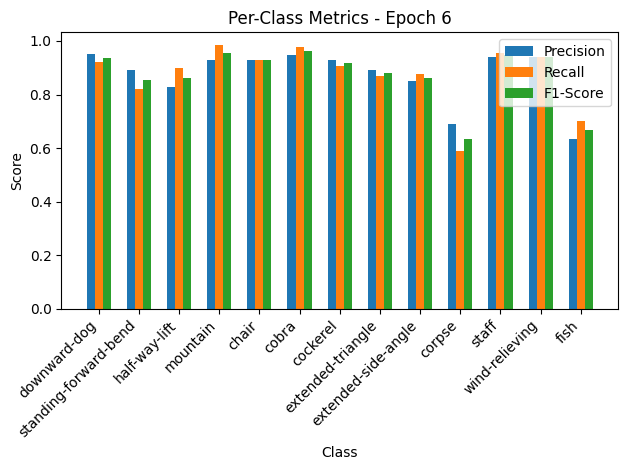


Epoch 7/50 Summary:
Train Loss: 0.3869 | Train Acc: 88.46% | Train Precision: 0.87 | Train Recall: 0.87 | Train F1: 0.87
Val Loss: 0.2470 | Val Acc: 94.52% | Val Precision: 0.94 | Val Recall: 0.95 | Val F1: 0.94
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_1.pth
Checkpoint saved at epoch 7
New best model saved! Validation Loss: 0.2470

Epoch 8/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.00it/s, loss=0.335, accuracy=90.7]


Per-Class Metrics for Epoch 7:
downward-dog: Precision=0.97, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.93, Recall=0.85, F1-Score=0.89
half-way-lift: Precision=0.90, Recall=0.91, F1-Score=0.90
mountain: Precision=0.91, Recall=0.98, F1-Score=0.94
chair: Precision=0.94, Recall=0.89, F1-Score=0.91
cobra: Precision=0.95, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-triangle: Precision=0.93, Recall=0.83, F1-Score=0.88
extended-side-angle: Precision=0.81, Recall=0.94, F1-Score=0.87
corpse: Precision=0.71, Recall=0.68, F1-Score=0.69
staff: Precision=0.97, Recall=0.99, F1-Score=0.98
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.71, Recall=0.76, F1-Score=0.73


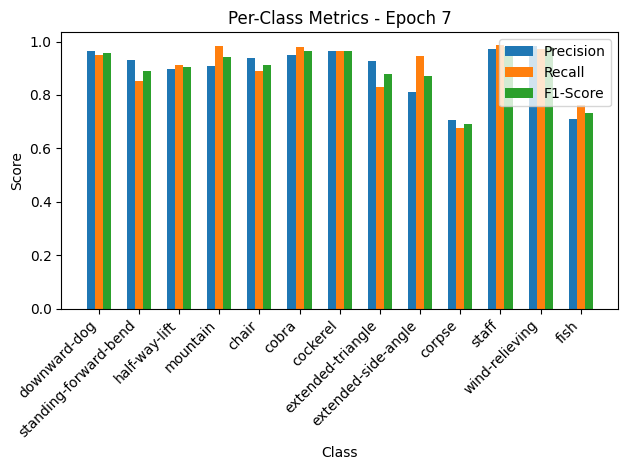

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.65it/s, loss=0.193, accuracy=94.5]


Per-Class Metrics for Epoch 7:
downward-dog: Precision=0.97, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.93, Recall=0.85, F1-Score=0.89
half-way-lift: Precision=0.90, Recall=0.91, F1-Score=0.90
mountain: Precision=0.91, Recall=0.98, F1-Score=0.94
chair: Precision=0.94, Recall=0.89, F1-Score=0.91
cobra: Precision=0.95, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-triangle: Precision=0.93, Recall=0.83, F1-Score=0.88
extended-side-angle: Precision=0.81, Recall=0.94, F1-Score=0.87
corpse: Precision=0.71, Recall=0.68, F1-Score=0.69
staff: Precision=0.97, Recall=0.99, F1-Score=0.98
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.71, Recall=0.76, F1-Score=0.73


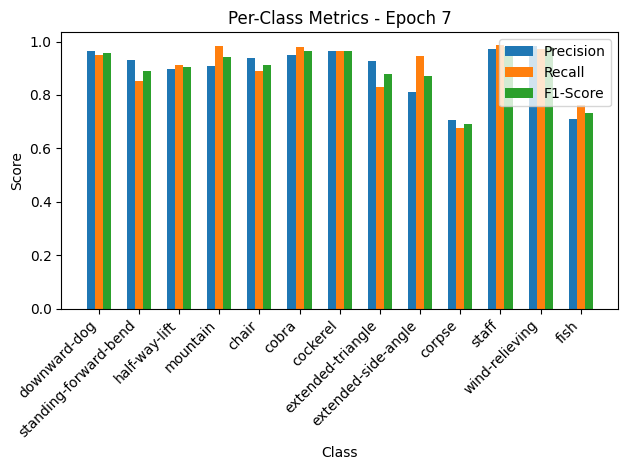


Epoch 8/50 Summary:
Train Loss: 0.3359 | Train Acc: 90.67% | Train Precision: 0.90 | Train Recall: 0.90 | Train F1: 0.90
Val Loss: 0.2112 | Val Acc: 94.52% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_1.pth
Checkpoint saved at epoch 8
New best model saved! Validation Loss: 0.2112

Epoch 9/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.53it/s, loss=0.326, accuracy=90.7]


Per-Class Metrics for Epoch 8:
downward-dog: Precision=0.98, Recall=0.93, F1-Score=0.95
standing-forward-bend: Precision=0.93, Recall=0.88, F1-Score=0.91
half-way-lift: Precision=0.92, Recall=0.94, F1-Score=0.93
mountain: Precision=0.90, Recall=0.95, F1-Score=0.93
chair: Precision=0.92, Recall=0.92, F1-Score=0.92
cobra: Precision=0.89, Recall=0.96, F1-Score=0.92
cockerel: Precision=0.92, Recall=0.97, F1-Score=0.94
extended-triangle: Precision=0.88, Recall=0.92, F1-Score=0.90
extended-side-angle: Precision=0.91, Recall=0.85, F1-Score=0.88
corpse: Precision=0.73, Recall=0.71, F1-Score=0.72
staff: Precision=0.96, Recall=0.96, F1-Score=0.96
wind-relieving: Precision=0.96, Recall=0.97, F1-Score=0.96
fish: Precision=0.73, Recall=0.73, F1-Score=0.73


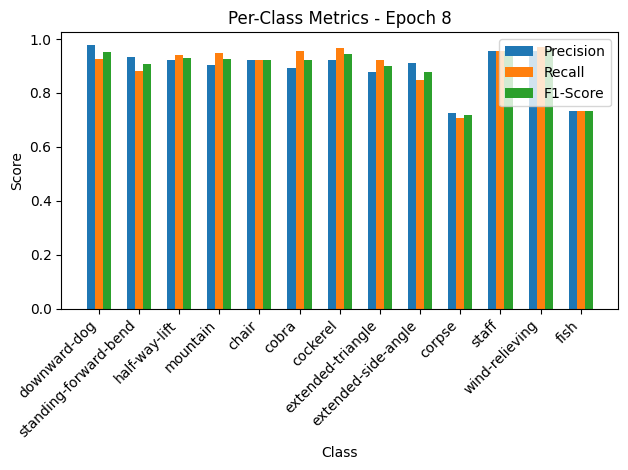

Validation: 100%|██████████| 10/10 [00:00<00:00, 20.32it/s, loss=0.2, accuracy=93.8]


Per-Class Metrics for Epoch 8:
downward-dog: Precision=0.98, Recall=0.93, F1-Score=0.95
standing-forward-bend: Precision=0.93, Recall=0.88, F1-Score=0.91
half-way-lift: Precision=0.92, Recall=0.94, F1-Score=0.93
mountain: Precision=0.90, Recall=0.95, F1-Score=0.93
chair: Precision=0.92, Recall=0.92, F1-Score=0.92
cobra: Precision=0.89, Recall=0.96, F1-Score=0.92
cockerel: Precision=0.92, Recall=0.97, F1-Score=0.94
extended-triangle: Precision=0.88, Recall=0.92, F1-Score=0.90
extended-side-angle: Precision=0.91, Recall=0.85, F1-Score=0.88
corpse: Precision=0.73, Recall=0.71, F1-Score=0.72
staff: Precision=0.96, Recall=0.96, F1-Score=0.96
wind-relieving: Precision=0.96, Recall=0.97, F1-Score=0.96
fish: Precision=0.73, Recall=0.73, F1-Score=0.73


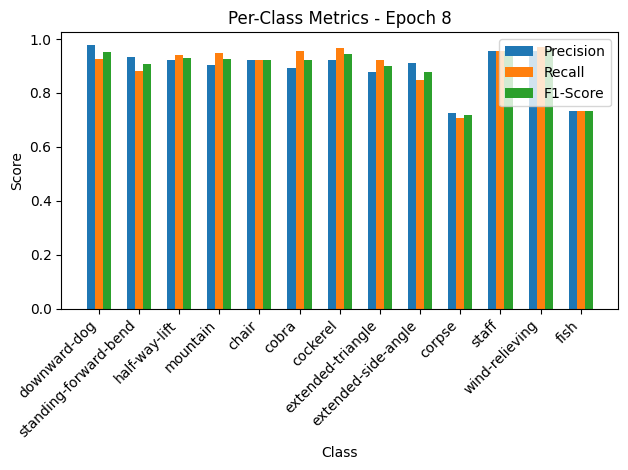


Epoch 9/50 Summary:
Train Loss: 0.3273 | Train Acc: 90.67% | Train Precision: 0.89 | Train Recall: 0.90 | Train F1: 0.90
Val Loss: 0.2187 | Val Acc: 93.84% | Val Precision: 0.94 | Val Recall: 0.95 | Val F1: 0.94

Epoch 10/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.87it/s, loss=0.318, accuracy=90.5]


Per-Class Metrics for Epoch 9:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.89, Recall=0.83, F1-Score=0.86
half-way-lift: Precision=0.85, Recall=0.93, F1-Score=0.89
mountain: Precision=0.90, Recall=0.91, F1-Score=0.90
chair: Precision=0.93, Recall=0.93, F1-Score=0.93
cobra: Precision=0.94, Recall=0.97, F1-Score=0.95
cockerel: Precision=0.94, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.91, Recall=0.86, F1-Score=0.89
corpse: Precision=0.80, Recall=0.66, F1-Score=0.73
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.71, Recall=0.81, F1-Score=0.76


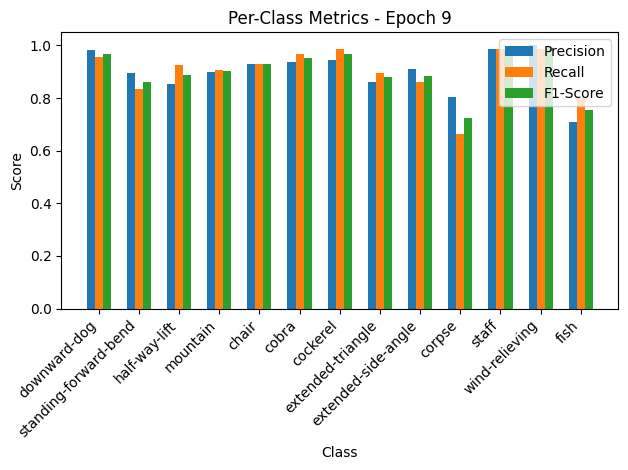

Validation: 100%|██████████| 10/10 [00:00<00:00, 25.19it/s, loss=0.174, accuracy=94.5]


Per-Class Metrics for Epoch 9:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.89, Recall=0.83, F1-Score=0.86
half-way-lift: Precision=0.85, Recall=0.93, F1-Score=0.89
mountain: Precision=0.90, Recall=0.91, F1-Score=0.90
chair: Precision=0.93, Recall=0.93, F1-Score=0.93
cobra: Precision=0.94, Recall=0.97, F1-Score=0.95
cockerel: Precision=0.94, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.86, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.91, Recall=0.86, F1-Score=0.89
corpse: Precision=0.80, Recall=0.66, F1-Score=0.73
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.71, Recall=0.81, F1-Score=0.76


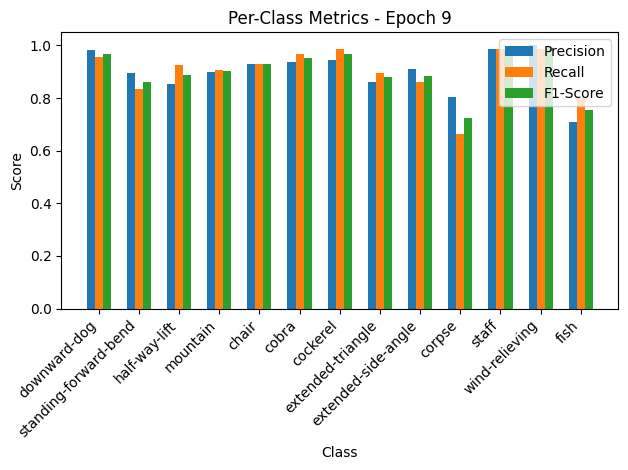


Epoch 10/50 Summary:
Train Loss: 0.3190 | Train Acc: 90.52% | Train Precision: 0.90 | Train Recall: 0.90 | Train F1: 0.90
Val Loss: 0.1906 | Val Acc: 94.52% | Val Precision: 0.96 | Val Recall: 0.95 | Val F1: 0.95
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_1.pth
Checkpoint saved at epoch 10
New best model saved! Validation Loss: 0.1906

Epoch 11/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.41it/s, loss=0.29, accuracy=91.7]


Per-Class Metrics for Epoch 10:
downward-dog: Precision=0.97, Recall=0.96, F1-Score=0.96
standing-forward-bend: Precision=0.93, Recall=0.86, F1-Score=0.90
half-way-lift: Precision=0.89, Recall=0.93, F1-Score=0.91
mountain: Precision=0.91, Recall=0.96, F1-Score=0.93
chair: Precision=0.94, Recall=0.92, F1-Score=0.93
cobra: Precision=0.94, Recall=0.97, F1-Score=0.95
cockerel: Precision=0.95, Recall=0.95, F1-Score=0.95
extended-triangle: Precision=0.97, Recall=0.91, F1-Score=0.94
extended-side-angle: Precision=0.91, Recall=0.97, F1-Score=0.94
corpse: Precision=0.74, Recall=0.72, F1-Score=0.73
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.97, F1-Score=0.99
fish: Precision=0.72, Recall=0.73, F1-Score=0.73


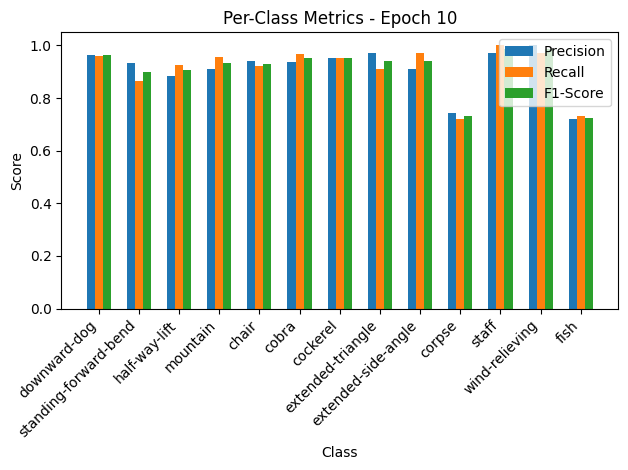

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.35it/s, loss=0.193, accuracy=91.1]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 10:
downward-dog: Precision=0.97, Recall=0.96, F1-Score=0.96
standing-forward-bend: Precision=0.93, Recall=0.86, F1-Score=0.90
half-way-lift: Precision=0.89, Recall=0.93, F1-Score=0.91
mountain: Precision=0.91, Recall=0.96, F1-Score=0.93
chair: Precision=0.94, Recall=0.92, F1-Score=0.93
cobra: Precision=0.94, Recall=0.97, F1-Score=0.95
cockerel: Precision=0.95, Recall=0.95, F1-Score=0.95
extended-triangle: Precision=0.97, Recall=0.91, F1-Score=0.94
extended-side-angle: Precision=0.91, Recall=0.97, F1-Score=0.94
corpse: Precision=0.74, Recall=0.72, F1-Score=0.73
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.97, F1-Score=0.99
fish: Precision=0.72, Recall=0.73, F1-Score=0.73


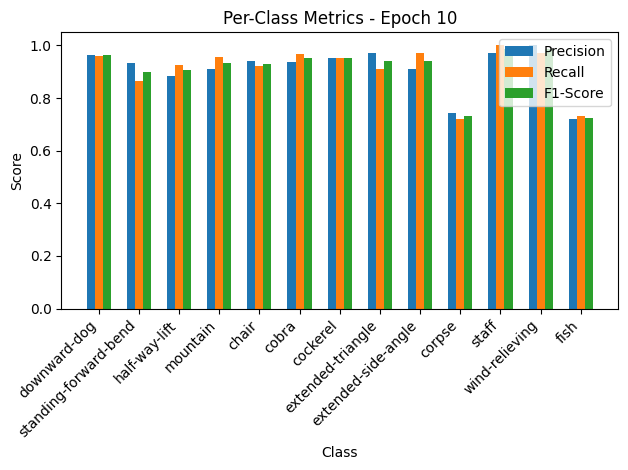


Epoch 11/50 Summary:
Train Loss: 0.2913 | Train Acc: 91.74% | Train Precision: 0.91 | Train Recall: 0.91 | Train F1: 0.91
Val Loss: 0.2114 | Val Acc: 91.10% | Val Precision: 0.85 | Val Recall: 0.89 | Val F1: 0.87

Epoch 12/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  6.94it/s, loss=0.283, accuracy=92.3]


Per-Class Metrics for Epoch 11:
downward-dog: Precision=0.98, Recall=0.94, F1-Score=0.96
standing-forward-bend: Precision=0.95, Recall=0.86, F1-Score=0.90
half-way-lift: Precision=0.91, Recall=0.93, F1-Score=0.92
mountain: Precision=0.89, Recall=0.98, F1-Score=0.93
chair: Precision=0.95, Recall=0.93, F1-Score=0.94
cobra: Precision=0.92, Recall=0.99, F1-Score=0.95
cockerel: Precision=0.95, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=0.97, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.96, F1-Score=0.95
corpse: Precision=0.77, Recall=0.65, F1-Score=0.70
staff: Precision=0.96, Recall=1.00, F1-Score=0.98
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.71, Recall=0.79, F1-Score=0.75


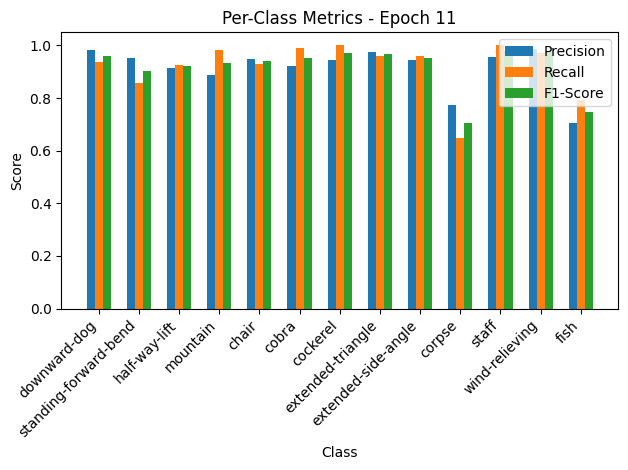

Validation: 100%|██████████| 10/10 [00:00<00:00, 29.34it/s, loss=0.162, accuracy=95.9]


Per-Class Metrics for Epoch 11:
downward-dog: Precision=0.98, Recall=0.94, F1-Score=0.96
standing-forward-bend: Precision=0.95, Recall=0.86, F1-Score=0.90
half-way-lift: Precision=0.91, Recall=0.93, F1-Score=0.92
mountain: Precision=0.89, Recall=0.98, F1-Score=0.93
chair: Precision=0.95, Recall=0.93, F1-Score=0.94
cobra: Precision=0.92, Recall=0.99, F1-Score=0.95
cockerel: Precision=0.95, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=0.97, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.96, F1-Score=0.95
corpse: Precision=0.77, Recall=0.65, F1-Score=0.70
staff: Precision=0.96, Recall=1.00, F1-Score=0.98
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.71, Recall=0.79, F1-Score=0.75


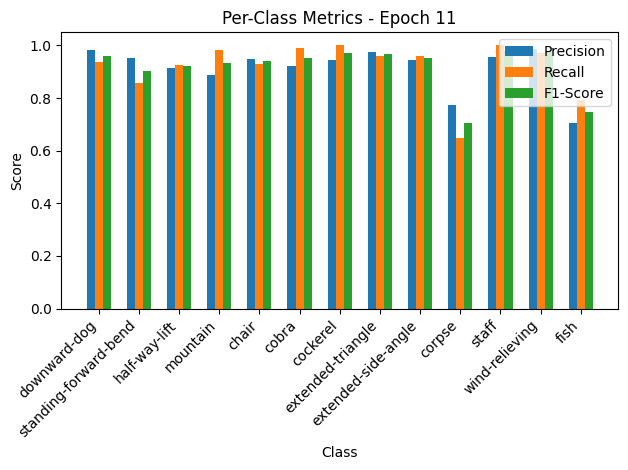


Epoch 12/50 Summary:
Train Loss: 0.2839 | Train Acc: 92.28% | Train Precision: 0.91 | Train Recall: 0.92 | Train F1: 0.92
Val Loss: 0.1771 | Val Acc: 95.89% | Val Precision: 0.97 | Val Recall: 0.96 | Val F1: 0.96
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_1.pth
Checkpoint saved at epoch 12
New best model saved! Validation Loss: 0.1771

Epoch 13/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.21it/s, loss=0.271, accuracy=92.8]


Per-Class Metrics for Epoch 12:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.86, F1-Score=0.91
half-way-lift: Precision=0.88, Recall=0.94, F1-Score=0.91
mountain: Precision=0.90, Recall=0.94, F1-Score=0.92
chair: Precision=0.92, Recall=0.93, F1-Score=0.93
cobra: Precision=0.94, Recall=0.96, F1-Score=0.95
cockerel: Precision=0.98, Recall=0.98, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.80, Recall=0.76, F1-Score=0.78
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.76, Recall=0.79, F1-Score=0.77


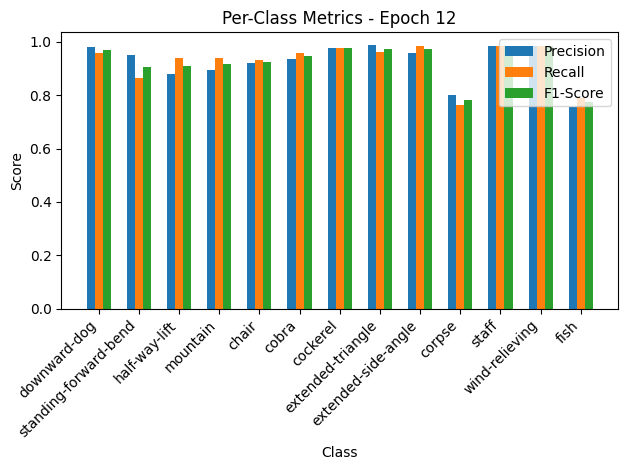

Validation: 100%|██████████| 10/10 [00:00<00:00, 25.32it/s, loss=0.362, accuracy=92.5]


Per-Class Metrics for Epoch 12:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.86, F1-Score=0.91
half-way-lift: Precision=0.88, Recall=0.94, F1-Score=0.91
mountain: Precision=0.90, Recall=0.94, F1-Score=0.92
chair: Precision=0.92, Recall=0.93, F1-Score=0.93
cobra: Precision=0.94, Recall=0.96, F1-Score=0.95
cockerel: Precision=0.98, Recall=0.98, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.80, Recall=0.76, F1-Score=0.78
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.76, Recall=0.79, F1-Score=0.77


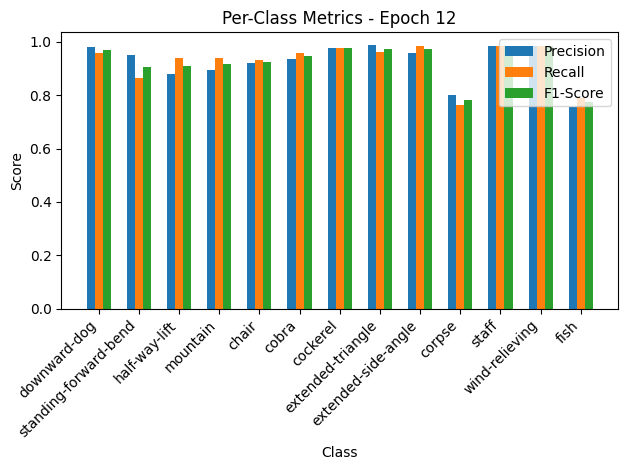


Epoch 13/50 Summary:
Train Loss: 0.2716 | Train Acc: 92.81% | Train Precision: 0.92 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.3971 | Val Acc: 92.47% | Val Precision: 0.94 | Val Recall: 0.91 | Val F1: 0.90

Epoch 14/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.50it/s, loss=0.266, accuracy=93]


Per-Class Metrics for Epoch 13:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.88, F1-Score=0.91
half-way-lift: Precision=0.92, Recall=0.95, F1-Score=0.93
mountain: Precision=0.90, Recall=0.96, F1-Score=0.93
chair: Precision=0.94, Recall=0.94, F1-Score=0.94
cobra: Precision=0.93, Recall=0.99, F1-Score=0.96
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.96, Recall=0.94, F1-Score=0.95
extended-side-angle: Precision=0.92, Recall=0.94, F1-Score=0.93
corpse: Precision=0.76, Recall=0.79, F1-Score=0.78
staff: Precision=0.97, Recall=0.99, F1-Score=0.98
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.77, Recall=0.72, F1-Score=0.74


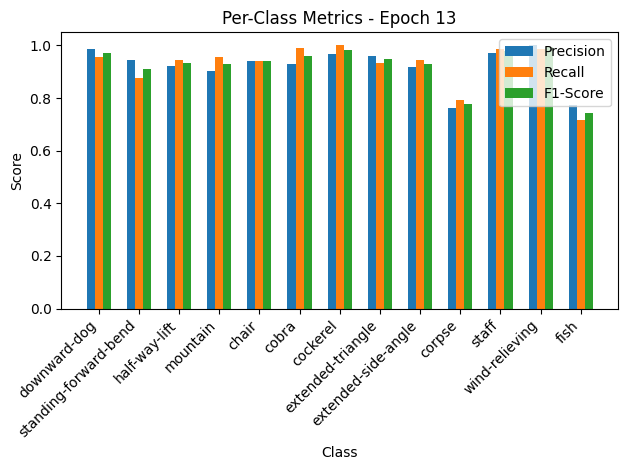

Validation: 100%|██████████| 10/10 [00:00<00:00, 29.30it/s, loss=0.166, accuracy=94.5]


Per-Class Metrics for Epoch 13:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.88, F1-Score=0.91
half-way-lift: Precision=0.92, Recall=0.95, F1-Score=0.93
mountain: Precision=0.90, Recall=0.96, F1-Score=0.93
chair: Precision=0.94, Recall=0.94, F1-Score=0.94
cobra: Precision=0.93, Recall=0.99, F1-Score=0.96
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.96, Recall=0.94, F1-Score=0.95
extended-side-angle: Precision=0.92, Recall=0.94, F1-Score=0.93
corpse: Precision=0.76, Recall=0.79, F1-Score=0.78
staff: Precision=0.97, Recall=0.99, F1-Score=0.98
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.77, Recall=0.72, F1-Score=0.74


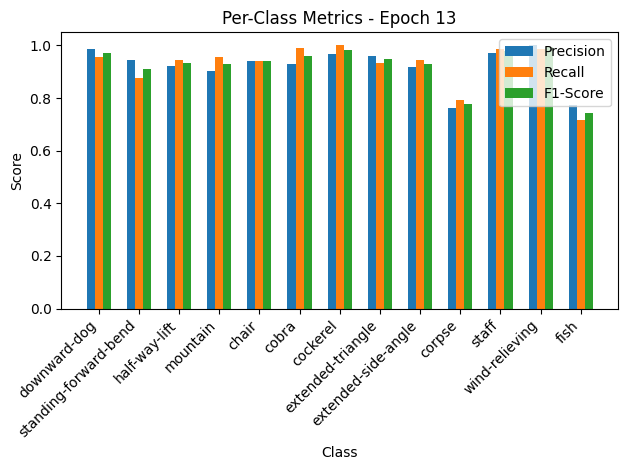


Epoch 14/50 Summary:
Train Loss: 0.2671 | Train Acc: 92.97% | Train Precision: 0.92 | Train Recall: 0.93 | Train F1: 0.92
Val Loss: 0.1820 | Val Acc: 94.52% | Val Precision: 0.95 | Val Recall: 0.94 | Val F1: 0.94

Epoch 15/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.88it/s, loss=0.263, accuracy=92.3]


Per-Class Metrics for Epoch 14:
downward-dog: Precision=0.97, Recall=0.96, F1-Score=0.96
standing-forward-bend: Precision=0.93, Recall=0.86, F1-Score=0.90
half-way-lift: Precision=0.91, Recall=0.93, F1-Score=0.92
mountain: Precision=0.91, Recall=0.98, F1-Score=0.95
chair: Precision=0.98, Recall=0.93, F1-Score=0.95
cobra: Precision=0.93, Recall=0.98, F1-Score=0.95
cockerel: Precision=0.96, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.88, Recall=0.95, F1-Score=0.91
extended-side-angle: Precision=0.92, Recall=0.85, F1-Score=0.88
corpse: Precision=0.78, Recall=0.78, F1-Score=0.78
staff: Precision=0.96, Recall=0.96, F1-Score=0.96
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.79, Recall=0.78, F1-Score=0.78


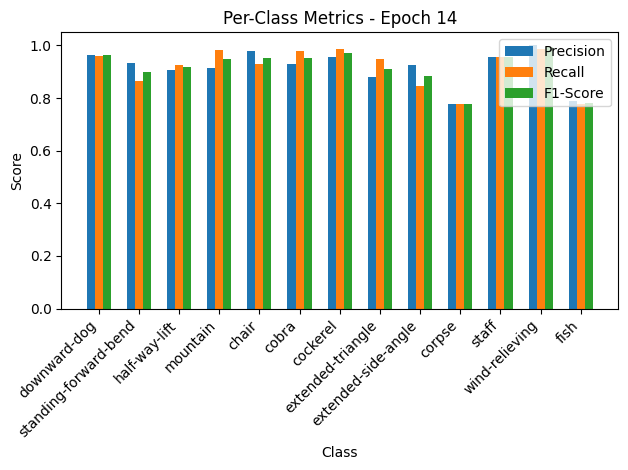

Validation: 100%|██████████| 10/10 [00:00<00:00, 20.95it/s, loss=0.16, accuracy=94.5]


Per-Class Metrics for Epoch 14:
downward-dog: Precision=0.97, Recall=0.96, F1-Score=0.96
standing-forward-bend: Precision=0.93, Recall=0.86, F1-Score=0.90
half-way-lift: Precision=0.91, Recall=0.93, F1-Score=0.92
mountain: Precision=0.91, Recall=0.98, F1-Score=0.95
chair: Precision=0.98, Recall=0.93, F1-Score=0.95
cobra: Precision=0.93, Recall=0.98, F1-Score=0.95
cockerel: Precision=0.96, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.88, Recall=0.95, F1-Score=0.91
extended-side-angle: Precision=0.92, Recall=0.85, F1-Score=0.88
corpse: Precision=0.78, Recall=0.78, F1-Score=0.78
staff: Precision=0.96, Recall=0.96, F1-Score=0.96
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.79, Recall=0.78, F1-Score=0.78


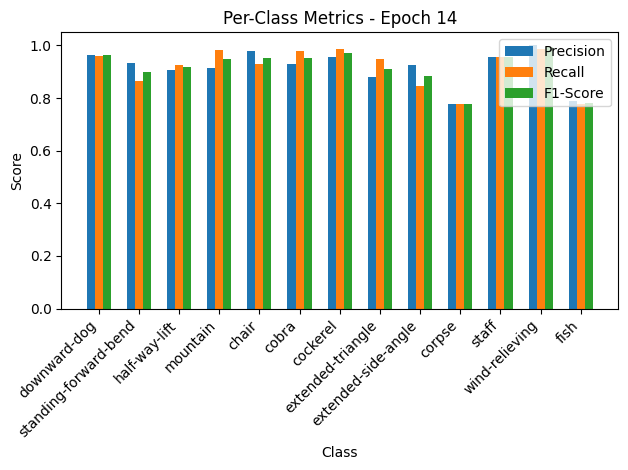


Epoch 15/50 Summary:
Train Loss: 0.2640 | Train Acc: 92.28% | Train Precision: 0.92 | Train Recall: 0.92 | Train F1: 0.92
Val Loss: 0.1750 | Val Acc: 94.52% | Val Precision: 0.94 | Val Recall: 0.95 | Val F1: 0.94
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_1.pth
Checkpoint saved at epoch 15
New best model saved! Validation Loss: 0.1750

Epoch 16/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.52it/s, loss=0.26, accuracy=93.2]


Per-Class Metrics for Epoch 15:
downward-dog: Precision=0.97, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.86, F1-Score=0.90
half-way-lift: Precision=0.91, Recall=0.94, F1-Score=0.92
mountain: Precision=0.92, Recall=0.97, F1-Score=0.95
chair: Precision=0.94, Recall=0.92, F1-Score=0.93
cobra: Precision=0.95, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.93, Recall=0.90, F1-Score=0.91
extended-side-angle: Precision=0.88, Recall=0.93, F1-Score=0.91
corpse: Precision=0.86, Recall=0.79, F1-Score=0.82
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.80, Recall=0.88, F1-Score=0.84


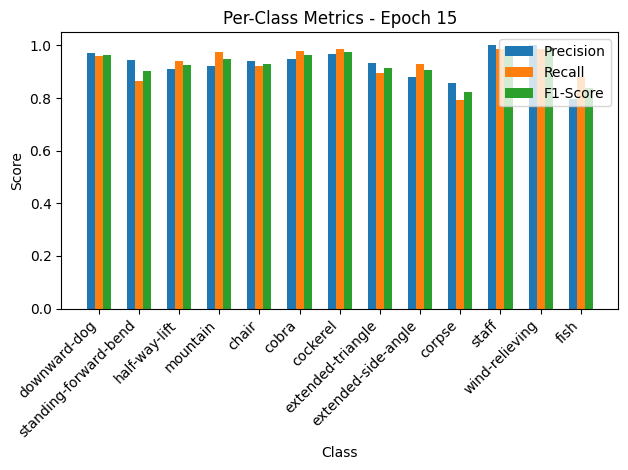

Validation: 100%|██████████| 10/10 [00:00<00:00, 23.20it/s, loss=0.239, accuracy=91.1]


Per-Class Metrics for Epoch 15:
downward-dog: Precision=0.97, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.86, F1-Score=0.90
half-way-lift: Precision=0.91, Recall=0.94, F1-Score=0.92
mountain: Precision=0.92, Recall=0.97, F1-Score=0.95
chair: Precision=0.94, Recall=0.92, F1-Score=0.93
cobra: Precision=0.95, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.93, Recall=0.90, F1-Score=0.91
extended-side-angle: Precision=0.88, Recall=0.93, F1-Score=0.91
corpse: Precision=0.86, Recall=0.79, F1-Score=0.82
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.80, Recall=0.88, F1-Score=0.84


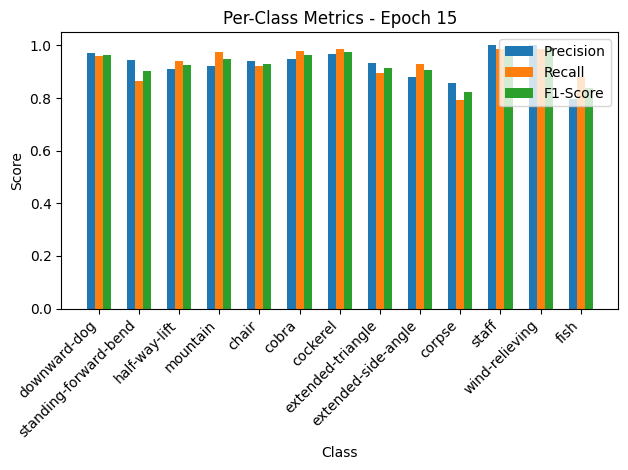


Epoch 16/50 Summary:
Train Loss: 0.2613 | Train Acc: 93.20% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.2616 | Val Acc: 91.10% | Val Precision: 0.92 | Val Recall: 0.91 | Val F1: 0.90

Epoch 17/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.45it/s, loss=0.26, accuracy=92.9]


Per-Class Metrics for Epoch 16:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.86, F1-Score=0.92
half-way-lift: Precision=0.90, Recall=0.96, F1-Score=0.93
mountain: Precision=0.90, Recall=0.95, F1-Score=0.93
chair: Precision=0.93, Recall=0.95, F1-Score=0.94
cobra: Precision=0.95, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.98, Recall=0.98, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.87, F1-Score=0.92
extended-side-angle: Precision=0.89, Recall=0.97, F1-Score=0.93
corpse: Precision=0.81, Recall=0.75, F1-Score=0.78
staff: Precision=0.97, Recall=0.99, F1-Score=0.98
wind-relieving: Precision=0.97, Recall=1.00, F1-Score=0.99
fish: Precision=0.76, Recall=0.79, F1-Score=0.77


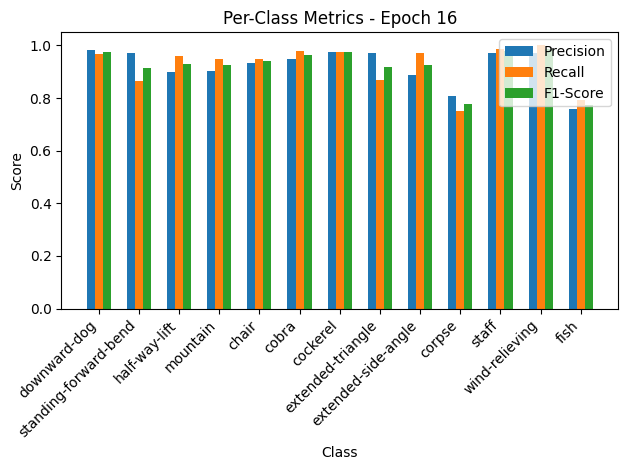

Validation: 100%|██████████| 10/10 [00:00<00:00, 26.54it/s, loss=0.191, accuracy=93.8]


Per-Class Metrics for Epoch 16:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.86, F1-Score=0.92
half-way-lift: Precision=0.90, Recall=0.96, F1-Score=0.93
mountain: Precision=0.90, Recall=0.95, F1-Score=0.93
chair: Precision=0.93, Recall=0.95, F1-Score=0.94
cobra: Precision=0.95, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.98, Recall=0.98, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.87, F1-Score=0.92
extended-side-angle: Precision=0.89, Recall=0.97, F1-Score=0.93
corpse: Precision=0.81, Recall=0.75, F1-Score=0.78
staff: Precision=0.97, Recall=0.99, F1-Score=0.98
wind-relieving: Precision=0.97, Recall=1.00, F1-Score=0.99
fish: Precision=0.76, Recall=0.79, F1-Score=0.77


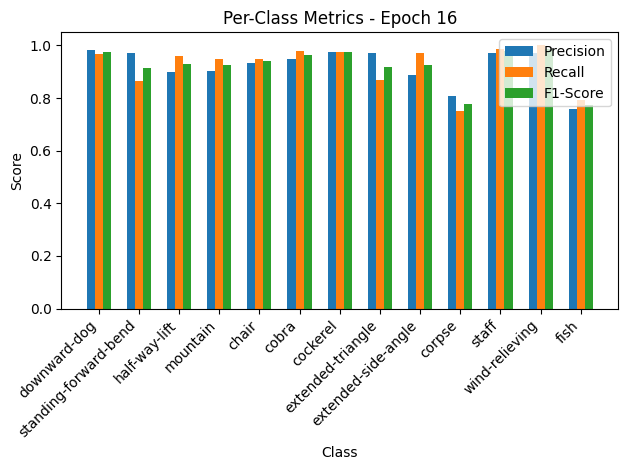


Epoch 17/50 Summary:
Train Loss: 0.2610 | Train Acc: 92.89% | Train Precision: 0.92 | Train Recall: 0.92 | Train F1: 0.92
Val Loss: 0.2094 | Val Acc: 93.84% | Val Precision: 0.96 | Val Recall: 0.94 | Val F1: 0.94

Epoch 18/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:12<00:00,  6.77it/s, loss=0.26, accuracy=93.9]


Per-Class Metrics for Epoch 17:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.99, Recall=0.88, F1-Score=0.93
half-way-lift: Precision=0.91, Recall=0.97, F1-Score=0.94
mountain: Precision=0.92, Recall=0.98, F1-Score=0.95
chair: Precision=0.96, Recall=0.93, F1-Score=0.94
cobra: Precision=0.94, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=0.94, F1-Score=0.94
extended-side-angle: Precision=0.92, Recall=0.94, F1-Score=0.93
corpse: Precision=0.80, Recall=0.82, F1-Score=0.81
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.80, Recall=0.79, F1-Score=0.80


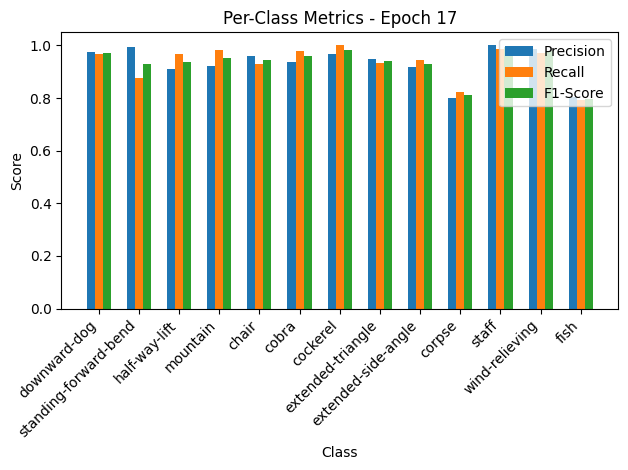

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.17it/s, loss=0.171, accuracy=95.2]


Per-Class Metrics for Epoch 17:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.99, Recall=0.88, F1-Score=0.93
half-way-lift: Precision=0.91, Recall=0.97, F1-Score=0.94
mountain: Precision=0.92, Recall=0.98, F1-Score=0.95
chair: Precision=0.96, Recall=0.93, F1-Score=0.94
cobra: Precision=0.94, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=0.94, F1-Score=0.94
extended-side-angle: Precision=0.92, Recall=0.94, F1-Score=0.93
corpse: Precision=0.80, Recall=0.82, F1-Score=0.81
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.80, Recall=0.79, F1-Score=0.80


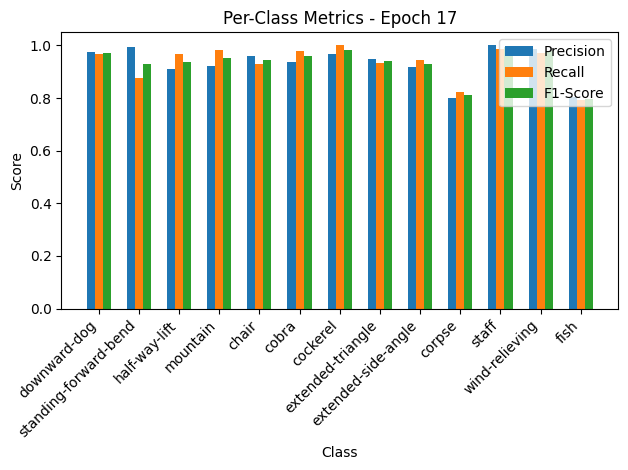


Epoch 18/50 Summary:
Train Loss: 0.2612 | Train Acc: 93.88% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.1873 | Val Acc: 95.21% | Val Precision: 0.96 | Val Recall: 0.95 | Val F1: 0.95

Epoch 19/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.20it/s, loss=0.228, accuracy=94.6]


Per-Class Metrics for Epoch 18:
downward-dog: Precision=0.97, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.92, Recall=0.90, F1-Score=0.91
half-way-lift: Precision=0.92, Recall=0.93, F1-Score=0.92
mountain: Precision=0.95, Recall=0.99, F1-Score=0.97
chair: Precision=0.97, Recall=0.94, F1-Score=0.95
cobra: Precision=0.95, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.95, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.97, F1-Score=0.96
corpse: Precision=0.88, Recall=0.88, F1-Score=0.88
staff: Precision=0.96, Recall=1.00, F1-Score=0.98
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.88, Recall=0.87, F1-Score=0.87


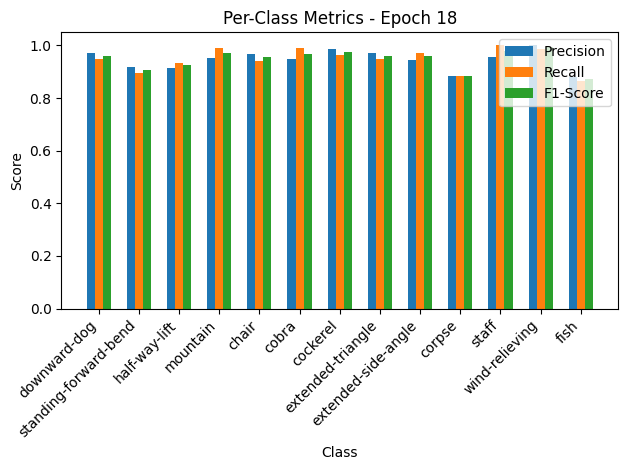

Validation: 100%|██████████| 10/10 [00:00<00:00, 28.00it/s, loss=0.193, accuracy=93.2]


Per-Class Metrics for Epoch 18:
downward-dog: Precision=0.97, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.92, Recall=0.90, F1-Score=0.91
half-way-lift: Precision=0.92, Recall=0.93, F1-Score=0.92
mountain: Precision=0.95, Recall=0.99, F1-Score=0.97
chair: Precision=0.97, Recall=0.94, F1-Score=0.95
cobra: Precision=0.95, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.95, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.97, F1-Score=0.96
corpse: Precision=0.88, Recall=0.88, F1-Score=0.88
staff: Precision=0.96, Recall=1.00, F1-Score=0.98
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.88, Recall=0.87, F1-Score=0.87


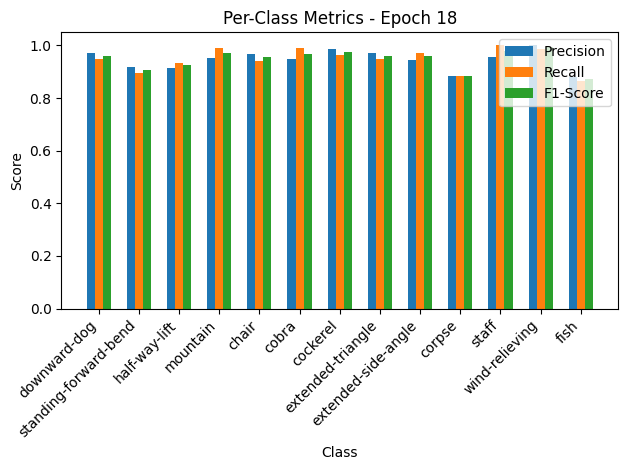


Epoch 19/50 Summary:
Train Loss: 0.2284 | Train Acc: 94.57% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2110 | Val Acc: 93.15% | Val Precision: 0.94 | Val Recall: 0.93 | Val F1: 0.93

Epoch 20/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.19it/s, loss=0.221, accuracy=94.3]


Per-Class Metrics for Epoch 19:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.96, Recall=0.88, F1-Score=0.92
half-way-lift: Precision=0.91, Recall=0.95, F1-Score=0.93
mountain: Precision=0.92, Recall=1.00, F1-Score=0.96
chair: Precision=0.97, Recall=0.92, F1-Score=0.94
cobra: Precision=0.94, Recall=0.99, F1-Score=0.96
cockerel: Precision=0.98, Recall=0.97, F1-Score=0.97
extended-triangle: Precision=0.95, Recall=0.97, F1-Score=0.96
extended-side-angle: Precision=0.94, Recall=0.92, F1-Score=0.93
corpse: Precision=0.88, Recall=0.84, F1-Score=0.86
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.84, Recall=0.87, F1-Score=0.85


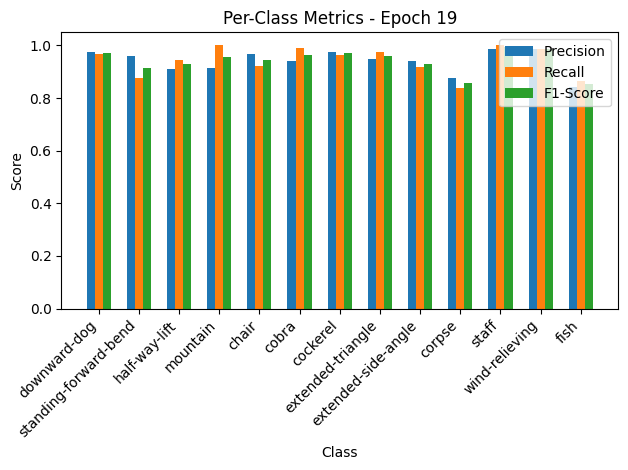

Validation: 100%|██████████| 10/10 [00:00<00:00, 28.67it/s, loss=0.169, accuracy=97.3]


Per-Class Metrics for Epoch 19:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.96, Recall=0.88, F1-Score=0.92
half-way-lift: Precision=0.91, Recall=0.95, F1-Score=0.93
mountain: Precision=0.92, Recall=1.00, F1-Score=0.96
chair: Precision=0.97, Recall=0.92, F1-Score=0.94
cobra: Precision=0.94, Recall=0.99, F1-Score=0.96
cockerel: Precision=0.98, Recall=0.97, F1-Score=0.97
extended-triangle: Precision=0.95, Recall=0.97, F1-Score=0.96
extended-side-angle: Precision=0.94, Recall=0.92, F1-Score=0.93
corpse: Precision=0.88, Recall=0.84, F1-Score=0.86
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.84, Recall=0.87, F1-Score=0.85


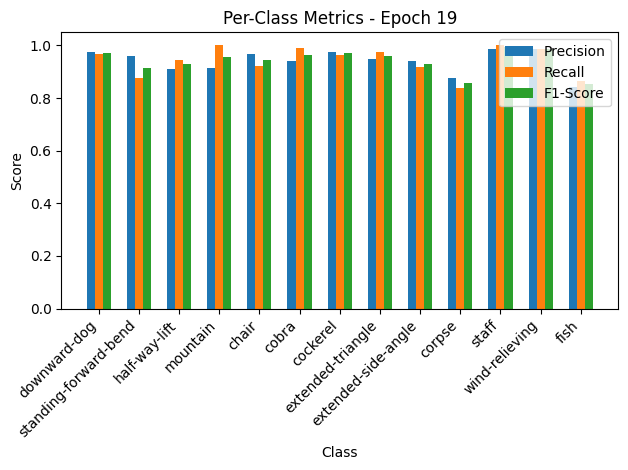


Epoch 20/50 Summary:
Train Loss: 0.2217 | Train Acc: 94.27% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.1851 | Val Acc: 97.26% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 21/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.46it/s, loss=0.24, accuracy=94]


Per-Class Metrics for Epoch 20:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.92, Recall=0.97, F1-Score=0.95
mountain: Precision=0.94, Recall=0.99, F1-Score=0.97
chair: Precision=0.97, Recall=0.96, F1-Score=0.97
cobra: Precision=0.95, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.91, Recall=0.98, F1-Score=0.94
extended-triangle: Precision=0.96, Recall=0.90, F1-Score=0.93
extended-side-angle: Precision=0.90, Recall=0.96, F1-Score=0.93
corpse: Precision=0.85, Recall=0.76, F1-Score=0.81
staff: Precision=0.97, Recall=0.97, F1-Score=0.97
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.79, Recall=0.87, F1-Score=0.83


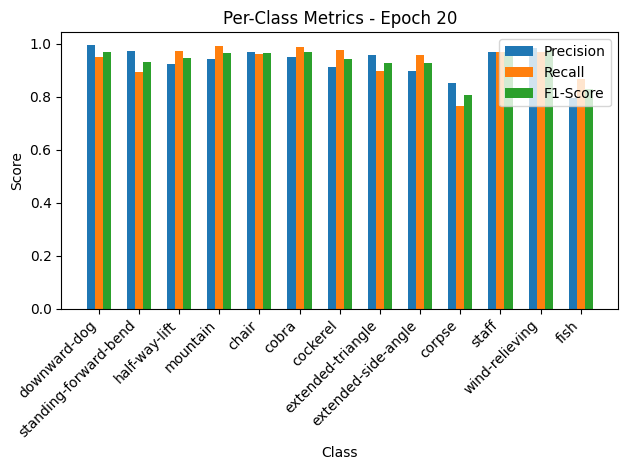

Validation: 100%|██████████| 10/10 [00:00<00:00, 21.58it/s, loss=0.158, accuracy=95.9]


Per-Class Metrics for Epoch 20:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.92, Recall=0.97, F1-Score=0.95
mountain: Precision=0.94, Recall=0.99, F1-Score=0.97
chair: Precision=0.97, Recall=0.96, F1-Score=0.97
cobra: Precision=0.95, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.91, Recall=0.98, F1-Score=0.94
extended-triangle: Precision=0.96, Recall=0.90, F1-Score=0.93
extended-side-angle: Precision=0.90, Recall=0.96, F1-Score=0.93
corpse: Precision=0.85, Recall=0.76, F1-Score=0.81
staff: Precision=0.97, Recall=0.97, F1-Score=0.97
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.79, Recall=0.87, F1-Score=0.83


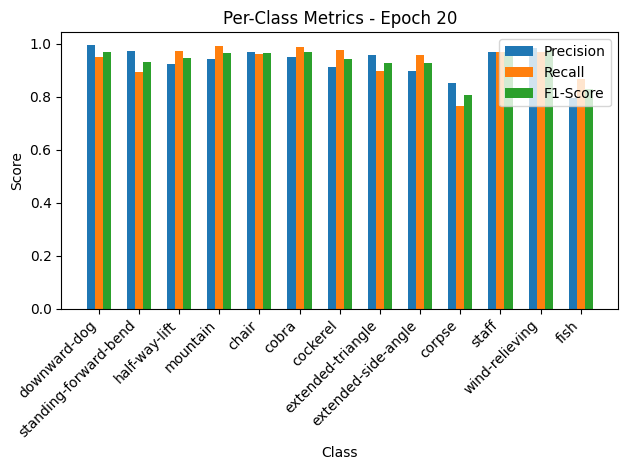


Epoch 21/50 Summary:
Train Loss: 0.2406 | Train Acc: 94.04% | Train Precision: 0.93 | Train Recall: 0.94 | Train F1: 0.93
Val Loss: 0.1731 | Val Acc: 95.89% | Val Precision: 0.98 | Val Recall: 0.97 | Val F1: 0.97
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_1.pth
Checkpoint saved at epoch 21
New best model saved! Validation Loss: 0.1731

Epoch 22/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.62it/s, loss=0.216, accuracy=94]


Per-Class Metrics for Epoch 21:
downward-dog: Precision=0.96, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=0.95, Recall=0.87, F1-Score=0.91
half-way-lift: Precision=0.91, Recall=0.95, F1-Score=0.93
mountain: Precision=0.92, Recall=0.97, F1-Score=0.95
chair: Precision=0.95, Recall=0.93, F1-Score=0.94
cobra: Precision=0.95, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.95, Recall=0.97, F1-Score=0.96
extended-triangle: Precision=0.95, Recall=0.94, F1-Score=0.94
extended-side-angle: Precision=0.92, Recall=0.93, F1-Score=0.92
corpse: Precision=0.87, Recall=0.90, F1-Score=0.88
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.91, Recall=0.88, F1-Score=0.89


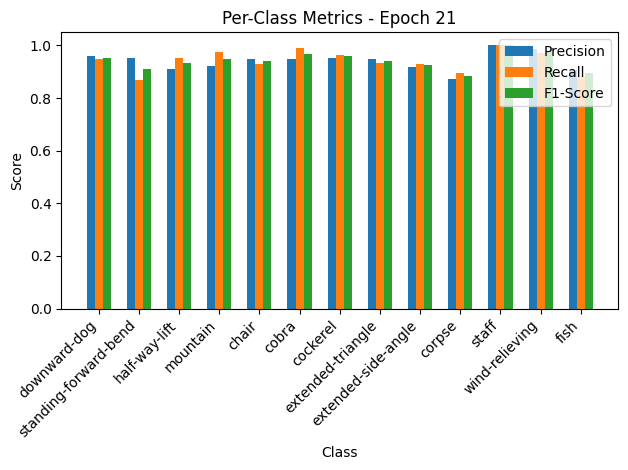

Validation: 100%|██████████| 10/10 [00:00<00:00, 21.70it/s, loss=0.144, accuracy=96.6]


Per-Class Metrics for Epoch 21:
downward-dog: Precision=0.96, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=0.95, Recall=0.87, F1-Score=0.91
half-way-lift: Precision=0.91, Recall=0.95, F1-Score=0.93
mountain: Precision=0.92, Recall=0.97, F1-Score=0.95
chair: Precision=0.95, Recall=0.93, F1-Score=0.94
cobra: Precision=0.95, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.95, Recall=0.97, F1-Score=0.96
extended-triangle: Precision=0.95, Recall=0.94, F1-Score=0.94
extended-side-angle: Precision=0.92, Recall=0.93, F1-Score=0.92
corpse: Precision=0.87, Recall=0.90, F1-Score=0.88
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.91, Recall=0.88, F1-Score=0.89


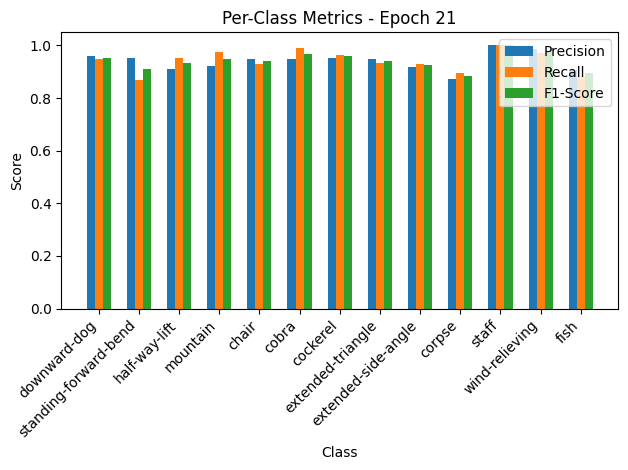


Epoch 22/50 Summary:
Train Loss: 0.2171 | Train Acc: 94.04% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.1578 | Val Acc: 96.58% | Val Precision: 0.98 | Val Recall: 0.97 | Val F1: 0.97
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_1.pth
Checkpoint saved at epoch 22
New best model saved! Validation Loss: 0.1578

Epoch 23/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.51it/s, loss=0.203, accuracy=95.5]


Per-Class Metrics for Epoch 22:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.93, Recall=0.95, F1-Score=0.94
mountain: Precision=0.95, Recall=0.98, F1-Score=0.97
chair: Precision=0.99, Recall=0.93, F1-Score=0.96
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.93, Recall=0.99, F1-Score=0.96
extended-triangle: Precision=0.96, Recall=0.95, F1-Score=0.95
extended-side-angle: Precision=0.95, Recall=0.96, F1-Score=0.95
corpse: Precision=0.95, Recall=0.85, F1-Score=0.90
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.88, Recall=0.96, F1-Score=0.91


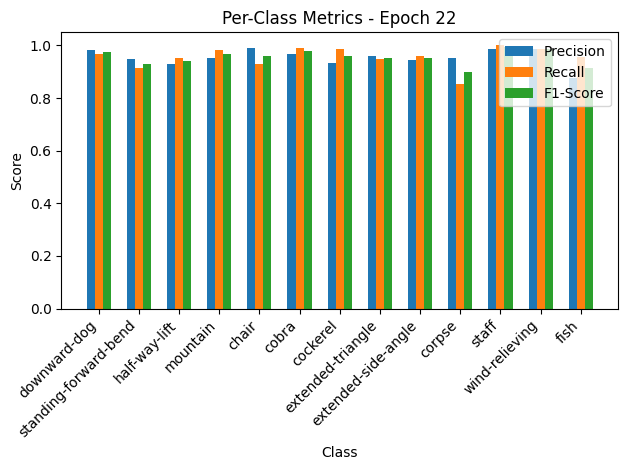

Validation: 100%|██████████| 10/10 [00:00<00:00, 23.57it/s, loss=0.167, accuracy=94.5]


Per-Class Metrics for Epoch 22:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.93, Recall=0.95, F1-Score=0.94
mountain: Precision=0.95, Recall=0.98, F1-Score=0.97
chair: Precision=0.99, Recall=0.93, F1-Score=0.96
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.93, Recall=0.99, F1-Score=0.96
extended-triangle: Precision=0.96, Recall=0.95, F1-Score=0.95
extended-side-angle: Precision=0.95, Recall=0.96, F1-Score=0.95
corpse: Precision=0.95, Recall=0.85, F1-Score=0.90
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.88, Recall=0.96, F1-Score=0.91


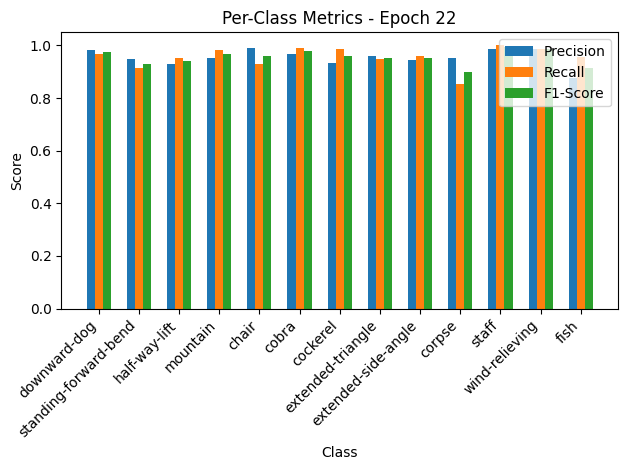


Epoch 23/50 Summary:
Train Loss: 0.2039 | Train Acc: 95.49% | Train Precision: 0.95 | Train Recall: 0.96 | Train F1: 0.95
Val Loss: 0.1829 | Val Acc: 94.52% | Val Precision: 0.95 | Val Recall: 0.94 | Val F1: 0.94

Epoch 24/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.18it/s, loss=0.207, accuracy=94.8]


Per-Class Metrics for Epoch 23:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.94, Recall=0.95, F1-Score=0.94
mountain: Precision=0.94, Recall=0.99, F1-Score=0.96
chair: Precision=0.96, Recall=0.93, F1-Score=0.94
cobra: Precision=0.95, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.96, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.97, Recall=0.94, F1-Score=0.95
extended-side-angle: Precision=0.91, Recall=0.97, F1-Score=0.94
corpse: Precision=0.86, Recall=0.87, F1-Score=0.86
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.86, Recall=0.84, F1-Score=0.85


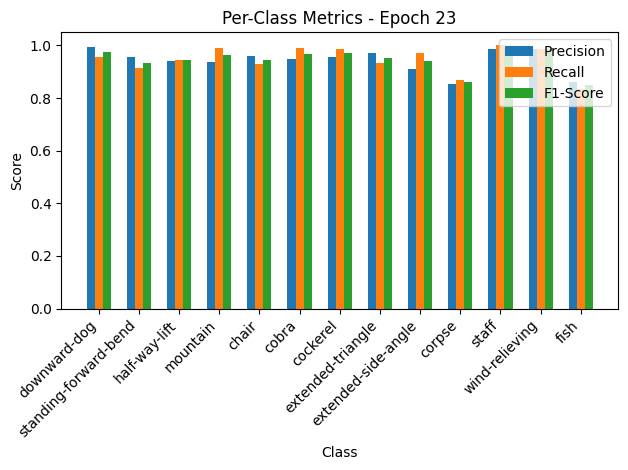

Validation: 100%|██████████| 10/10 [00:00<00:00, 26.43it/s, loss=0.154, accuracy=95.2]


Per-Class Metrics for Epoch 23:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.94, Recall=0.95, F1-Score=0.94
mountain: Precision=0.94, Recall=0.99, F1-Score=0.96
chair: Precision=0.96, Recall=0.93, F1-Score=0.94
cobra: Precision=0.95, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.96, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.97, Recall=0.94, F1-Score=0.95
extended-side-angle: Precision=0.91, Recall=0.97, F1-Score=0.94
corpse: Precision=0.86, Recall=0.87, F1-Score=0.86
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.86, Recall=0.84, F1-Score=0.85


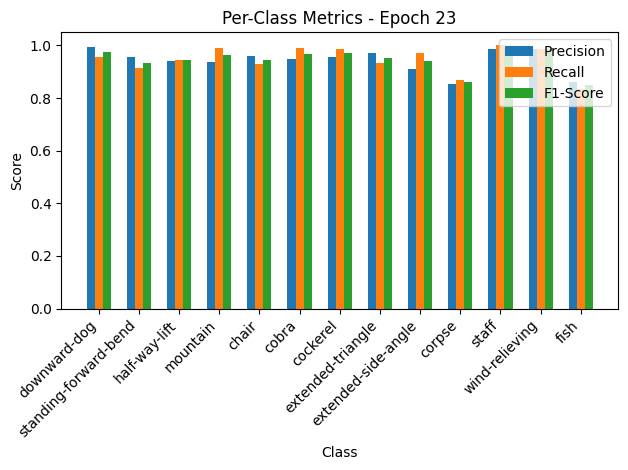


Epoch 24/50 Summary:
Train Loss: 0.2078 | Train Acc: 94.80% | Train Precision: 0.94 | Train Recall: 0.95 | Train F1: 0.94
Val Loss: 0.1686 | Val Acc: 95.21% | Val Precision: 0.98 | Val Recall: 0.96 | Val F1: 0.97

Epoch 25/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.14it/s, loss=0.206, accuracy=95]


Per-Class Metrics for Epoch 24:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.95, F1-Score=0.94
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.94, Recall=0.94, F1-Score=0.94
cobra: Precision=0.94, Recall=1.00, F1-Score=0.97
cockerel: Precision=0.96, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.97, Recall=0.92, F1-Score=0.95
extended-side-angle: Precision=0.92, Recall=0.96, F1-Score=0.94
corpse: Precision=0.91, Recall=0.87, F1-Score=0.89
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.88, Recall=0.90, F1-Score=0.89


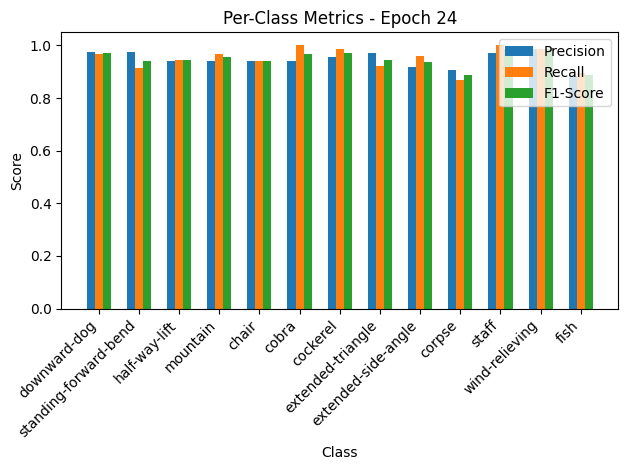

Validation: 100%|██████████| 10/10 [00:00<00:00, 26.37it/s, loss=0.232, accuracy=93.8]


Per-Class Metrics for Epoch 24:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.95, F1-Score=0.94
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.94, Recall=0.94, F1-Score=0.94
cobra: Precision=0.94, Recall=1.00, F1-Score=0.97
cockerel: Precision=0.96, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.97, Recall=0.92, F1-Score=0.95
extended-side-angle: Precision=0.92, Recall=0.96, F1-Score=0.94
corpse: Precision=0.91, Recall=0.87, F1-Score=0.89
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.88, Recall=0.90, F1-Score=0.89


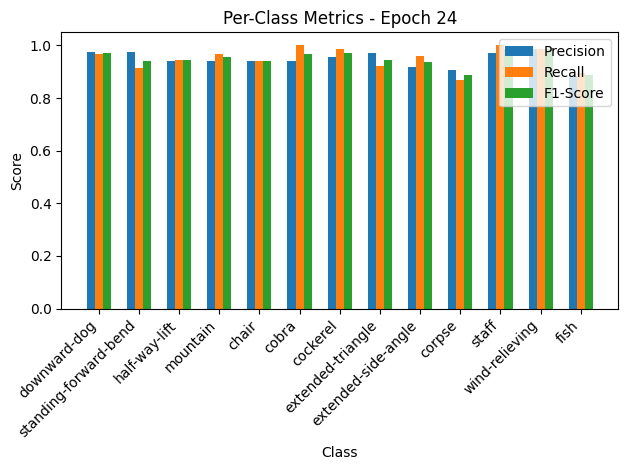


Epoch 25/50 Summary:
Train Loss: 0.2066 | Train Acc: 95.03% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2543 | Val Acc: 93.84% | Val Precision: 0.95 | Val Recall: 0.94 | Val F1: 0.94

Epoch 26/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  6.88it/s, loss=0.206, accuracy=95.4]


Per-Class Metrics for Epoch 25:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.99, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.97, Recall=0.97, F1-Score=0.97
mountain: Precision=0.93, Recall=0.98, F1-Score=0.96
chair: Precision=0.94, Recall=0.94, F1-Score=0.94
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.97, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=0.91, Recall=0.94, F1-Score=0.92
extended-side-angle: Precision=0.92, Recall=0.90, F1-Score=0.91
corpse: Precision=0.89, Recall=0.94, F1-Score=0.91
staff: Precision=0.97, Recall=0.99, F1-Score=0.98
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.92, Recall=0.87, F1-Score=0.89


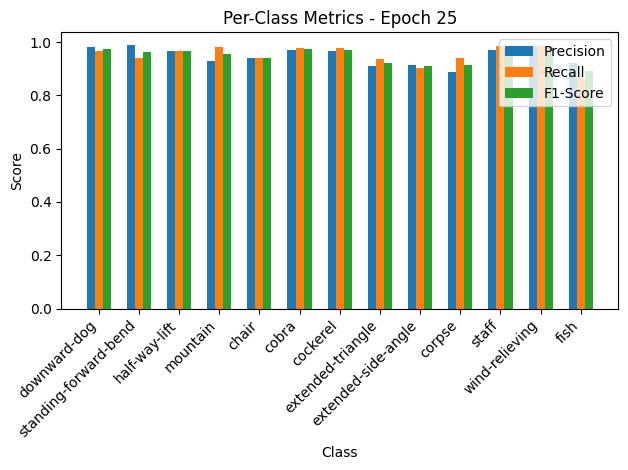

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.35it/s, loss=0.143, accuracy=95.9]


Per-Class Metrics for Epoch 25:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.99, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.97, Recall=0.97, F1-Score=0.97
mountain: Precision=0.93, Recall=0.98, F1-Score=0.96
chair: Precision=0.94, Recall=0.94, F1-Score=0.94
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.97, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=0.91, Recall=0.94, F1-Score=0.92
extended-side-angle: Precision=0.92, Recall=0.90, F1-Score=0.91
corpse: Precision=0.89, Recall=0.94, F1-Score=0.91
staff: Precision=0.97, Recall=0.99, F1-Score=0.98
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.92, Recall=0.87, F1-Score=0.89


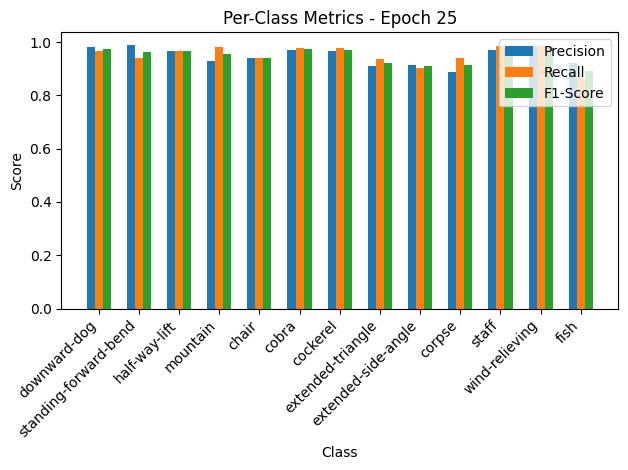


Epoch 26/50 Summary:
Train Loss: 0.2066 | Train Acc: 95.41% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.1566 | Val Acc: 95.89% | Val Precision: 0.98 | Val Recall: 0.97 | Val F1: 0.97
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_1.pth
Checkpoint saved at epoch 26
New best model saved! Validation Loss: 0.1566

Epoch 27/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:12<00:00,  6.83it/s, loss=0.184, accuracy=95.9]


Per-Class Metrics for Epoch 26:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.93, F1-Score=0.95
half-way-lift: Precision=0.95, Recall=0.97, F1-Score=0.96
mountain: Precision=0.94, Recall=0.98, F1-Score=0.96
chair: Precision=0.96, Recall=0.95, F1-Score=0.96
cobra: Precision=0.95, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.99, Recall=0.98, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.92, F1-Score=0.95
extended-side-angle: Precision=0.90, Recall=0.97, F1-Score=0.93
corpse: Precision=0.90, Recall=0.93, F1-Score=0.91
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.95, Recall=0.91, F1-Score=0.93


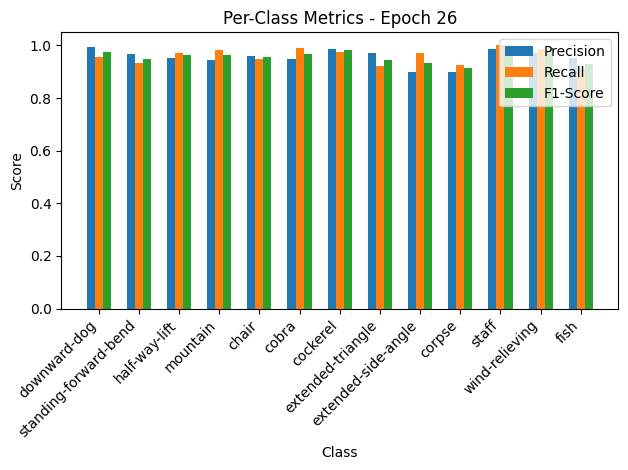

Validation: 100%|██████████| 10/10 [00:00<00:00, 25.29it/s, loss=0.161, accuracy=93.2]


Per-Class Metrics for Epoch 26:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.93, F1-Score=0.95
half-way-lift: Precision=0.95, Recall=0.97, F1-Score=0.96
mountain: Precision=0.94, Recall=0.98, F1-Score=0.96
chair: Precision=0.96, Recall=0.95, F1-Score=0.96
cobra: Precision=0.95, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.99, Recall=0.98, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.92, F1-Score=0.95
extended-side-angle: Precision=0.90, Recall=0.97, F1-Score=0.93
corpse: Precision=0.90, Recall=0.93, F1-Score=0.91
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.95, Recall=0.91, F1-Score=0.93


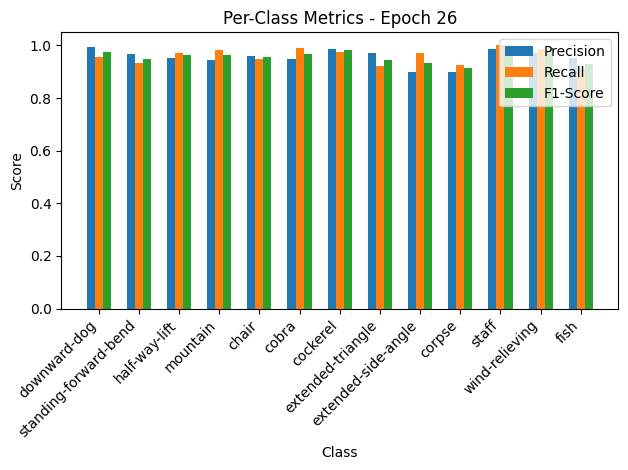


Epoch 27/50 Summary:
Train Loss: 0.1843 | Train Acc: 95.95% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.1761 | Val Acc: 93.15% | Val Precision: 0.95 | Val Recall: 0.94 | Val F1: 0.94

Epoch 28/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.33it/s, loss=0.215, accuracy=95]


Per-Class Metrics for Epoch 27:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.96, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.95, F1-Score=0.94
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.97, Recall=0.95, F1-Score=0.96
cobra: Precision=0.95, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.95, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=0.96, Recall=0.96, F1-Score=0.96
extended-side-angle: Precision=0.93, Recall=0.96, F1-Score=0.95
corpse: Precision=0.86, Recall=0.82, F1-Score=0.84
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.83, Recall=0.88, F1-Score=0.86


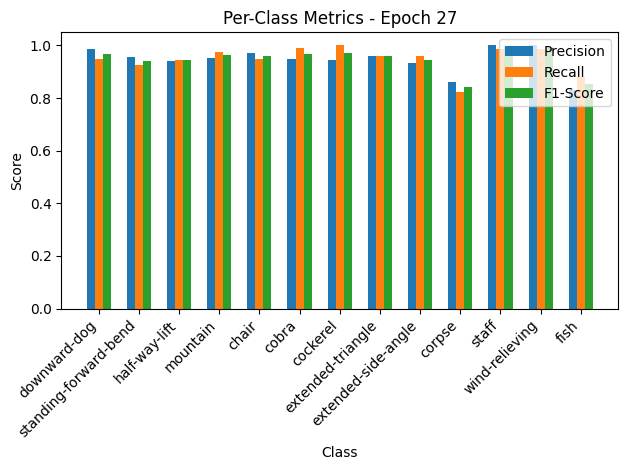

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.17it/s, loss=0.118, accuracy=96.6]


Per-Class Metrics for Epoch 27:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.96, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.95, F1-Score=0.94
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.97, Recall=0.95, F1-Score=0.96
cobra: Precision=0.95, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.95, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=0.96, Recall=0.96, F1-Score=0.96
extended-side-angle: Precision=0.93, Recall=0.96, F1-Score=0.95
corpse: Precision=0.86, Recall=0.82, F1-Score=0.84
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.83, Recall=0.88, F1-Score=0.86


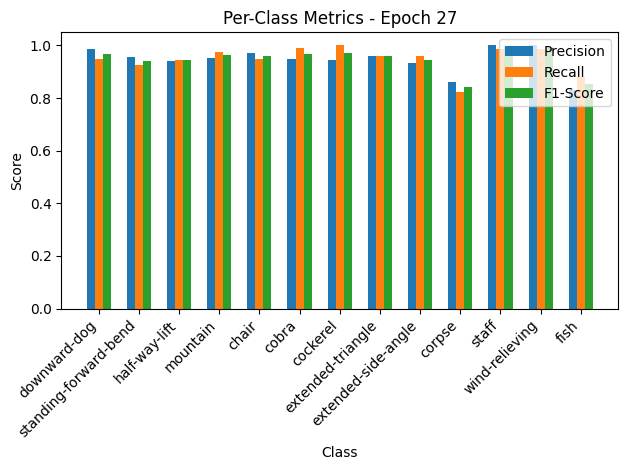


Epoch 28/50 Summary:
Train Loss: 0.2157 | Train Acc: 94.95% | Train Precision: 0.94 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.1296 | Val Acc: 96.58% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_1.pth
Checkpoint saved at epoch 28
New best model saved! Validation Loss: 0.1296

Epoch 29/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.55it/s, loss=0.192, accuracy=96.1]


Per-Class Metrics for Epoch 28:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.91, F1-Score=0.95
half-way-lift: Precision=0.96, Recall=0.97, F1-Score=0.97
mountain: Precision=0.95, Recall=1.00, F1-Score=0.98
chair: Precision=0.96, Recall=0.95, F1-Score=0.96
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.97, Recall=0.96, F1-Score=0.97
corpse: Precision=0.85, Recall=0.88, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.88, Recall=0.85, F1-Score=0.86


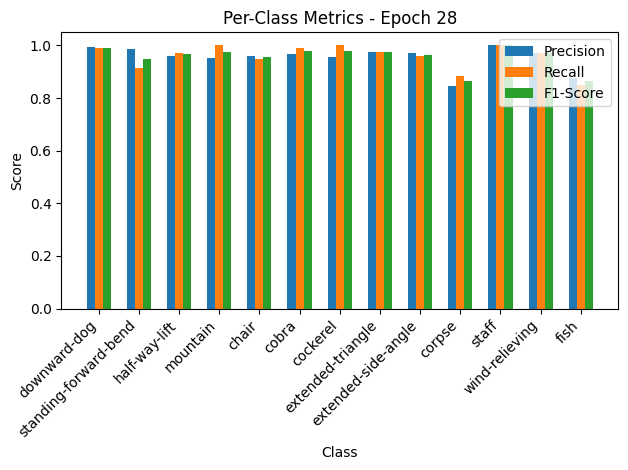

Validation: 100%|██████████| 10/10 [00:00<00:00, 25.24it/s, loss=0.11, accuracy=95.9]


Per-Class Metrics for Epoch 28:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.91, F1-Score=0.95
half-way-lift: Precision=0.96, Recall=0.97, F1-Score=0.97
mountain: Precision=0.95, Recall=1.00, F1-Score=0.98
chair: Precision=0.96, Recall=0.95, F1-Score=0.96
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.97, Recall=0.96, F1-Score=0.97
corpse: Precision=0.85, Recall=0.88, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.88, Recall=0.85, F1-Score=0.86


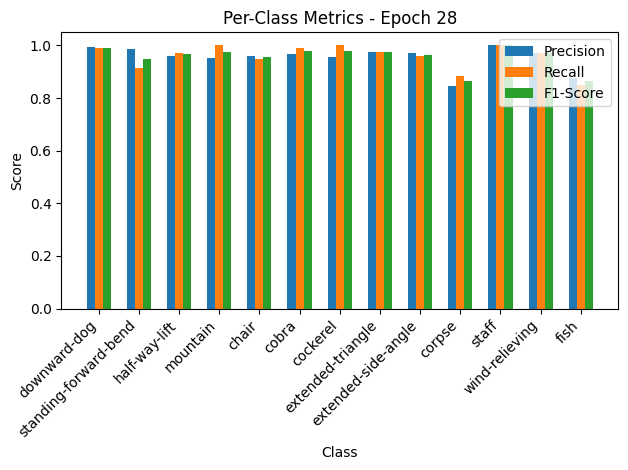


Epoch 29/50 Summary:
Train Loss: 0.1925 | Train Acc: 96.10% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.1203 | Val Acc: 95.89% | Val Precision: 0.98 | Val Recall: 0.97 | Val F1: 0.97
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_1.pth
Checkpoint saved at epoch 29
New best model saved! Validation Loss: 0.1203

Epoch 30/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.61it/s, loss=0.199, accuracy=95.9]


Per-Class Metrics for Epoch 29:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.96, Recall=0.92, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.96, F1-Score=0.96
mountain: Precision=0.94, Recall=0.98, F1-Score=0.96
chair: Precision=0.95, Recall=0.93, F1-Score=0.94
cobra: Precision=0.95, Recall=1.00, F1-Score=0.97
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.87, Recall=0.90, F1-Score=0.88
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.91, Recall=0.88, F1-Score=0.89


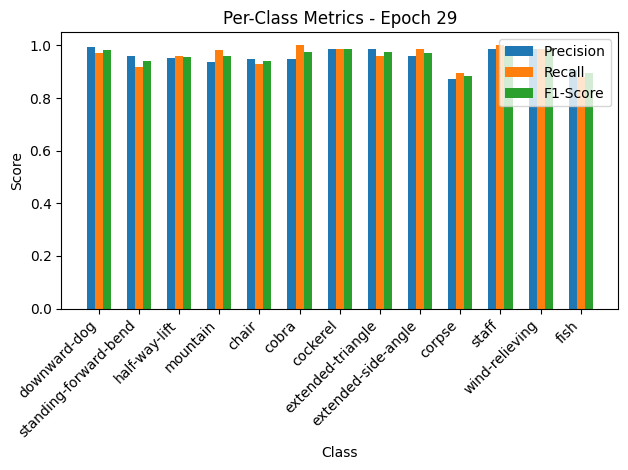

Validation: 100%|██████████| 10/10 [00:00<00:00, 23.66it/s, loss=0.15, accuracy=95.9]


Per-Class Metrics for Epoch 29:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.96, Recall=0.92, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.96, F1-Score=0.96
mountain: Precision=0.94, Recall=0.98, F1-Score=0.96
chair: Precision=0.95, Recall=0.93, F1-Score=0.94
cobra: Precision=0.95, Recall=1.00, F1-Score=0.97
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.87, Recall=0.90, F1-Score=0.88
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.91, Recall=0.88, F1-Score=0.89


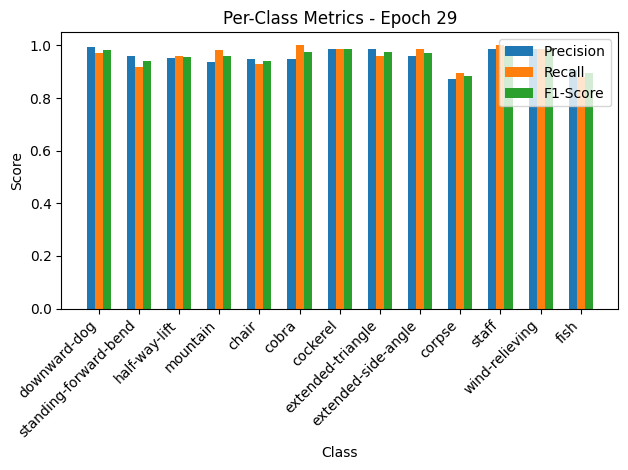


Epoch 30/50 Summary:
Train Loss: 0.1995 | Train Acc: 95.87% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.1640 | Val Acc: 95.89% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 31/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.53it/s, loss=0.178, accuracy=95.9]


Per-Class Metrics for Epoch 30:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.98, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.98, F1-Score=0.97
mountain: Precision=0.93, Recall=0.99, F1-Score=0.96
chair: Precision=0.95, Recall=0.94, F1-Score=0.95
cobra: Precision=0.95, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.87, Recall=0.88, F1-Score=0.88
staff: Precision=0.96, Recall=1.00, F1-Score=0.98
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.88, Recall=0.88, F1-Score=0.88


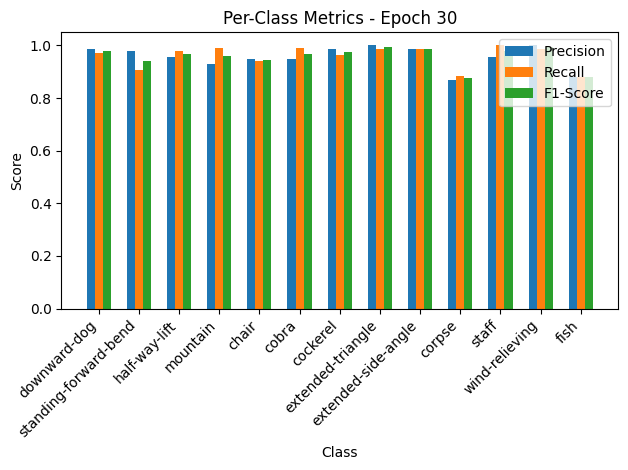

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.05it/s, loss=0.116, accuracy=98.6]


Per-Class Metrics for Epoch 30:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.98, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.98, F1-Score=0.97
mountain: Precision=0.93, Recall=0.99, F1-Score=0.96
chair: Precision=0.95, Recall=0.94, F1-Score=0.95
cobra: Precision=0.95, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.87, Recall=0.88, F1-Score=0.88
staff: Precision=0.96, Recall=1.00, F1-Score=0.98
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.88, Recall=0.88, F1-Score=0.88


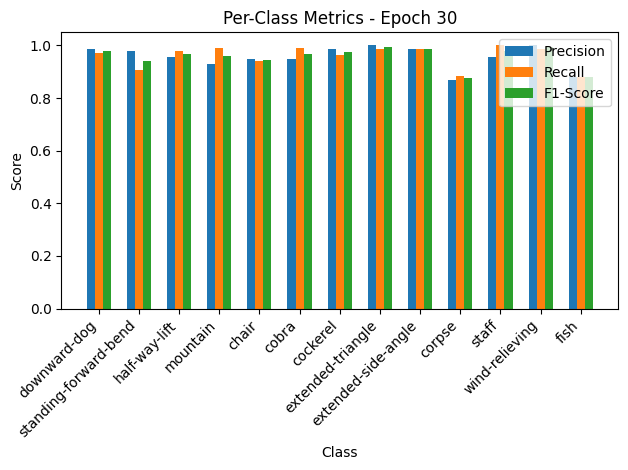


Epoch 31/50 Summary:
Train Loss: 0.1788 | Train Acc: 95.95% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.1271 | Val Acc: 98.63% | Val Precision: 0.99 | Val Recall: 0.99 | Val F1: 0.99

Epoch 32/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.24it/s, loss=0.19, accuracy=95.7]


Per-Class Metrics for Epoch 31:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.96, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.93, Recall=0.97, F1-Score=0.95
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.97, Recall=0.95, F1-Score=0.96
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.98, Recall=0.98, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.89, Recall=0.91, F1-Score=0.90
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.92, Recall=0.88, F1-Score=0.90


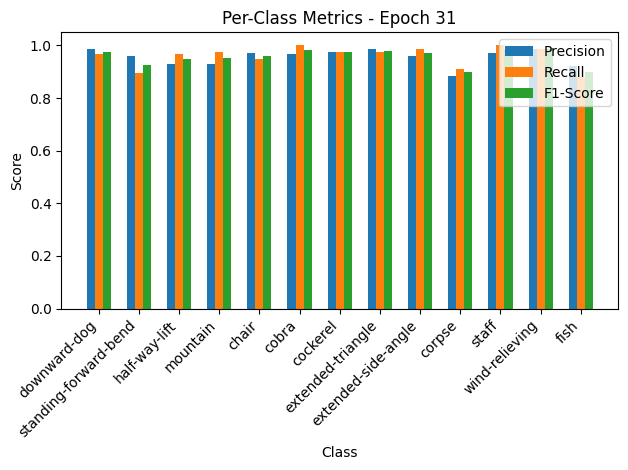

Validation: 100%|██████████| 10/10 [00:00<00:00, 26.59it/s, loss=0.179, accuracy=95.2]


Per-Class Metrics for Epoch 31:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.96, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.93, Recall=0.97, F1-Score=0.95
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.97, Recall=0.95, F1-Score=0.96
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.98, Recall=0.98, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.89, Recall=0.91, F1-Score=0.90
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.92, Recall=0.88, F1-Score=0.90


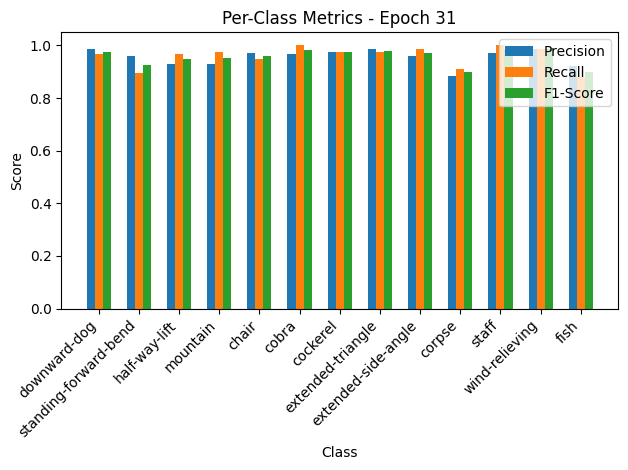


Epoch 32/50 Summary:
Train Loss: 0.1908 | Train Acc: 95.72% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.1964 | Val Acc: 95.21% | Val Precision: 0.96 | Val Recall: 0.95 | Val F1: 0.95

Epoch 33/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.09it/s, loss=0.207, accuracy=95.7]


Per-Class Metrics for Epoch 32:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.99, Recall=0.93, F1-Score=0.96
half-way-lift: Precision=0.95, Recall=0.97, F1-Score=0.96
mountain: Precision=0.92, Recall=0.97, F1-Score=0.95
chair: Precision=0.95, Recall=0.93, F1-Score=0.94
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.95, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=0.90, Recall=0.92, F1-Score=0.91
extended-side-angle: Precision=0.90, Recall=0.90, F1-Score=0.90
corpse: Precision=0.91, Recall=1.00, F1-Score=0.95
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=1.00, Recall=0.88, F1-Score=0.94


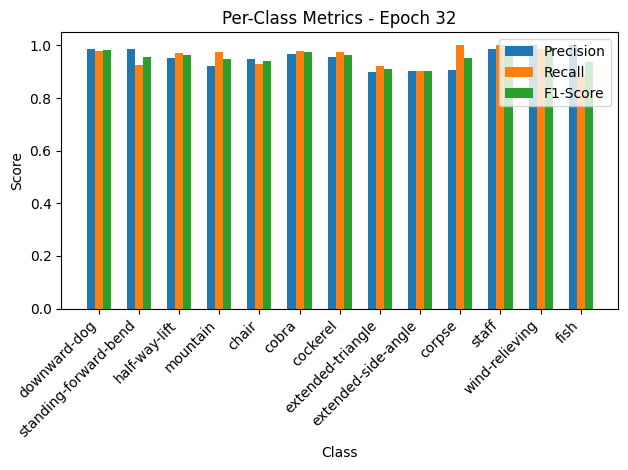

Validation: 100%|██████████| 10/10 [00:00<00:00, 28.43it/s, loss=0.142, accuracy=96.6]


Per-Class Metrics for Epoch 32:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.99, Recall=0.93, F1-Score=0.96
half-way-lift: Precision=0.95, Recall=0.97, F1-Score=0.96
mountain: Precision=0.92, Recall=0.97, F1-Score=0.95
chair: Precision=0.95, Recall=0.93, F1-Score=0.94
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.95, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=0.90, Recall=0.92, F1-Score=0.91
extended-side-angle: Precision=0.90, Recall=0.90, F1-Score=0.90
corpse: Precision=0.91, Recall=1.00, F1-Score=0.95
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=1.00, Recall=0.88, F1-Score=0.94


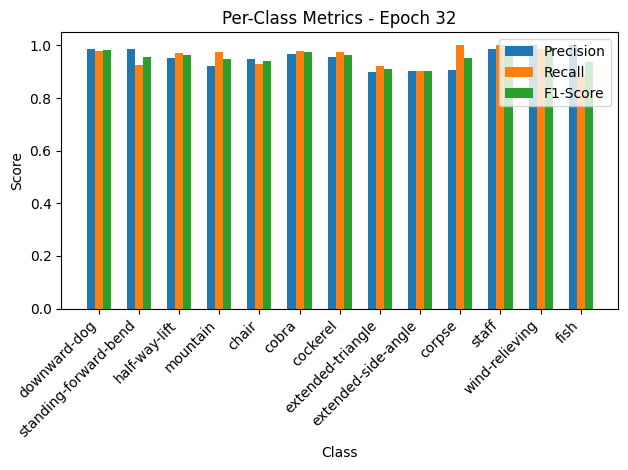


Epoch 33/50 Summary:
Train Loss: 0.2073 | Train Acc: 95.72% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.95
Val Loss: 0.1558 | Val Acc: 96.58% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 34/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.17it/s, loss=0.192, accuracy=95.6]


Per-Class Metrics for Epoch 33:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.90, F1-Score=0.94
half-way-lift: Precision=0.92, Recall=0.96, F1-Score=0.94
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.92, Recall=0.94, F1-Score=0.93
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.89, Recall=0.94, F1-Score=0.91
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.94, Recall=0.88, F1-Score=0.91


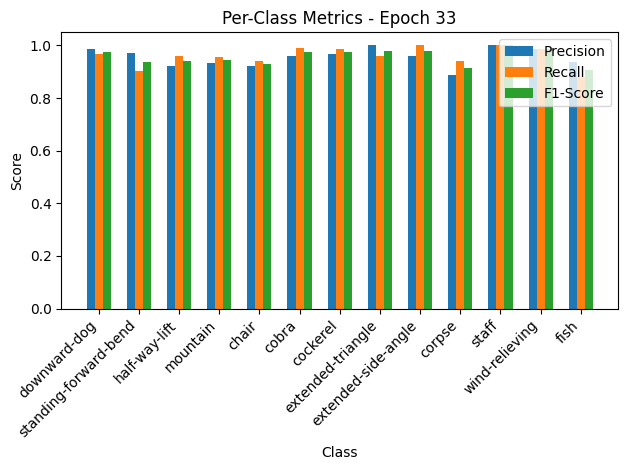

Validation: 100%|██████████| 10/10 [00:00<00:00, 26.93it/s, loss=0.195, accuracy=93.2]


Per-Class Metrics for Epoch 33:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.90, F1-Score=0.94
half-way-lift: Precision=0.92, Recall=0.96, F1-Score=0.94
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.92, Recall=0.94, F1-Score=0.93
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.89, Recall=0.94, F1-Score=0.91
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.94, Recall=0.88, F1-Score=0.91


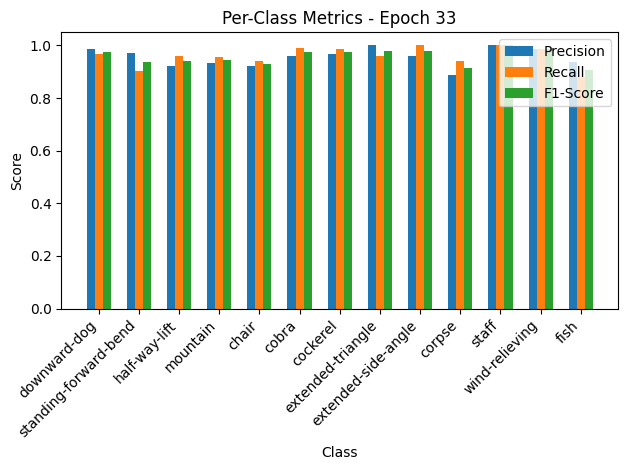


Epoch 34/50 Summary:
Train Loss: 0.1930 | Train Acc: 95.64% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.2134 | Val Acc: 93.15% | Val Precision: 0.95 | Val Recall: 0.92 | Val F1: 0.93

Epoch 35/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.95it/s, loss=0.196, accuracy=95.6]


Per-Class Metrics for Epoch 34:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.98, Recall=0.89, F1-Score=0.93
half-way-lift: Precision=0.93, Recall=0.97, F1-Score=0.95
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.94, Recall=0.96, F1-Score=0.95
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.97, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=0.95, Recall=0.91, F1-Score=0.93
extended-side-angle: Precision=0.91, Recall=0.94, F1-Score=0.93
corpse: Precision=0.94, Recall=0.91, F1-Score=0.93
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.93, Recall=0.94, F1-Score=0.93


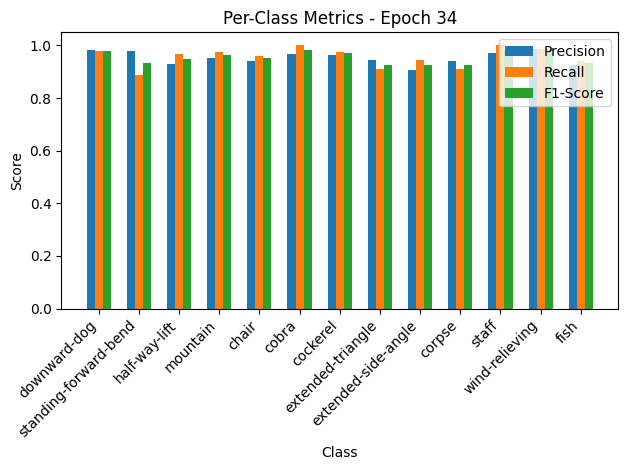

Validation: 100%|██████████| 10/10 [00:00<00:00, 25.29it/s, loss=0.154, accuracy=96.6]


Per-Class Metrics for Epoch 34:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.98, Recall=0.89, F1-Score=0.93
half-way-lift: Precision=0.93, Recall=0.97, F1-Score=0.95
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.94, Recall=0.96, F1-Score=0.95
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.97, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=0.95, Recall=0.91, F1-Score=0.93
extended-side-angle: Precision=0.91, Recall=0.94, F1-Score=0.93
corpse: Precision=0.94, Recall=0.91, F1-Score=0.93
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.93, Recall=0.94, F1-Score=0.93


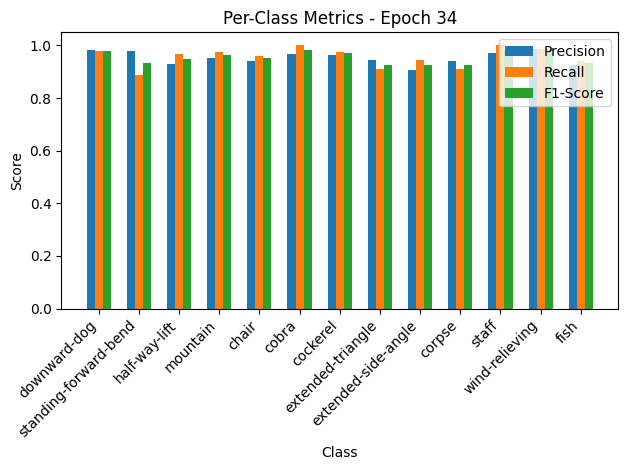


Epoch 35/50 Summary:
Train Loss: 0.1964 | Train Acc: 95.57% | Train Precision: 0.95 | Train Recall: 0.96 | Train F1: 0.95
Val Loss: 0.1687 | Val Acc: 96.58% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 36/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.25it/s, loss=0.155, accuracy=97.2]


Per-Class Metrics for Epoch 35:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.93, F1-Score=0.96
half-way-lift: Precision=0.95, Recall=0.99, F1-Score=0.97
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.95, F1-Score=0.97
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.96, F1-Score=0.97
corpse: Precision=0.87, Recall=0.99, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.98, Recall=0.85, F1-Score=0.91


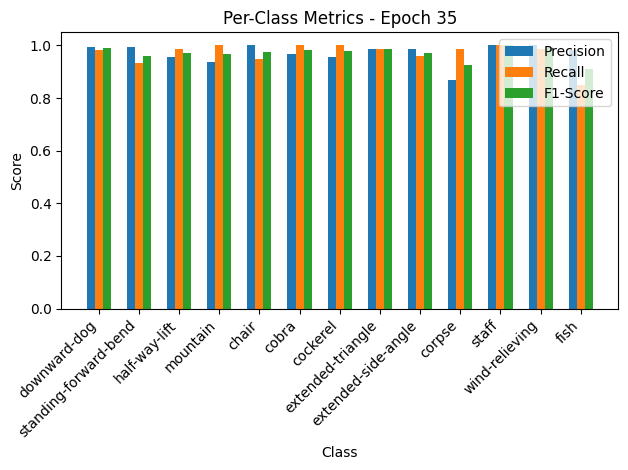

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.31it/s, loss=0.058, accuracy=98.6]


Per-Class Metrics for Epoch 35:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.93, F1-Score=0.96
half-way-lift: Precision=0.95, Recall=0.99, F1-Score=0.97
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=1.00, Recall=0.95, F1-Score=0.97
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.96, F1-Score=0.97
corpse: Precision=0.87, Recall=0.99, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.98, Recall=0.85, F1-Score=0.91


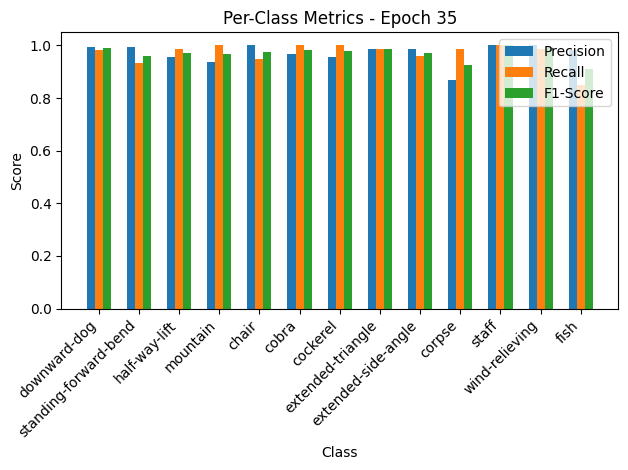


Epoch 36/50 Summary:
Train Loss: 0.1555 | Train Acc: 97.17% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.0636 | Val Acc: 98.63% | Val Precision: 0.99 | Val Recall: 0.99 | Val F1: 0.99
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_1.pth
Checkpoint saved at epoch 36
New best model saved! Validation Loss: 0.0636

Epoch 37/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.49it/s, loss=0.105, accuracy=98.2]


Per-Class Metrics for Epoch 36:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.96, Recall=0.99, F1-Score=0.98
chair: Precision=0.98, Recall=0.94, F1-Score=0.96
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.93, Recall=1.00, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.93, F1-Score=0.96


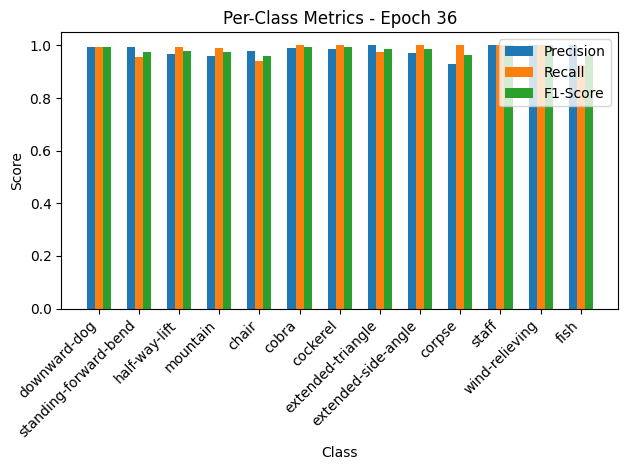

Validation: 100%|██████████| 10/10 [00:00<00:00, 28.81it/s, loss=0.0635, accuracy=98.6]


Per-Class Metrics for Epoch 36:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.96, Recall=0.99, F1-Score=0.98
chair: Precision=0.98, Recall=0.94, F1-Score=0.96
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.93, Recall=1.00, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.93, F1-Score=0.96


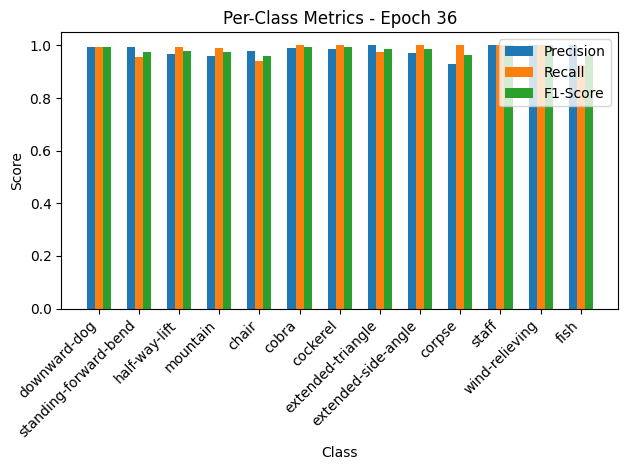


Epoch 37/50 Summary:
Train Loss: 0.1050 | Train Acc: 98.24% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.0696 | Val Acc: 98.63% | Val Precision: 0.99 | Val Recall: 0.99 | Val F1: 0.99

Epoch 38/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.04it/s, loss=0.107, accuracy=98.1]


Per-Class Metrics for Epoch 37:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.95, Recall=0.99, F1-Score=0.97
mountain: Precision=0.96, Recall=0.99, F1-Score=0.98
chair: Precision=0.99, Recall=0.96, F1-Score=0.97
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.93, Recall=1.00, F1-Score=0.96
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=1.00, Recall=0.93, F1-Score=0.96


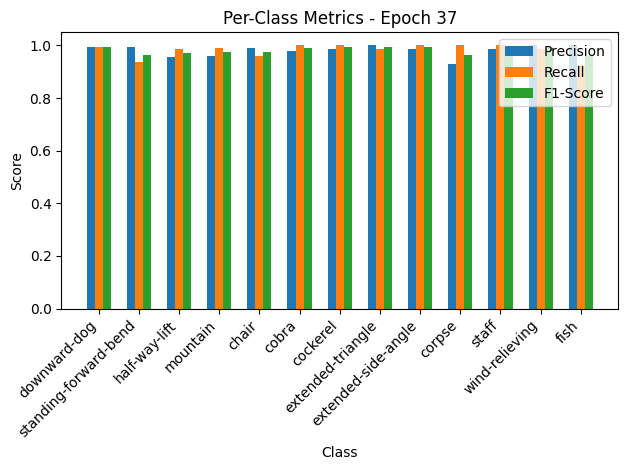

Validation: 100%|██████████| 10/10 [00:00<00:00, 28.34it/s, loss=0.0561, accuracy=99.3]


Per-Class Metrics for Epoch 37:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.95, Recall=0.99, F1-Score=0.97
mountain: Precision=0.96, Recall=0.99, F1-Score=0.98
chair: Precision=0.99, Recall=0.96, F1-Score=0.97
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.93, Recall=1.00, F1-Score=0.96
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=1.00, Recall=0.93, F1-Score=0.96


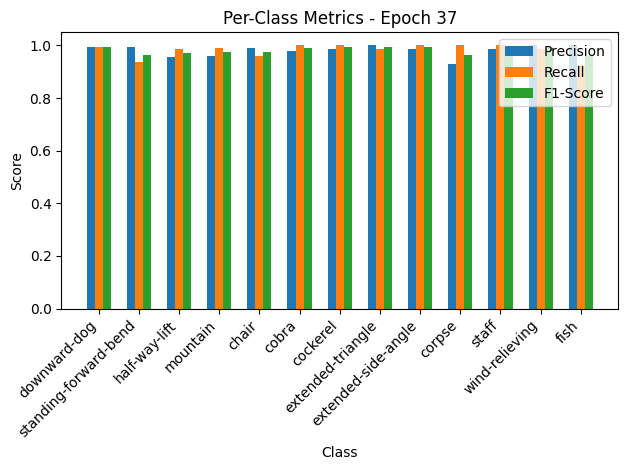


Epoch 38/50 Summary:
Train Loss: 0.1075 | Train Acc: 98.09% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.0615 | Val Acc: 99.32% | Val Precision: 1.00 | Val Recall: 1.00 | Val F1: 1.00
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_1.pth
Checkpoint saved at epoch 38
New best model saved! Validation Loss: 0.0615

Epoch 39/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  6.95it/s, loss=0.102, accuracy=98.1]


Per-Class Metrics for Epoch 38:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.99
mountain: Precision=0.96, Recall=1.00, F1-Score=0.98
chair: Precision=0.99, Recall=0.96, F1-Score=0.97
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.93, Recall=0.94, F1-Score=0.93
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.93, F1-Score=0.93


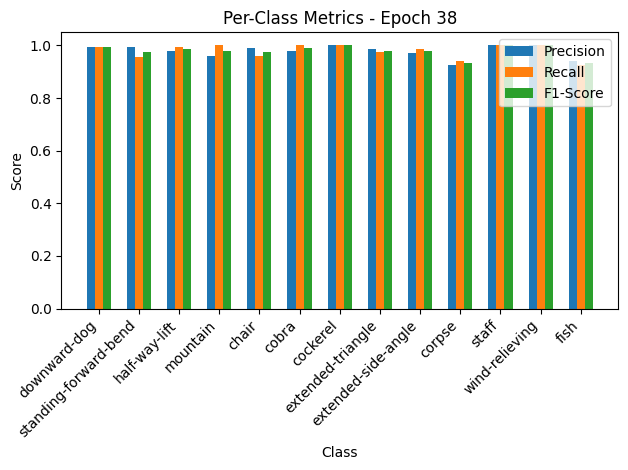

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.98it/s, loss=0.057, accuracy=98.6]


Per-Class Metrics for Epoch 38:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.99
mountain: Precision=0.96, Recall=1.00, F1-Score=0.98
chair: Precision=0.99, Recall=0.96, F1-Score=0.97
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.93, Recall=0.94, F1-Score=0.93
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.93, F1-Score=0.93


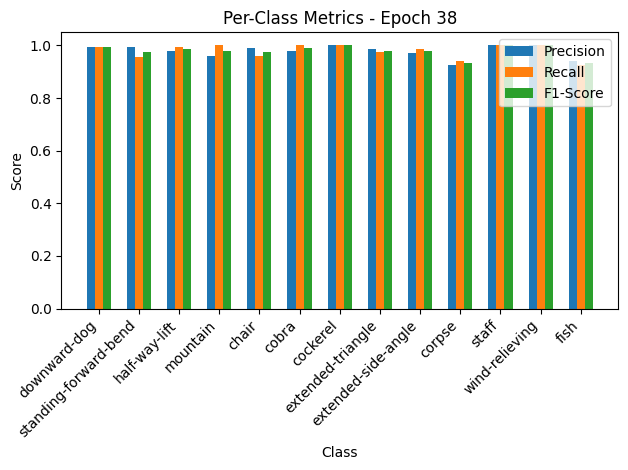


Epoch 39/50 Summary:
Train Loss: 0.1021 | Train Acc: 98.09% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.0625 | Val Acc: 98.63% | Val Precision: 0.99 | Val Recall: 0.99 | Val F1: 0.99

Epoch 40/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.17it/s, loss=0.11, accuracy=98.1]


Per-Class Metrics for Epoch 39:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.98, F1-Score=0.98
mountain: Precision=0.96, Recall=1.00, F1-Score=0.98
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.92, Recall=1.00, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.91, F1-Score=0.95


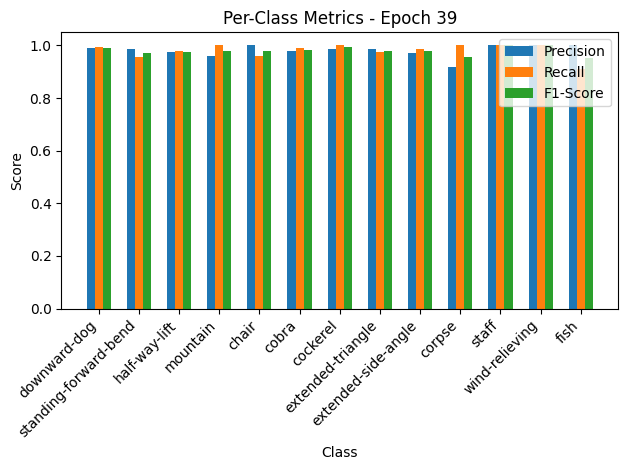

Validation: 100%|██████████| 10/10 [00:00<00:00, 28.05it/s, loss=0.0567, accuracy=98.6]


Per-Class Metrics for Epoch 39:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.98, F1-Score=0.98
mountain: Precision=0.96, Recall=1.00, F1-Score=0.98
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.92, Recall=1.00, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.91, F1-Score=0.95


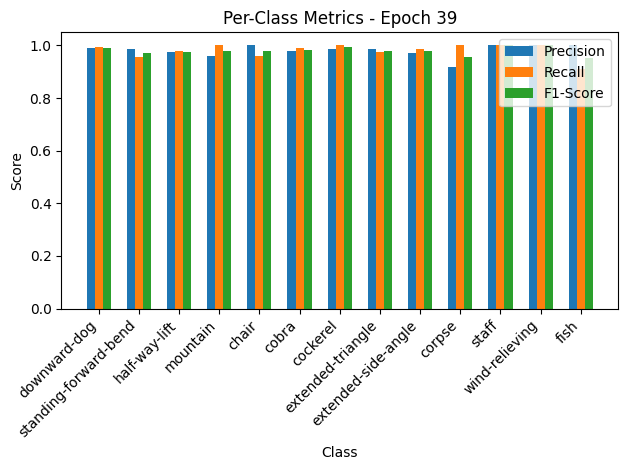


Epoch 40/50 Summary:
Train Loss: 0.1102 | Train Acc: 98.09% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.0622 | Val Acc: 98.63% | Val Precision: 0.99 | Val Recall: 0.99 | Val F1: 0.99

Epoch 41/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.56it/s, loss=0.0902, accuracy=98.2]


Per-Class Metrics for Epoch 40:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.99
mountain: Precision=0.95, Recall=0.99, F1-Score=0.97
chair: Precision=0.99, Recall=0.96, F1-Score=0.97
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.93, Recall=0.96, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.95, Recall=0.93, F1-Score=0.94


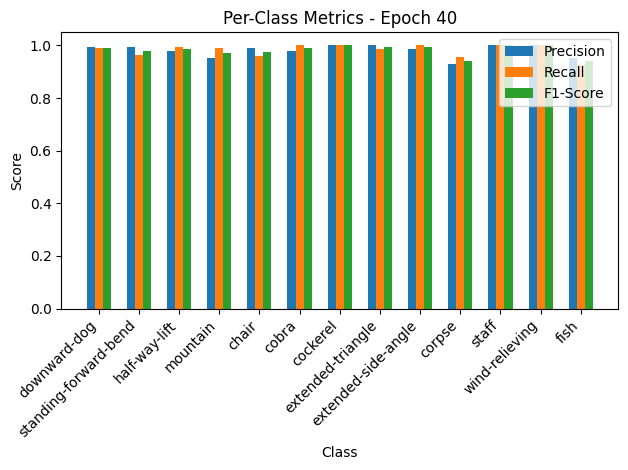

Validation: 100%|██████████| 10/10 [00:00<00:00, 23.41it/s, loss=0.0542, accuracy=98.6]


Per-Class Metrics for Epoch 40:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.99
mountain: Precision=0.95, Recall=0.99, F1-Score=0.97
chair: Precision=0.99, Recall=0.96, F1-Score=0.97
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.93, Recall=0.96, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.95, Recall=0.93, F1-Score=0.94


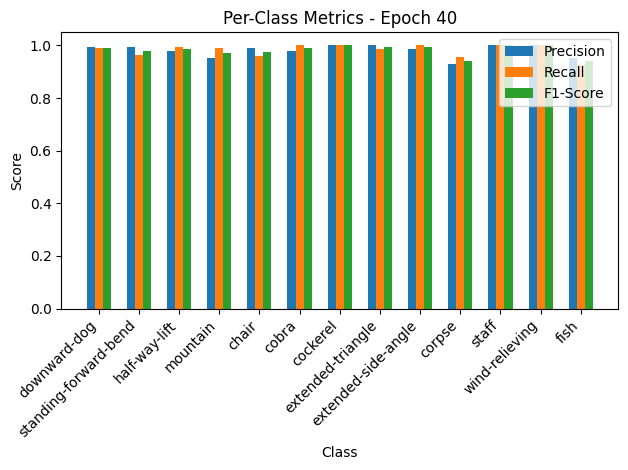


Epoch 41/50 Summary:
Train Loss: 0.0904 | Train Acc: 98.24% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.0594 | Val Acc: 98.63% | Val Precision: 0.99 | Val Recall: 0.99 | Val F1: 0.99
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_1.pth
Checkpoint saved at epoch 41
New best model saved! Validation Loss: 0.0594

Epoch 42/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.68it/s, loss=0.0999, accuracy=98.1]


Per-Class Metrics for Epoch 41:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.95, Recall=1.00, F1-Score=0.98
chair: Precision=0.99, Recall=0.96, F1-Score=0.97
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.92, Recall=0.99, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.91, F1-Score=0.95


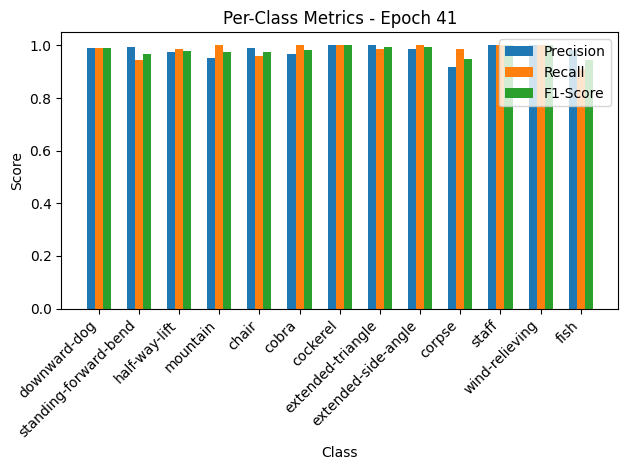

Validation: 100%|██████████| 10/10 [00:00<00:00, 24.53it/s, loss=0.0524, accuracy=98.6]


Per-Class Metrics for Epoch 41:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.95, Recall=1.00, F1-Score=0.98
chair: Precision=0.99, Recall=0.96, F1-Score=0.97
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.92, Recall=0.99, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.91, F1-Score=0.95


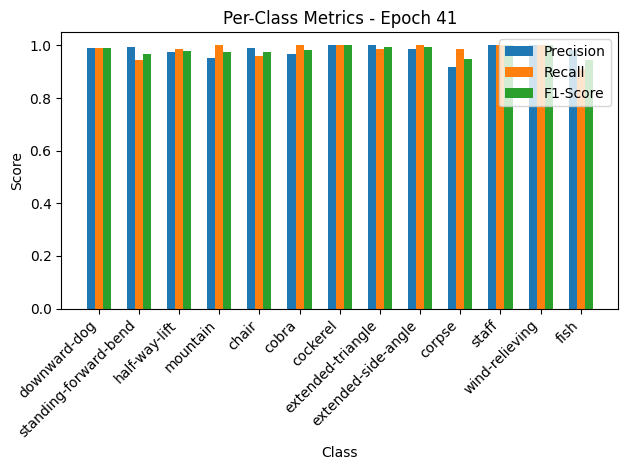


Epoch 42/50 Summary:
Train Loss: 0.1002 | Train Acc: 98.09% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.0574 | Val Acc: 98.63% | Val Precision: 0.99 | Val Recall: 0.99 | Val F1: 0.99
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_1.pth
Checkpoint saved at epoch 42
New best model saved! Validation Loss: 0.0574

Epoch 43/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.35it/s, loss=0.0877, accuracy=98.1]


Per-Class Metrics for Epoch 42:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=1.00, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.99
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=0.99, Recall=0.95, F1-Score=0.97
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.92, Recall=0.96, F1-Score=0.94
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.91, F1-Score=0.94


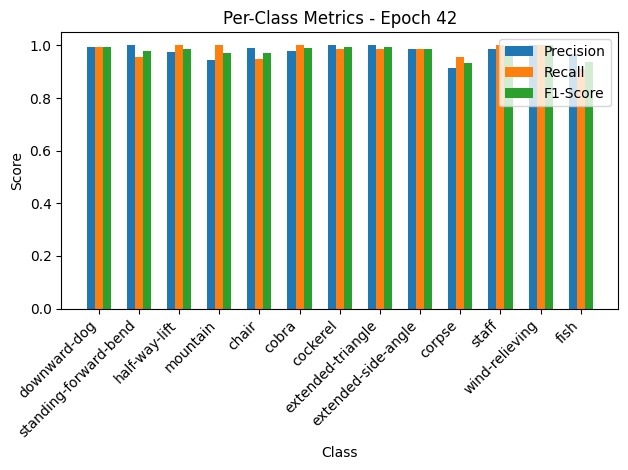

Validation: 100%|██████████| 10/10 [00:00<00:00, 25.79it/s, loss=0.0501, accuracy=98.6]


Per-Class Metrics for Epoch 42:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=1.00, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.99
mountain: Precision=0.94, Recall=1.00, F1-Score=0.97
chair: Precision=0.99, Recall=0.95, F1-Score=0.97
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.92, Recall=0.96, F1-Score=0.94
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.91, F1-Score=0.94


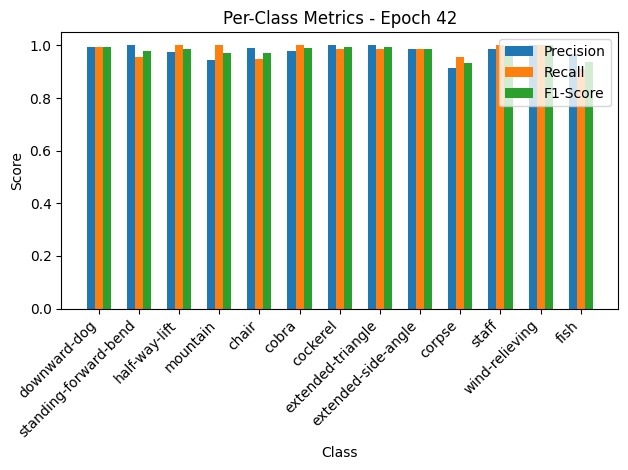


Epoch 43/50 Summary:
Train Loss: 0.0880 | Train Acc: 98.09% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.0549 | Val Acc: 98.63% | Val Precision: 0.99 | Val Recall: 0.99 | Val F1: 0.99
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_1.pth
Checkpoint saved at epoch 43
New best model saved! Validation Loss: 0.0549

Epoch 44/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  6.83it/s, loss=0.0876, accuracy=98.5]


Per-Class Metrics for Epoch 43:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.99, Recall=0.99, F1-Score=0.99
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=0.99, Recall=0.96, F1-Score=0.97
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.93, Recall=0.99, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.93, F1-Score=0.95


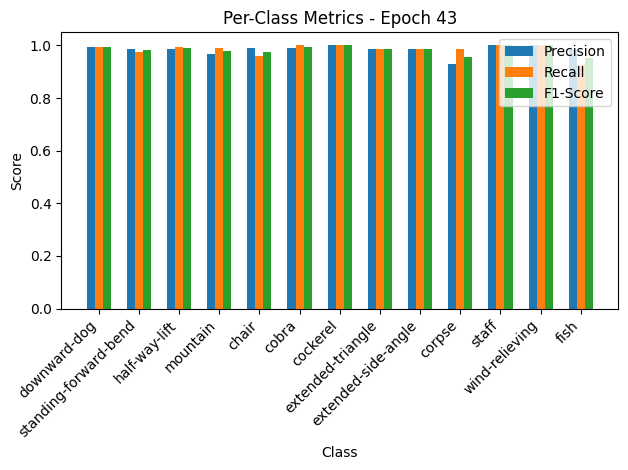

Validation: 100%|██████████| 10/10 [00:00<00:00, 25.64it/s, loss=0.0589, accuracy=97.9]


Per-Class Metrics for Epoch 43:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.99, Recall=0.99, F1-Score=0.99
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=0.99, Recall=0.96, F1-Score=0.97
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.93, Recall=0.99, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.93, F1-Score=0.95


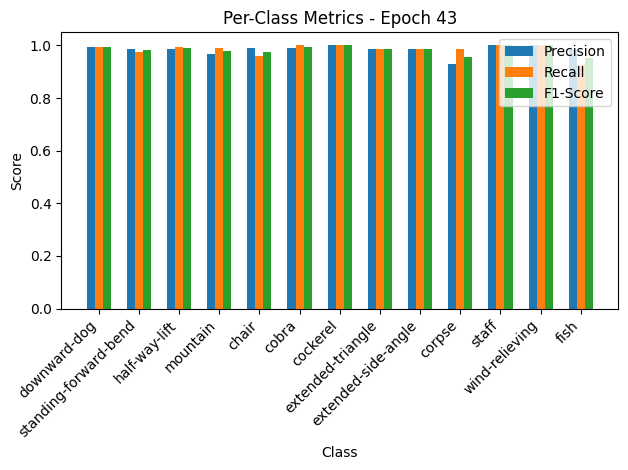


Epoch 44/50 Summary:
Train Loss: 0.0879 | Train Acc: 98.55% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.0646 | Val Acc: 97.95% | Val Precision: 0.99 | Val Recall: 0.99 | Val F1: 0.99

Epoch 45/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:12<00:00,  6.80it/s, loss=0.0937, accuracy=98.1]


Per-Class Metrics for Epoch 44:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.96, Recall=1.00, F1-Score=0.98
chair: Precision=0.98, Recall=0.96, F1-Score=0.97
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=0.98, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.93, Recall=0.99, F1-Score=0.96
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.93, F1-Score=0.95


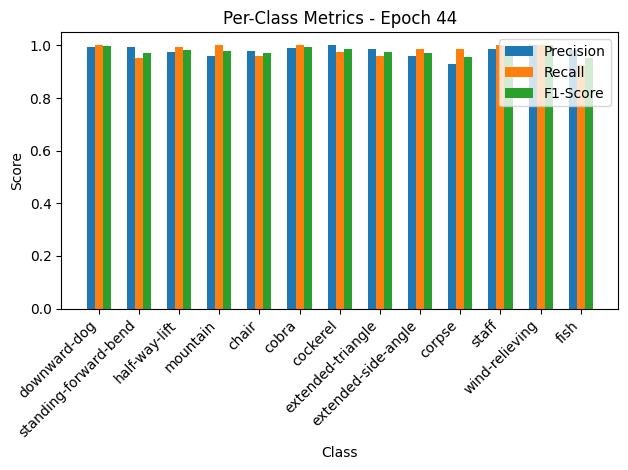

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.50it/s, loss=0.0625, accuracy=97.3]


Per-Class Metrics for Epoch 44:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.96, Recall=1.00, F1-Score=0.98
chair: Precision=0.98, Recall=0.96, F1-Score=0.97
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=0.98, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.93, Recall=0.99, F1-Score=0.96
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.93, F1-Score=0.95


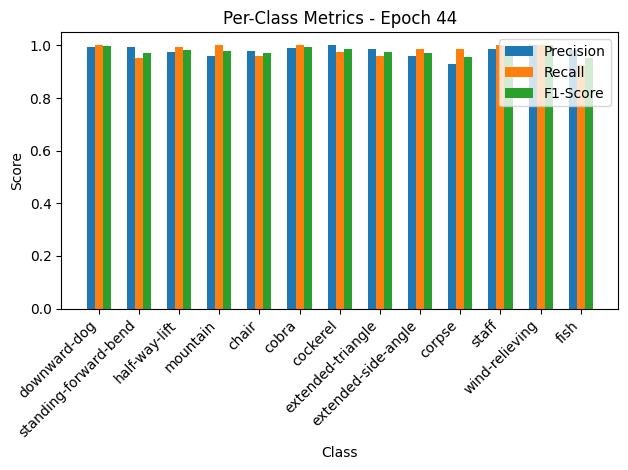


Epoch 45/50 Summary:
Train Loss: 0.0940 | Train Acc: 98.09% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.0685 | Val Acc: 97.26% | Val Precision: 0.99 | Val Recall: 0.98 | Val F1: 0.98

Epoch 46/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  6.91it/s, loss=0.0784, accuracy=98.7]


Per-Class Metrics for Epoch 45:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.99, Recall=0.99, F1-Score=0.99
mountain: Precision=0.97, Recall=1.00, F1-Score=0.98
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.94, Recall=0.97, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.94, F1-Score=0.95


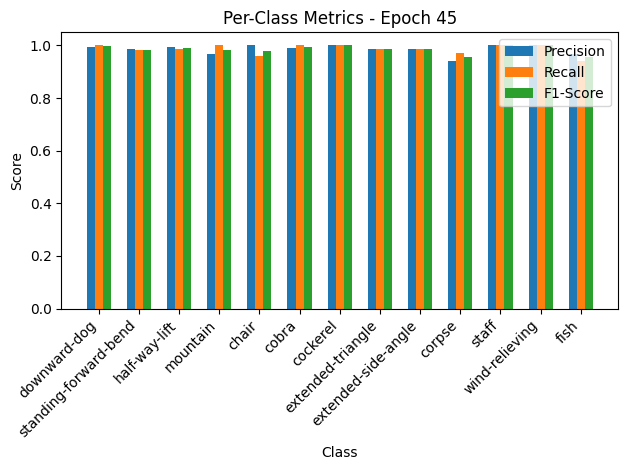

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.24it/s, loss=0.0577, accuracy=97.9]


Per-Class Metrics for Epoch 45:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.99, Recall=0.99, F1-Score=0.99
mountain: Precision=0.97, Recall=1.00, F1-Score=0.98
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.94, Recall=0.97, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.94, F1-Score=0.95


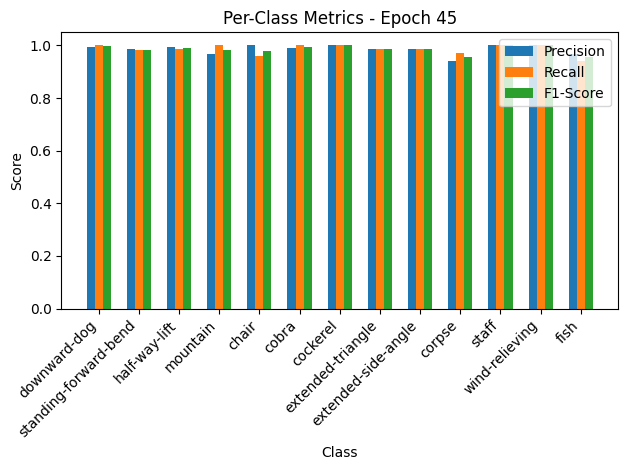


Epoch 46/50 Summary:
Train Loss: 0.0787 | Train Acc: 98.70% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0632 | Val Acc: 97.95% | Val Precision: 0.99 | Val Recall: 0.98 | Val F1: 0.99

Epoch 47/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.03it/s, loss=0.091, accuracy=98.2]


Per-Class Metrics for Epoch 46:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=1.00, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.98
mountain: Precision=0.95, Recall=1.00, F1-Score=0.98
chair: Precision=1.00, Recall=0.95, F1-Score=0.97
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.94, Recall=0.94, F1-Score=0.94


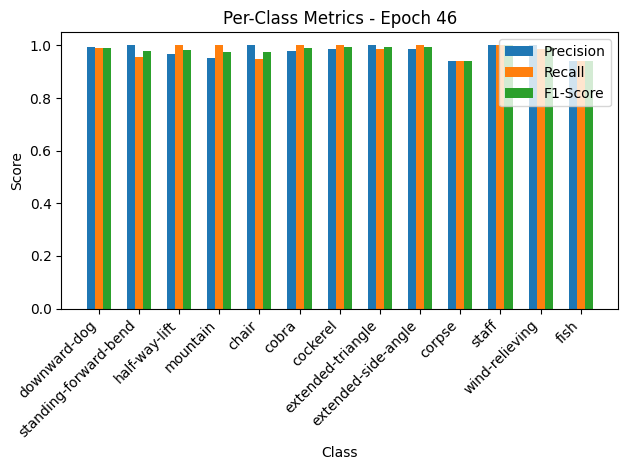

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.45it/s, loss=0.0612, accuracy=97.9]


Per-Class Metrics for Epoch 46:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=1.00, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.98
mountain: Precision=0.95, Recall=1.00, F1-Score=0.98
chair: Precision=1.00, Recall=0.95, F1-Score=0.97
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.94, Recall=0.94, F1-Score=0.94


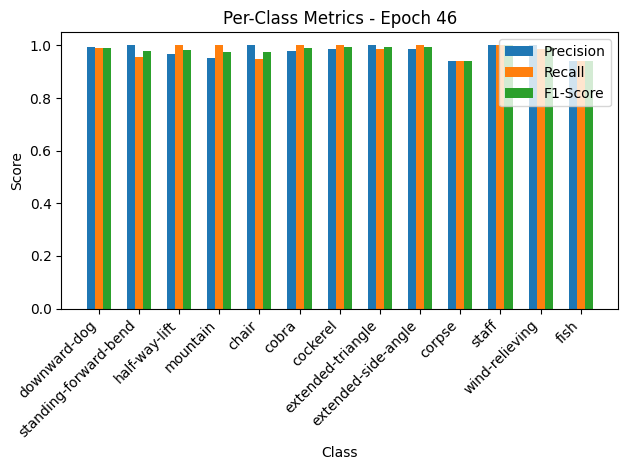


Epoch 47/50 Summary:
Train Loss: 0.0913 | Train Acc: 98.17% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.0671 | Val Acc: 97.95% | Val Precision: 0.99 | Val Recall: 0.99 | Val F1: 0.99

Epoch 48/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.83it/s, loss=0.0824, accuracy=98.5]


Per-Class Metrics for Epoch 47:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=0.99, F1-Score=0.99
mountain: Precision=0.97, Recall=1.00, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.91, Recall=1.00, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=1.00, Recall=0.91, F1-Score=0.95


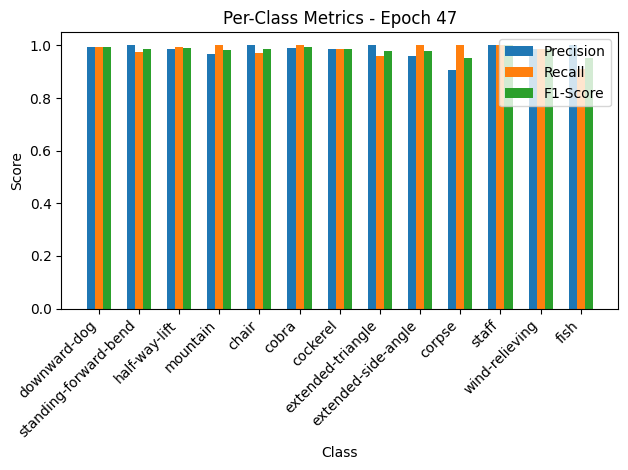

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.79it/s, loss=0.0541, accuracy=98.6]


Per-Class Metrics for Epoch 47:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=0.99, F1-Score=0.99
mountain: Precision=0.97, Recall=1.00, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.91, Recall=1.00, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=1.00, Recall=0.91, F1-Score=0.95


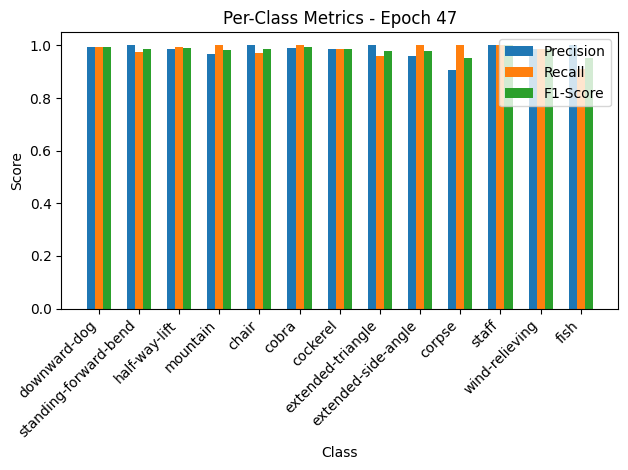


Epoch 48/50 Summary:
Train Loss: 0.0827 | Train Acc: 98.47% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.0592 | Val Acc: 98.63% | Val Precision: 0.99 | Val Recall: 0.99 | Val F1: 0.99

Epoch 49/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.73it/s, loss=0.0879, accuracy=98]


Per-Class Metrics for Epoch 48:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.98, F1-Score=0.98
mountain: Precision=0.96, Recall=1.00, F1-Score=0.98
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.90, Recall=0.97, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.90, F1-Score=0.93


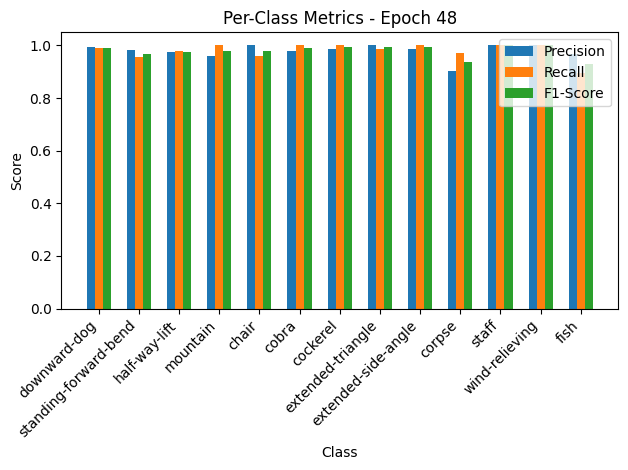

Validation: 100%|██████████| 10/10 [00:00<00:00, 25.76it/s, loss=0.0578, accuracy=97.9]


Per-Class Metrics for Epoch 48:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.98, F1-Score=0.98
mountain: Precision=0.96, Recall=1.00, F1-Score=0.98
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.90, Recall=0.97, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.90, F1-Score=0.93


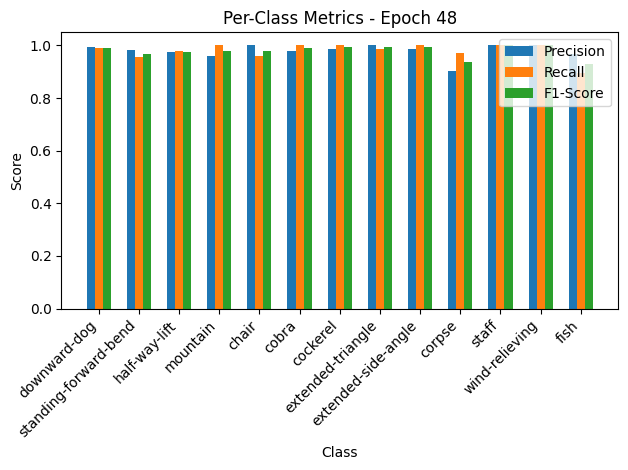


Epoch 49/50 Summary:
Train Loss: 0.0882 | Train Acc: 98.01% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.0633 | Val Acc: 97.95% | Val Precision: 0.99 | Val Recall: 0.98 | Val F1: 0.99

Epoch 50/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:11<00:00,  7.08it/s, loss=0.0752, accuracy=98.7]


Per-Class Metrics for Epoch 49:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.99, Recall=0.99, F1-Score=0.99
mountain: Precision=0.95, Recall=1.00, F1-Score=0.98
chair: Precision=1.00, Recall=0.95, F1-Score=0.97
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.96, Recall=0.99, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.96, F1-Score=0.97


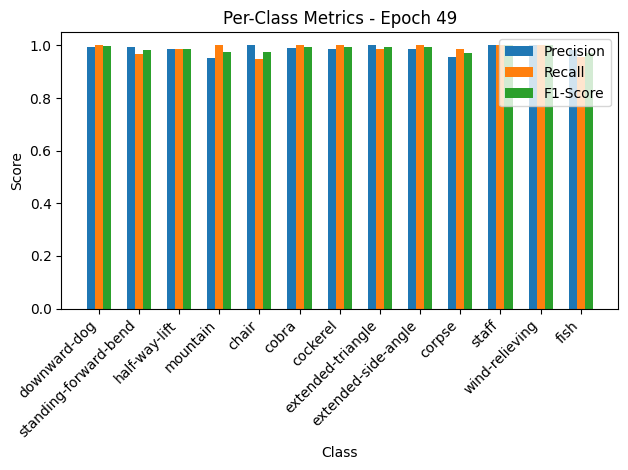

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.19it/s, loss=0.0573, accuracy=97.9]


Per-Class Metrics for Epoch 49:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.99, Recall=0.99, F1-Score=0.99
mountain: Precision=0.95, Recall=1.00, F1-Score=0.98
chair: Precision=1.00, Recall=0.95, F1-Score=0.97
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.96, Recall=0.99, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.96, F1-Score=0.97


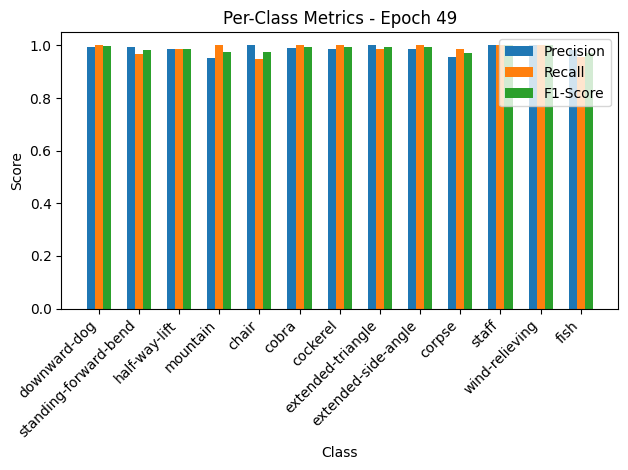


Epoch 50/50 Summary:
Train Loss: 0.0754 | Train Acc: 98.70% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0628 | Val Acc: 97.95% | Val Precision: 0.99 | Val Recall: 0.98 | Val F1: 0.99


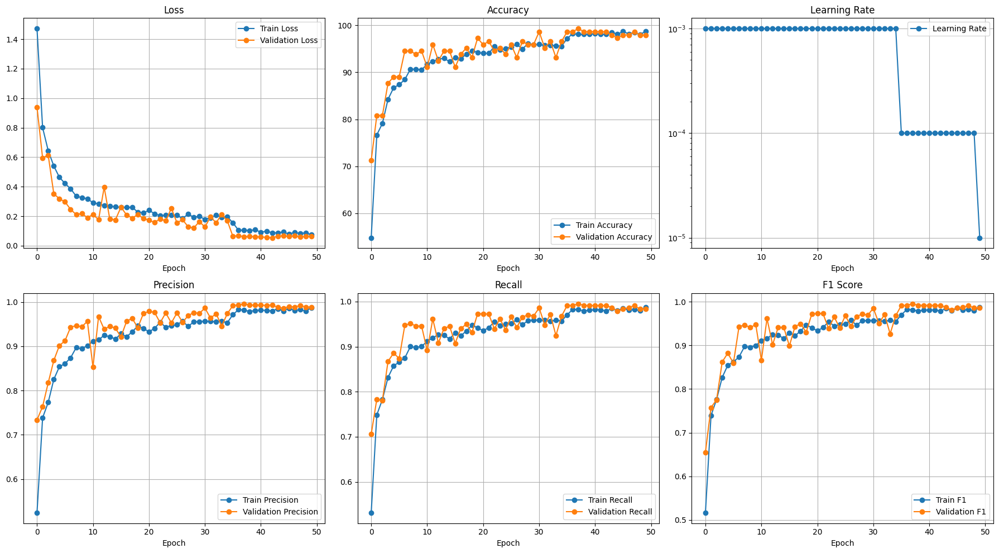

Testing: 100%|██████████| 23/23 [00:00<00:00, 28.91it/s]


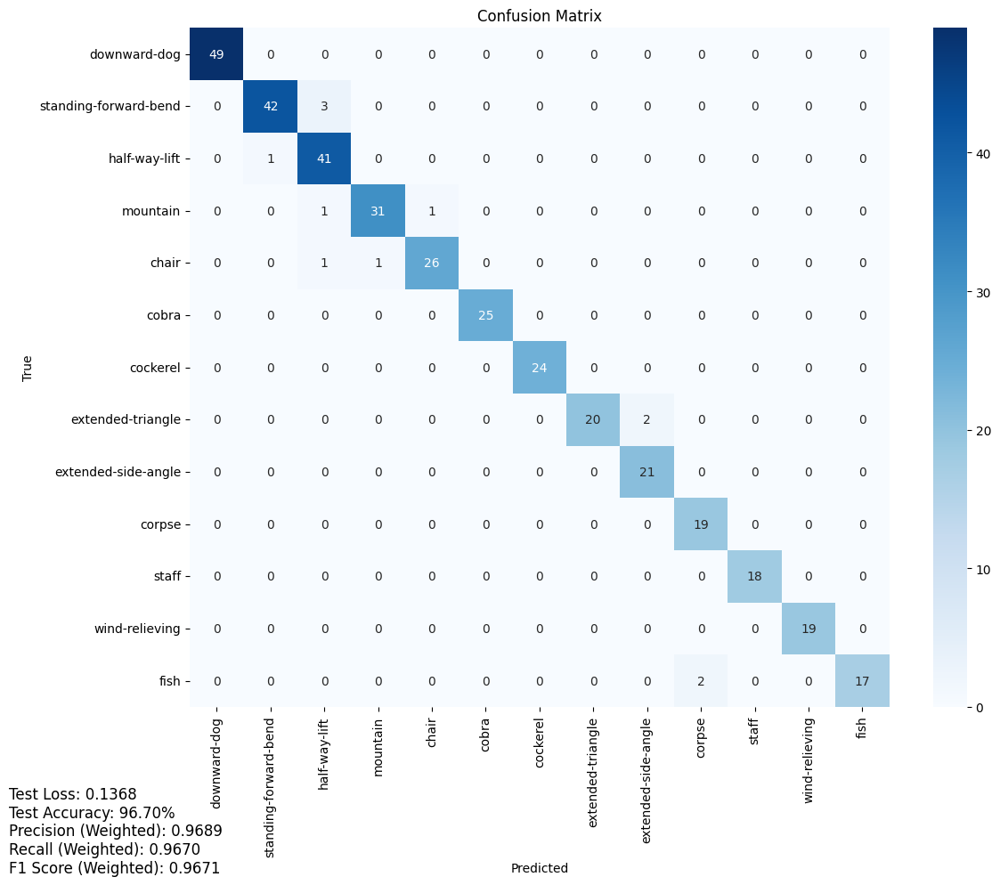

Test Loss: 0.1368
Test Accuracy: 96.70%
Precision (Weighted): 0.9689
Recall (Weighted): 0.9670
F1 Score (Weighted): 0.9671


Testing: 100%|██████████| 23/23 [00:00<00:00, 23.45it/s]


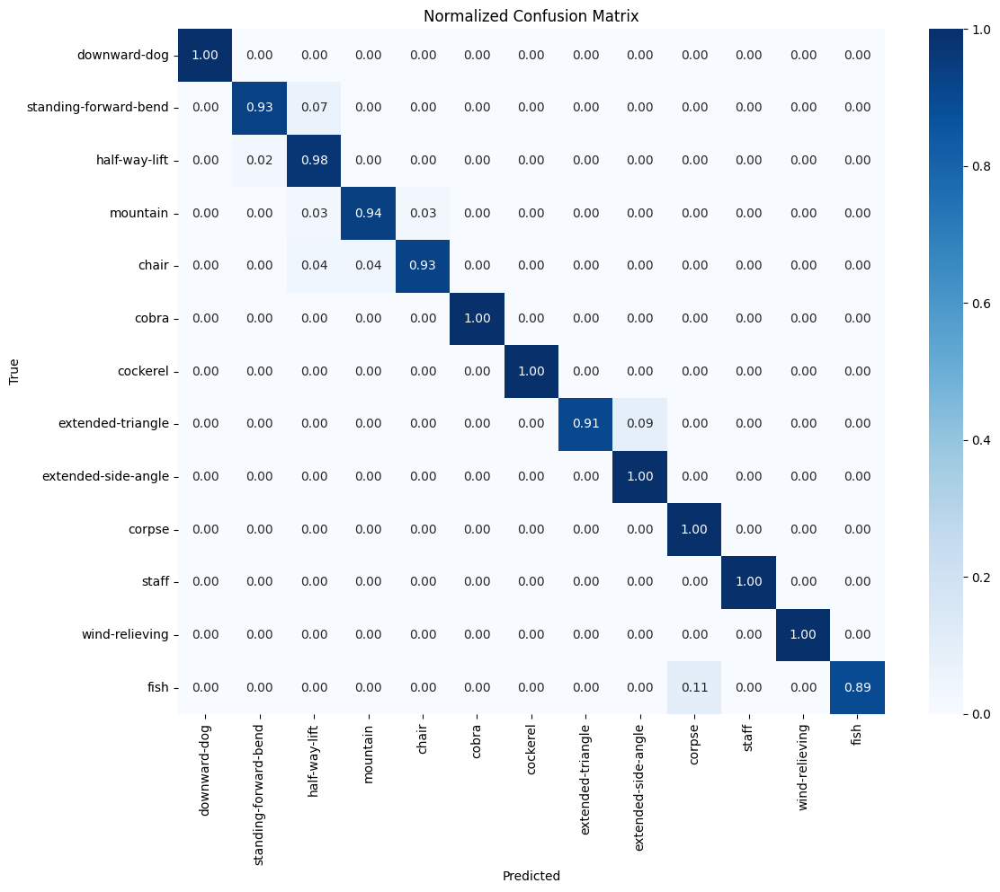

Test Loss: 0.1368
Test Accuracy: 96.70%
Precision (Macro): 0.9706
Recall (Macro): 0.9678
F1 Score (Macro): 0.9682
Saved checkpoint for fold 2
Fold 3/5
Loading cached criterion for fold 2
batch_norm.weight: 99
batch_norm.bias: 99
blocks.0.agcn.A: 3267
blocks.0.agcn.conv.weight: 1080
blocks.0.agcn.conv.bias: 360
blocks.0.agcn.batch_norm.weight: 120
blocks.0.agcn.batch_norm.bias: 120
blocks.0.sam.gs.weight: 3960
blocks.0.sam.gs.bias: 1
blocks.0.tam.gt.weight: 1080
blocks.0.tam.gt.bias: 1
blocks.0.cam.fc.0.weight: 7200
blocks.0.cam.fc.0.bias: 60
blocks.0.cam.fc.2.weight: 7200
blocks.0.cam.fc.2.bias: 120
blocks.0.mtcn.branches.0.0.weight: 2400
blocks.0.mtcn.branches.0.0.bias: 20
blocks.0.mtcn.branches.0.1.weight: 20
blocks.0.mtcn.branches.0.1.bias: 20
blocks.0.mtcn.branches.0.3.conv.weight: 1200
blocks.0.mtcn.branches.0.3.conv.bias: 20
blocks.0.mtcn.branches.0.3.bn.weight: 20
blocks.0.mtcn.branches.0.3.bn.bias: 20
blocks.0.mtcn.branches.1.0.weight: 2400
blocks.0.mtcn.branches.1.0.bias: 20
b

Training: 100%|██████████| 82/82 [00:10<00:00,  7.64it/s, loss=1.62, accuracy=53.1]


Per-Class Metrics for Epoch 0:
downward-dog: Precision=0.75, Recall=0.65, F1-Score=0.70
standing-forward-bend: Precision=0.74, Recall=0.40, F1-Score=0.51
half-way-lift: Precision=0.65, Recall=0.85, F1-Score=0.74
mountain: Precision=0.49, Recall=0.66, F1-Score=0.56
chair: Precision=0.61, Recall=0.38, F1-Score=0.47
cobra: Precision=0.48, Recall=0.66, F1-Score=0.55
cockerel: Precision=0.71, Recall=0.56, F1-Score=0.62
extended-triangle: Precision=0.48, Recall=0.26, F1-Score=0.34
extended-side-angle: Precision=0.23, Recall=0.51, F1-Score=0.31
corpse: Precision=0.40, Recall=0.18, F1-Score=0.24
staff: Precision=0.42, Recall=0.63, F1-Score=0.50
wind-relieving: Precision=0.50, Recall=0.49, F1-Score=0.49
fish: Precision=0.36, Recall=0.30, F1-Score=0.33


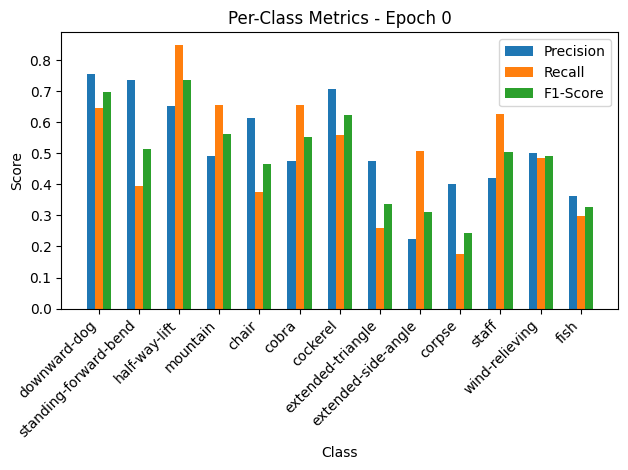

Validation: 100%|██████████| 10/10 [00:00<00:00, 21.90it/s, loss=0.781, accuracy=72.6]


Per-Class Metrics for Epoch 0:
downward-dog: Precision=0.75, Recall=0.65, F1-Score=0.70
standing-forward-bend: Precision=0.74, Recall=0.40, F1-Score=0.51
half-way-lift: Precision=0.65, Recall=0.85, F1-Score=0.74
mountain: Precision=0.49, Recall=0.66, F1-Score=0.56
chair: Precision=0.61, Recall=0.38, F1-Score=0.47
cobra: Precision=0.48, Recall=0.66, F1-Score=0.55
cockerel: Precision=0.71, Recall=0.56, F1-Score=0.62
extended-triangle: Precision=0.48, Recall=0.26, F1-Score=0.34
extended-side-angle: Precision=0.23, Recall=0.51, F1-Score=0.31
corpse: Precision=0.40, Recall=0.18, F1-Score=0.24
staff: Precision=0.42, Recall=0.63, F1-Score=0.50
wind-relieving: Precision=0.50, Recall=0.49, F1-Score=0.49
fish: Precision=0.36, Recall=0.30, F1-Score=0.33


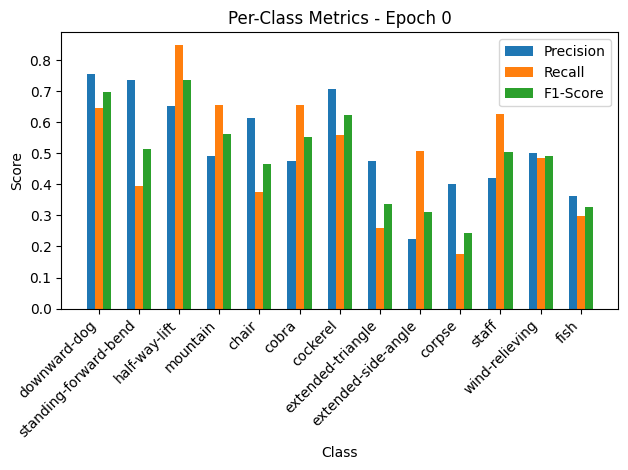


Epoch 1/50 Summary:
Train Loss: 1.6282 | Train Acc: 53.13% | Train Precision: 0.52 | Train Recall: 0.50 | Train F1: 0.49
Val Loss: 0.8558 | Val Acc: 72.60% | Val Precision: 0.80 | Val Recall: 0.73 | Val F1: 0.69
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_2.pth
Checkpoint saved at epoch 1
New best model saved! Validation Loss: 0.8558

Epoch 2/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.46it/s, loss=0.773, accuracy=77.1]


Per-Class Metrics for Epoch 1:
downward-dog: Precision=0.90, Recall=0.85, F1-Score=0.87
standing-forward-bend: Precision=0.86, Recall=0.72, F1-Score=0.78
half-way-lift: Precision=0.80, Recall=0.89, F1-Score=0.84
mountain: Precision=0.74, Recall=0.74, F1-Score=0.74
chair: Precision=0.66, Recall=0.66, F1-Score=0.66
cobra: Precision=0.84, Recall=0.89, F1-Score=0.86
cockerel: Precision=0.86, Recall=0.88, F1-Score=0.87
extended-triangle: Precision=0.67, Recall=0.71, F1-Score=0.69
extended-side-angle: Precision=0.65, Recall=0.67, F1-Score=0.66
corpse: Precision=0.58, Recall=0.47, F1-Score=0.52
staff: Precision=0.77, Recall=0.93, F1-Score=0.84
wind-relieving: Precision=0.83, Recall=0.84, F1-Score=0.83
fish: Precision=0.57, Recall=0.60, F1-Score=0.58


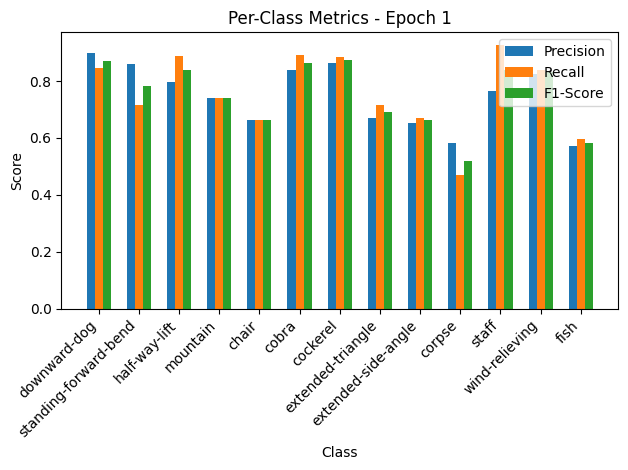

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.11it/s, loss=0.473, accuracy=78.8]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 1:
downward-dog: Precision=0.90, Recall=0.85, F1-Score=0.87
standing-forward-bend: Precision=0.86, Recall=0.72, F1-Score=0.78
half-way-lift: Precision=0.80, Recall=0.89, F1-Score=0.84
mountain: Precision=0.74, Recall=0.74, F1-Score=0.74
chair: Precision=0.66, Recall=0.66, F1-Score=0.66
cobra: Precision=0.84, Recall=0.89, F1-Score=0.86
cockerel: Precision=0.86, Recall=0.88, F1-Score=0.87
extended-triangle: Precision=0.67, Recall=0.71, F1-Score=0.69
extended-side-angle: Precision=0.65, Recall=0.67, F1-Score=0.66
corpse: Precision=0.58, Recall=0.47, F1-Score=0.52
staff: Precision=0.77, Recall=0.93, F1-Score=0.84
wind-relieving: Precision=0.83, Recall=0.84, F1-Score=0.83
fish: Precision=0.57, Recall=0.60, F1-Score=0.58


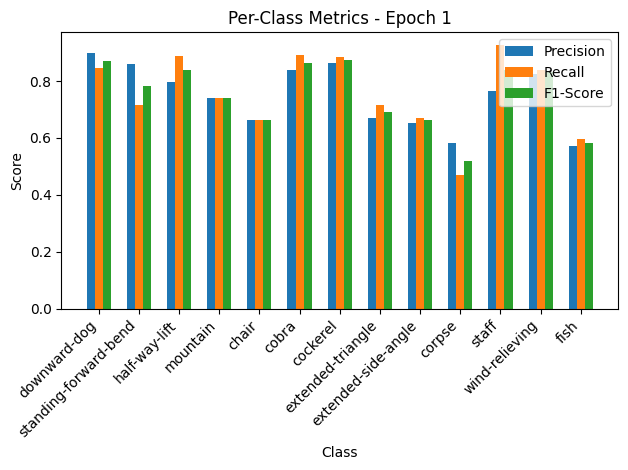


Epoch 2/50 Summary:
Train Loss: 0.7750 | Train Acc: 77.06% | Train Precision: 0.75 | Train Recall: 0.76 | Train F1: 0.75
Val Loss: 0.5179 | Val Acc: 78.77% | Val Precision: 0.76 | Val Recall: 0.77 | Val F1: 0.75
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_2.pth
Checkpoint saved at epoch 2
New best model saved! Validation Loss: 0.5179

Epoch 3/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.41it/s, loss=0.59, accuracy=83.6]


Per-Class Metrics for Epoch 2:
downward-dog: Precision=0.93, Recall=0.86, F1-Score=0.90
standing-forward-bend: Precision=0.91, Recall=0.77, F1-Score=0.84
half-way-lift: Precision=0.83, Recall=0.91, F1-Score=0.86
mountain: Precision=0.87, Recall=0.91, F1-Score=0.89
chair: Precision=0.79, Recall=0.83, F1-Score=0.81
cobra: Precision=0.85, Recall=0.92, F1-Score=0.89
cockerel: Precision=0.89, Recall=0.93, F1-Score=0.91
extended-triangle: Precision=0.78, Recall=0.79, F1-Score=0.79
extended-side-angle: Precision=0.75, Recall=0.71, F1-Score=0.73
corpse: Precision=0.62, Recall=0.56, F1-Score=0.59
staff: Precision=0.89, Recall=0.97, F1-Score=0.93
wind-relieving: Precision=0.87, Recall=0.91, F1-Score=0.89
fish: Precision=0.64, Recall=0.66, F1-Score=0.65


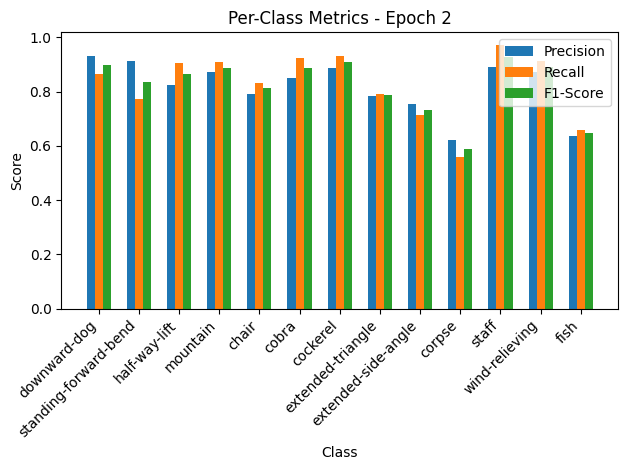

Validation: 100%|██████████| 10/10 [00:00<00:00, 28.14it/s, loss=0.332, accuracy=87]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 2:
downward-dog: Precision=0.93, Recall=0.86, F1-Score=0.90
standing-forward-bend: Precision=0.91, Recall=0.77, F1-Score=0.84
half-way-lift: Precision=0.83, Recall=0.91, F1-Score=0.86
mountain: Precision=0.87, Recall=0.91, F1-Score=0.89
chair: Precision=0.79, Recall=0.83, F1-Score=0.81
cobra: Precision=0.85, Recall=0.92, F1-Score=0.89
cockerel: Precision=0.89, Recall=0.93, F1-Score=0.91
extended-triangle: Precision=0.78, Recall=0.79, F1-Score=0.79
extended-side-angle: Precision=0.75, Recall=0.71, F1-Score=0.73
corpse: Precision=0.62, Recall=0.56, F1-Score=0.59
staff: Precision=0.89, Recall=0.97, F1-Score=0.93
wind-relieving: Precision=0.87, Recall=0.91, F1-Score=0.89
fish: Precision=0.64, Recall=0.66, F1-Score=0.65


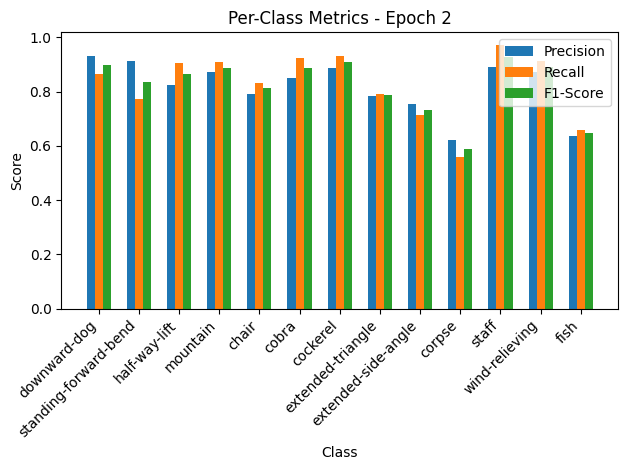


Epoch 3/50 Summary:
Train Loss: 0.5919 | Train Acc: 83.64% | Train Precision: 0.82 | Train Recall: 0.83 | Train F1: 0.82
Val Loss: 0.3642 | Val Acc: 86.99% | Val Precision: 0.81 | Val Recall: 0.85 | Val F1: 0.82
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_2.pth
Checkpoint saved at epoch 3
New best model saved! Validation Loss: 0.3642

Epoch 4/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  6.94it/s, loss=0.491, accuracy=86.2]


Per-Class Metrics for Epoch 3:
downward-dog: Precision=0.94, Recall=0.91, F1-Score=0.93
standing-forward-bend: Precision=0.98, Recall=0.84, F1-Score=0.90
half-way-lift: Precision=0.84, Recall=0.93, F1-Score=0.89
mountain: Precision=0.86, Recall=0.89, F1-Score=0.88
chair: Precision=0.86, Recall=0.82, F1-Score=0.84
cobra: Precision=0.91, Recall=0.96, F1-Score=0.93
cockerel: Precision=0.92, Recall=0.95, F1-Score=0.94
extended-triangle: Precision=0.84, Recall=0.81, F1-Score=0.82
extended-side-angle: Precision=0.77, Recall=0.84, F1-Score=0.80
corpse: Precision=0.59, Recall=0.57, F1-Score=0.58
staff: Precision=0.91, Recall=0.96, F1-Score=0.93
wind-relieving: Precision=0.90, Recall=0.94, F1-Score=0.92
fish: Precision=0.62, Recall=0.60, F1-Score=0.61


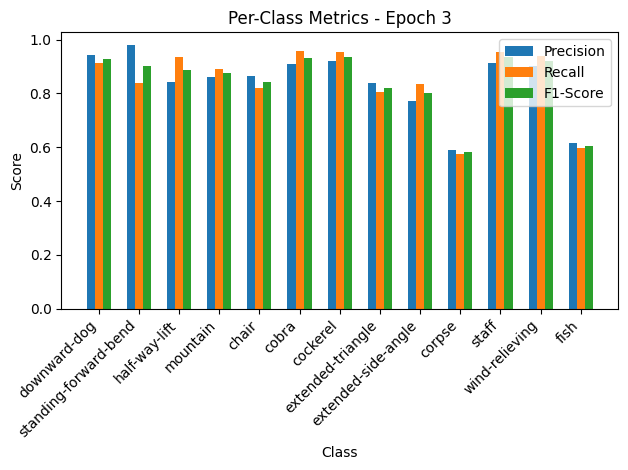

Validation: 100%|██████████| 10/10 [00:00<00:00, 28.03it/s, loss=0.265, accuracy=90.4]


Per-Class Metrics for Epoch 3:
downward-dog: Precision=0.94, Recall=0.91, F1-Score=0.93
standing-forward-bend: Precision=0.98, Recall=0.84, F1-Score=0.90
half-way-lift: Precision=0.84, Recall=0.93, F1-Score=0.89
mountain: Precision=0.86, Recall=0.89, F1-Score=0.88
chair: Precision=0.86, Recall=0.82, F1-Score=0.84
cobra: Precision=0.91, Recall=0.96, F1-Score=0.93
cockerel: Precision=0.92, Recall=0.95, F1-Score=0.94
extended-triangle: Precision=0.84, Recall=0.81, F1-Score=0.82
extended-side-angle: Precision=0.77, Recall=0.84, F1-Score=0.80
corpse: Precision=0.59, Recall=0.57, F1-Score=0.58
staff: Precision=0.91, Recall=0.96, F1-Score=0.93
wind-relieving: Precision=0.90, Recall=0.94, F1-Score=0.92
fish: Precision=0.62, Recall=0.60, F1-Score=0.61


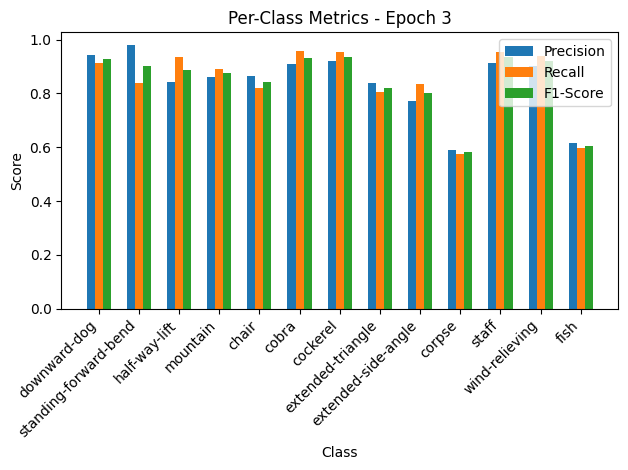


Epoch 4/50 Summary:
Train Loss: 0.4926 | Train Acc: 86.24% | Train Precision: 0.84 | Train Recall: 0.85 | Train F1: 0.84
Val Loss: 0.2907 | Val Acc: 90.41% | Val Precision: 0.92 | Val Recall: 0.92 | Val F1: 0.91
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_2.pth
Checkpoint saved at epoch 4
New best model saved! Validation Loss: 0.2907

Epoch 5/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.36it/s, loss=0.378, accuracy=89.7]


Per-Class Metrics for Epoch 4:
downward-dog: Precision=0.94, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=0.93, Recall=0.85, F1-Score=0.89
half-way-lift: Precision=0.88, Recall=0.92, F1-Score=0.90
mountain: Precision=0.91, Recall=0.96, F1-Score=0.93
chair: Precision=0.92, Recall=0.89, F1-Score=0.90
cobra: Precision=0.93, Recall=0.92, F1-Score=0.93
cockerel: Precision=0.95, Recall=0.97, F1-Score=0.96
extended-triangle: Precision=0.85, Recall=0.83, F1-Score=0.84
extended-side-angle: Precision=0.79, Recall=0.86, F1-Score=0.82
corpse: Precision=0.73, Recall=0.78, F1-Score=0.75
staff: Precision=0.93, Recall=0.96, F1-Score=0.94
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.78, Recall=0.69, F1-Score=0.73


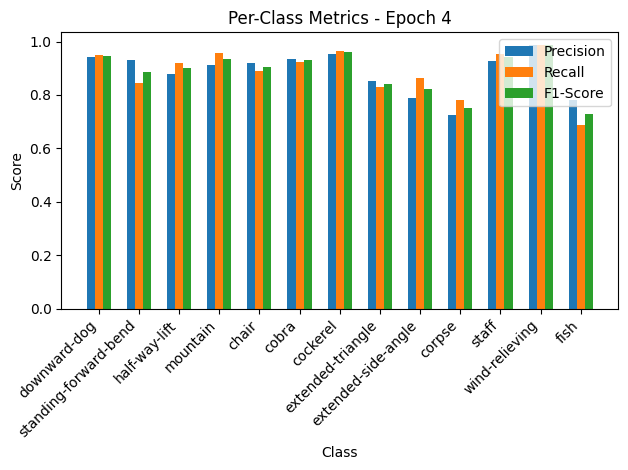

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.52it/s, loss=0.32, accuracy=88.4]


Per-Class Metrics for Epoch 4:
downward-dog: Precision=0.94, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=0.93, Recall=0.85, F1-Score=0.89
half-way-lift: Precision=0.88, Recall=0.92, F1-Score=0.90
mountain: Precision=0.91, Recall=0.96, F1-Score=0.93
chair: Precision=0.92, Recall=0.89, F1-Score=0.90
cobra: Precision=0.93, Recall=0.92, F1-Score=0.93
cockerel: Precision=0.95, Recall=0.97, F1-Score=0.96
extended-triangle: Precision=0.85, Recall=0.83, F1-Score=0.84
extended-side-angle: Precision=0.79, Recall=0.86, F1-Score=0.82
corpse: Precision=0.73, Recall=0.78, F1-Score=0.75
staff: Precision=0.93, Recall=0.96, F1-Score=0.94
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.78, Recall=0.69, F1-Score=0.73


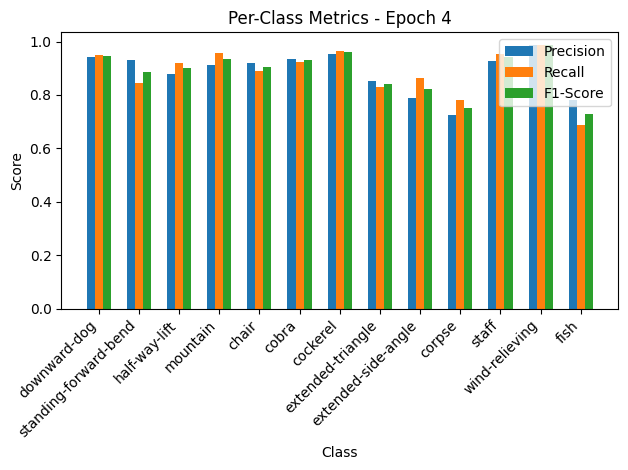


Epoch 5/50 Summary:
Train Loss: 0.3794 | Train Acc: 89.68% | Train Precision: 0.89 | Train Recall: 0.89 | Train F1: 0.89
Val Loss: 0.3504 | Val Acc: 88.36% | Val Precision: 0.91 | Val Recall: 0.89 | Val F1: 0.88

Epoch 6/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.05it/s, loss=0.375, accuracy=90.2]


Per-Class Metrics for Epoch 5:
downward-dog: Precision=0.95, Recall=0.94, F1-Score=0.95
standing-forward-bend: Precision=0.94, Recall=0.85, F1-Score=0.89
half-way-lift: Precision=0.88, Recall=0.93, F1-Score=0.90
mountain: Precision=0.93, Recall=0.94, F1-Score=0.93
chair: Precision=0.94, Recall=0.91, F1-Score=0.92
cobra: Precision=0.94, Recall=0.99, F1-Score=0.96
cockerel: Precision=0.91, Recall=0.99, F1-Score=0.95
extended-triangle: Precision=0.86, Recall=0.87, F1-Score=0.86
extended-side-angle: Precision=0.85, Recall=0.84, F1-Score=0.84
corpse: Precision=0.75, Recall=0.75, F1-Score=0.75
staff: Precision=0.93, Recall=0.96, F1-Score=0.94
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.73, Recall=0.72, F1-Score=0.72


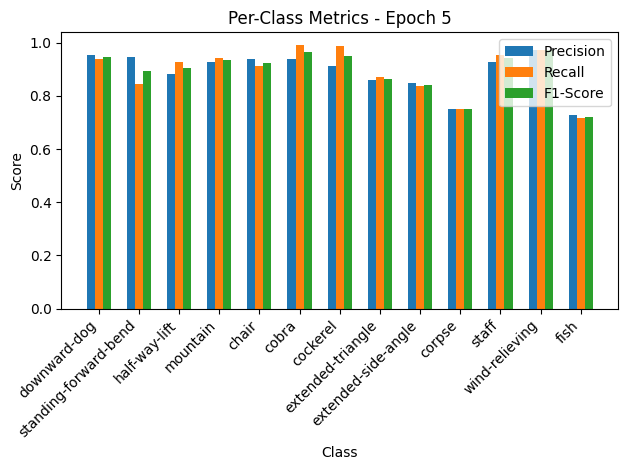

Validation: 100%|██████████| 10/10 [00:00<00:00, 24.94it/s, loss=0.246, accuracy=91.8]


Per-Class Metrics for Epoch 5:
downward-dog: Precision=0.95, Recall=0.94, F1-Score=0.95
standing-forward-bend: Precision=0.94, Recall=0.85, F1-Score=0.89
half-way-lift: Precision=0.88, Recall=0.93, F1-Score=0.90
mountain: Precision=0.93, Recall=0.94, F1-Score=0.93
chair: Precision=0.94, Recall=0.91, F1-Score=0.92
cobra: Precision=0.94, Recall=0.99, F1-Score=0.96
cockerel: Precision=0.91, Recall=0.99, F1-Score=0.95
extended-triangle: Precision=0.86, Recall=0.87, F1-Score=0.86
extended-side-angle: Precision=0.85, Recall=0.84, F1-Score=0.84
corpse: Precision=0.75, Recall=0.75, F1-Score=0.75
staff: Precision=0.93, Recall=0.96, F1-Score=0.94
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.73, Recall=0.72, F1-Score=0.72


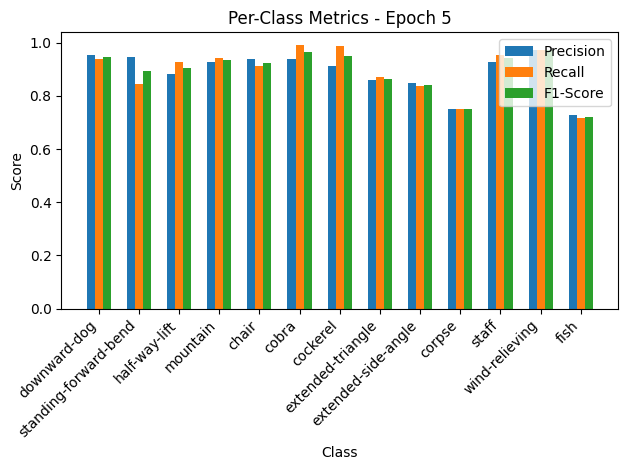


Epoch 6/50 Summary:
Train Loss: 0.3757 | Train Acc: 90.21% | Train Precision: 0.89 | Train Recall: 0.90 | Train F1: 0.89
Val Loss: 0.2695 | Val Acc: 91.78% | Val Precision: 0.92 | Val Recall: 0.92 | Val F1: 0.92
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_2.pth
Checkpoint saved at epoch 6
New best model saved! Validation Loss: 0.2695

Epoch 7/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  6.85it/s, loss=0.357, accuracy=90.4]


Per-Class Metrics for Epoch 6:
downward-dog: Precision=0.95, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=0.90, Recall=0.86, F1-Score=0.88
half-way-lift: Precision=0.88, Recall=0.87, F1-Score=0.88
mountain: Precision=0.91, Recall=0.97, F1-Score=0.93
chair: Precision=0.96, Recall=0.93, F1-Score=0.94
cobra: Precision=0.95, Recall=0.95, F1-Score=0.95
cockerel: Precision=0.95, Recall=0.95, F1-Score=0.95
extended-triangle: Precision=0.95, Recall=0.91, F1-Score=0.93
extended-side-angle: Precision=0.88, Recall=0.92, F1-Score=0.90
corpse: Precision=0.73, Recall=0.65, F1-Score=0.69
staff: Precision=0.92, Recall=1.00, F1-Score=0.96
wind-relieving: Precision=0.94, Recall=0.99, F1-Score=0.96
fish: Precision=0.71, Recall=0.75, F1-Score=0.73


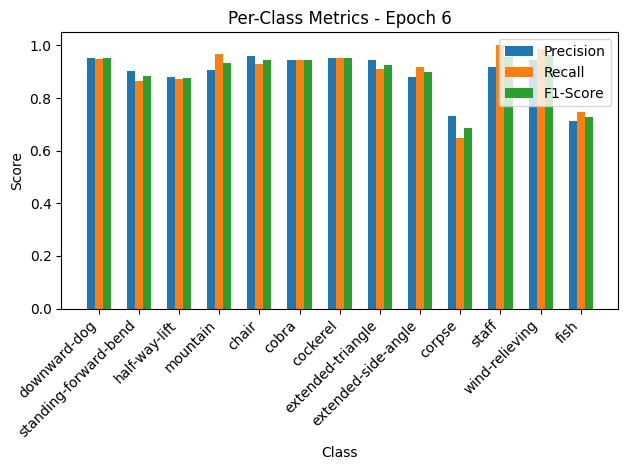

Validation: 100%|██████████| 10/10 [00:00<00:00, 25.92it/s, loss=0.211, accuracy=93.2]


Per-Class Metrics for Epoch 6:
downward-dog: Precision=0.95, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=0.90, Recall=0.86, F1-Score=0.88
half-way-lift: Precision=0.88, Recall=0.87, F1-Score=0.88
mountain: Precision=0.91, Recall=0.97, F1-Score=0.93
chair: Precision=0.96, Recall=0.93, F1-Score=0.94
cobra: Precision=0.95, Recall=0.95, F1-Score=0.95
cockerel: Precision=0.95, Recall=0.95, F1-Score=0.95
extended-triangle: Precision=0.95, Recall=0.91, F1-Score=0.93
extended-side-angle: Precision=0.88, Recall=0.92, F1-Score=0.90
corpse: Precision=0.73, Recall=0.65, F1-Score=0.69
staff: Precision=0.92, Recall=1.00, F1-Score=0.96
wind-relieving: Precision=0.94, Recall=0.99, F1-Score=0.96
fish: Precision=0.71, Recall=0.75, F1-Score=0.73


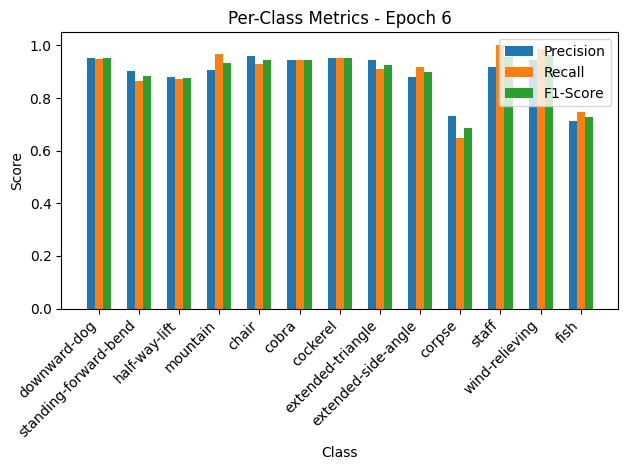


Epoch 7/50 Summary:
Train Loss: 0.3584 | Train Acc: 90.44% | Train Precision: 0.90 | Train Recall: 0.90 | Train F1: 0.90
Val Loss: 0.2312 | Val Acc: 93.15% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.94
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_2.pth
Checkpoint saved at epoch 7
New best model saved! Validation Loss: 0.2312

Epoch 8/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.56it/s, loss=0.323, accuracy=90.6]


Per-Class Metrics for Epoch 7:
downward-dog: Precision=0.96, Recall=0.94, F1-Score=0.95
standing-forward-bend: Precision=0.96, Recall=0.86, F1-Score=0.91
half-way-lift: Precision=0.90, Recall=0.93, F1-Score=0.92
mountain: Precision=0.91, Recall=0.95, F1-Score=0.93
chair: Precision=0.91, Recall=0.92, F1-Score=0.92
cobra: Precision=0.89, Recall=0.94, F1-Score=0.91
cockerel: Precision=0.94, Recall=0.97, F1-Score=0.95
extended-triangle: Precision=0.92, Recall=0.91, F1-Score=0.92
extended-side-angle: Precision=0.89, Recall=0.90, F1-Score=0.90
corpse: Precision=0.71, Recall=0.66, F1-Score=0.69
staff: Precision=0.96, Recall=1.00, F1-Score=0.98
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.70, Recall=0.73, F1-Score=0.72


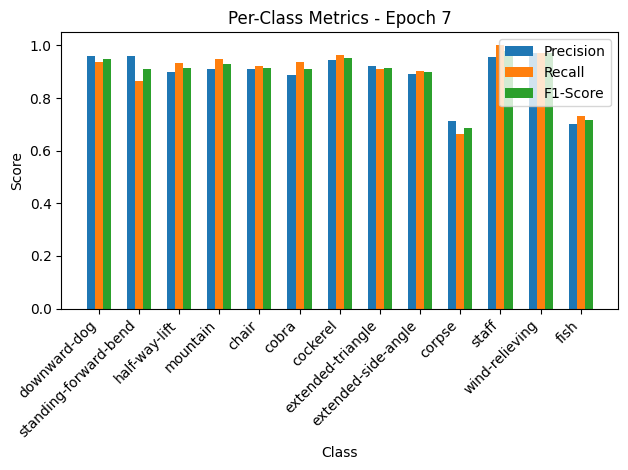

Validation: 100%|██████████| 10/10 [00:00<00:00, 20.82it/s, loss=0.294, accuracy=89.7]


Per-Class Metrics for Epoch 7:
downward-dog: Precision=0.96, Recall=0.94, F1-Score=0.95
standing-forward-bend: Precision=0.96, Recall=0.86, F1-Score=0.91
half-way-lift: Precision=0.90, Recall=0.93, F1-Score=0.92
mountain: Precision=0.91, Recall=0.95, F1-Score=0.93
chair: Precision=0.91, Recall=0.92, F1-Score=0.92
cobra: Precision=0.89, Recall=0.94, F1-Score=0.91
cockerel: Precision=0.94, Recall=0.97, F1-Score=0.95
extended-triangle: Precision=0.92, Recall=0.91, F1-Score=0.92
extended-side-angle: Precision=0.89, Recall=0.90, F1-Score=0.90
corpse: Precision=0.71, Recall=0.66, F1-Score=0.69
staff: Precision=0.96, Recall=1.00, F1-Score=0.98
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.70, Recall=0.73, F1-Score=0.72


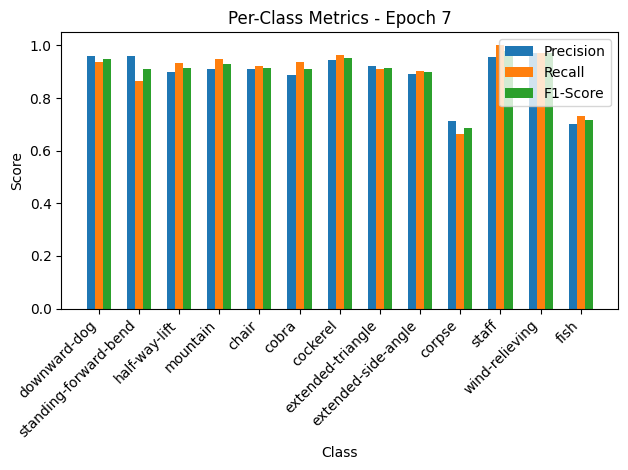


Epoch 8/50 Summary:
Train Loss: 0.3238 | Train Acc: 90.60% | Train Precision: 0.89 | Train Recall: 0.90 | Train F1: 0.90
Val Loss: 0.3222 | Val Acc: 89.73% | Val Precision: 0.91 | Val Recall: 0.91 | Val F1: 0.90

Epoch 9/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.79it/s, loss=0.296, accuracy=92]


Per-Class Metrics for Epoch 8:
downward-dog: Precision=0.96, Recall=0.93, F1-Score=0.95
standing-forward-bend: Precision=0.91, Recall=0.92, F1-Score=0.92
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=0.91, Recall=0.95, F1-Score=0.93
chair: Precision=0.99, Recall=0.91, F1-Score=0.95
cobra: Precision=0.94, Recall=0.97, F1-Score=0.95
cockerel: Precision=0.95, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=0.91, Recall=0.91, F1-Score=0.91
extended-side-angle: Precision=0.86, Recall=0.90, F1-Score=0.88
corpse: Precision=0.79, Recall=0.76, F1-Score=0.78
staff: Precision=0.94, Recall=0.99, F1-Score=0.96
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.75, Recall=0.78, F1-Score=0.76


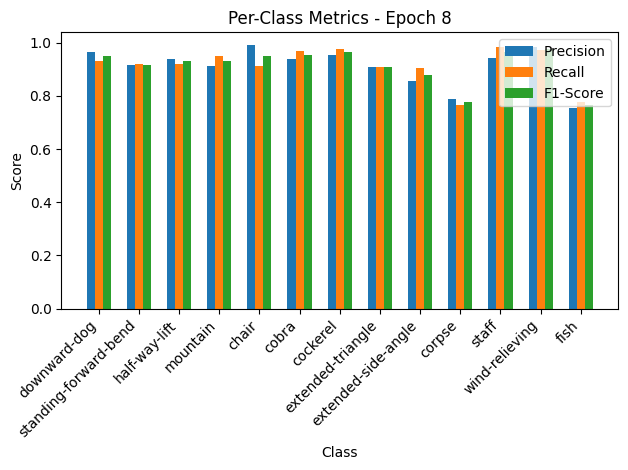

Validation: 100%|██████████| 10/10 [00:00<00:00, 21.11it/s, loss=0.273, accuracy=87.7]


Per-Class Metrics for Epoch 8:
downward-dog: Precision=0.96, Recall=0.93, F1-Score=0.95
standing-forward-bend: Precision=0.91, Recall=0.92, F1-Score=0.92
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=0.91, Recall=0.95, F1-Score=0.93
chair: Precision=0.99, Recall=0.91, F1-Score=0.95
cobra: Precision=0.94, Recall=0.97, F1-Score=0.95
cockerel: Precision=0.95, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=0.91, Recall=0.91, F1-Score=0.91
extended-side-angle: Precision=0.86, Recall=0.90, F1-Score=0.88
corpse: Precision=0.79, Recall=0.76, F1-Score=0.78
staff: Precision=0.94, Recall=0.99, F1-Score=0.96
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.75, Recall=0.78, F1-Score=0.76


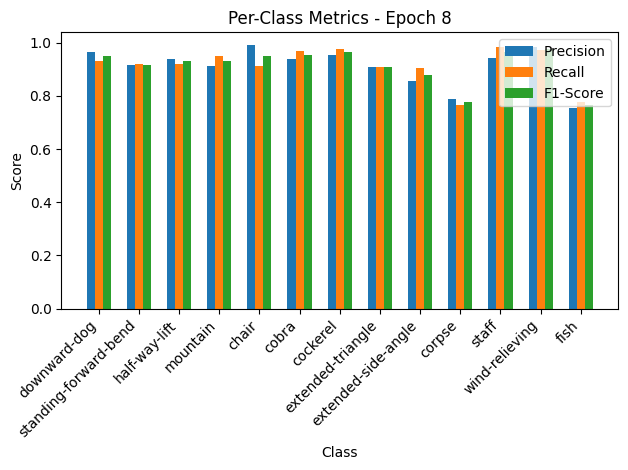


Epoch 9/50 Summary:
Train Loss: 0.2973 | Train Acc: 91.97% | Train Precision: 0.91 | Train Recall: 0.91 | Train F1: 0.91
Val Loss: 0.2990 | Val Acc: 87.67% | Val Precision: 0.90 | Val Recall: 0.86 | Val F1: 0.85

Epoch 10/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.33it/s, loss=0.256, accuracy=93]


Per-Class Metrics for Epoch 9:
downward-dog: Precision=0.97, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.93, Recall=0.87, F1-Score=0.90
half-way-lift: Precision=0.88, Recall=0.92, F1-Score=0.90
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.94, Recall=0.91, F1-Score=0.92
cobra: Precision=0.97, Recall=0.97, F1-Score=0.97
cockerel: Precision=0.93, Recall=0.97, F1-Score=0.95
extended-triangle: Precision=0.96, Recall=0.92, F1-Score=0.94
extended-side-angle: Precision=0.91, Recall=0.96, F1-Score=0.93
corpse: Precision=0.88, Recall=0.87, F1-Score=0.87
staff: Precision=0.94, Recall=1.00, F1-Score=0.97
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.86, Recall=0.84, F1-Score=0.85


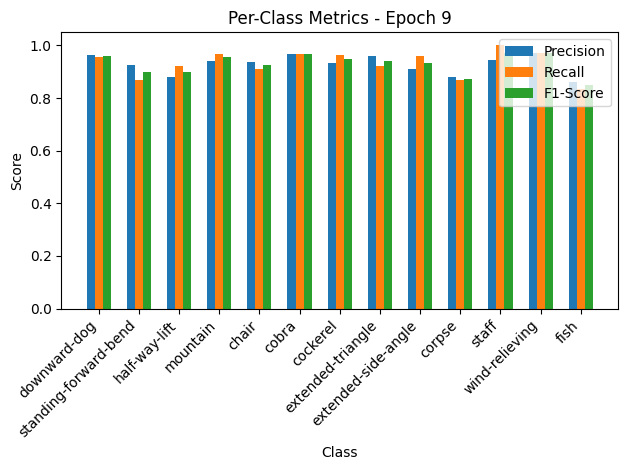

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.28it/s, loss=0.12, accuracy=95.9]


Per-Class Metrics for Epoch 9:
downward-dog: Precision=0.97, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.93, Recall=0.87, F1-Score=0.90
half-way-lift: Precision=0.88, Recall=0.92, F1-Score=0.90
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.94, Recall=0.91, F1-Score=0.92
cobra: Precision=0.97, Recall=0.97, F1-Score=0.97
cockerel: Precision=0.93, Recall=0.97, F1-Score=0.95
extended-triangle: Precision=0.96, Recall=0.92, F1-Score=0.94
extended-side-angle: Precision=0.91, Recall=0.96, F1-Score=0.93
corpse: Precision=0.88, Recall=0.87, F1-Score=0.87
staff: Precision=0.94, Recall=1.00, F1-Score=0.97
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.86, Recall=0.84, F1-Score=0.85


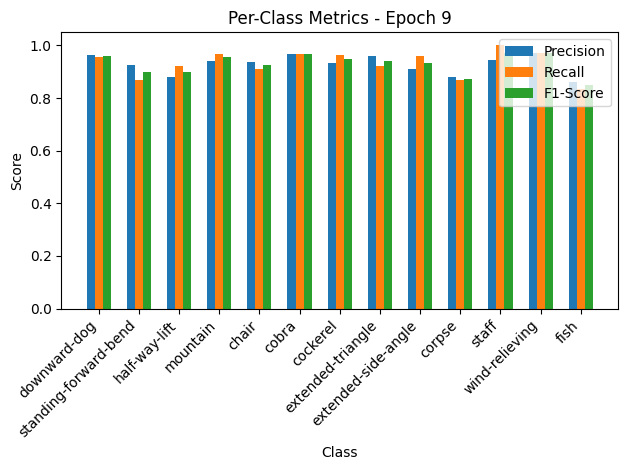


Epoch 10/50 Summary:
Train Loss: 0.2570 | Train Acc: 93.04% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.1317 | Val Acc: 95.89% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_2.pth
Checkpoint saved at epoch 10
New best model saved! Validation Loss: 0.1317

Epoch 11/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  6.91it/s, loss=0.301, accuracy=92]


Per-Class Metrics for Epoch 10:
downward-dog: Precision=0.97, Recall=0.91, F1-Score=0.94
standing-forward-bend: Precision=0.97, Recall=0.86, F1-Score=0.91
half-way-lift: Precision=0.88, Recall=0.96, F1-Score=0.92
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.96, Recall=0.93, F1-Score=0.94
cobra: Precision=0.94, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.92, Recall=0.97, F1-Score=0.94
extended-triangle: Precision=0.86, Recall=0.87, F1-Score=0.86
extended-side-angle: Precision=0.84, Recall=0.84, F1-Score=0.84
corpse: Precision=0.88, Recall=0.82, F1-Score=0.85
staff: Precision=0.93, Recall=0.97, F1-Score=0.95
wind-relieving: Precision=0.97, Recall=1.00, F1-Score=0.99
fish: Precision=0.84, Recall=0.87, F1-Score=0.85


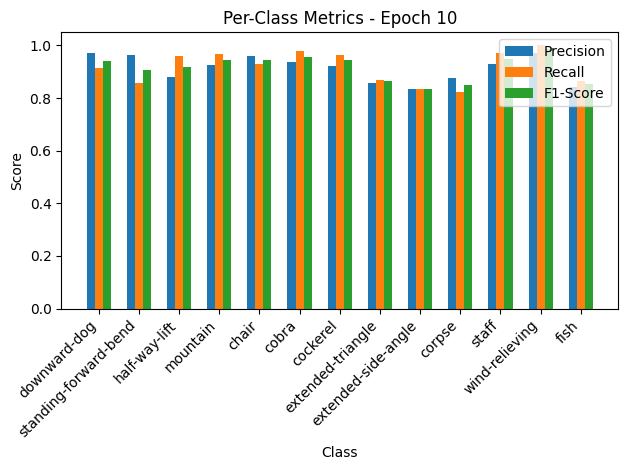

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.28it/s, loss=0.259, accuracy=92.5]


Per-Class Metrics for Epoch 10:
downward-dog: Precision=0.97, Recall=0.91, F1-Score=0.94
standing-forward-bend: Precision=0.97, Recall=0.86, F1-Score=0.91
half-way-lift: Precision=0.88, Recall=0.96, F1-Score=0.92
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.96, Recall=0.93, F1-Score=0.94
cobra: Precision=0.94, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.92, Recall=0.97, F1-Score=0.94
extended-triangle: Precision=0.86, Recall=0.87, F1-Score=0.86
extended-side-angle: Precision=0.84, Recall=0.84, F1-Score=0.84
corpse: Precision=0.88, Recall=0.82, F1-Score=0.85
staff: Precision=0.93, Recall=0.97, F1-Score=0.95
wind-relieving: Precision=0.97, Recall=1.00, F1-Score=0.99
fish: Precision=0.84, Recall=0.87, F1-Score=0.85


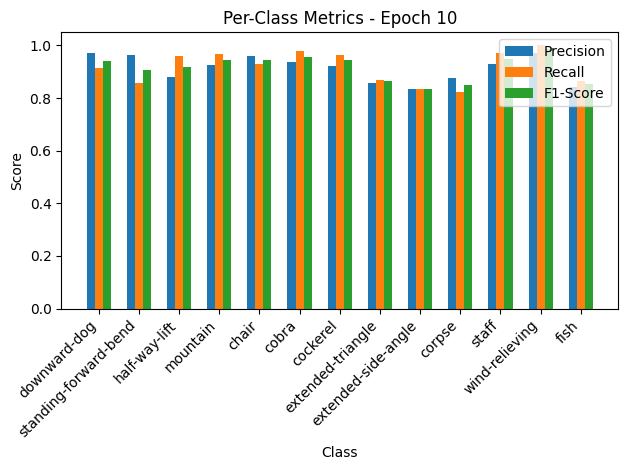


Epoch 11/50 Summary:
Train Loss: 0.3018 | Train Acc: 91.97% | Train Precision: 0.91 | Train Recall: 0.92 | Train F1: 0.92
Val Loss: 0.2840 | Val Acc: 92.47% | Val Precision: 0.95 | Val Recall: 0.94 | Val F1: 0.94

Epoch 12/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.29it/s, loss=0.268, accuracy=93.5]


Per-Class Metrics for Epoch 11:
downward-dog: Precision=0.99, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.98, Recall=0.86, F1-Score=0.92
half-way-lift: Precision=0.92, Recall=0.97, F1-Score=0.95
mountain: Precision=0.91, Recall=0.98, F1-Score=0.94
chair: Precision=0.96, Recall=0.93, F1-Score=0.94
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.93, Recall=0.90, F1-Score=0.91
extended-side-angle: Precision=0.90, Recall=0.95, F1-Score=0.92
corpse: Precision=0.76, Recall=0.84, F1-Score=0.80
staff: Precision=0.97, Recall=0.97, F1-Score=0.97
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.82, Recall=0.75, F1-Score=0.78


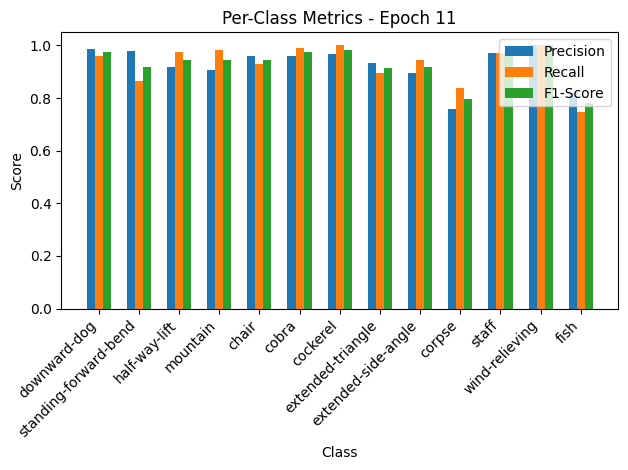

Validation: 100%|██████████| 10/10 [00:00<00:00, 26.30it/s, loss=0.337, accuracy=85.6]


Per-Class Metrics for Epoch 11:
downward-dog: Precision=0.99, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.98, Recall=0.86, F1-Score=0.92
half-way-lift: Precision=0.92, Recall=0.97, F1-Score=0.95
mountain: Precision=0.91, Recall=0.98, F1-Score=0.94
chair: Precision=0.96, Recall=0.93, F1-Score=0.94
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.93, Recall=0.90, F1-Score=0.91
extended-side-angle: Precision=0.90, Recall=0.95, F1-Score=0.92
corpse: Precision=0.76, Recall=0.84, F1-Score=0.80
staff: Precision=0.97, Recall=0.97, F1-Score=0.97
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.82, Recall=0.75, F1-Score=0.78


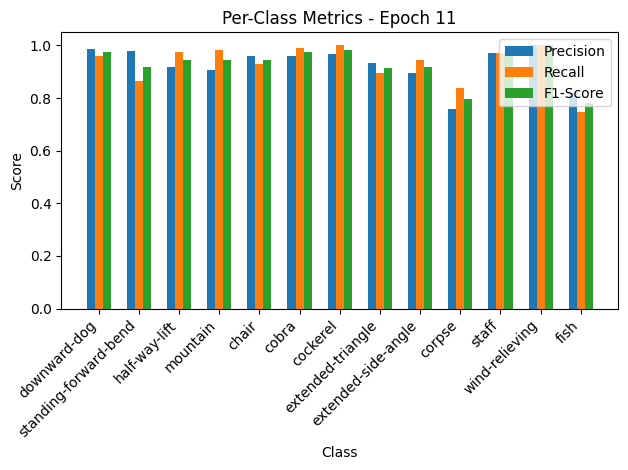


Epoch 12/50 Summary:
Train Loss: 0.2691 | Train Acc: 93.50% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.3698 | Val Acc: 85.62% | Val Precision: 0.89 | Val Recall: 0.89 | Val F1: 0.87

Epoch 13/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  6.93it/s, loss=0.22, accuracy=94.8]


Per-Class Metrics for Epoch 12:
downward-dog: Precision=0.97, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.88, F1-Score=0.91
half-way-lift: Precision=0.90, Recall=0.92, F1-Score=0.91
mountain: Precision=0.91, Recall=0.97, F1-Score=0.94
chair: Precision=0.98, Recall=0.92, F1-Score=0.95
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.98, Recall=0.98, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.94, F1-Score=0.96
extended-side-angle: Precision=0.91, Recall=0.99, F1-Score=0.95
corpse: Precision=0.95, Recall=0.91, F1-Score=0.93
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.93, Recall=0.96, F1-Score=0.94


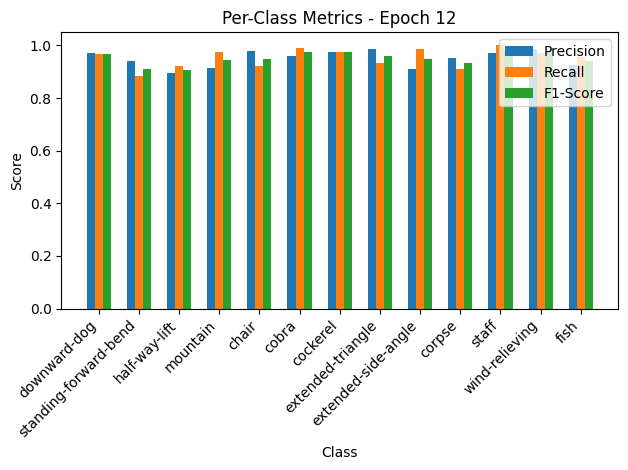

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.92it/s, loss=0.147, accuracy=94.5]


Per-Class Metrics for Epoch 12:
downward-dog: Precision=0.97, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.88, F1-Score=0.91
half-way-lift: Precision=0.90, Recall=0.92, F1-Score=0.91
mountain: Precision=0.91, Recall=0.97, F1-Score=0.94
chair: Precision=0.98, Recall=0.92, F1-Score=0.95
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.98, Recall=0.98, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.94, F1-Score=0.96
extended-side-angle: Precision=0.91, Recall=0.99, F1-Score=0.95
corpse: Precision=0.95, Recall=0.91, F1-Score=0.93
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.93, Recall=0.96, F1-Score=0.94


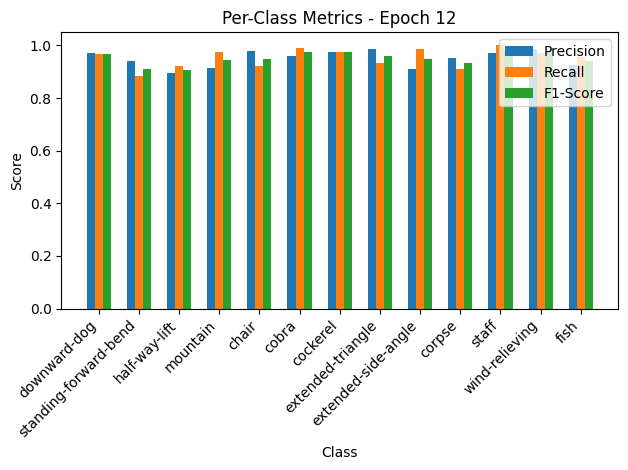


Epoch 13/50 Summary:
Train Loss: 0.2206 | Train Acc: 94.80% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.1609 | Val Acc: 94.52% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 14/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.18it/s, loss=0.253, accuracy=93.9]


Per-Class Metrics for Epoch 13:
downward-dog: Precision=0.97, Recall=0.96, F1-Score=0.96
standing-forward-bend: Precision=0.97, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.92, Recall=0.94, F1-Score=0.93
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.95, Recall=0.91, F1-Score=0.93
cobra: Precision=0.95, Recall=0.97, F1-Score=0.96
cockerel: Precision=0.92, Recall=1.00, F1-Score=0.96
extended-triangle: Precision=0.96, Recall=0.95, F1-Score=0.95
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=0.84, Recall=0.84, F1-Score=0.84
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.94, Recall=0.99, F1-Score=0.96
fish: Precision=0.86, Recall=0.82, F1-Score=0.84


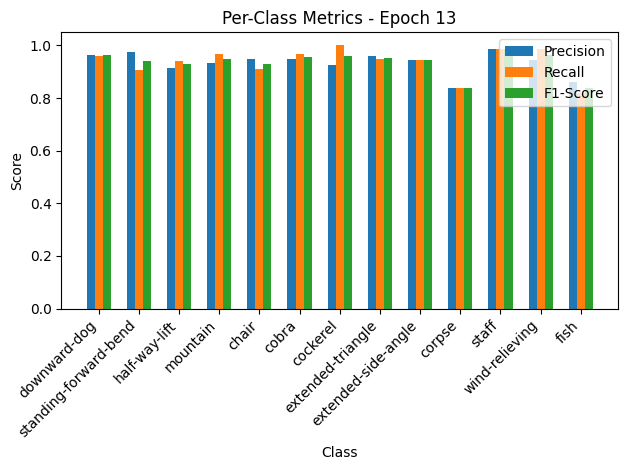

Validation: 100%|██████████| 10/10 [00:00<00:00, 28.34it/s, loss=0.22, accuracy=94.5]


Per-Class Metrics for Epoch 13:
downward-dog: Precision=0.97, Recall=0.96, F1-Score=0.96
standing-forward-bend: Precision=0.97, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.92, Recall=0.94, F1-Score=0.93
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.95, Recall=0.91, F1-Score=0.93
cobra: Precision=0.95, Recall=0.97, F1-Score=0.96
cockerel: Precision=0.92, Recall=1.00, F1-Score=0.96
extended-triangle: Precision=0.96, Recall=0.95, F1-Score=0.95
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=0.84, Recall=0.84, F1-Score=0.84
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.94, Recall=0.99, F1-Score=0.96
fish: Precision=0.86, Recall=0.82, F1-Score=0.84


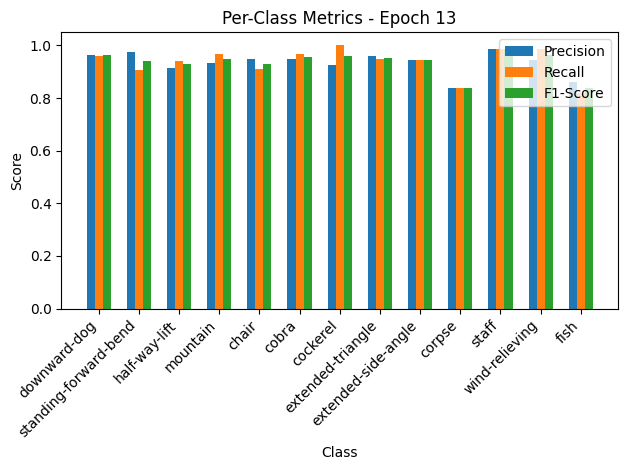


Epoch 14/50 Summary:
Train Loss: 0.2537 | Train Acc: 93.88% | Train Precision: 0.93 | Train Recall: 0.94 | Train F1: 0.93
Val Loss: 0.2410 | Val Acc: 94.52% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 15/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.52it/s, loss=0.248, accuracy=93.4]


Per-Class Metrics for Epoch 14:
downward-dog: Precision=0.97, Recall=0.94, F1-Score=0.95
standing-forward-bend: Precision=0.95, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.91, Recall=0.95, F1-Score=0.93
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.98, Recall=0.93, F1-Score=0.95
cobra: Precision=0.94, Recall=0.96, F1-Score=0.95
cockerel: Precision=0.92, Recall=0.94, F1-Score=0.93
extended-triangle: Precision=0.92, Recall=0.90, F1-Score=0.91
extended-side-angle: Precision=0.88, Recall=0.89, F1-Score=0.88
corpse: Precision=0.90, Recall=0.90, F1-Score=0.90
staff: Precision=0.93, Recall=0.97, F1-Score=0.95
wind-relieving: Precision=0.94, Recall=1.00, F1-Score=0.97
fish: Precision=0.91, Recall=0.90, F1-Score=0.90


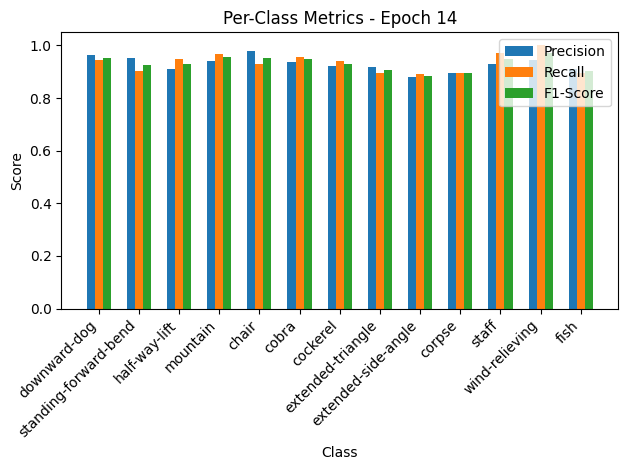

Validation: 100%|██████████| 10/10 [00:00<00:00, 22.62it/s, loss=0.268, accuracy=91.1]


Per-Class Metrics for Epoch 14:
downward-dog: Precision=0.97, Recall=0.94, F1-Score=0.95
standing-forward-bend: Precision=0.95, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.91, Recall=0.95, F1-Score=0.93
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.98, Recall=0.93, F1-Score=0.95
cobra: Precision=0.94, Recall=0.96, F1-Score=0.95
cockerel: Precision=0.92, Recall=0.94, F1-Score=0.93
extended-triangle: Precision=0.92, Recall=0.90, F1-Score=0.91
extended-side-angle: Precision=0.88, Recall=0.89, F1-Score=0.88
corpse: Precision=0.90, Recall=0.90, F1-Score=0.90
staff: Precision=0.93, Recall=0.97, F1-Score=0.95
wind-relieving: Precision=0.94, Recall=1.00, F1-Score=0.97
fish: Precision=0.91, Recall=0.90, F1-Score=0.90


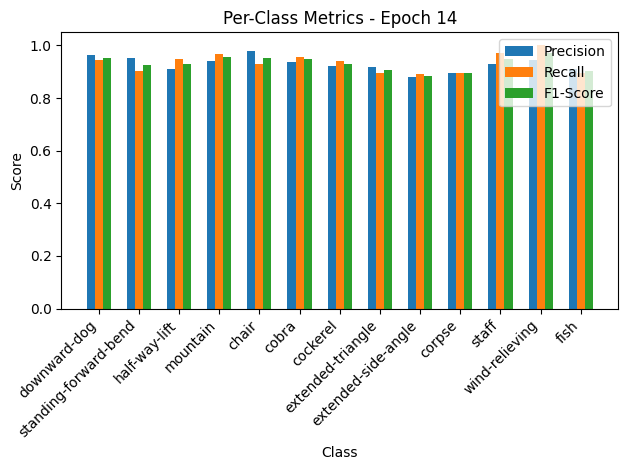


Epoch 15/50 Summary:
Train Loss: 0.2490 | Train Acc: 93.43% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.2934 | Val Acc: 91.10% | Val Precision: 0.94 | Val Recall: 0.92 | Val F1: 0.91

Epoch 16/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.48it/s, loss=0.199, accuracy=95.3]


Per-Class Metrics for Epoch 15:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.94, Recall=0.90, F1-Score=0.91
half-way-lift: Precision=0.91, Recall=0.94, F1-Score=0.93
mountain: Precision=0.94, Recall=0.99, F1-Score=0.97
chair: Precision=0.96, Recall=0.93, F1-Score=0.94
cobra: Precision=0.95, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.97, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=0.96, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.97, Recall=0.96, F1-Score=0.97
corpse: Precision=0.89, Recall=0.97, F1-Score=0.93
staff: Precision=0.96, Recall=0.99, F1-Score=0.97
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.97, Recall=0.85, F1-Score=0.90


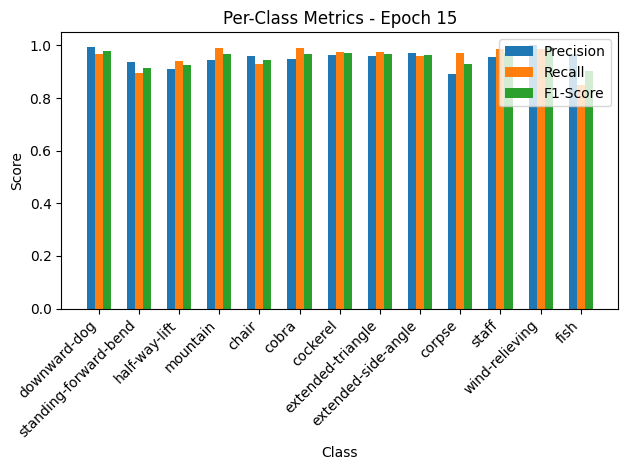

Validation: 100%|██████████| 10/10 [00:00<00:00, 22.88it/s, loss=0.143, accuracy=94.5]


Per-Class Metrics for Epoch 15:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.94, Recall=0.90, F1-Score=0.91
half-way-lift: Precision=0.91, Recall=0.94, F1-Score=0.93
mountain: Precision=0.94, Recall=0.99, F1-Score=0.97
chair: Precision=0.96, Recall=0.93, F1-Score=0.94
cobra: Precision=0.95, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.97, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=0.96, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.97, Recall=0.96, F1-Score=0.97
corpse: Precision=0.89, Recall=0.97, F1-Score=0.93
staff: Precision=0.96, Recall=0.99, F1-Score=0.97
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.97, Recall=0.85, F1-Score=0.90


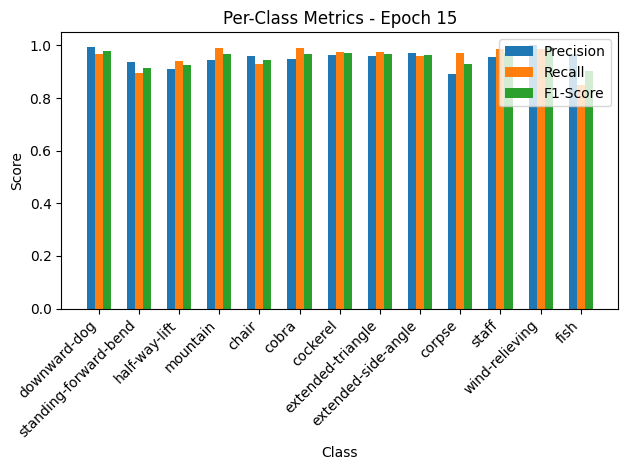


Epoch 16/50 Summary:
Train Loss: 0.1999 | Train Acc: 95.26% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.1571 | Val Acc: 94.52% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 17/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.33it/s, loss=0.163, accuracy=95.7]


Per-Class Metrics for Epoch 16:
downward-dog: Precision=0.99, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.91, Recall=0.97, F1-Score=0.94
mountain: Precision=0.94, Recall=0.99, F1-Score=0.96
chair: Precision=0.97, Recall=0.94, F1-Score=0.95
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=1.00, Recall=0.98, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.92, F1-Score=0.95
extended-side-angle: Precision=0.92, Recall=0.99, F1-Score=0.95
corpse: Precision=0.93, Recall=0.94, F1-Score=0.93
staff: Precision=0.93, Recall=1.00, F1-Score=0.96
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.92, Recall=0.91, F1-Score=0.92


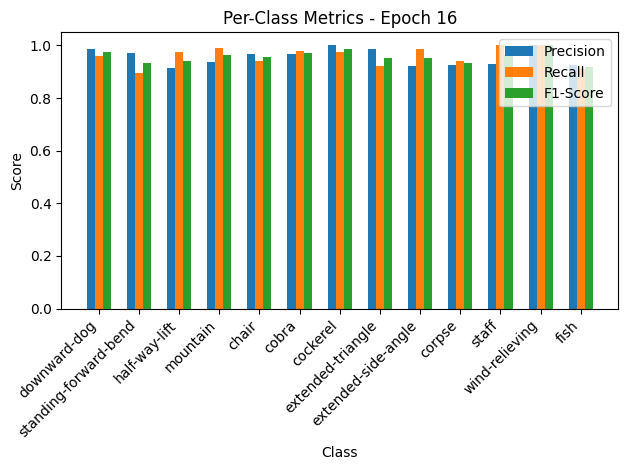

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.45it/s, loss=0.0922, accuracy=95.9]


Per-Class Metrics for Epoch 16:
downward-dog: Precision=0.99, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.91, Recall=0.97, F1-Score=0.94
mountain: Precision=0.94, Recall=0.99, F1-Score=0.96
chair: Precision=0.97, Recall=0.94, F1-Score=0.95
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=1.00, Recall=0.98, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.92, F1-Score=0.95
extended-side-angle: Precision=0.92, Recall=0.99, F1-Score=0.95
corpse: Precision=0.93, Recall=0.94, F1-Score=0.93
staff: Precision=0.93, Recall=1.00, F1-Score=0.96
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.92, Recall=0.91, F1-Score=0.92


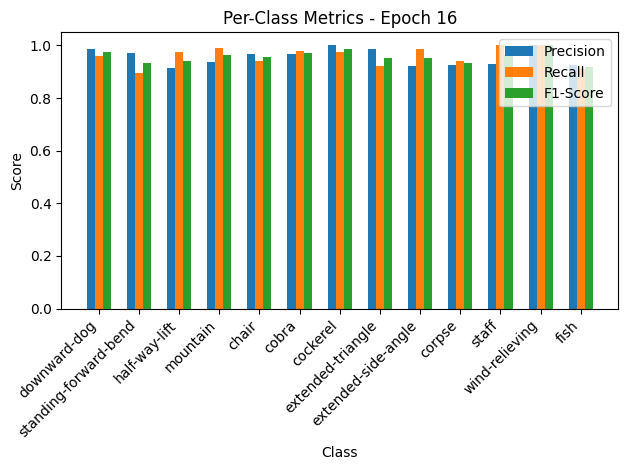


Epoch 17/50 Summary:
Train Loss: 0.1630 | Train Acc: 95.72% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.1010 | Val Acc: 95.89% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_2.pth
Checkpoint saved at epoch 17
New best model saved! Validation Loss: 0.1010

Epoch 18/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.12it/s, loss=0.116, accuracy=97.6]


Per-Class Metrics for Epoch 17:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.97, Recall=0.97, F1-Score=0.97
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.98, Recall=0.95, F1-Score=0.96
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.94, Recall=0.99, F1-Score=0.96
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.96, F1-Score=0.97


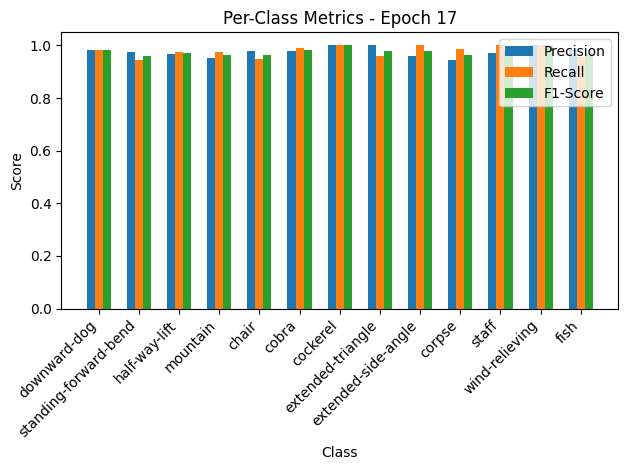

Validation: 100%|██████████| 10/10 [00:00<00:00, 26.49it/s, loss=0.0741, accuracy=96.6]


Per-Class Metrics for Epoch 17:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.97, Recall=0.97, F1-Score=0.97
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.98, Recall=0.95, F1-Score=0.96
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.94, Recall=0.99, F1-Score=0.96
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.96, F1-Score=0.97


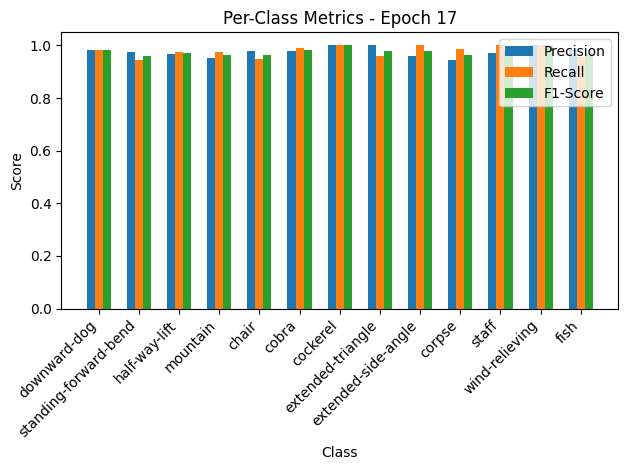


Epoch 18/50 Summary:
Train Loss: 0.1161 | Train Acc: 97.55% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.0813 | Val Acc: 96.58% | Val Precision: 0.98 | Val Recall: 0.97 | Val F1: 0.97
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_2.pth
Checkpoint saved at epoch 18
New best model saved! Validation Loss: 0.0813

Epoch 19/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.17it/s, loss=0.113, accuracy=97.4]


Per-Class Metrics for Epoch 18:
downward-dog: Precision=0.99, Recall=0.96, F1-Score=0.98
standing-forward-bend: Precision=0.98, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.96, Recall=0.98, F1-Score=0.97
chair: Precision=0.98, Recall=0.95, F1-Score=0.96
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.97, Recall=0.94, F1-Score=0.95
extended-side-angle: Precision=0.93, Recall=0.97, F1-Score=0.95
corpse: Precision=0.96, Recall=1.00, F1-Score=0.98
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.96, F1-Score=0.98


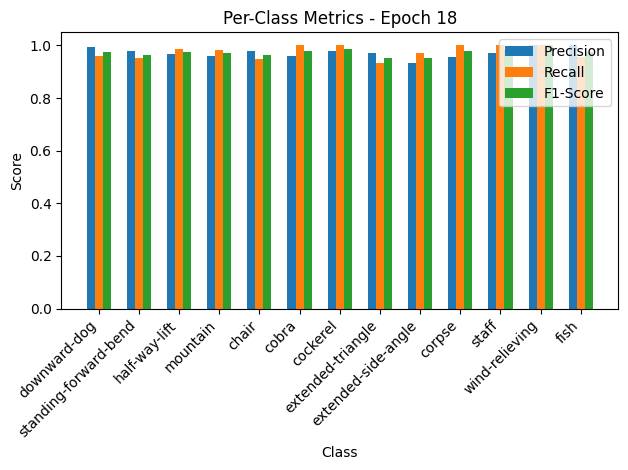

Validation: 100%|██████████| 10/10 [00:00<00:00, 28.53it/s, loss=0.0863, accuracy=95.2]


Per-Class Metrics for Epoch 18:
downward-dog: Precision=0.99, Recall=0.96, F1-Score=0.98
standing-forward-bend: Precision=0.98, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.96, Recall=0.98, F1-Score=0.97
chair: Precision=0.98, Recall=0.95, F1-Score=0.96
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.97, Recall=0.94, F1-Score=0.95
extended-side-angle: Precision=0.93, Recall=0.97, F1-Score=0.95
corpse: Precision=0.96, Recall=1.00, F1-Score=0.98
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.96, F1-Score=0.98


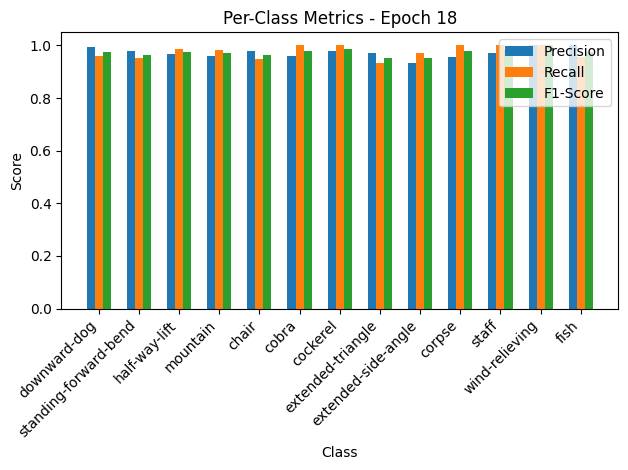


Epoch 19/50 Summary:
Train Loss: 0.1131 | Train Acc: 97.40% | Train Precision: 0.97 | Train Recall: 0.98 | Train F1: 0.97
Val Loss: 0.0946 | Val Acc: 95.21% | Val Precision: 0.97 | Val Recall: 0.96 | Val F1: 0.96

Epoch 20/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.38it/s, loss=0.105, accuracy=97.7]


Per-Class Metrics for Epoch 19:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.97, F1-Score=0.97
mountain: Precision=0.95, Recall=0.98, F1-Score=0.97
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.96, Recall=0.97, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.96, F1-Score=0.96


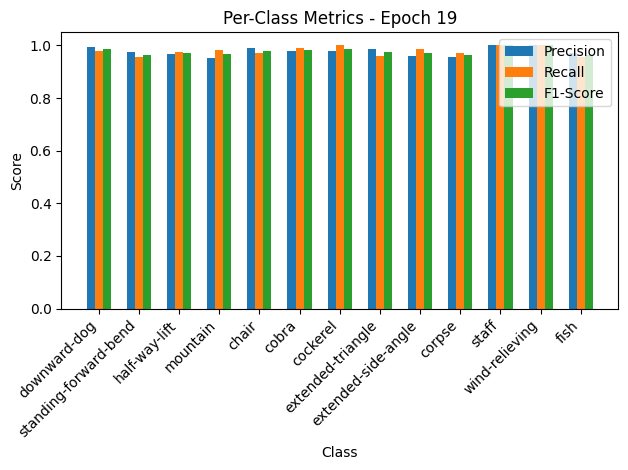

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.16it/s, loss=0.0794, accuracy=97.3]


Per-Class Metrics for Epoch 19:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.97, F1-Score=0.97
mountain: Precision=0.95, Recall=0.98, F1-Score=0.97
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.96, Recall=0.97, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.96, F1-Score=0.96


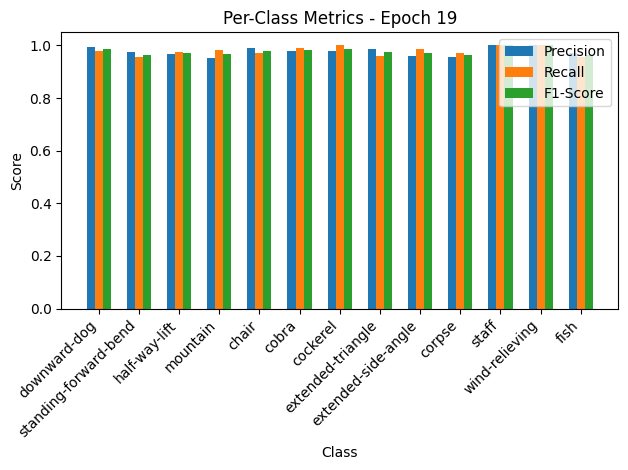


Epoch 20/50 Summary:
Train Loss: 0.1058 | Train Acc: 97.71% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.0870 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 21/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.55it/s, loss=0.0907, accuracy=98.3]


Per-Class Metrics for Epoch 20:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.96, Recall=0.97, F1-Score=0.96
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.97, Recall=0.96, F1-Score=0.96


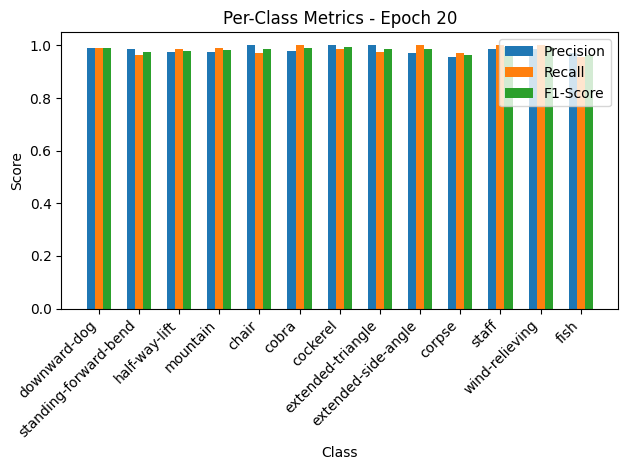

Validation: 100%|██████████| 10/10 [00:00<00:00, 21.80it/s, loss=0.0814, accuracy=95.9]


Per-Class Metrics for Epoch 20:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.96, Recall=0.97, F1-Score=0.96
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.97, Recall=0.96, F1-Score=0.96


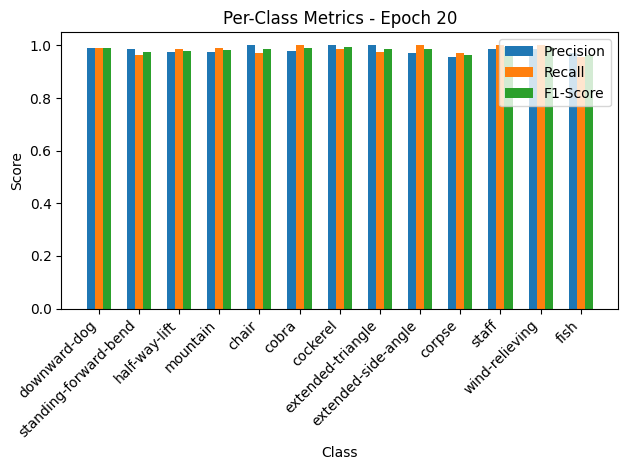


Epoch 21/50 Summary:
Train Loss: 0.0910 | Train Acc: 98.32% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.0892 | Val Acc: 95.89% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 22/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.51it/s, loss=0.0836, accuracy=98.4]


Per-Class Metrics for Epoch 21:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.98, F1-Score=0.97
mountain: Precision=0.97, Recall=0.98, F1-Score=0.97
chair: Precision=0.99, Recall=0.95, F1-Score=0.97
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.97, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.97, F1-Score=0.98


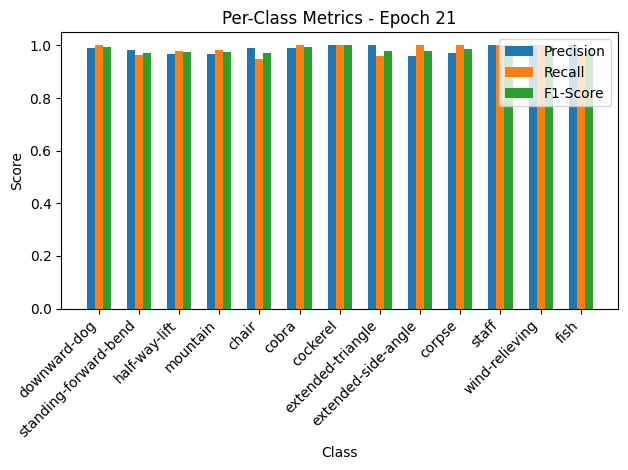

Validation: 100%|██████████| 10/10 [00:00<00:00, 22.18it/s, loss=0.063, accuracy=98.6]


Per-Class Metrics for Epoch 21:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.98, F1-Score=0.97
mountain: Precision=0.97, Recall=0.98, F1-Score=0.97
chair: Precision=0.99, Recall=0.95, F1-Score=0.97
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.97, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.97, F1-Score=0.98


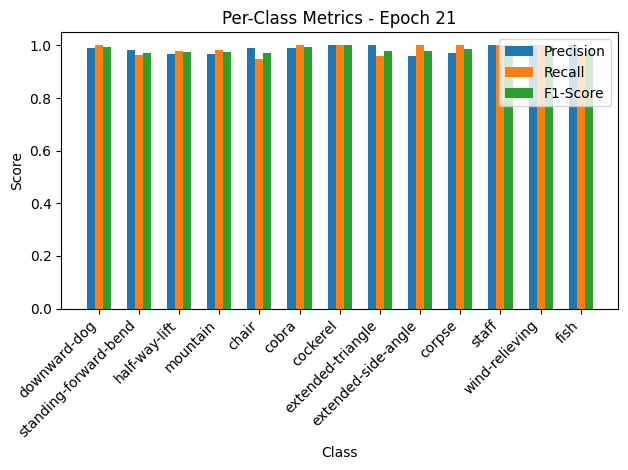


Epoch 22/50 Summary:
Train Loss: 0.0838 | Train Acc: 98.39% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0690 | Val Acc: 98.63% | Val Precision: 0.99 | Val Recall: 0.99 | Val F1: 0.99
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_2.pth
Checkpoint saved at epoch 22
New best model saved! Validation Loss: 0.0690

Epoch 23/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.24it/s, loss=0.0818, accuracy=98.3]


Per-Class Metrics for Epoch 22:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.97, F1-Score=0.97
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.96, Recall=0.99, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.96, F1-Score=0.97


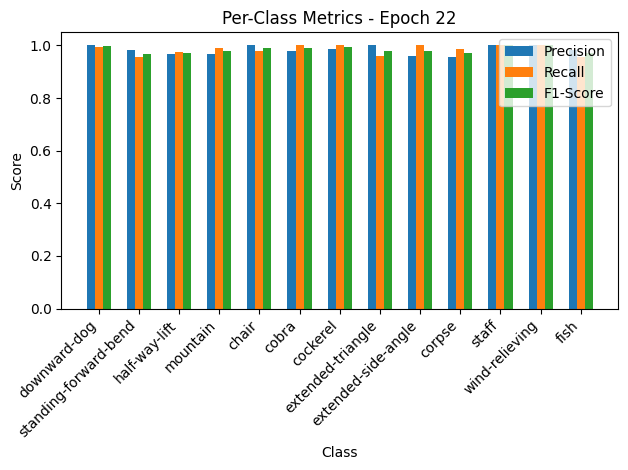

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.55it/s, loss=0.0662, accuracy=97.9]


Per-Class Metrics for Epoch 22:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.97, F1-Score=0.97
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.96, Recall=0.99, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.96, F1-Score=0.97


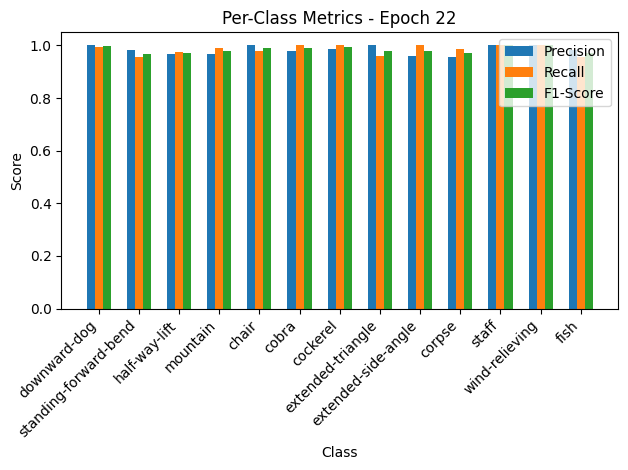


Epoch 23/50 Summary:
Train Loss: 0.0821 | Train Acc: 98.32% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.0725 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 24/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.03it/s, loss=0.089, accuracy=98.5]


Per-Class Metrics for Epoch 23:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.99
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.97, Recall=0.97, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.97, F1-Score=0.98


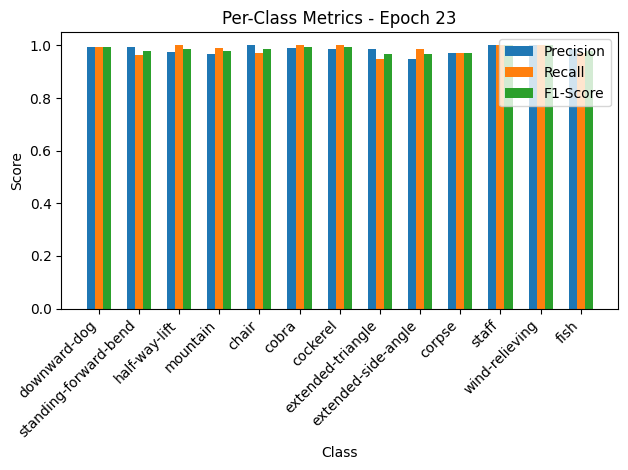

Validation: 100%|██████████| 10/10 [00:00<00:00, 28.50it/s, loss=0.0648, accuracy=97.9]


Per-Class Metrics for Epoch 23:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.99
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.97, Recall=0.97, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.97, F1-Score=0.98


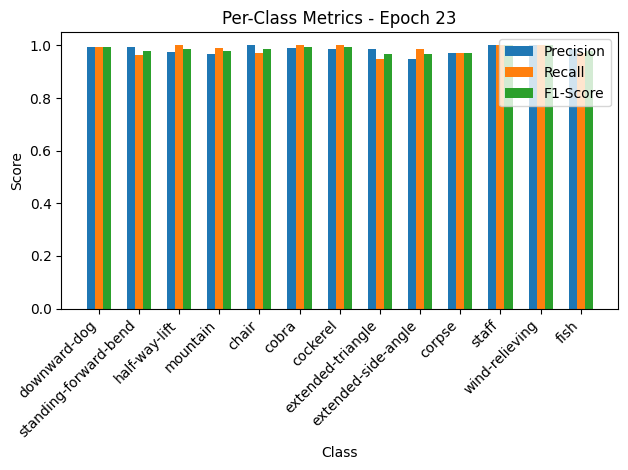


Epoch 24/50 Summary:
Train Loss: 0.0892 | Train Acc: 98.47% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.0711 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 25/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:12<00:00,  6.74it/s, loss=0.0815, accuracy=98.5]


Per-Class Metrics for Epoch 24:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.96, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=0.98, F1-Score=0.97
chair: Precision=0.99, Recall=0.96, F1-Score=0.97
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.99, F1-Score=0.98
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.97, F1-Score=0.98


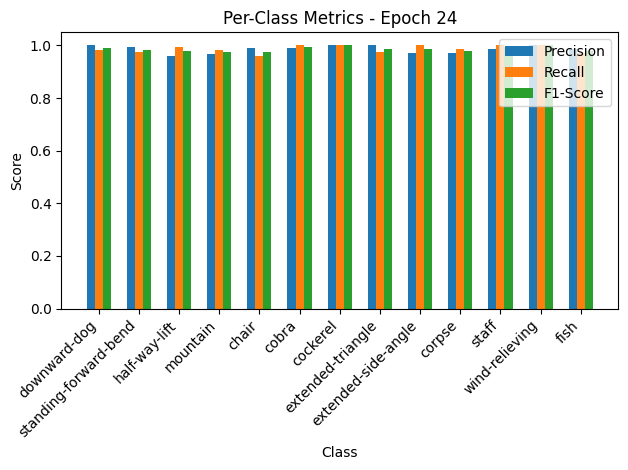

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.47it/s, loss=0.0749, accuracy=97.3]


Per-Class Metrics for Epoch 24:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.96, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=0.98, F1-Score=0.97
chair: Precision=0.99, Recall=0.96, F1-Score=0.97
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.99, F1-Score=0.98
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.97, F1-Score=0.98


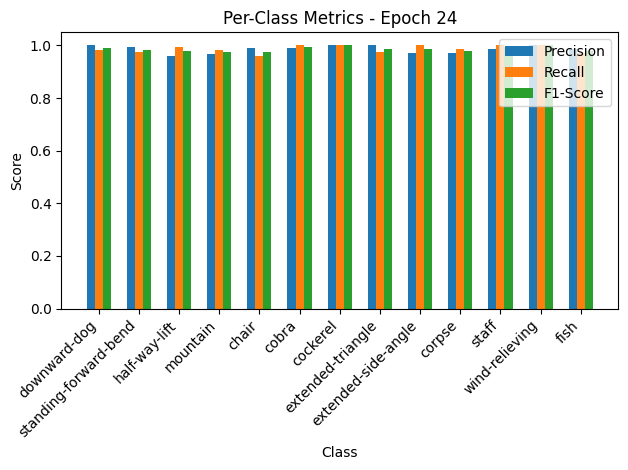


Epoch 25/50 Summary:
Train Loss: 0.0817 | Train Acc: 98.55% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0821 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 26/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.58it/s, loss=0.0773, accuracy=98.3]


Per-Class Metrics for Epoch 25:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.96, Recall=0.99, F1-Score=0.97
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.99, Recall=0.99, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.99, Recall=0.99, F1-Score=0.99


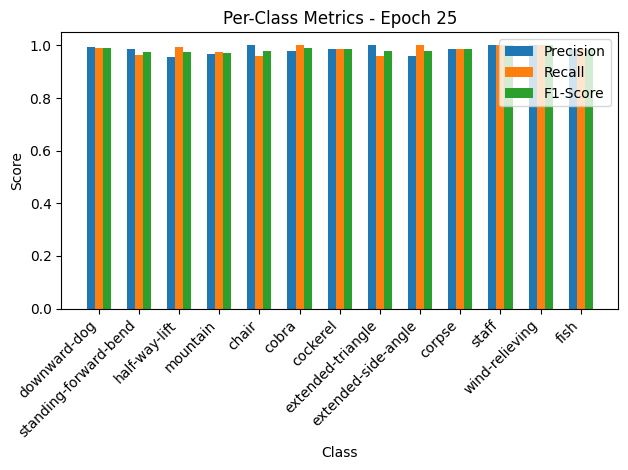

Validation: 100%|██████████| 10/10 [00:00<00:00, 28.49it/s, loss=0.0665, accuracy=97.9]


Per-Class Metrics for Epoch 25:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.96, Recall=0.99, F1-Score=0.97
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.99, Recall=0.99, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.99, Recall=0.99, F1-Score=0.99


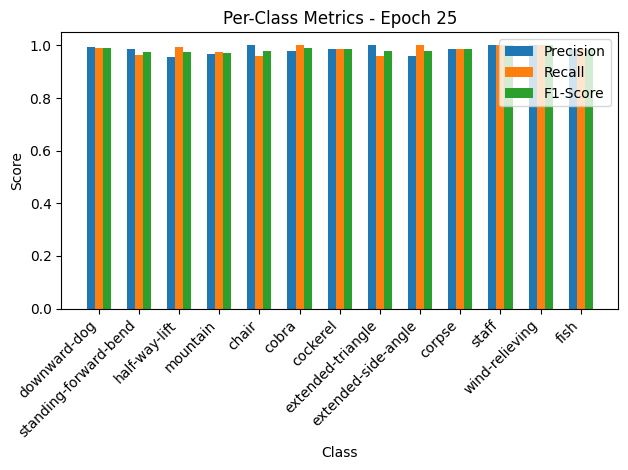


Epoch 26/50 Summary:
Train Loss: 0.0776 | Train Acc: 98.32% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.0728 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 27/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.65it/s, loss=0.0695, accuracy=98.6]


Per-Class Metrics for Epoch 26:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.98, Recall=1.00, F1-Score=0.99
mountain: Precision=0.95, Recall=0.98, F1-Score=0.97
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.96, Recall=1.00, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.96, F1-Score=0.98


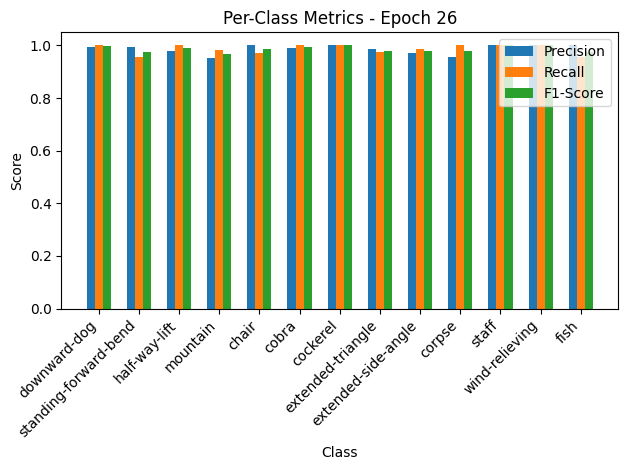

Validation: 100%|██████████| 10/10 [00:00<00:00, 23.46it/s, loss=0.0602, accuracy=97.9]


Per-Class Metrics for Epoch 26:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.98, Recall=1.00, F1-Score=0.99
mountain: Precision=0.95, Recall=0.98, F1-Score=0.97
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.96, Recall=1.00, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.96, F1-Score=0.98


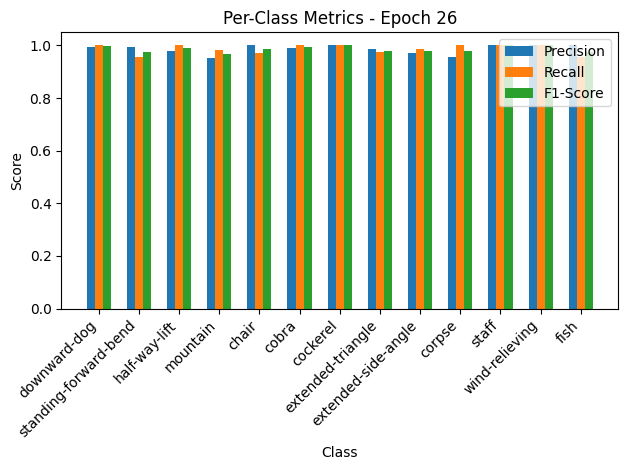


Epoch 27/50 Summary:
Train Loss: 0.0697 | Train Acc: 98.62% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0660 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_2.pth
Checkpoint saved at epoch 27
New best model saved! Validation Loss: 0.0660

Epoch 28/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.68it/s, loss=0.0681, accuracy=98.7]


Per-Class Metrics for Epoch 27:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.99, Recall=0.98, F1-Score=0.98
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.96, Recall=1.00, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.96, F1-Score=0.98


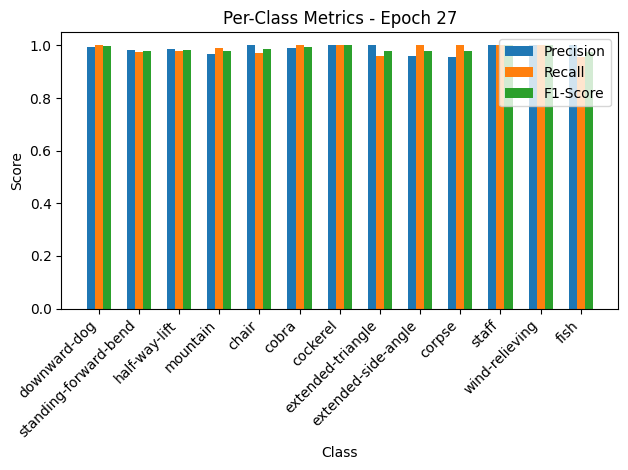

Validation: 100%|██████████| 10/10 [00:00<00:00, 21.87it/s, loss=0.0748, accuracy=97.9]


Per-Class Metrics for Epoch 27:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.99, Recall=0.98, F1-Score=0.98
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.96, Recall=1.00, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.96, F1-Score=0.98


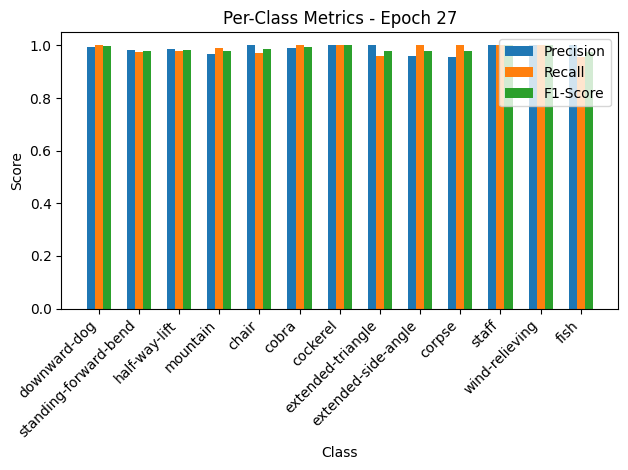


Epoch 28/50 Summary:
Train Loss: 0.0683 | Train Acc: 98.70% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0819 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 29/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.27it/s, loss=0.0703, accuracy=98.7]


Per-Class Metrics for Epoch 28:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=0.99, F1-Score=0.99
mountain: Precision=0.97, Recall=1.00, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=0.99, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.97, Recall=0.99, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.97, F1-Score=0.98


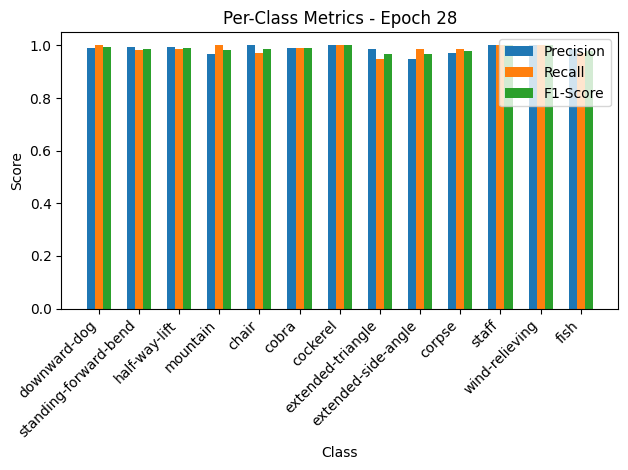

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.89it/s, loss=0.0619, accuracy=97.9]


Per-Class Metrics for Epoch 28:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=0.99, F1-Score=0.99
mountain: Precision=0.97, Recall=1.00, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=0.99, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.97, Recall=0.99, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.97, F1-Score=0.98


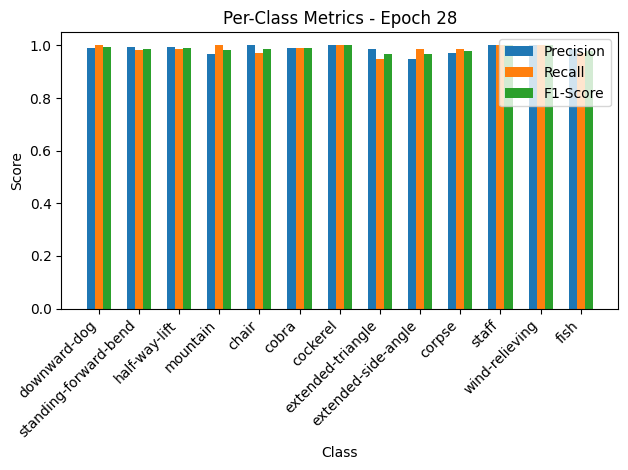


Epoch 29/50 Summary:
Train Loss: 0.0705 | Train Acc: 98.70% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0678 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 30/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:12<00:00,  6.81it/s, loss=0.07, accuracy=98.8]


Per-Class Metrics for Epoch 29:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=1.00, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.97, F1-Score=0.98


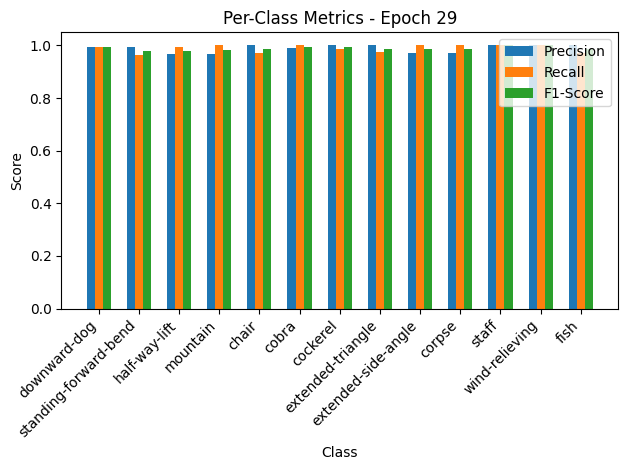

Validation: 100%|██████████| 10/10 [00:00<00:00, 28.08it/s, loss=0.0683, accuracy=97.9]


Per-Class Metrics for Epoch 29:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=1.00, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.97, F1-Score=0.98


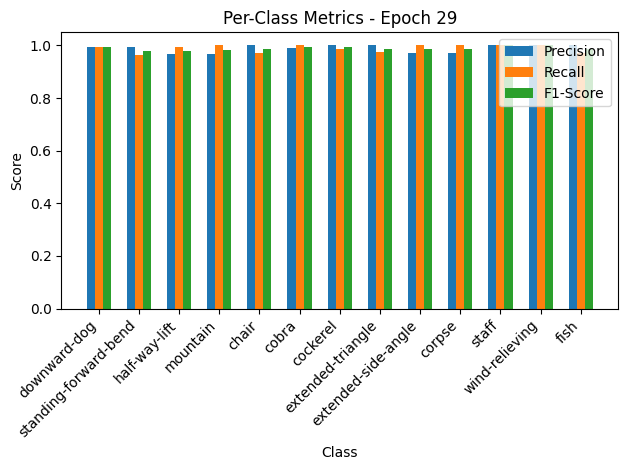


Epoch 30/50 Summary:
Train Loss: 0.0702 | Train Acc: 98.78% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0748 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 31/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  6.97it/s, loss=0.0737, accuracy=98.5]


Per-Class Metrics for Epoch 30:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.98, F1-Score=0.98
mountain: Precision=0.98, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.98, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=1.00, Recall=0.99, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.99, Recall=1.00, F1-Score=0.99


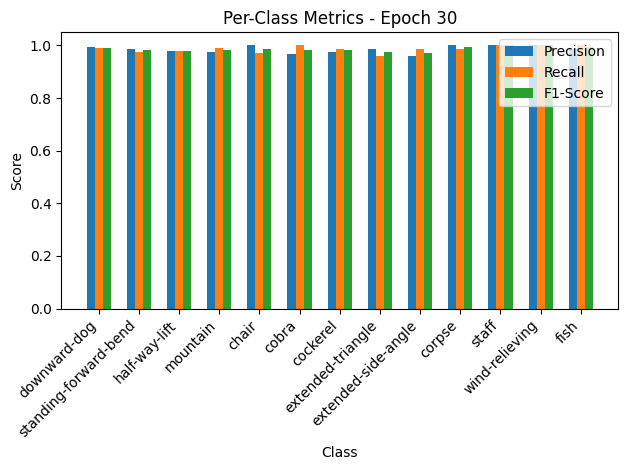

Validation: 100%|██████████| 10/10 [00:00<00:00, 25.78it/s, loss=0.0837, accuracy=97.3]


Per-Class Metrics for Epoch 30:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.98, F1-Score=0.98
mountain: Precision=0.98, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.98, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=1.00, Recall=0.99, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.99, Recall=1.00, F1-Score=0.99


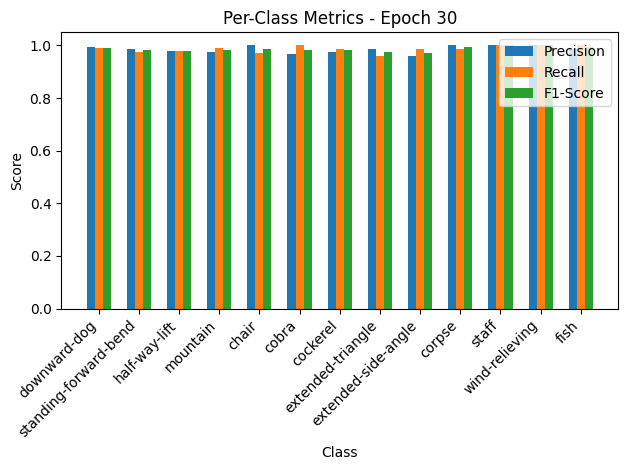


Epoch 31/50 Summary:
Train Loss: 0.0740 | Train Acc: 98.55% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0917 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 32/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.01it/s, loss=0.0768, accuracy=98.2]


Per-Class Metrics for Epoch 31:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.99
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.94, F1-Score=0.94


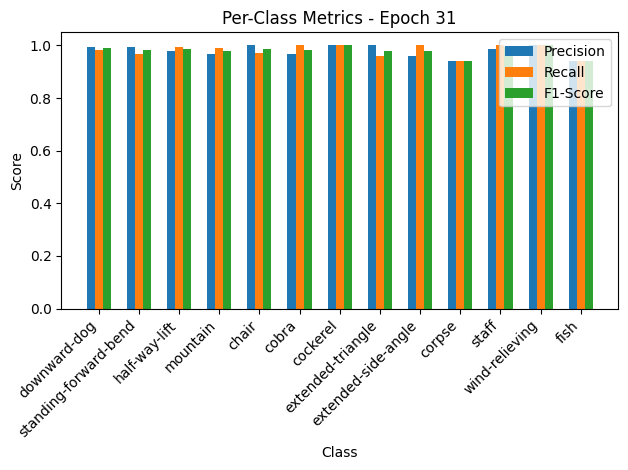

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.48it/s, loss=0.0705, accuracy=97.9]


Per-Class Metrics for Epoch 31:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.99
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.94, F1-Score=0.94


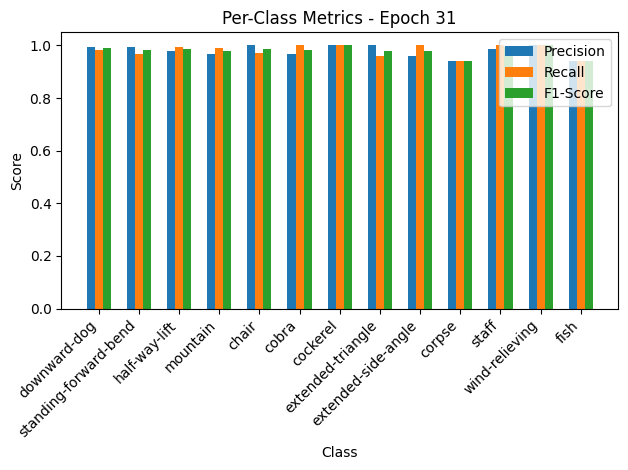


Epoch 32/50 Summary:
Train Loss: 0.0771 | Train Acc: 98.17% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.0772 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 33/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.18it/s, loss=0.0623, accuracy=98.7]


Per-Class Metrics for Epoch 32:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=0.99, F1-Score=0.98
chair: Precision=0.98, Recall=0.98, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.96, Recall=1.00, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.96, F1-Score=0.98


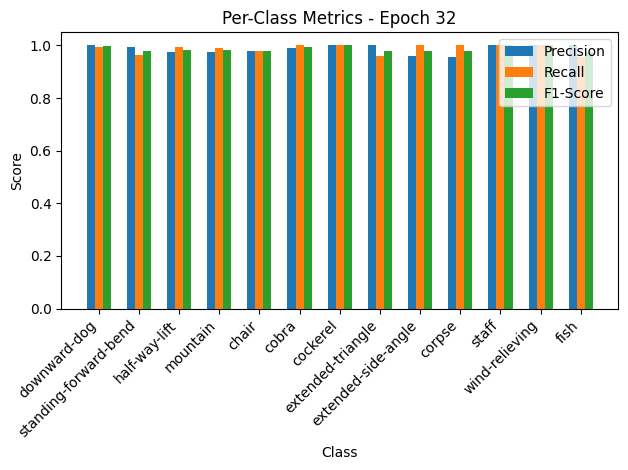

Validation: 100%|██████████| 10/10 [00:00<00:00, 24.81it/s, loss=0.0835, accuracy=97.9]


Per-Class Metrics for Epoch 32:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=0.99, F1-Score=0.98
chair: Precision=0.98, Recall=0.98, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.96, Recall=1.00, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.96, F1-Score=0.98


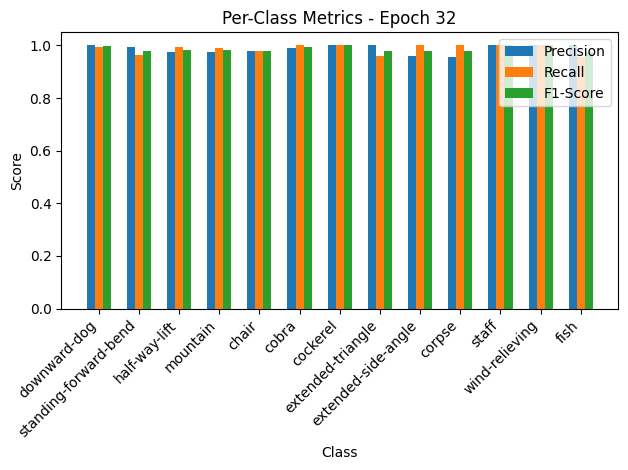


Epoch 33/50 Summary:
Train Loss: 0.0624 | Train Acc: 98.70% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0916 | Val Acc: 97.95% | Val Precision: 0.99 | Val Recall: 0.99 | Val F1: 0.99

Epoch 34/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:10<00:00,  7.70it/s, loss=0.0579, accuracy=99]


Per-Class Metrics for Epoch 33:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.99, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=0.99, F1-Score=0.99
mountain: Precision=0.99, Recall=0.97, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.99, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.97, F1-Score=0.98


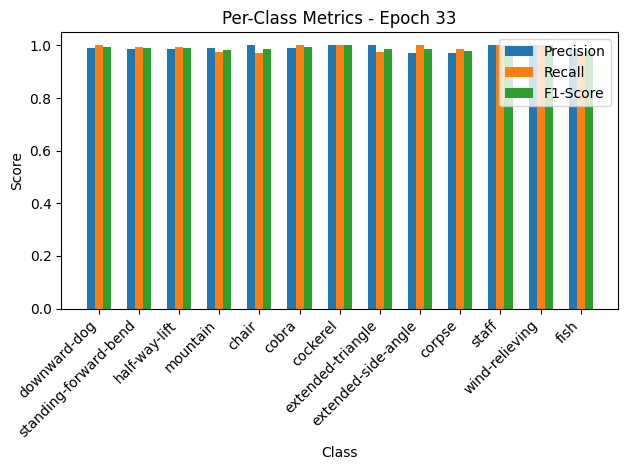

Validation: 100%|██████████| 10/10 [00:00<00:00, 29.67it/s, loss=0.0673, accuracy=97.9]


Per-Class Metrics for Epoch 33:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.99, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=0.99, F1-Score=0.99
mountain: Precision=0.99, Recall=0.97, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.99, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.97, F1-Score=0.98


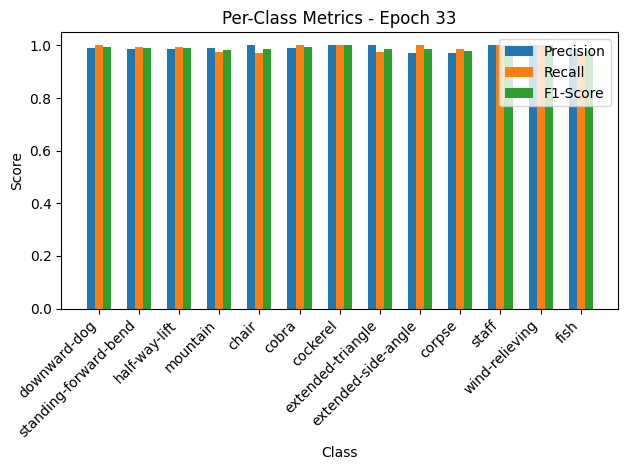


Epoch 34/50 Summary:
Train Loss: 0.0581 | Train Acc: 99.01% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0738 | Val Acc: 97.95% | Val Precision: 0.99 | Val Recall: 0.99 | Val F1: 0.99

Epoch 35/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:10<00:00,  7.67it/s, loss=0.0543, accuracy=99.2]


Per-Class Metrics for Epoch 34:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.99, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=0.99, F1-Score=0.99
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.99, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.99, F1-Score=0.99


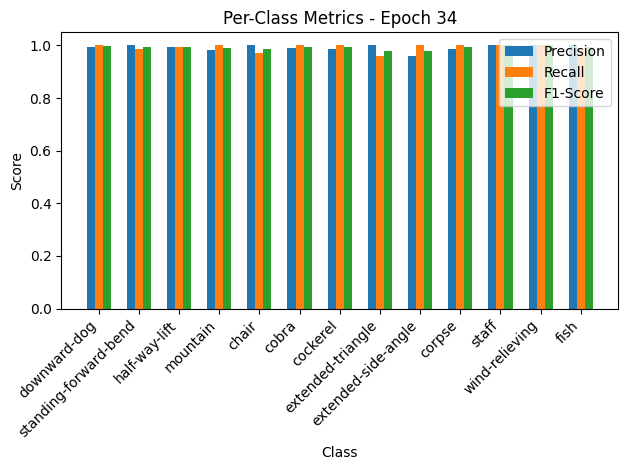

Validation: 100%|██████████| 10/10 [00:00<00:00, 22.27it/s, loss=0.0619, accuracy=97.9]


Per-Class Metrics for Epoch 34:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.99, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=0.99, F1-Score=0.99
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.99, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.99, F1-Score=0.99


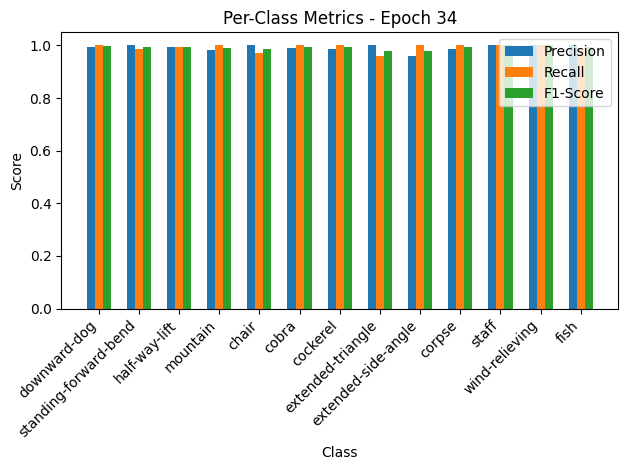


Epoch 35/50 Summary:
Train Loss: 0.0544 | Train Acc: 99.24% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0679 | Val Acc: 97.95% | Val Precision: 0.99 | Val Recall: 0.99 | Val F1: 0.99

Epoch 36/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:11<00:00,  7.20it/s, loss=0.0533, accuracy=99.2]


Per-Class Metrics for Epoch 35:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=1.00, F1-Score=1.00
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.99, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.99, F1-Score=0.99


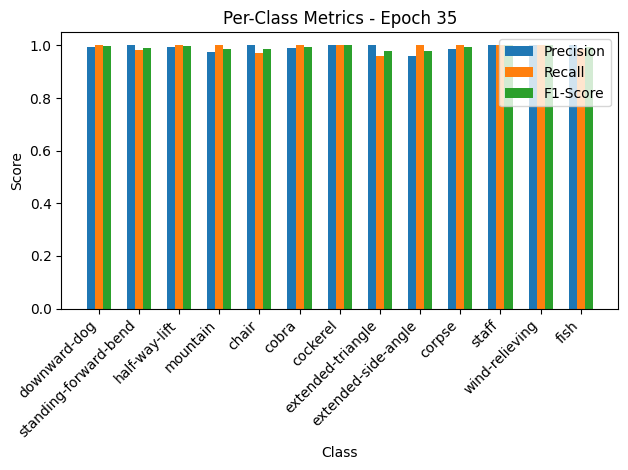

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.02it/s, loss=0.063, accuracy=98.6]


Per-Class Metrics for Epoch 35:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=1.00, F1-Score=1.00
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.99, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.99, F1-Score=0.99


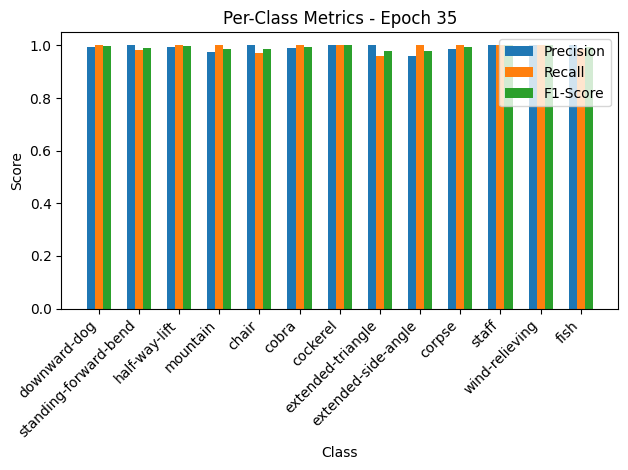


Epoch 36/50 Summary:
Train Loss: 0.0535 | Train Acc: 99.24% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0690 | Val Acc: 98.63% | Val Precision: 0.99 | Val Recall: 0.99 | Val F1: 0.99

Epoch 37/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:11<00:00,  7.14it/s, loss=0.0465, accuracy=99.3]


Per-Class Metrics for Epoch 36:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=1.00, F1-Score=1.00
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.99, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.99, F1-Score=0.99


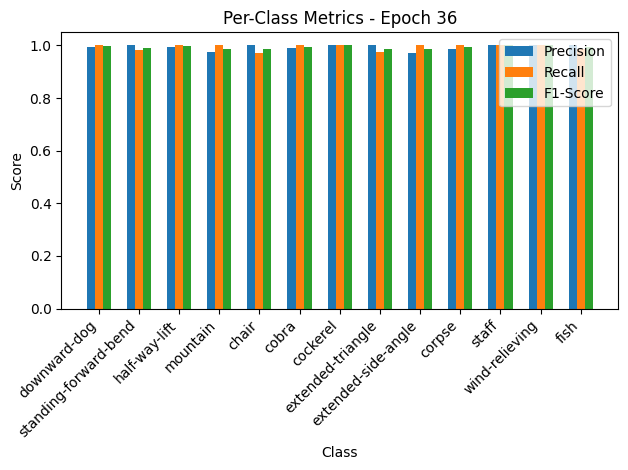

Validation: 100%|██████████| 10/10 [00:00<00:00, 28.33it/s, loss=0.0651, accuracy=98.6]


Per-Class Metrics for Epoch 36:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=1.00, F1-Score=1.00
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.99, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.99, F1-Score=0.99


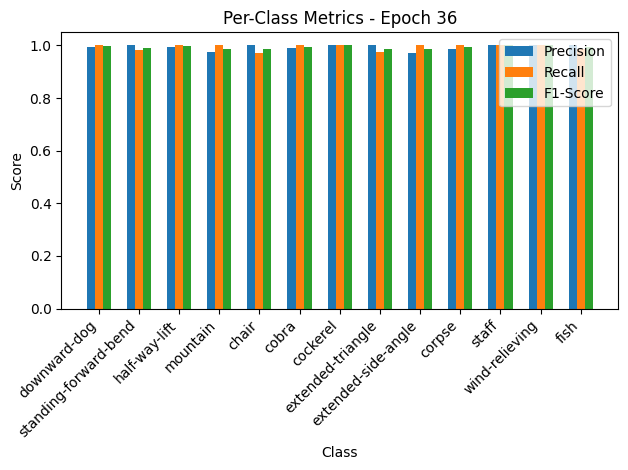


Epoch 37/50 Summary:
Train Loss: 0.0466 | Train Acc: 99.31% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0713 | Val Acc: 98.63% | Val Precision: 0.99 | Val Recall: 0.99 | Val F1: 0.99

Epoch 38/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:11<00:00,  7.15it/s, loss=0.0461, accuracy=99.3]


Per-Class Metrics for Epoch 37:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=1.00, F1-Score=1.00
mountain: Precision=0.98, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.99, Recall=0.99, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.99, Recall=0.99, F1-Score=0.99


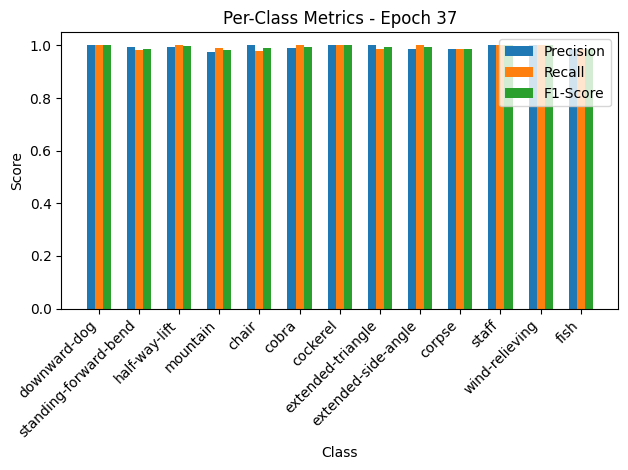

Validation: 100%|██████████| 10/10 [00:00<00:00, 26.36it/s, loss=0.0588, accuracy=97.9]


Per-Class Metrics for Epoch 37:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=1.00, F1-Score=1.00
mountain: Precision=0.98, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.99, Recall=0.99, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.99, Recall=0.99, F1-Score=0.99


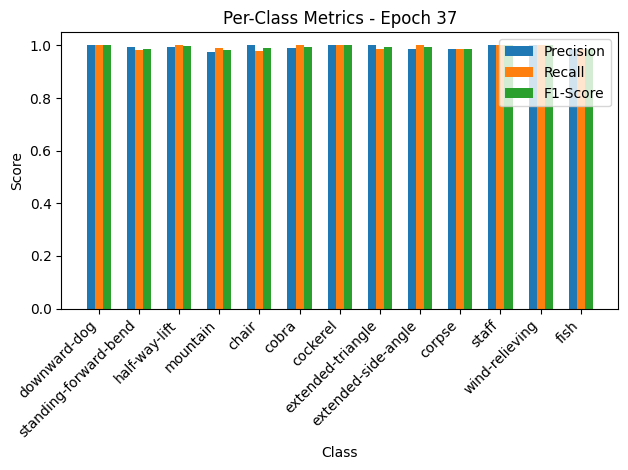


Epoch 38/50 Summary:
Train Loss: 0.0463 | Train Acc: 99.31% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0644 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_2.pth
Checkpoint saved at epoch 38
New best model saved! Validation Loss: 0.0644

Epoch 39/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:11<00:00,  7.19it/s, loss=0.05, accuracy=99.3]


Per-Class Metrics for Epoch 38:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.99, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=1.00, F1-Score=1.00
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.99, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.97, F1-Score=0.98


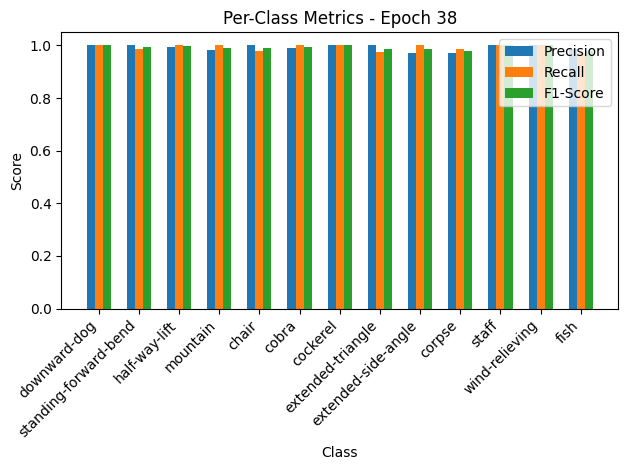

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.16it/s, loss=0.0623, accuracy=98.6]


Per-Class Metrics for Epoch 38:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.99, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=1.00, F1-Score=1.00
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.99, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.97, F1-Score=0.98


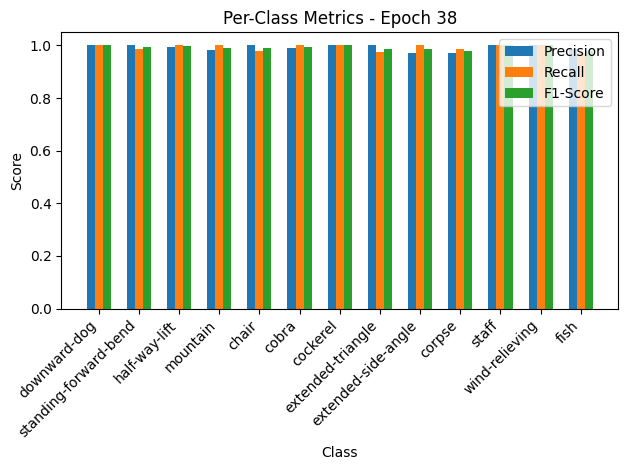


Epoch 39/50 Summary:
Train Loss: 0.0501 | Train Acc: 99.31% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0683 | Val Acc: 98.63% | Val Precision: 0.99 | Val Recall: 0.99 | Val F1: 0.99

Epoch 40/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:10<00:00,  7.84it/s, loss=0.0472, accuracy=99.2]


Per-Class Metrics for Epoch 39:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=0.99, F1-Score=0.99
mountain: Precision=0.97, Recall=1.00, F1-Score=0.98
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.99, Recall=0.99, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.99, Recall=0.99, F1-Score=0.99


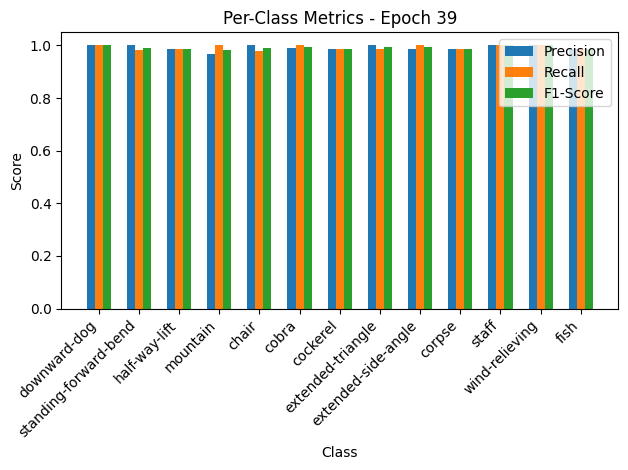

Validation: 100%|██████████| 10/10 [00:00<00:00, 22.65it/s, loss=0.0738, accuracy=97.3]


Per-Class Metrics for Epoch 39:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=0.99, F1-Score=0.99
mountain: Precision=0.97, Recall=1.00, F1-Score=0.98
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.99, Recall=0.99, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.99, Recall=0.99, F1-Score=0.99


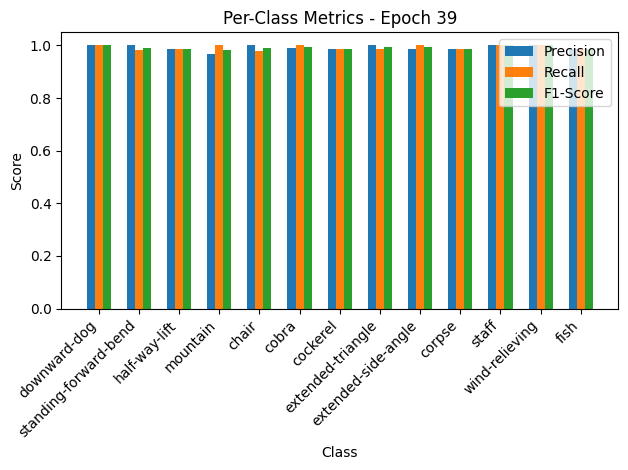


Epoch 40/50 Summary:
Train Loss: 0.0474 | Train Acc: 99.16% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0809 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 41/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:10<00:00,  7.85it/s, loss=0.0581, accuracy=98.7]


Per-Class Metrics for Epoch 40:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=1.00, F1-Score=0.99
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.97, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.97, F1-Score=0.97


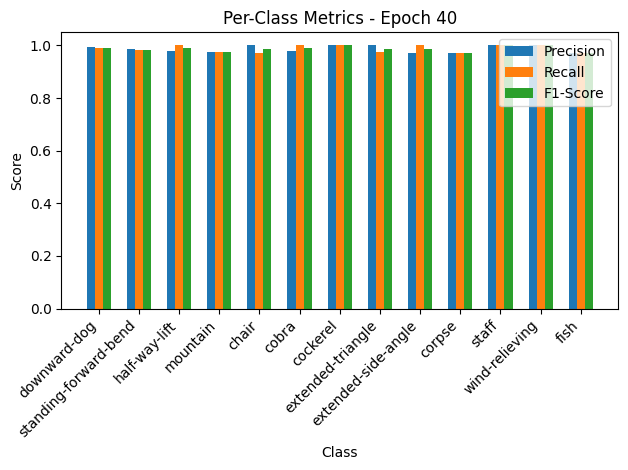

Validation: 100%|██████████| 10/10 [00:00<00:00, 25.82it/s, loss=0.0751, accuracy=97.3]


Per-Class Metrics for Epoch 40:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=1.00, F1-Score=0.99
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.97, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.97, F1-Score=0.97


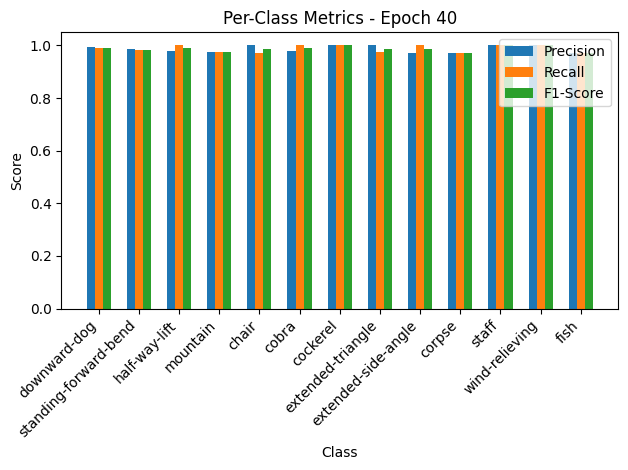


Epoch 41/50 Summary:
Train Loss: 0.0583 | Train Acc: 98.70% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0823 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 42/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:11<00:00,  7.25it/s, loss=0.0415, accuracy=99.5]


Per-Class Metrics for Epoch 41:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=1.00, F1-Score=1.00
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.99, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.99, F1-Score=0.99


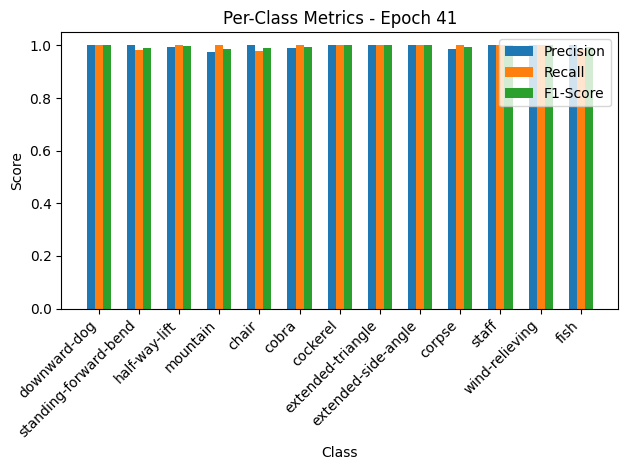

Validation: 100%|██████████| 10/10 [00:00<00:00, 24.79it/s, loss=0.0673, accuracy=97.9]


Per-Class Metrics for Epoch 41:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=1.00, F1-Score=1.00
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.99, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.99, F1-Score=0.99


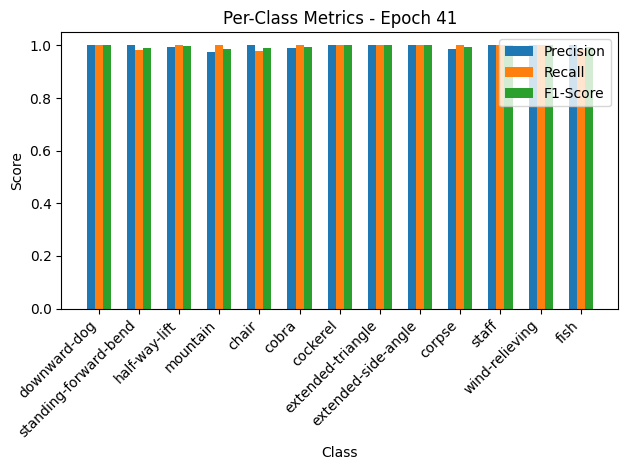


Epoch 42/50 Summary:
Train Loss: 0.0417 | Train Acc: 99.54% | Train Precision: 1.00 | Train Recall: 1.00 | Train F1: 1.00
Val Loss: 0.0738 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 43/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:11<00:00,  7.14it/s, loss=0.0449, accuracy=99.2]


Per-Class Metrics for Epoch 42:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=1.00, F1-Score=0.99
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.99, Recall=0.97, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.99, F1-Score=0.98


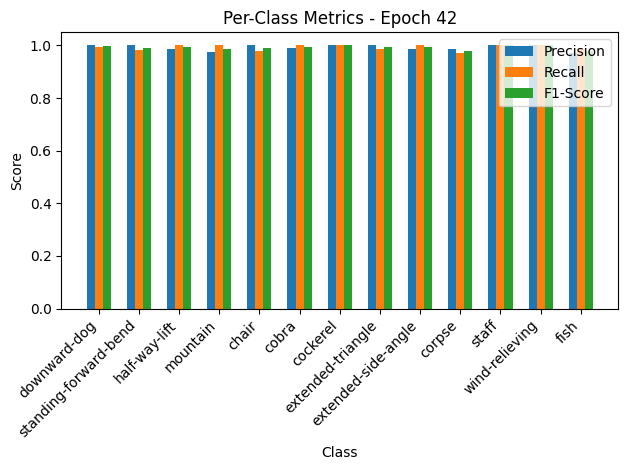

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.66it/s, loss=0.066, accuracy=98.6]


Per-Class Metrics for Epoch 42:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=1.00, F1-Score=0.99
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.99, Recall=0.97, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.99, F1-Score=0.98


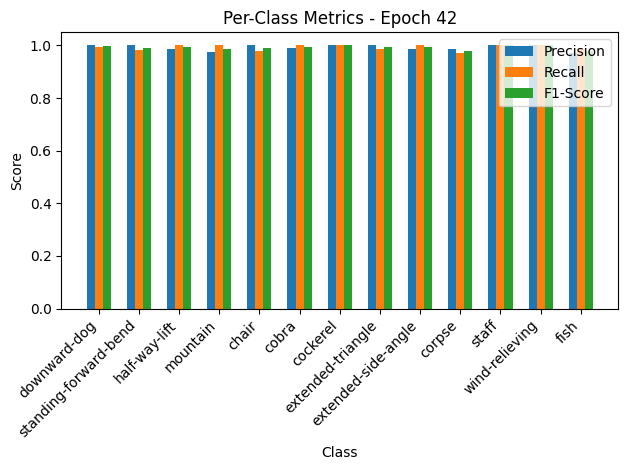


Epoch 43/50 Summary:
Train Loss: 0.0450 | Train Acc: 99.24% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0724 | Val Acc: 98.63% | Val Precision: 0.99 | Val Recall: 0.99 | Val F1: 0.99

Epoch 44/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:10<00:00,  7.53it/s, loss=0.0435, accuracy=99.5]


Per-Class Metrics for Epoch 43:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=1.00, F1-Score=1.00
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.99, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.99, F1-Score=0.99


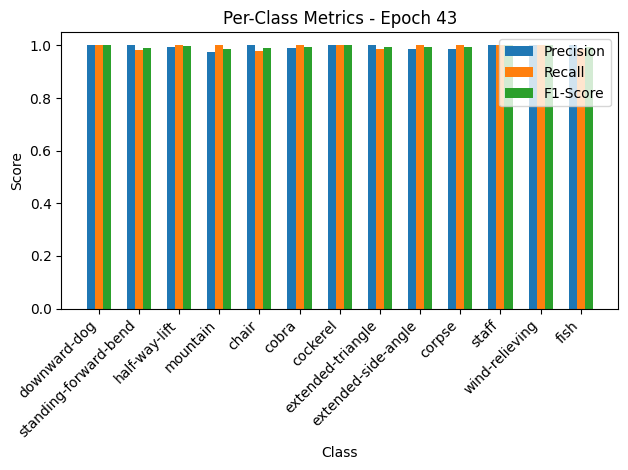

Validation: 100%|██████████| 10/10 [00:00<00:00, 26.45it/s, loss=0.0713, accuracy=97.9]


Per-Class Metrics for Epoch 43:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=1.00, F1-Score=1.00
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.99, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.99, F1-Score=0.99


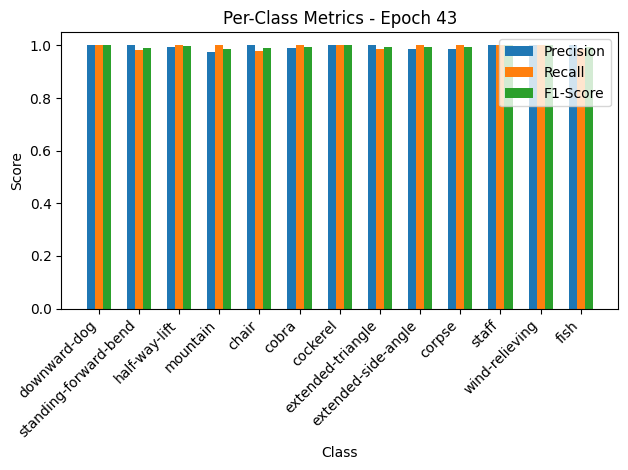


Epoch 44/50 Summary:
Train Loss: 0.0436 | Train Acc: 99.46% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0781 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 45/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:11<00:00,  7.23it/s, loss=0.0446, accuracy=99.2]


Per-Class Metrics for Epoch 44:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.99, Recall=1.00, F1-Score=0.99
mountain: Precision=0.97, Recall=0.98, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.99, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.99, F1-Score=0.99


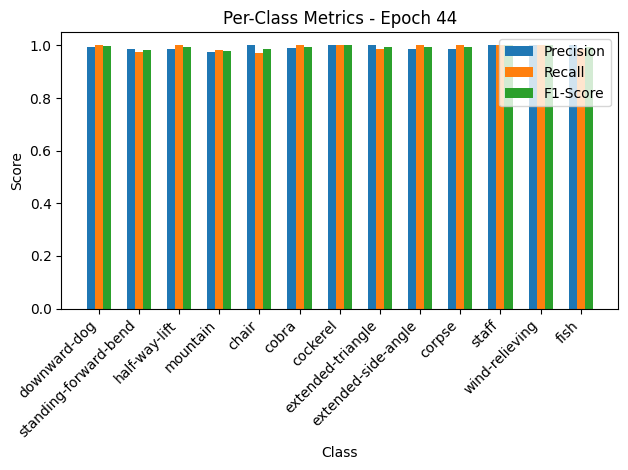

Validation: 100%|██████████| 10/10 [00:00<00:00, 22.73it/s, loss=0.069, accuracy=98.6]


Per-Class Metrics for Epoch 44:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.99, Recall=1.00, F1-Score=0.99
mountain: Precision=0.97, Recall=0.98, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.99, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.99, F1-Score=0.99


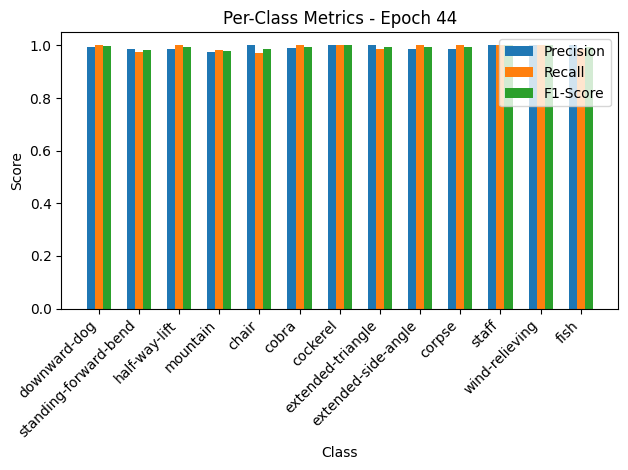


Epoch 45/50 Summary:
Train Loss: 0.0447 | Train Acc: 99.16% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0756 | Val Acc: 98.63% | Val Precision: 0.99 | Val Recall: 0.99 | Val F1: 0.99

Epoch 46/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:10<00:00,  8.03it/s, loss=0.0392, accuracy=99.5]


Per-Class Metrics for Epoch 45:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=1.00, F1-Score=1.00
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.99, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.99, F1-Score=0.99


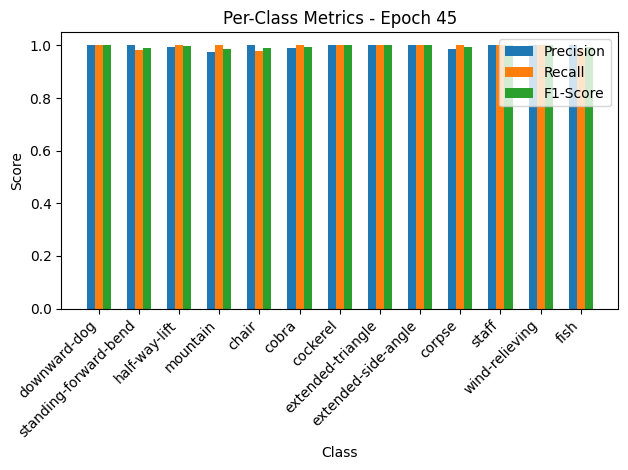

Validation: 100%|██████████| 10/10 [00:00<00:00, 20.73it/s, loss=0.0671, accuracy=97.9]


Per-Class Metrics for Epoch 45:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=1.00, F1-Score=1.00
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.99, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.99, F1-Score=0.99


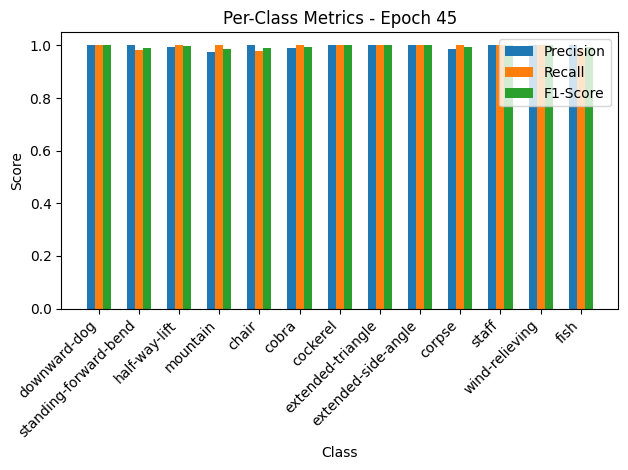


Epoch 46/50 Summary:
Train Loss: 0.0393 | Train Acc: 99.54% | Train Precision: 1.00 | Train Recall: 1.00 | Train F1: 1.00
Val Loss: 0.0735 | Val Acc: 97.95% | Val Precision: 0.99 | Val Recall: 0.99 | Val F1: 0.99

Epoch 47/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:11<00:00,  7.45it/s, loss=0.0383, accuracy=99.4]


Per-Class Metrics for Epoch 46:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=1.00, F1-Score=1.00
mountain: Precision=0.98, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.99, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.99, F1-Score=0.99


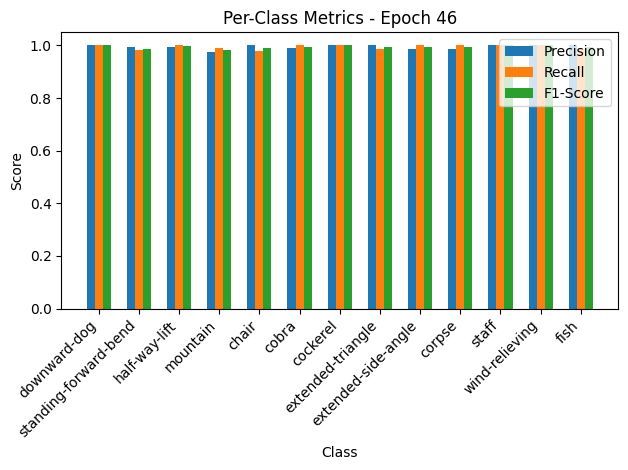

Validation: 100%|██████████| 10/10 [00:00<00:00, 26.48it/s, loss=0.0666, accuracy=97.9]


Per-Class Metrics for Epoch 46:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=1.00, F1-Score=1.00
mountain: Precision=0.98, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.99, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.99, F1-Score=0.99


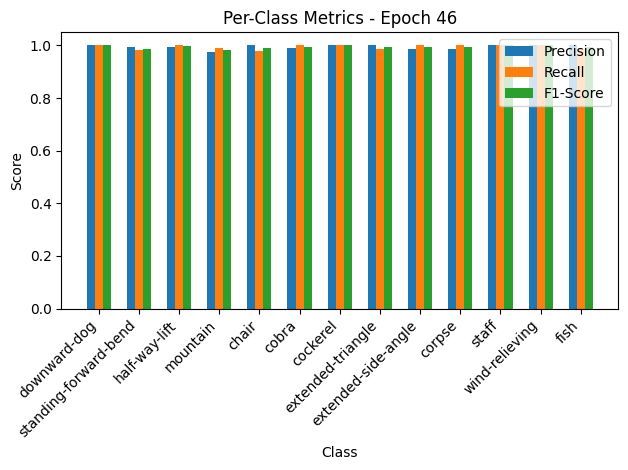


Epoch 47/50 Summary:
Train Loss: 0.0384 | Train Acc: 99.39% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0730 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 48/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:11<00:00,  7.37it/s, loss=0.0386, accuracy=99.5]


Per-Class Metrics for Epoch 47:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.99, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=1.00, F1-Score=1.00
mountain: Precision=0.99, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.99, F1-Score=0.99
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.99, Recall=0.99, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.99, Recall=0.99, F1-Score=0.99


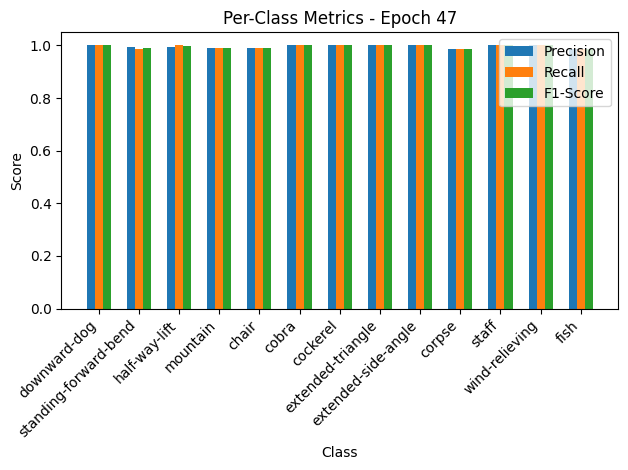

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.64it/s, loss=0.07, accuracy=98.6]


Per-Class Metrics for Epoch 47:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.99, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=1.00, F1-Score=1.00
mountain: Precision=0.99, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.99, F1-Score=0.99
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.99, Recall=0.99, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.99, Recall=0.99, F1-Score=0.99


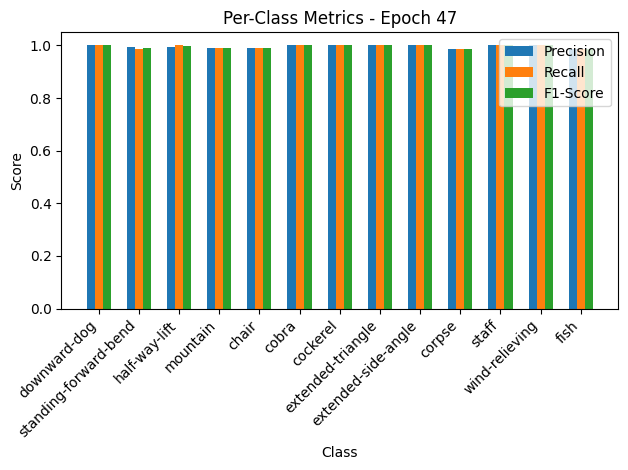


Epoch 48/50 Summary:
Train Loss: 0.0388 | Train Acc: 99.54% | Train Precision: 1.00 | Train Recall: 1.00 | Train F1: 1.00
Val Loss: 0.0767 | Val Acc: 98.63% | Val Precision: 0.99 | Val Recall: 0.99 | Val F1: 0.99

Epoch 49/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:11<00:00,  7.11it/s, loss=0.0412, accuracy=99.3]


Per-Class Metrics for Epoch 48:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.99, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=1.00, F1-Score=0.99
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=0.99, F1-Score=0.99
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-side-angle: Precision=1.00, Recall=0.99, F1-Score=0.99
corpse: Precision=0.99, Recall=0.99, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.99, Recall=0.99, F1-Score=0.99


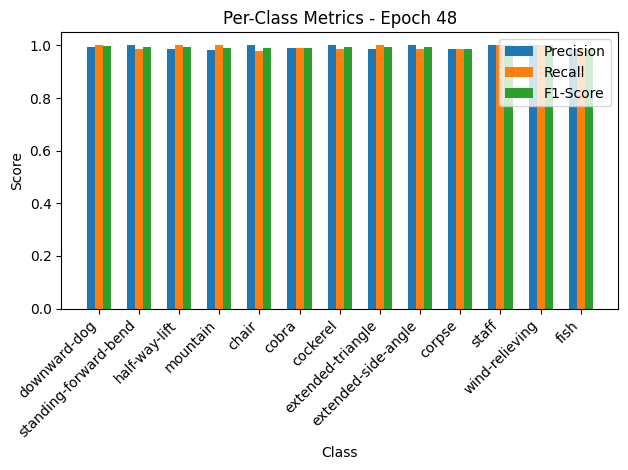

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.84it/s, loss=0.0686, accuracy=98.6]


Per-Class Metrics for Epoch 48:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.99, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=1.00, F1-Score=0.99
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=0.99, F1-Score=0.99
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-side-angle: Precision=1.00, Recall=0.99, F1-Score=0.99
corpse: Precision=0.99, Recall=0.99, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.99, Recall=0.99, F1-Score=0.99


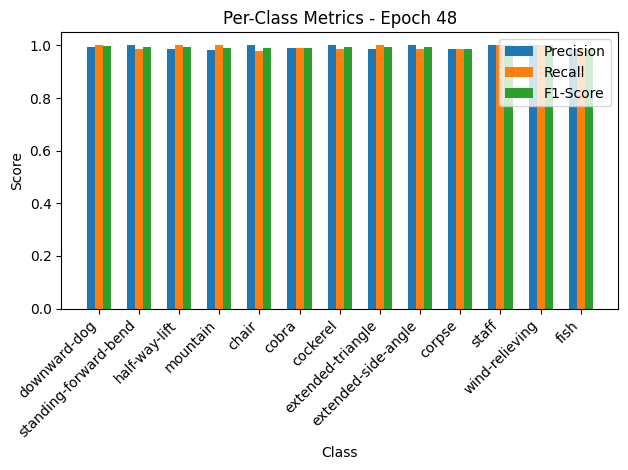


Epoch 49/50 Summary:
Train Loss: 0.0413 | Train Acc: 99.31% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0752 | Val Acc: 98.63% | Val Precision: 0.99 | Val Recall: 0.99 | Val F1: 0.99

Epoch 50/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:11<00:00,  7.15it/s, loss=0.0434, accuracy=99.5]


Per-Class Metrics for Epoch 49:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.99, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=1.00, F1-Score=1.00
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.99, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.99, F1-Score=0.99


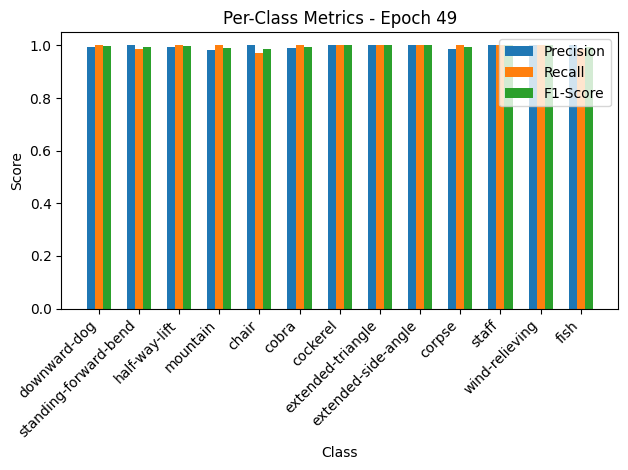

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.52it/s, loss=0.0738, accuracy=97.9]


Per-Class Metrics for Epoch 49:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.99, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=1.00, F1-Score=1.00
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.99, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.99, F1-Score=0.99


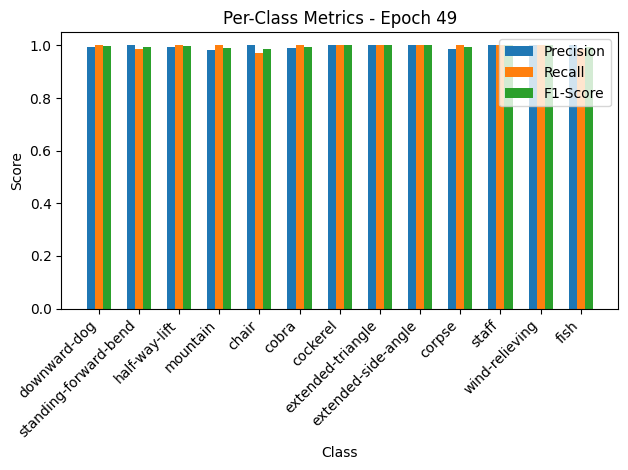


Epoch 50/50 Summary:
Train Loss: 0.0435 | Train Acc: 99.54% | Train Precision: 1.00 | Train Recall: 1.00 | Train F1: 1.00
Val Loss: 0.0809 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98


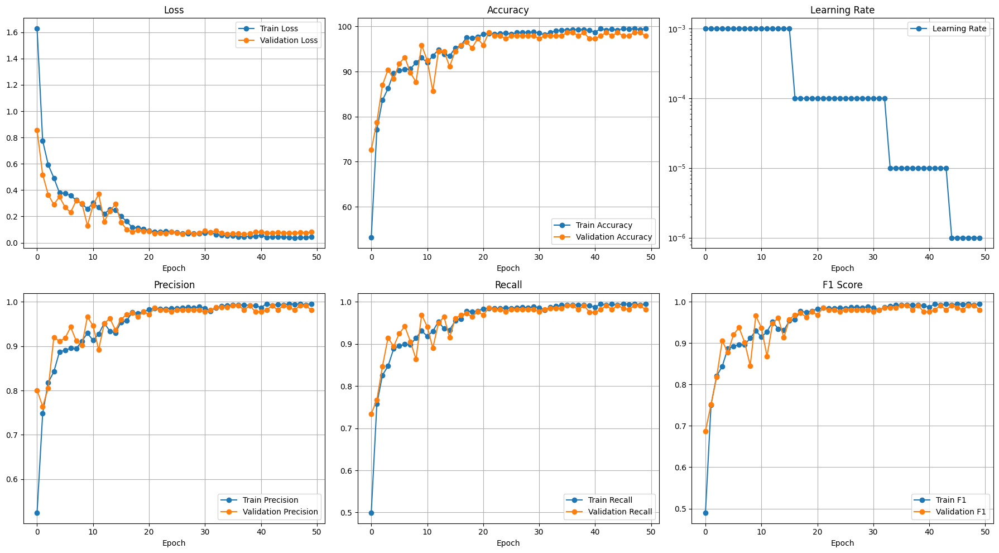

Testing: 100%|██████████| 23/23 [00:00<00:00, 30.36it/s]


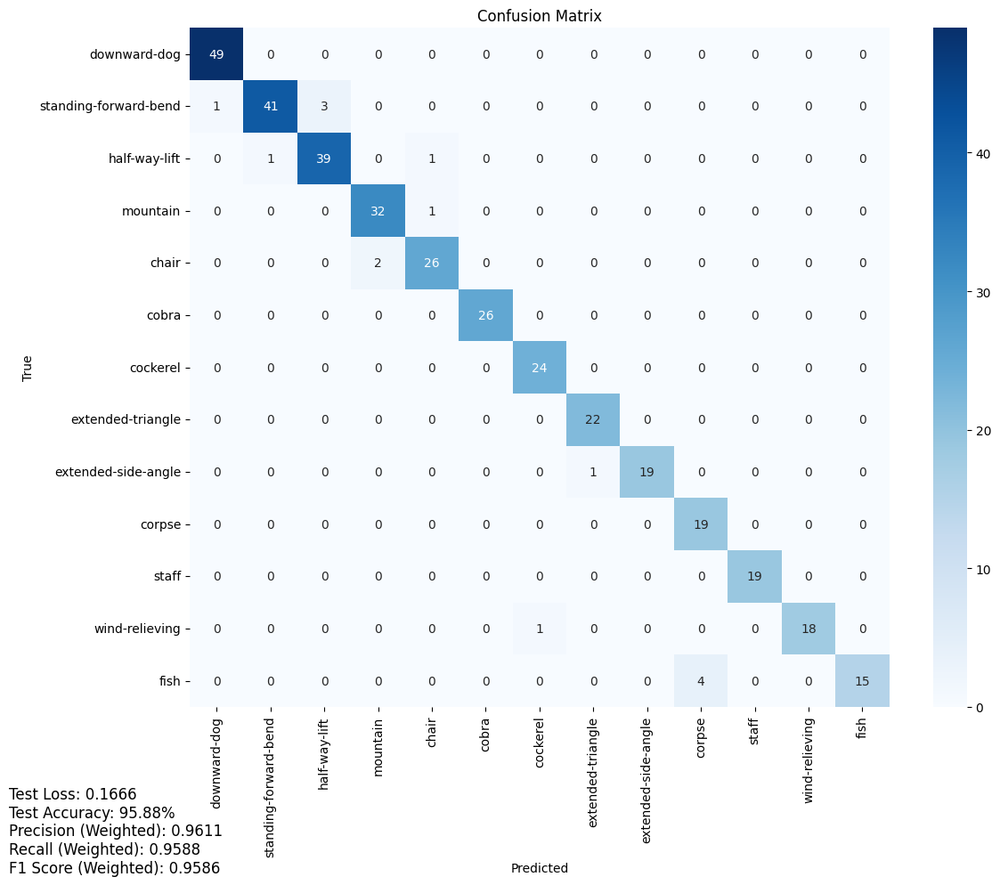

Test Loss: 0.1666
Test Accuracy: 95.88%
Precision (Weighted): 0.9611
Recall (Weighted): 0.9588
F1 Score (Weighted): 0.9586


Testing: 100%|██████████| 23/23 [00:00<00:00, 28.22it/s]


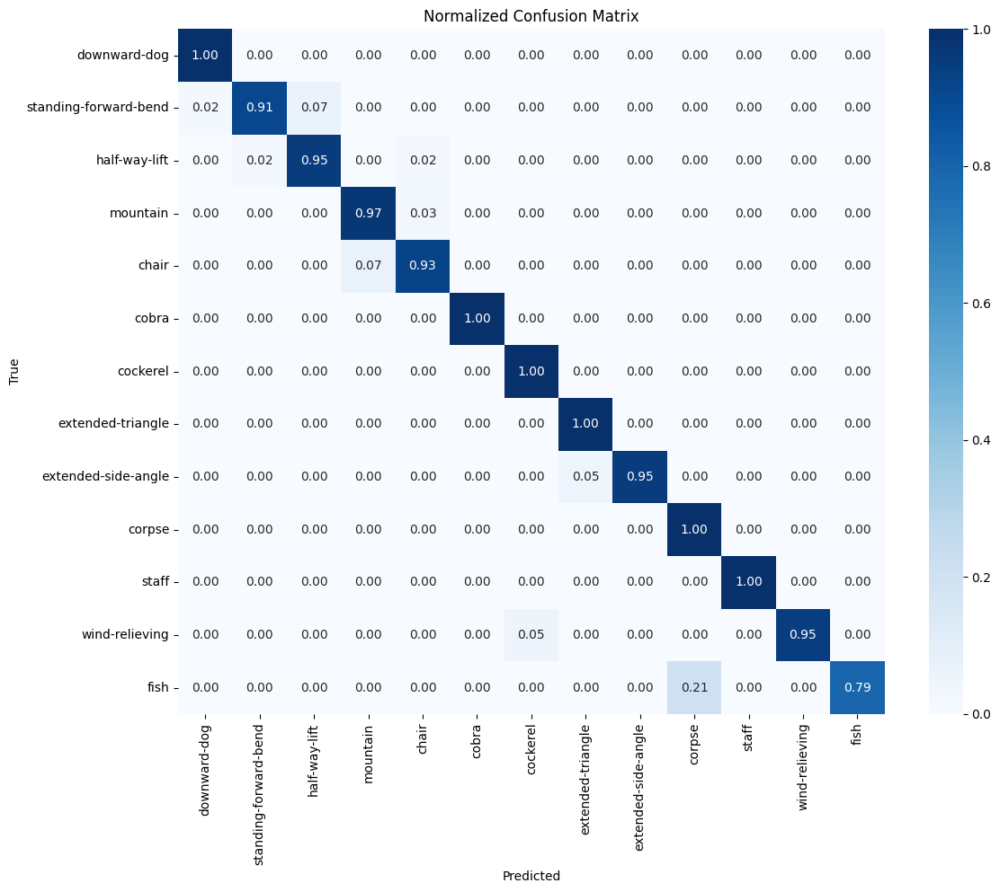

Test Loss: 0.1666
Test Accuracy: 95.88%
Precision (Macro): 0.9613
Recall (Macro): 0.9575
F1 Score (Macro): 0.9575
Saved checkpoint for fold 3
Fold 4/5
Loading cached criterion for fold 3
batch_norm.weight: 99
batch_norm.bias: 99
blocks.0.agcn.A: 3267
blocks.0.agcn.conv.weight: 1080
blocks.0.agcn.conv.bias: 360
blocks.0.agcn.batch_norm.weight: 120
blocks.0.agcn.batch_norm.bias: 120
blocks.0.sam.gs.weight: 3960
blocks.0.sam.gs.bias: 1
blocks.0.tam.gt.weight: 1080
blocks.0.tam.gt.bias: 1
blocks.0.cam.fc.0.weight: 7200
blocks.0.cam.fc.0.bias: 60
blocks.0.cam.fc.2.weight: 7200
blocks.0.cam.fc.2.bias: 120
blocks.0.mtcn.branches.0.0.weight: 2400
blocks.0.mtcn.branches.0.0.bias: 20
blocks.0.mtcn.branches.0.1.weight: 20
blocks.0.mtcn.branches.0.1.bias: 20
blocks.0.mtcn.branches.0.3.conv.weight: 1200
blocks.0.mtcn.branches.0.3.conv.bias: 20
blocks.0.mtcn.branches.0.3.bn.weight: 20
blocks.0.mtcn.branches.0.3.bn.bias: 20
blocks.0.mtcn.branches.1.0.weight: 2400
blocks.0.mtcn.branches.1.0.bias: 20
b

Training: 100%|██████████| 82/82 [00:11<00:00,  7.22it/s, loss=1.34, accuracy=58.4]


Per-Class Metrics for Epoch 0:
downward-dog: Precision=0.75, Recall=0.66, F1-Score=0.70
standing-forward-bend: Precision=0.68, Recall=0.33, F1-Score=0.45
half-way-lift: Precision=0.58, Recall=0.81, F1-Score=0.68
mountain: Precision=0.55, Recall=0.81, F1-Score=0.66
chair: Precision=0.62, Recall=0.35, F1-Score=0.45
cobra: Precision=0.63, Recall=0.74, F1-Score=0.68
cockerel: Precision=0.67, Recall=0.72, F1-Score=0.70
extended-triangle: Precision=0.45, Recall=0.36, F1-Score=0.40
extended-side-angle: Precision=0.32, Recall=0.41, F1-Score=0.36
corpse: Precision=0.49, Recall=0.31, F1-Score=0.38
staff: Precision=0.52, Recall=0.85, F1-Score=0.64
wind-relieving: Precision=0.70, Recall=0.69, F1-Score=0.70
fish: Precision=0.47, Recall=0.37, F1-Score=0.42


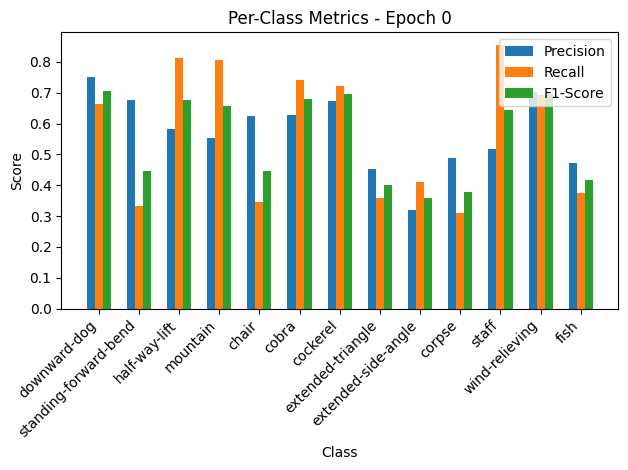

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.97it/s, loss=0.735, accuracy=71.2]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 0:
downward-dog: Precision=0.75, Recall=0.66, F1-Score=0.70
standing-forward-bend: Precision=0.68, Recall=0.33, F1-Score=0.45
half-way-lift: Precision=0.58, Recall=0.81, F1-Score=0.68
mountain: Precision=0.55, Recall=0.81, F1-Score=0.66
chair: Precision=0.62, Recall=0.35, F1-Score=0.45
cobra: Precision=0.63, Recall=0.74, F1-Score=0.68
cockerel: Precision=0.67, Recall=0.72, F1-Score=0.70
extended-triangle: Precision=0.45, Recall=0.36, F1-Score=0.40
extended-side-angle: Precision=0.32, Recall=0.41, F1-Score=0.36
corpse: Precision=0.49, Recall=0.31, F1-Score=0.38
staff: Precision=0.52, Recall=0.85, F1-Score=0.64
wind-relieving: Precision=0.70, Recall=0.69, F1-Score=0.70
fish: Precision=0.47, Recall=0.37, F1-Score=0.42


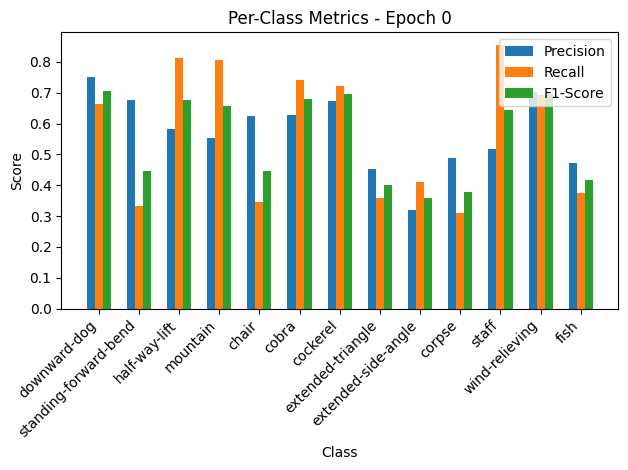


Epoch 1/50 Summary:
Train Loss: 1.3445 | Train Acc: 58.37% | Train Precision: 0.57 | Train Recall: 0.57 | Train F1: 0.55
Val Loss: 0.8050 | Val Acc: 71.23% | Val Precision: 0.74 | Val Recall: 0.72 | Val F1: 0.68
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_3.pth
Checkpoint saved at epoch 1
New best model saved! Validation Loss: 0.8050

Epoch 2/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.33it/s, loss=0.711, accuracy=77.2]


Per-Class Metrics for Epoch 1:
downward-dog: Precision=0.88, Recall=0.83, F1-Score=0.86
standing-forward-bend: Precision=0.87, Recall=0.73, F1-Score=0.79
half-way-lift: Precision=0.76, Recall=0.88, F1-Score=0.81
mountain: Precision=0.82, Recall=0.83, F1-Score=0.82
chair: Precision=0.72, Recall=0.71, F1-Score=0.72
cobra: Precision=0.80, Recall=0.88, F1-Score=0.84
cockerel: Precision=0.88, Recall=0.93, F1-Score=0.90
extended-triangle: Precision=0.65, Recall=0.62, F1-Score=0.63
extended-side-angle: Precision=0.59, Recall=0.60, F1-Score=0.60
corpse: Precision=0.48, Recall=0.51, F1-Score=0.50
staff: Precision=0.88, Recall=0.93, F1-Score=0.90
wind-relieving: Precision=0.86, Recall=0.84, F1-Score=0.85
fish: Precision=0.57, Recall=0.52, F1-Score=0.55


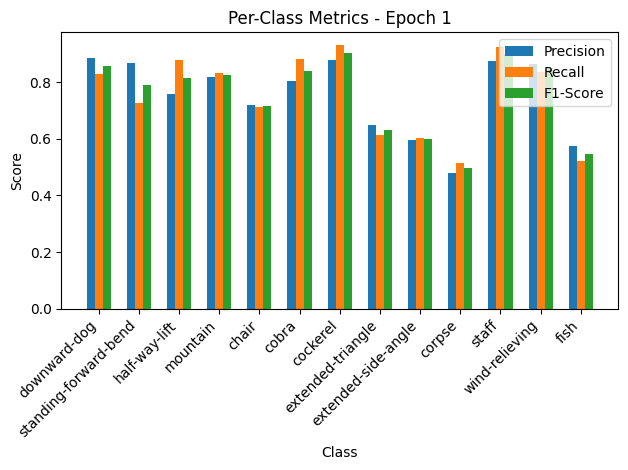

Validation: 100%|██████████| 10/10 [00:00<00:00, 28.09it/s, loss=0.575, accuracy=80.1]


Per-Class Metrics for Epoch 1:
downward-dog: Precision=0.88, Recall=0.83, F1-Score=0.86
standing-forward-bend: Precision=0.87, Recall=0.73, F1-Score=0.79
half-way-lift: Precision=0.76, Recall=0.88, F1-Score=0.81
mountain: Precision=0.82, Recall=0.83, F1-Score=0.82
chair: Precision=0.72, Recall=0.71, F1-Score=0.72
cobra: Precision=0.80, Recall=0.88, F1-Score=0.84
cockerel: Precision=0.88, Recall=0.93, F1-Score=0.90
extended-triangle: Precision=0.65, Recall=0.62, F1-Score=0.63
extended-side-angle: Precision=0.59, Recall=0.60, F1-Score=0.60
corpse: Precision=0.48, Recall=0.51, F1-Score=0.50
staff: Precision=0.88, Recall=0.93, F1-Score=0.90
wind-relieving: Precision=0.86, Recall=0.84, F1-Score=0.85
fish: Precision=0.57, Recall=0.52, F1-Score=0.55


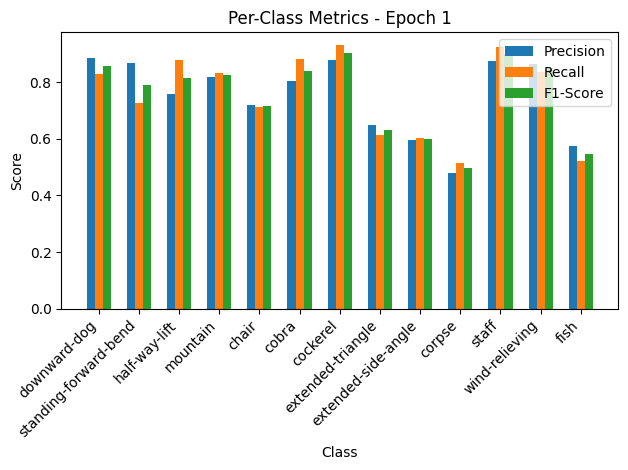


Epoch 2/50 Summary:
Train Loss: 0.7122 | Train Acc: 77.23% | Train Precision: 0.75 | Train Recall: 0.75 | Train F1: 0.75
Val Loss: 0.6299 | Val Acc: 80.14% | Val Precision: 0.82 | Val Recall: 0.80 | Val F1: 0.79
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_3.pth
Checkpoint saved at epoch 2
New best model saved! Validation Loss: 0.6299

Epoch 3/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.10it/s, loss=0.527, accuracy=84.2]


Per-Class Metrics for Epoch 2:
downward-dog: Precision=0.96, Recall=0.92, F1-Score=0.94
standing-forward-bend: Precision=0.89, Recall=0.80, F1-Score=0.84
half-way-lift: Precision=0.83, Recall=0.87, F1-Score=0.85
mountain: Precision=0.84, Recall=0.87, F1-Score=0.86
chair: Precision=0.77, Recall=0.77, F1-Score=0.77
cobra: Precision=0.91, Recall=0.99, F1-Score=0.95
cockerel: Precision=0.92, Recall=0.95, F1-Score=0.94
extended-triangle: Precision=0.85, Recall=0.78, F1-Score=0.81
extended-side-angle: Precision=0.73, Recall=0.79, F1-Score=0.76
corpse: Precision=0.59, Recall=0.51, F1-Score=0.55
staff: Precision=0.92, Recall=0.97, F1-Score=0.94
wind-relieving: Precision=0.90, Recall=0.91, F1-Score=0.91
fish: Precision=0.59, Recall=0.63, F1-Score=0.61


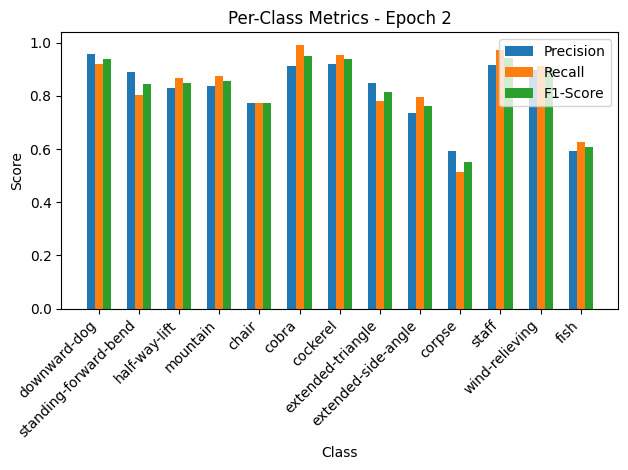

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.49it/s, loss=0.345, accuracy=86.3]


Per-Class Metrics for Epoch 2:
downward-dog: Precision=0.96, Recall=0.92, F1-Score=0.94
standing-forward-bend: Precision=0.89, Recall=0.80, F1-Score=0.84
half-way-lift: Precision=0.83, Recall=0.87, F1-Score=0.85
mountain: Precision=0.84, Recall=0.87, F1-Score=0.86
chair: Precision=0.77, Recall=0.77, F1-Score=0.77
cobra: Precision=0.91, Recall=0.99, F1-Score=0.95
cockerel: Precision=0.92, Recall=0.95, F1-Score=0.94
extended-triangle: Precision=0.85, Recall=0.78, F1-Score=0.81
extended-side-angle: Precision=0.73, Recall=0.79, F1-Score=0.76
corpse: Precision=0.59, Recall=0.51, F1-Score=0.55
staff: Precision=0.92, Recall=0.97, F1-Score=0.94
wind-relieving: Precision=0.90, Recall=0.91, F1-Score=0.91
fish: Precision=0.59, Recall=0.63, F1-Score=0.61


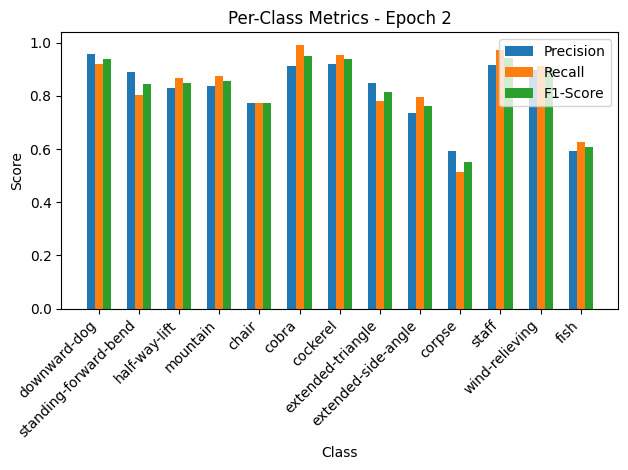


Epoch 3/50 Summary:
Train Loss: 0.5286 | Train Acc: 84.19% | Train Precision: 0.82 | Train Recall: 0.83 | Train F1: 0.83
Val Loss: 0.3778 | Val Acc: 86.30% | Val Precision: 0.86 | Val Recall: 0.87 | Val F1: 0.85
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_3.pth
Checkpoint saved at epoch 3
New best model saved! Validation Loss: 0.3778

Epoch 4/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.28it/s, loss=0.41, accuracy=87.2]


Per-Class Metrics for Epoch 3:
downward-dog: Precision=0.97, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.92, Recall=0.82, F1-Score=0.87
half-way-lift: Precision=0.82, Recall=0.89, F1-Score=0.85
mountain: Precision=0.90, Recall=0.94, F1-Score=0.92
chair: Precision=0.88, Recall=0.82, F1-Score=0.85
cobra: Precision=0.91, Recall=0.98, F1-Score=0.94
cockerel: Precision=0.94, Recall=0.93, F1-Score=0.94
extended-triangle: Precision=0.82, Recall=0.83, F1-Score=0.83
extended-side-angle: Precision=0.77, Recall=0.77, F1-Score=0.77
corpse: Precision=0.65, Recall=0.66, F1-Score=0.66
staff: Precision=0.96, Recall=0.99, F1-Score=0.97
wind-relieving: Precision=0.96, Recall=0.96, F1-Score=0.96
fish: Precision=0.65, Recall=0.63, F1-Score=0.64


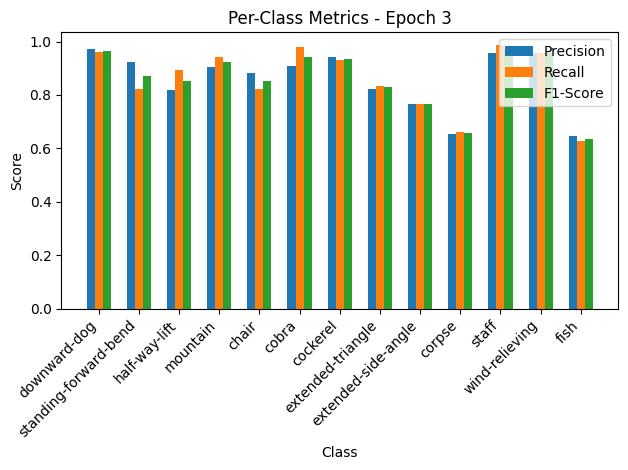

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.73it/s, loss=0.265, accuracy=91.1]


Per-Class Metrics for Epoch 3:
downward-dog: Precision=0.97, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.92, Recall=0.82, F1-Score=0.87
half-way-lift: Precision=0.82, Recall=0.89, F1-Score=0.85
mountain: Precision=0.90, Recall=0.94, F1-Score=0.92
chair: Precision=0.88, Recall=0.82, F1-Score=0.85
cobra: Precision=0.91, Recall=0.98, F1-Score=0.94
cockerel: Precision=0.94, Recall=0.93, F1-Score=0.94
extended-triangle: Precision=0.82, Recall=0.83, F1-Score=0.83
extended-side-angle: Precision=0.77, Recall=0.77, F1-Score=0.77
corpse: Precision=0.65, Recall=0.66, F1-Score=0.66
staff: Precision=0.96, Recall=0.99, F1-Score=0.97
wind-relieving: Precision=0.96, Recall=0.96, F1-Score=0.96
fish: Precision=0.65, Recall=0.63, F1-Score=0.64


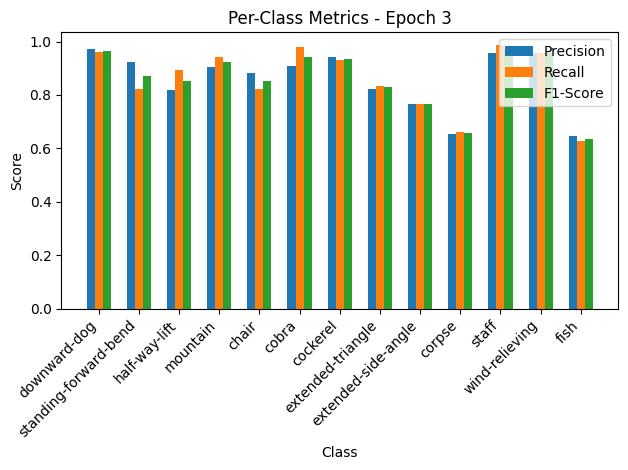


Epoch 4/50 Summary:
Train Loss: 0.4105 | Train Acc: 87.24% | Train Precision: 0.86 | Train Recall: 0.86 | Train F1: 0.86
Val Loss: 0.2905 | Val Acc: 91.10% | Val Precision: 0.91 | Val Recall: 0.91 | Val F1: 0.91
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_3.pth
Checkpoint saved at epoch 4
New best model saved! Validation Loss: 0.2905

Epoch 5/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.50it/s, loss=0.393, accuracy=88.5]


Per-Class Metrics for Epoch 4:
downward-dog: Precision=0.95, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=0.94, Recall=0.81, F1-Score=0.87
half-way-lift: Precision=0.84, Recall=0.91, F1-Score=0.87
mountain: Precision=0.88, Recall=0.92, F1-Score=0.90
chair: Precision=0.92, Recall=0.90, F1-Score=0.91
cobra: Precision=0.94, Recall=0.99, F1-Score=0.96
cockerel: Precision=0.98, Recall=0.93, F1-Score=0.95
extended-triangle: Precision=0.86, Recall=0.81, F1-Score=0.83
extended-side-angle: Precision=0.79, Recall=0.86, F1-Score=0.82
corpse: Precision=0.70, Recall=0.68, F1-Score=0.69
staff: Precision=0.93, Recall=0.99, F1-Score=0.96
wind-relieving: Precision=0.94, Recall=0.99, F1-Score=0.96
fish: Precision=0.69, Recall=0.67, F1-Score=0.68


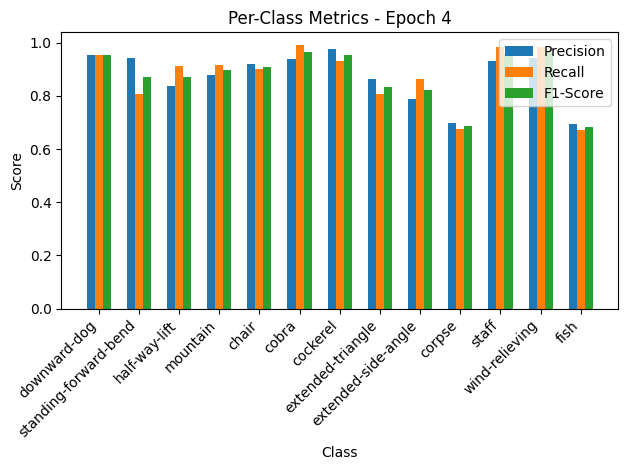

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.75it/s, loss=0.224, accuracy=92.5]


Per-Class Metrics for Epoch 4:
downward-dog: Precision=0.95, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=0.94, Recall=0.81, F1-Score=0.87
half-way-lift: Precision=0.84, Recall=0.91, F1-Score=0.87
mountain: Precision=0.88, Recall=0.92, F1-Score=0.90
chair: Precision=0.92, Recall=0.90, F1-Score=0.91
cobra: Precision=0.94, Recall=0.99, F1-Score=0.96
cockerel: Precision=0.98, Recall=0.93, F1-Score=0.95
extended-triangle: Precision=0.86, Recall=0.81, F1-Score=0.83
extended-side-angle: Precision=0.79, Recall=0.86, F1-Score=0.82
corpse: Precision=0.70, Recall=0.68, F1-Score=0.69
staff: Precision=0.93, Recall=0.99, F1-Score=0.96
wind-relieving: Precision=0.94, Recall=0.99, F1-Score=0.96
fish: Precision=0.69, Recall=0.67, F1-Score=0.68


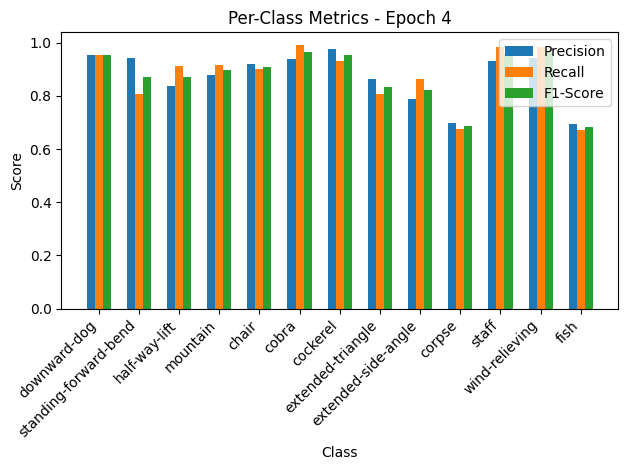


Epoch 5/50 Summary:
Train Loss: 0.3938 | Train Acc: 88.54% | Train Precision: 0.87 | Train Recall: 0.88 | Train F1: 0.87
Val Loss: 0.2453 | Val Acc: 92.47% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.93
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_3.pth
Checkpoint saved at epoch 5
New best model saved! Validation Loss: 0.2453

Epoch 6/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.60it/s, loss=0.338, accuracy=90.1]


Per-Class Metrics for Epoch 5:
downward-dog: Precision=0.96, Recall=0.94, F1-Score=0.95
standing-forward-bend: Precision=0.94, Recall=0.86, F1-Score=0.90
half-way-lift: Precision=0.85, Recall=0.95, F1-Score=0.89
mountain: Precision=0.94, Recall=0.95, F1-Score=0.95
chair: Precision=0.95, Recall=0.91, F1-Score=0.93
cobra: Precision=0.95, Recall=0.95, F1-Score=0.95
cockerel: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-triangle: Precision=0.89, Recall=0.95, F1-Score=0.92
extended-side-angle: Precision=0.93, Recall=0.89, F1-Score=0.91
corpse: Precision=0.65, Recall=0.65, F1-Score=0.65
staff: Precision=0.96, Recall=0.96, F1-Score=0.96
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.64, Recall=0.63, F1-Score=0.63


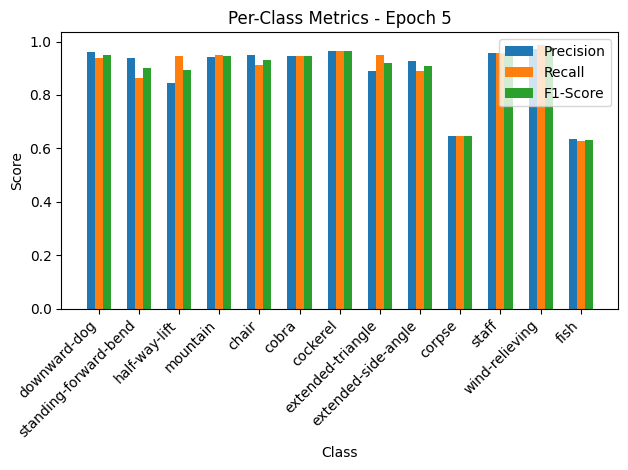

Validation: 100%|██████████| 10/10 [00:00<00:00, 24.13it/s, loss=0.173, accuracy=96.6]


Per-Class Metrics for Epoch 5:
downward-dog: Precision=0.96, Recall=0.94, F1-Score=0.95
standing-forward-bend: Precision=0.94, Recall=0.86, F1-Score=0.90
half-way-lift: Precision=0.85, Recall=0.95, F1-Score=0.89
mountain: Precision=0.94, Recall=0.95, F1-Score=0.95
chair: Precision=0.95, Recall=0.91, F1-Score=0.93
cobra: Precision=0.95, Recall=0.95, F1-Score=0.95
cockerel: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-triangle: Precision=0.89, Recall=0.95, F1-Score=0.92
extended-side-angle: Precision=0.93, Recall=0.89, F1-Score=0.91
corpse: Precision=0.65, Recall=0.65, F1-Score=0.65
staff: Precision=0.96, Recall=0.96, F1-Score=0.96
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.64, Recall=0.63, F1-Score=0.63


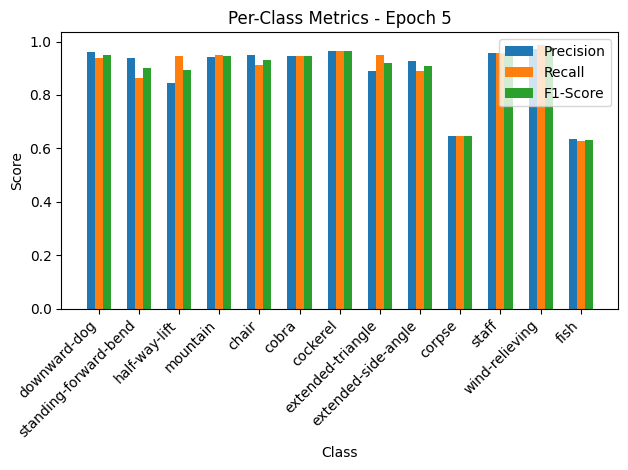


Epoch 6/50 Summary:
Train Loss: 0.3392 | Train Acc: 90.15% | Train Precision: 0.89 | Train Recall: 0.89 | Train F1: 0.89
Val Loss: 0.1900 | Val Acc: 96.58% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_3.pth
Checkpoint saved at epoch 6
New best model saved! Validation Loss: 0.1900

Epoch 7/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.19it/s, loss=0.277, accuracy=92.6]


Per-Class Metrics for Epoch 6:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.89, Recall=0.93, F1-Score=0.91
mountain: Precision=0.96, Recall=0.96, F1-Score=0.96
chair: Precision=0.94, Recall=0.95, F1-Score=0.95
cobra: Precision=0.94, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.95, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=0.90, Recall=0.92, F1-Score=0.91
extended-side-angle: Precision=0.92, Recall=0.90, F1-Score=0.91
corpse: Precision=0.76, Recall=0.75, F1-Score=0.76
staff: Precision=0.97, Recall=0.99, F1-Score=0.98
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.75, Recall=0.73, F1-Score=0.74


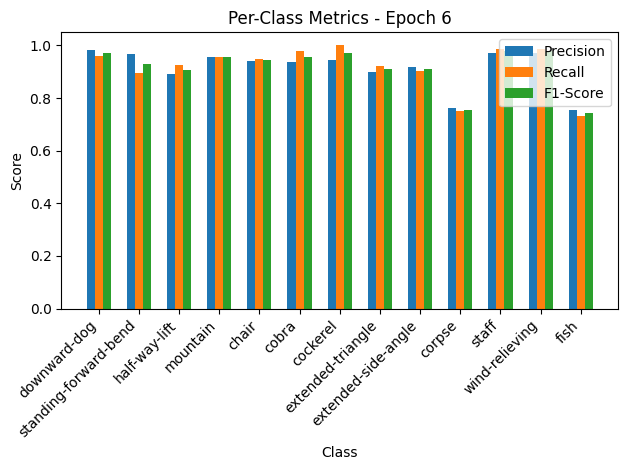

Validation: 100%|██████████| 10/10 [00:00<00:00, 29.07it/s, loss=0.236, accuracy=89]


Per-Class Metrics for Epoch 6:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.89, Recall=0.93, F1-Score=0.91
mountain: Precision=0.96, Recall=0.96, F1-Score=0.96
chair: Precision=0.94, Recall=0.95, F1-Score=0.95
cobra: Precision=0.94, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.95, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=0.90, Recall=0.92, F1-Score=0.91
extended-side-angle: Precision=0.92, Recall=0.90, F1-Score=0.91
corpse: Precision=0.76, Recall=0.75, F1-Score=0.76
staff: Precision=0.97, Recall=0.99, F1-Score=0.98
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.75, Recall=0.73, F1-Score=0.74


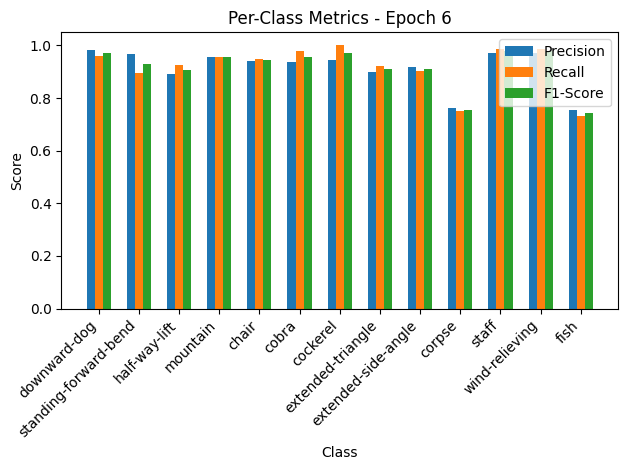


Epoch 7/50 Summary:
Train Loss: 0.2774 | Train Acc: 92.59% | Train Precision: 0.92 | Train Recall: 0.92 | Train F1: 0.92
Val Loss: 0.2582 | Val Acc: 89.04% | Val Precision: 0.88 | Val Recall: 0.88 | Val F1: 0.87

Epoch 8/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.50it/s, loss=0.309, accuracy=91.4]


Per-Class Metrics for Epoch 7:
downward-dog: Precision=0.97, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.92, Recall=0.88, F1-Score=0.90
half-way-lift: Precision=0.89, Recall=0.88, F1-Score=0.89
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.95, Recall=0.95, F1-Score=0.95
cobra: Precision=0.92, Recall=0.99, F1-Score=0.95
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.84, Recall=0.90, F1-Score=0.87
extended-side-angle: Precision=0.88, Recall=0.84, F1-Score=0.86
corpse: Precision=0.74, Recall=0.76, F1-Score=0.75
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=1.00, F1-Score=0.99
fish: Precision=0.75, Recall=0.70, F1-Score=0.72


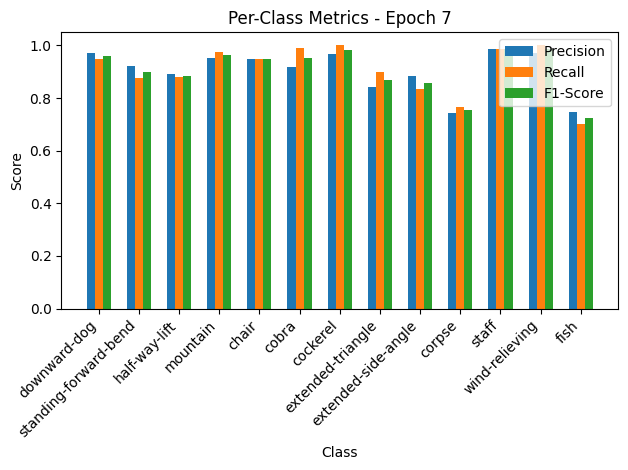

Validation: 100%|██████████| 10/10 [00:00<00:00, 26.91it/s, loss=0.281, accuracy=89.7]


Per-Class Metrics for Epoch 7:
downward-dog: Precision=0.97, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.92, Recall=0.88, F1-Score=0.90
half-way-lift: Precision=0.89, Recall=0.88, F1-Score=0.89
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.95, Recall=0.95, F1-Score=0.95
cobra: Precision=0.92, Recall=0.99, F1-Score=0.95
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.84, Recall=0.90, F1-Score=0.87
extended-side-angle: Precision=0.88, Recall=0.84, F1-Score=0.86
corpse: Precision=0.74, Recall=0.76, F1-Score=0.75
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=1.00, F1-Score=0.99
fish: Precision=0.75, Recall=0.70, F1-Score=0.72


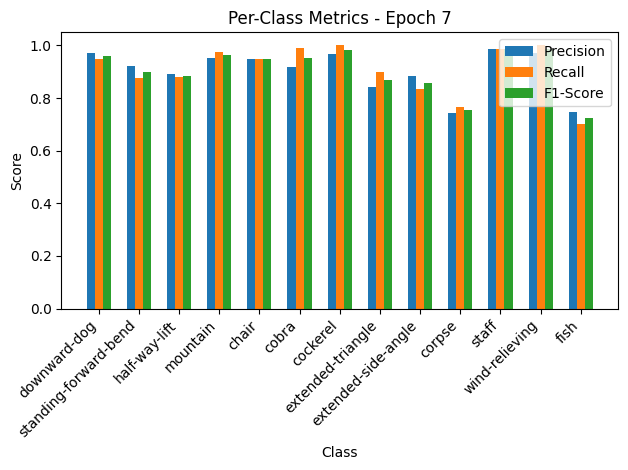


Epoch 8/50 Summary:
Train Loss: 0.3101 | Train Acc: 91.37% | Train Precision: 0.90 | Train Recall: 0.91 | Train F1: 0.91
Val Loss: 0.3076 | Val Acc: 89.73% | Val Precision: 0.92 | Val Recall: 0.89 | Val F1: 0.89

Epoch 9/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  6.90it/s, loss=0.26, accuracy=92.5]


Per-Class Metrics for Epoch 8:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.92, Recall=0.88, F1-Score=0.90
half-way-lift: Precision=0.87, Recall=0.90, F1-Score=0.89
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.97, Recall=0.92, F1-Score=0.94
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.90, Recall=0.94, F1-Score=0.92
extended-side-angle: Precision=0.92, Recall=0.89, F1-Score=0.90
corpse: Precision=0.85, Recall=0.74, F1-Score=0.79
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.77, Recall=0.85, F1-Score=0.81


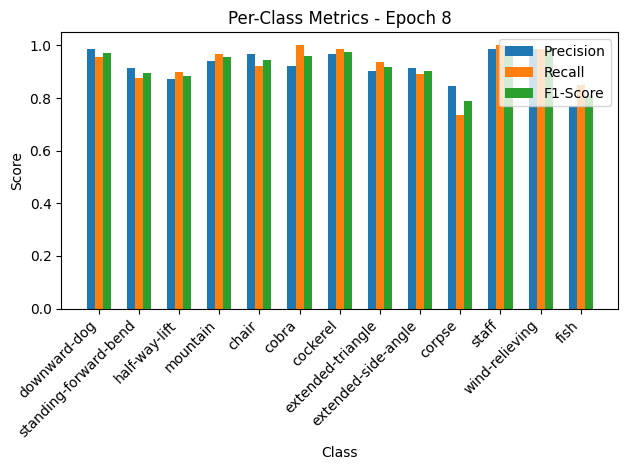

Validation: 100%|██████████| 10/10 [00:00<00:00, 28.74it/s, loss=0.211, accuracy=94.5]


Per-Class Metrics for Epoch 8:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.92, Recall=0.88, F1-Score=0.90
half-way-lift: Precision=0.87, Recall=0.90, F1-Score=0.89
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.97, Recall=0.92, F1-Score=0.94
cobra: Precision=0.92, Recall=1.00, F1-Score=0.96
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.90, Recall=0.94, F1-Score=0.92
extended-side-angle: Precision=0.92, Recall=0.89, F1-Score=0.90
corpse: Precision=0.85, Recall=0.74, F1-Score=0.79
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.77, Recall=0.85, F1-Score=0.81


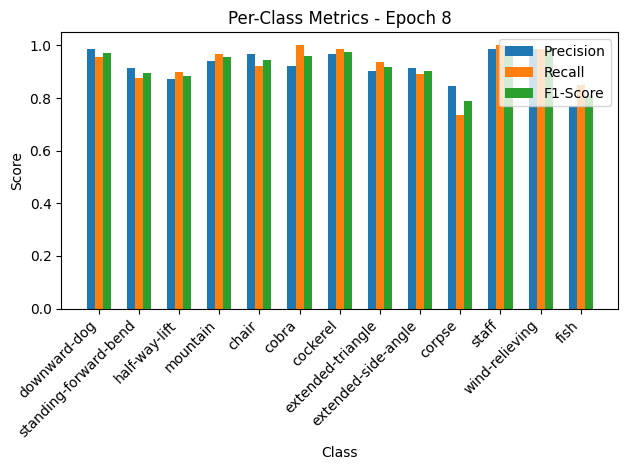


Epoch 9/50 Summary:
Train Loss: 0.2601 | Train Acc: 92.51% | Train Precision: 0.92 | Train Recall: 0.92 | Train F1: 0.92
Val Loss: 0.2312 | Val Acc: 94.52% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.93

Epoch 10/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.55it/s, loss=0.256, accuracy=92.8]


Per-Class Metrics for Epoch 9:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.92, Recall=0.96, F1-Score=0.94
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.94, Recall=0.95, F1-Score=0.95
cobra: Precision=0.95, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.98, Recall=0.98, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.90, F1-Score=0.93
extended-side-angle: Precision=0.90, Recall=0.97, F1-Score=0.93
corpse: Precision=0.72, Recall=0.69, F1-Score=0.71
staff: Precision=0.96, Recall=1.00, F1-Score=0.98
wind-relieving: Precision=0.96, Recall=0.99, F1-Score=0.97
fish: Precision=0.72, Recall=0.73, F1-Score=0.73


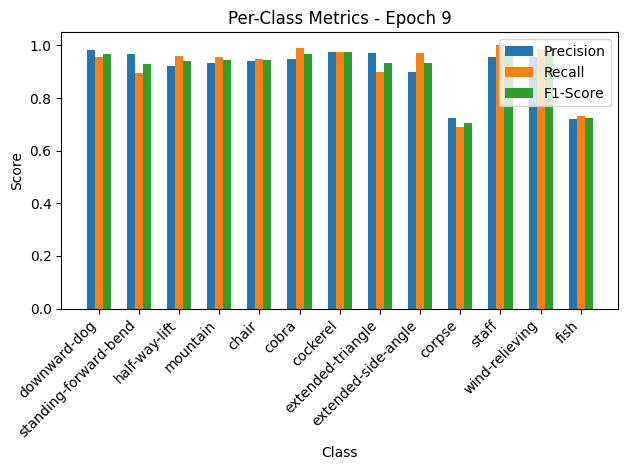

Validation: 100%|██████████| 10/10 [00:00<00:00, 25.75it/s, loss=0.207, accuracy=93.2]


Per-Class Metrics for Epoch 9:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.92, Recall=0.96, F1-Score=0.94
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.94, Recall=0.95, F1-Score=0.95
cobra: Precision=0.95, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.98, Recall=0.98, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.90, F1-Score=0.93
extended-side-angle: Precision=0.90, Recall=0.97, F1-Score=0.93
corpse: Precision=0.72, Recall=0.69, F1-Score=0.71
staff: Precision=0.96, Recall=1.00, F1-Score=0.98
wind-relieving: Precision=0.96, Recall=0.99, F1-Score=0.97
fish: Precision=0.72, Recall=0.73, F1-Score=0.73


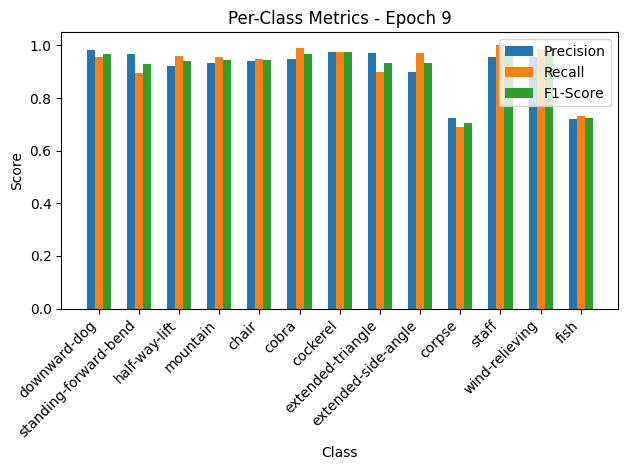


Epoch 10/50 Summary:
Train Loss: 0.2569 | Train Acc: 92.82% | Train Precision: 0.92 | Train Recall: 0.92 | Train F1: 0.92
Val Loss: 0.2270 | Val Acc: 93.15% | Val Precision: 0.94 | Val Recall: 0.93 | Val F1: 0.93

Epoch 11/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.62it/s, loss=0.233, accuracy=93.1]


Per-Class Metrics for Epoch 10:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.95, Recall=0.88, F1-Score=0.91
half-way-lift: Precision=0.90, Recall=0.96, F1-Score=0.93
mountain: Precision=0.93, Recall=0.95, F1-Score=0.94
chair: Precision=0.94, Recall=0.92, F1-Score=0.93
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.93, Recall=0.97, F1-Score=0.95
extended-triangle: Precision=0.91, Recall=0.90, F1-Score=0.90
extended-side-angle: Precision=0.89, Recall=0.90, F1-Score=0.90
corpse: Precision=0.85, Recall=0.82, F1-Score=0.84
staff: Precision=0.97, Recall=0.99, F1-Score=0.98
wind-relieving: Precision=1.00, Recall=0.96, F1-Score=0.98
fish: Precision=0.80, Recall=0.85, F1-Score=0.83


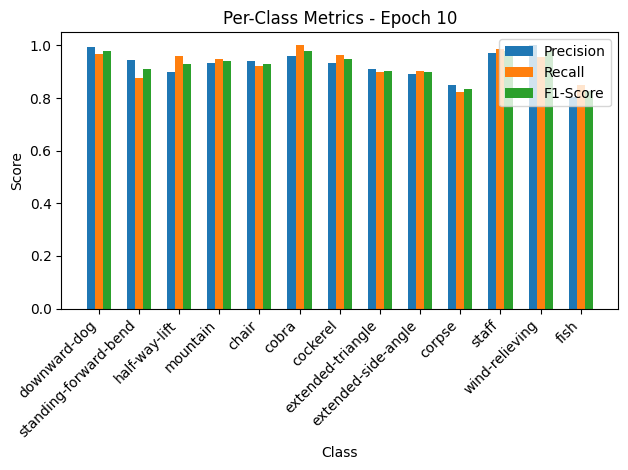

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.30it/s, loss=0.182, accuracy=93.2]


Per-Class Metrics for Epoch 10:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.95, Recall=0.88, F1-Score=0.91
half-way-lift: Precision=0.90, Recall=0.96, F1-Score=0.93
mountain: Precision=0.93, Recall=0.95, F1-Score=0.94
chair: Precision=0.94, Recall=0.92, F1-Score=0.93
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.93, Recall=0.97, F1-Score=0.95
extended-triangle: Precision=0.91, Recall=0.90, F1-Score=0.90
extended-side-angle: Precision=0.89, Recall=0.90, F1-Score=0.90
corpse: Precision=0.85, Recall=0.82, F1-Score=0.84
staff: Precision=0.97, Recall=0.99, F1-Score=0.98
wind-relieving: Precision=1.00, Recall=0.96, F1-Score=0.98
fish: Precision=0.80, Recall=0.85, F1-Score=0.83


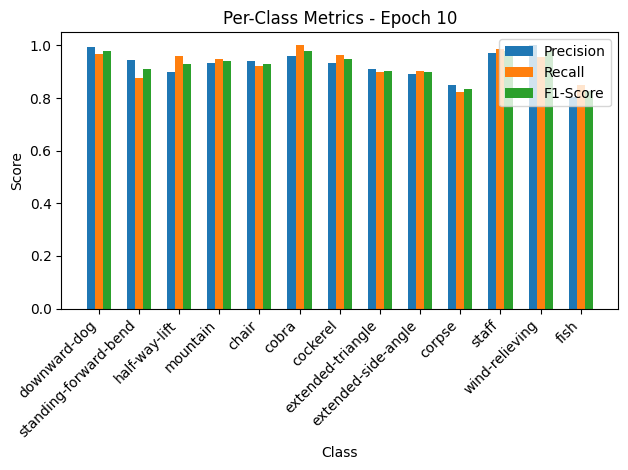


Epoch 11/50 Summary:
Train Loss: 0.2333 | Train Acc: 93.12% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.1990 | Val Acc: 93.15% | Val Precision: 0.94 | Val Recall: 0.92 | Val F1: 0.91

Epoch 12/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.35it/s, loss=0.243, accuracy=94.7]


Per-Class Metrics for Epoch 11:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.98, Recall=0.91, F1-Score=0.95
half-way-lift: Precision=0.92, Recall=0.97, F1-Score=0.94
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.97, Recall=0.96, F1-Score=0.97
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.93, Recall=0.95, F1-Score=0.94
extended-side-angle: Precision=0.93, Recall=0.90, F1-Score=0.92
corpse: Precision=0.87, Recall=0.79, F1-Score=0.83
staff: Precision=0.97, Recall=0.99, F1-Score=0.98
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.81, Recall=0.87, F1-Score=0.83


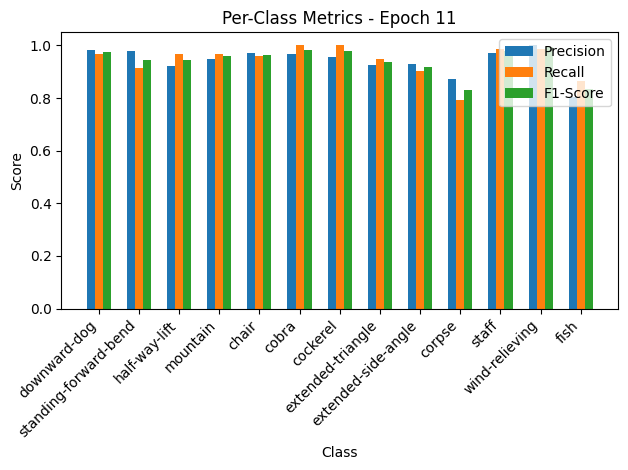

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.44it/s, loss=0.226, accuracy=92.5]


Per-Class Metrics for Epoch 11:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.98, Recall=0.91, F1-Score=0.95
half-way-lift: Precision=0.92, Recall=0.97, F1-Score=0.94
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.97, Recall=0.96, F1-Score=0.97
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.93, Recall=0.95, F1-Score=0.94
extended-side-angle: Precision=0.93, Recall=0.90, F1-Score=0.92
corpse: Precision=0.87, Recall=0.79, F1-Score=0.83
staff: Precision=0.97, Recall=0.99, F1-Score=0.98
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.81, Recall=0.87, F1-Score=0.83


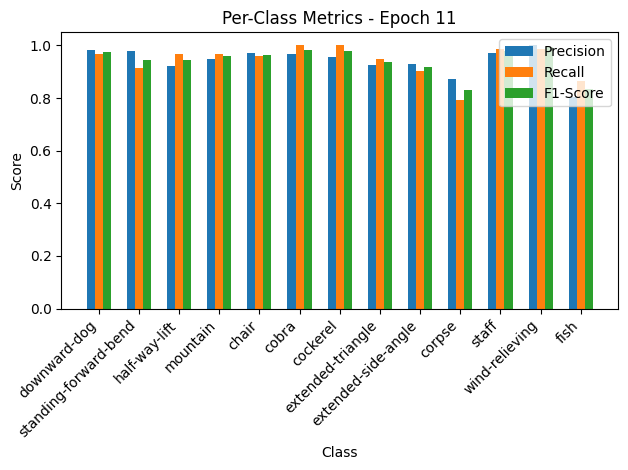


Epoch 12/50 Summary:
Train Loss: 0.2438 | Train Acc: 94.73% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.2480 | Val Acc: 92.47% | Val Precision: 0.94 | Val Recall: 0.93 | Val F1: 0.93

Epoch 13/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  6.93it/s, loss=0.154, accuracy=96.5]


Per-Class Metrics for Epoch 12:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.90, F1-Score=0.94
half-way-lift: Precision=0.91, Recall=0.99, F1-Score=0.95
mountain: Precision=0.95, Recall=0.98, F1-Score=0.97
chair: Precision=1.00, Recall=0.95, F1-Score=0.97
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.97, Recall=0.97, F1-Score=0.97
corpse: Precision=0.92, Recall=0.90, F1-Score=0.91
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.90, Recall=0.90, F1-Score=0.90


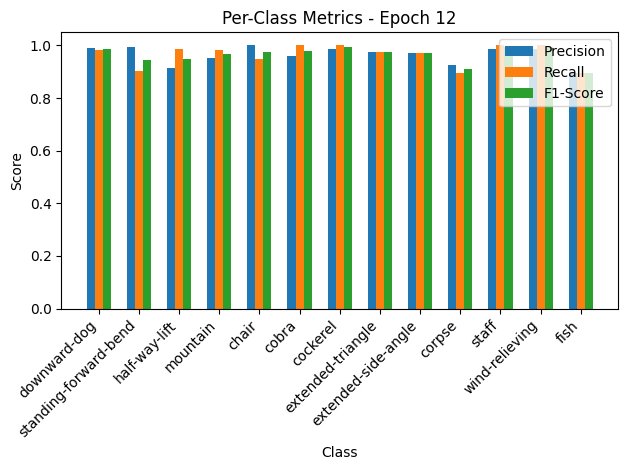

Validation: 100%|██████████| 10/10 [00:00<00:00, 28.51it/s, loss=0.0873, accuracy=97.3]


Per-Class Metrics for Epoch 12:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.90, F1-Score=0.94
half-way-lift: Precision=0.91, Recall=0.99, F1-Score=0.95
mountain: Precision=0.95, Recall=0.98, F1-Score=0.97
chair: Precision=1.00, Recall=0.95, F1-Score=0.97
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.97, Recall=0.97, F1-Score=0.97
corpse: Precision=0.92, Recall=0.90, F1-Score=0.91
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.90, Recall=0.90, F1-Score=0.90


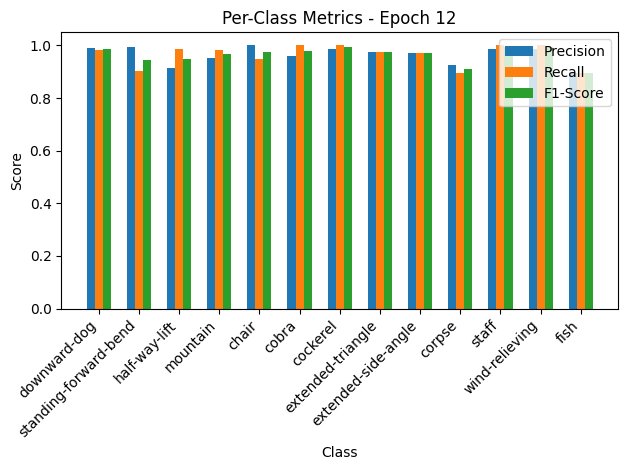


Epoch 13/50 Summary:
Train Loss: 0.1544 | Train Acc: 96.49% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.0957 | Val Acc: 97.26% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_3.pth
Checkpoint saved at epoch 13
New best model saved! Validation Loss: 0.0957

Epoch 14/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.01it/s, loss=0.124, accuracy=97.3]


Per-Class Metrics for Epoch 13:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.98, Recall=0.97, F1-Score=0.98
chair: Precision=0.96, Recall=0.98, F1-Score=0.97
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.93, Recall=0.97, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.93, F1-Score=0.95


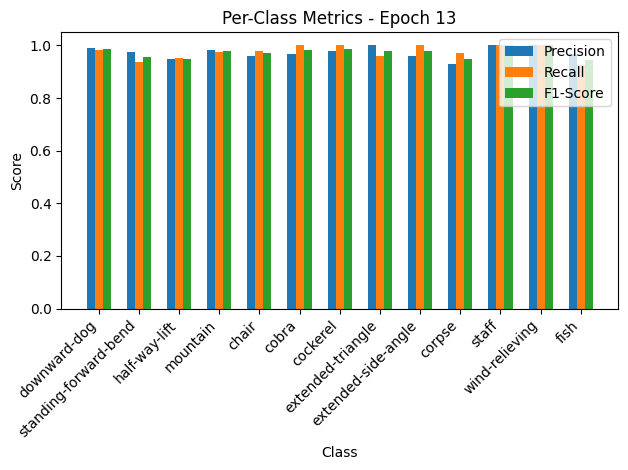

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.89it/s, loss=0.0793, accuracy=97.3]


Per-Class Metrics for Epoch 13:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.98, Recall=0.97, F1-Score=0.98
chair: Precision=0.96, Recall=0.98, F1-Score=0.97
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.93, Recall=0.97, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.93, F1-Score=0.95


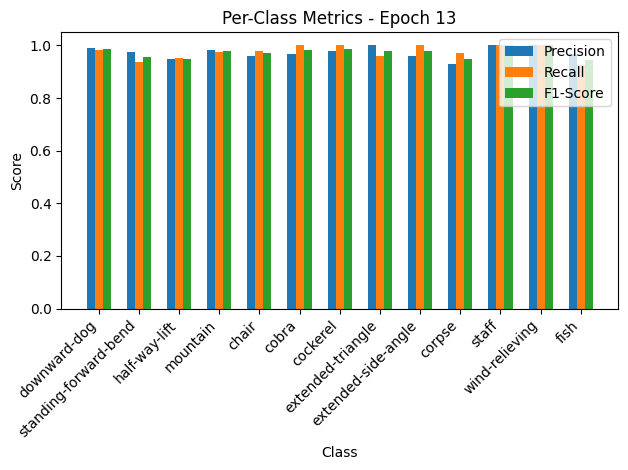


Epoch 14/50 Summary:
Train Loss: 0.1246 | Train Acc: 97.33% | Train Precision: 0.97 | Train Recall: 0.98 | Train F1: 0.97
Val Loss: 0.0869 | Val Acc: 97.26% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_3.pth
Checkpoint saved at epoch 14
New best model saved! Validation Loss: 0.0869

Epoch 15/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  6.99it/s, loss=0.112, accuracy=97.2]


Per-Class Metrics for Epoch 14:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.93, F1-Score=0.95
half-way-lift: Precision=0.94, Recall=0.97, F1-Score=0.95
mountain: Precision=0.97, Recall=0.98, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.96, Recall=0.96, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.97, F1-Score=0.99
fish: Precision=0.96, Recall=0.96, F1-Score=0.96


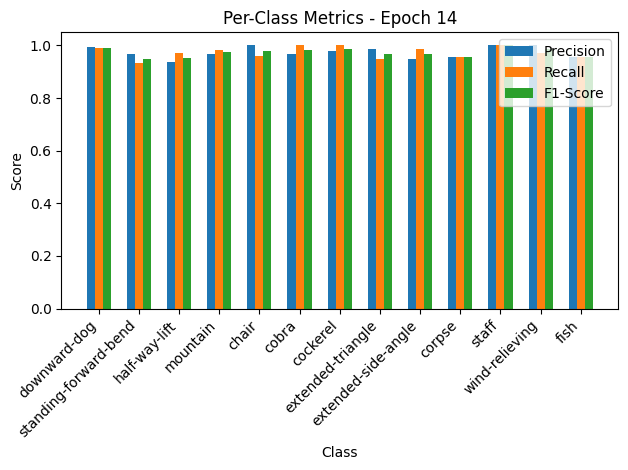

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.19it/s, loss=0.0885, accuracy=97.9]


Per-Class Metrics for Epoch 14:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.93, F1-Score=0.95
half-way-lift: Precision=0.94, Recall=0.97, F1-Score=0.95
mountain: Precision=0.97, Recall=0.98, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.96, Recall=0.96, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.97, F1-Score=0.99
fish: Precision=0.96, Recall=0.96, F1-Score=0.96


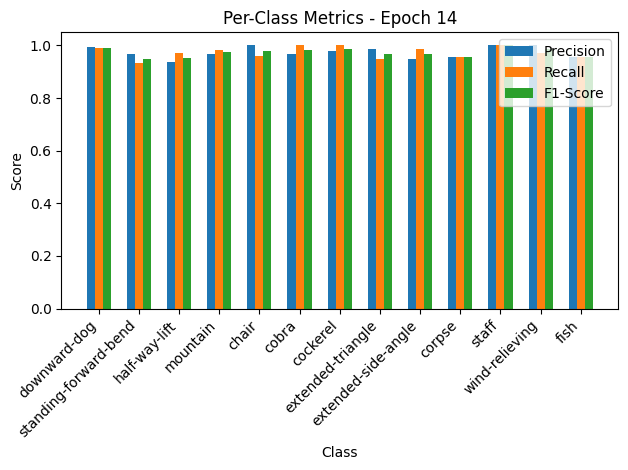


Epoch 15/50 Summary:
Train Loss: 0.1118 | Train Acc: 97.25% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.0970 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 16/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  6.90it/s, loss=0.112, accuracy=97.2]


Per-Class Metrics for Epoch 15:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.95, Recall=0.97, F1-Score=0.96
mountain: Precision=0.96, Recall=0.99, F1-Score=0.98
chair: Precision=0.99, Recall=0.96, F1-Score=0.97
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.90, Recall=0.96, F1-Score=0.93
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.95, Recall=0.90, F1-Score=0.92


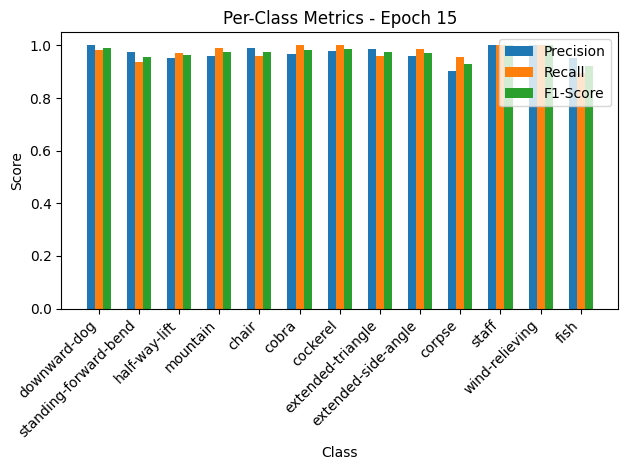

Validation: 100%|██████████| 10/10 [00:00<00:00, 26.30it/s, loss=0.0949, accuracy=96.6]


Per-Class Metrics for Epoch 15:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.95, Recall=0.97, F1-Score=0.96
mountain: Precision=0.96, Recall=0.99, F1-Score=0.98
chair: Precision=0.99, Recall=0.96, F1-Score=0.97
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.90, Recall=0.96, F1-Score=0.93
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.95, Recall=0.90, F1-Score=0.92


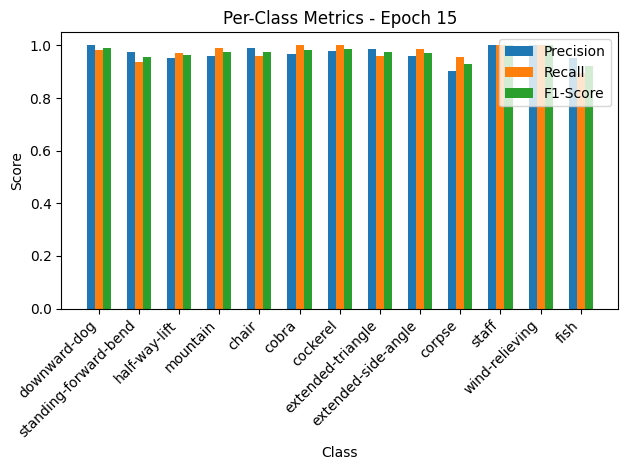


Epoch 16/50 Summary:
Train Loss: 0.1119 | Train Acc: 97.25% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.1040 | Val Acc: 96.58% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 17/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.17it/s, loss=0.102, accuracy=97.8]


Per-Class Metrics for Epoch 16:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.95, Recall=0.99, F1-Score=0.97
mountain: Precision=0.97, Recall=0.98, F1-Score=0.98
chair: Precision=0.99, Recall=0.98, F1-Score=0.99
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.96, Recall=0.96, F1-Score=0.96
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.95, Recall=0.94, F1-Score=0.95


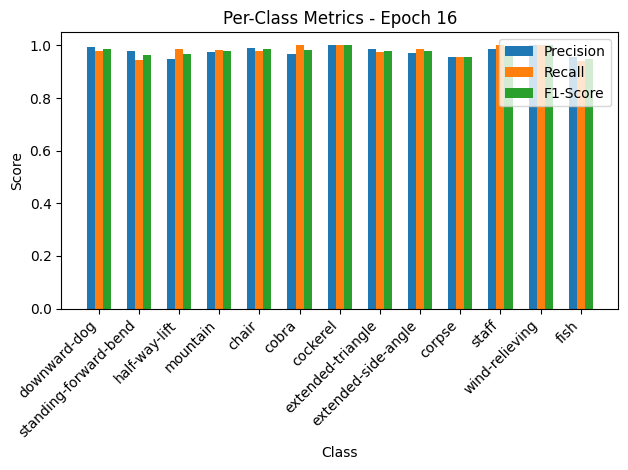

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.61it/s, loss=0.0764, accuracy=96.6]


Per-Class Metrics for Epoch 16:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.95, Recall=0.99, F1-Score=0.97
mountain: Precision=0.97, Recall=0.98, F1-Score=0.98
chair: Precision=0.99, Recall=0.98, F1-Score=0.99
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.96, Recall=0.96, F1-Score=0.96
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.95, Recall=0.94, F1-Score=0.95


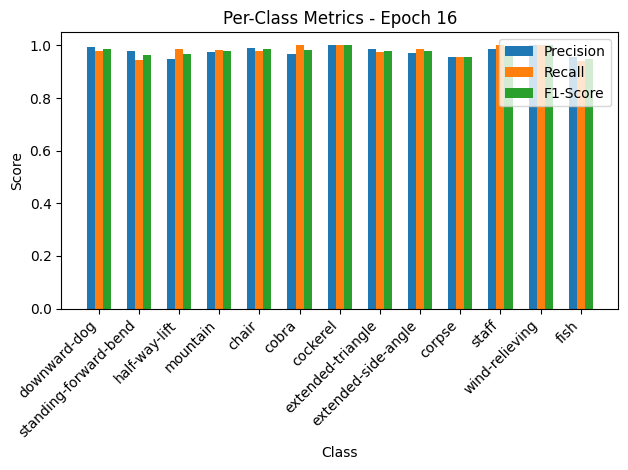


Epoch 17/50 Summary:
Train Loss: 0.1022 | Train Acc: 97.78% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.0837 | Val Acc: 96.58% | Val Precision: 0.97 | Val Recall: 0.96 | Val F1: 0.96
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_3.pth
Checkpoint saved at epoch 17
New best model saved! Validation Loss: 0.0837

Epoch 18/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.56it/s, loss=0.103, accuracy=98]


Per-Class Metrics for Epoch 17:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.96, Recall=0.99, F1-Score=0.97
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.96, Recall=0.96, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.96, Recall=0.96, F1-Score=0.96


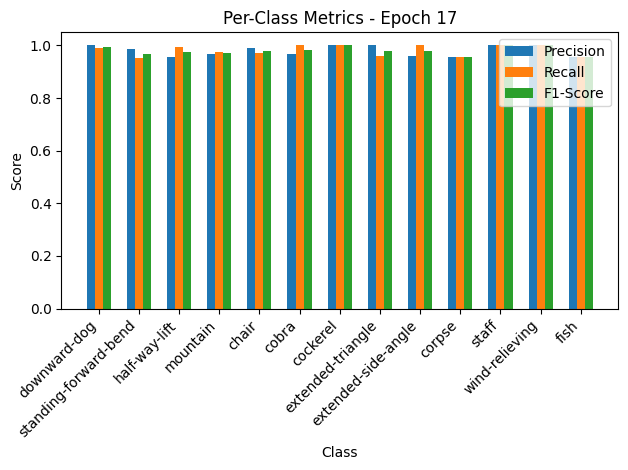

Validation: 100%|██████████| 10/10 [00:00<00:00, 20.95it/s, loss=0.0814, accuracy=95.9]


Per-Class Metrics for Epoch 17:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.96, Recall=0.99, F1-Score=0.97
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.96, Recall=0.96, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.96, Recall=0.96, F1-Score=0.96


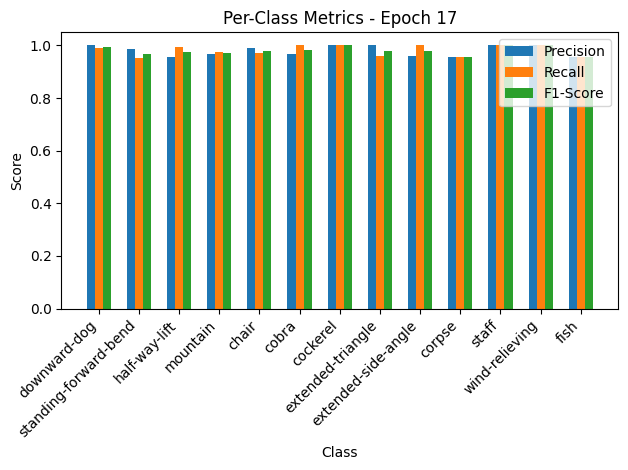


Epoch 18/50 Summary:
Train Loss: 0.1029 | Train Acc: 98.01% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.0893 | Val Acc: 95.89% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 19/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.83it/s, loss=0.104, accuracy=97.6]


Per-Class Metrics for Epoch 18:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.95, F1-Score=0.96
half-way-lift: Precision=0.95, Recall=0.97, F1-Score=0.96
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.97, Recall=0.93, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.97, F1-Score=0.95


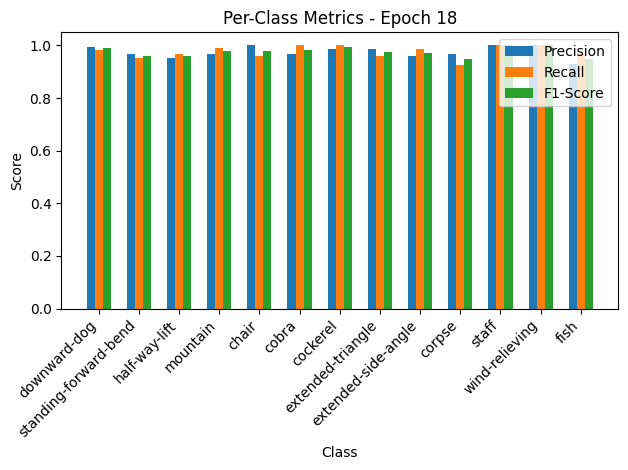

Validation: 100%|██████████| 10/10 [00:00<00:00, 28.12it/s, loss=0.0763, accuracy=97.3]


Per-Class Metrics for Epoch 18:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.95, F1-Score=0.96
half-way-lift: Precision=0.95, Recall=0.97, F1-Score=0.96
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.97, Recall=0.93, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.97, F1-Score=0.95


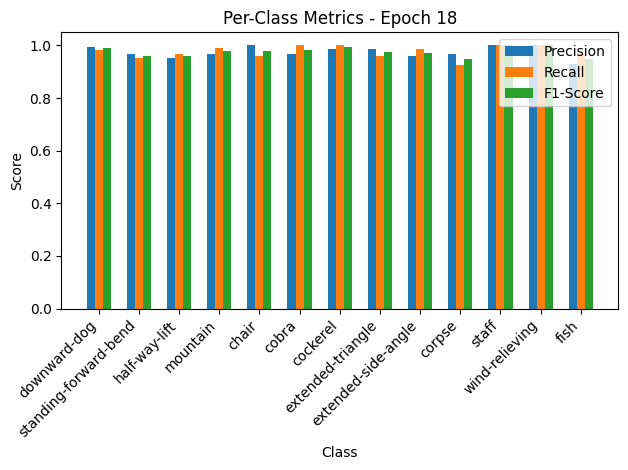


Epoch 19/50 Summary:
Train Loss: 0.1039 | Train Acc: 97.56% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.0836 | Val Acc: 97.26% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_3.pth
Checkpoint saved at epoch 19
New best model saved! Validation Loss: 0.0836

Epoch 20/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.52it/s, loss=0.096, accuracy=98]


Per-Class Metrics for Epoch 19:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.93, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.99, F1-Score=0.96
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=0.99, Recall=0.96, F1-Score=0.97
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.94, Recall=1.00, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.94, F1-Score=0.97


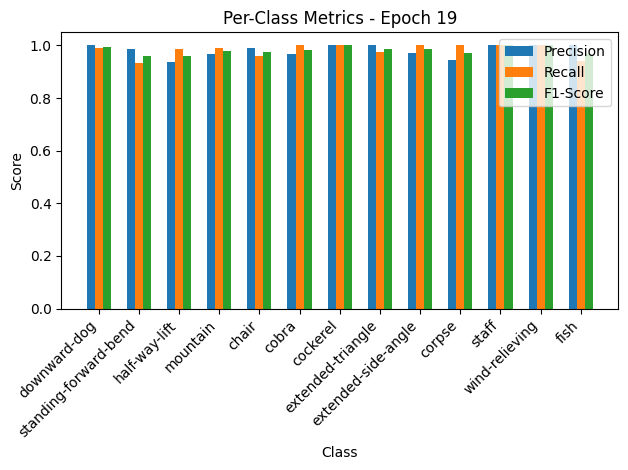

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.66it/s, loss=0.0852, accuracy=97.9]


Per-Class Metrics for Epoch 19:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.93, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.99, F1-Score=0.96
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=0.99, Recall=0.96, F1-Score=0.97
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.94, Recall=1.00, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.94, F1-Score=0.97


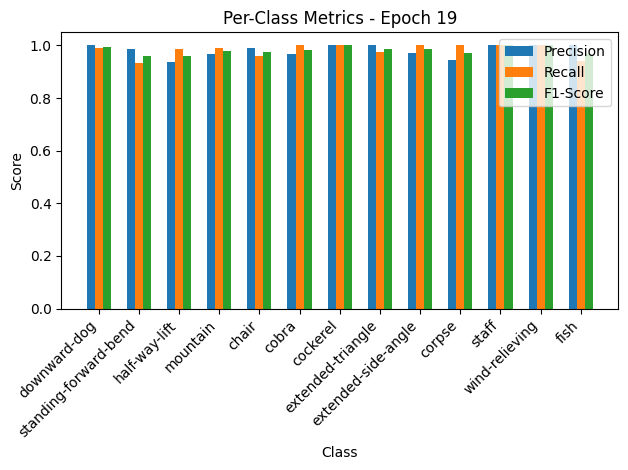


Epoch 20/50 Summary:
Train Loss: 0.0963 | Train Acc: 98.01% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.0933 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 21/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.29it/s, loss=0.103, accuracy=97.9]


Per-Class Metrics for Epoch 20:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.96, Recall=0.99, F1-Score=0.97
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.96, Recall=0.94, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.96, F1-Score=0.95


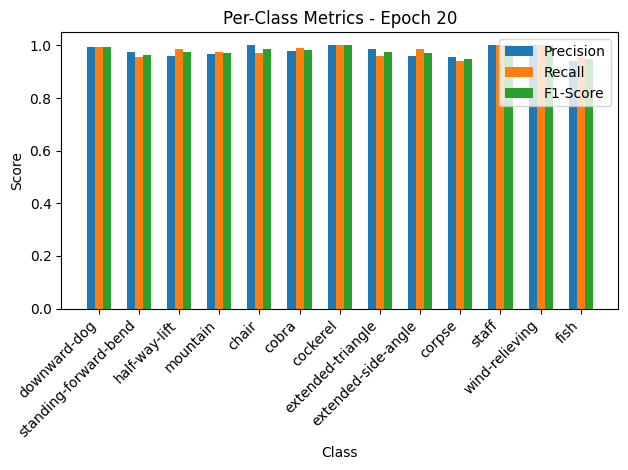

Validation: 100%|██████████| 10/10 [00:00<00:00, 28.91it/s, loss=0.0895, accuracy=97.3]


Per-Class Metrics for Epoch 20:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.96, Recall=0.99, F1-Score=0.97
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.96, Recall=0.94, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.96, F1-Score=0.95


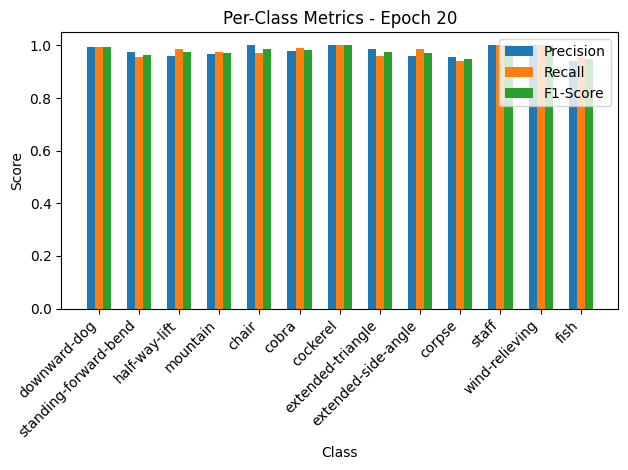


Epoch 21/50 Summary:
Train Loss: 0.1028 | Train Acc: 97.86% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.0981 | Val Acc: 97.26% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 22/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.09it/s, loss=0.0867, accuracy=98.5]


Per-Class Metrics for Epoch 21:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.97, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.98, F1-Score=0.97
mountain: Precision=0.98, Recall=0.98, F1-Score=0.98
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.99, Recall=0.99, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.99, Recall=0.99, F1-Score=0.99


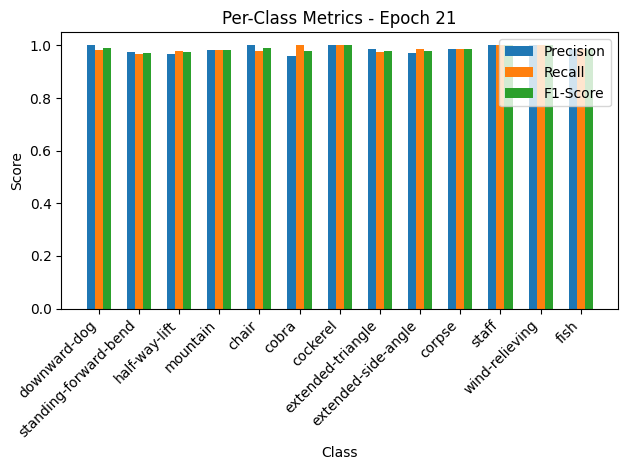

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.48it/s, loss=0.0781, accuracy=97.3]


Per-Class Metrics for Epoch 21:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.97, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.98, F1-Score=0.97
mountain: Precision=0.98, Recall=0.98, F1-Score=0.98
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.99, Recall=0.99, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.99, Recall=0.99, F1-Score=0.99


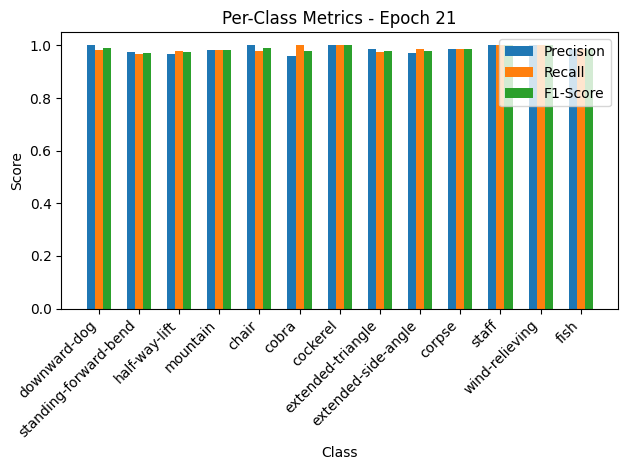


Epoch 22/50 Summary:
Train Loss: 0.0869 | Train Acc: 98.47% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0856 | Val Acc: 97.26% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 23/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.38it/s, loss=0.087, accuracy=98.5]


Per-Class Metrics for Epoch 22:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.96, Recall=0.99, F1-Score=0.97
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.96, Recall=1.00, F1-Score=0.98
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.96, F1-Score=0.97


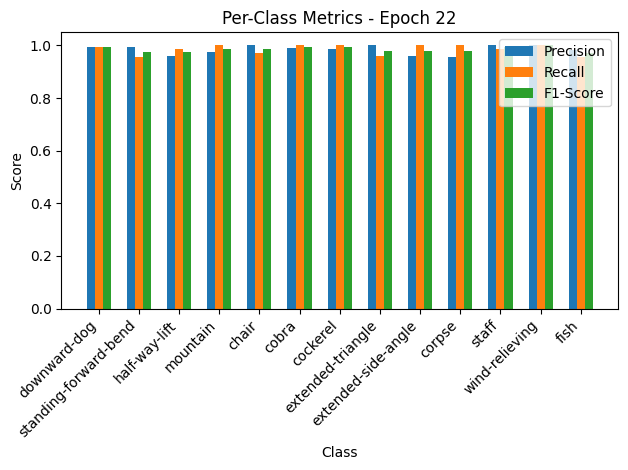

Validation: 100%|██████████| 10/10 [00:00<00:00, 25.73it/s, loss=0.0859, accuracy=97.9]


Per-Class Metrics for Epoch 22:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.96, Recall=0.99, F1-Score=0.97
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.96, Recall=1.00, F1-Score=0.98
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.96, F1-Score=0.97


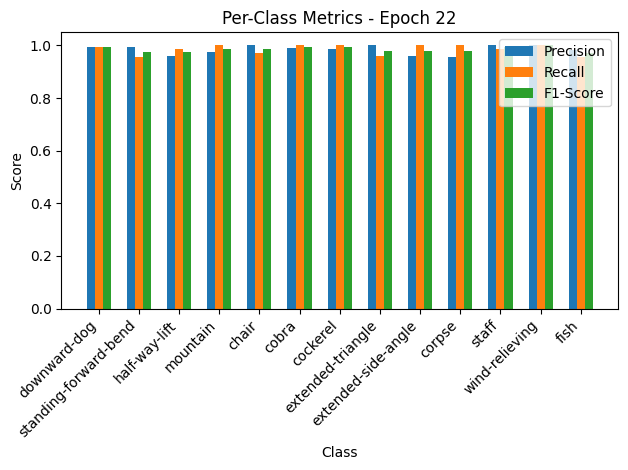


Epoch 23/50 Summary:
Train Loss: 0.0872 | Train Acc: 98.47% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0942 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 24/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.91it/s, loss=0.088, accuracy=98.1]


Per-Class Metrics for Epoch 23:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.95, Recall=0.99, F1-Score=0.97
mountain: Precision=0.98, Recall=0.98, F1-Score=0.98
chair: Precision=0.98, Recall=0.98, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.97, Recall=0.99, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.97, F1-Score=0.98


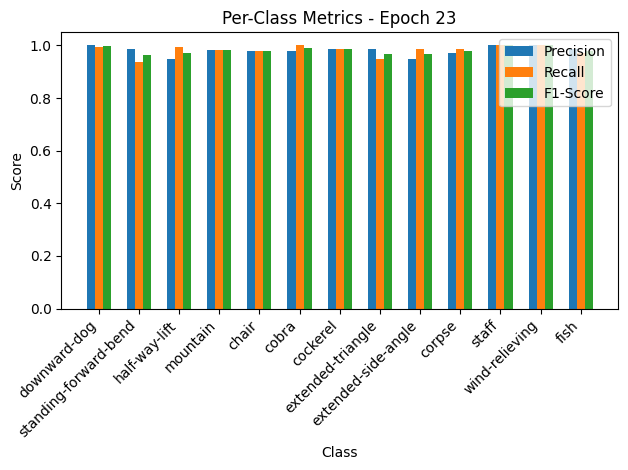

Validation: 100%|██████████| 10/10 [00:00<00:00, 21.21it/s, loss=0.0757, accuracy=97.9]


Per-Class Metrics for Epoch 23:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.95, Recall=0.99, F1-Score=0.97
mountain: Precision=0.98, Recall=0.98, F1-Score=0.98
chair: Precision=0.98, Recall=0.98, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.97, Recall=0.99, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.97, F1-Score=0.98


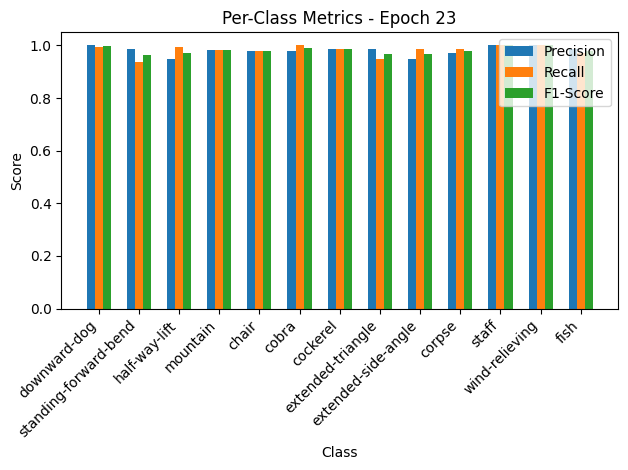


Epoch 24/50 Summary:
Train Loss: 0.0882 | Train Acc: 98.09% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.0829 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_3.pth
Checkpoint saved at epoch 24
New best model saved! Validation Loss: 0.0829

Epoch 25/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.51it/s, loss=0.0808, accuracy=98.4]


Per-Class Metrics for Epoch 24:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.98, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.96, Recall=0.99, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.96, F1-Score=0.97


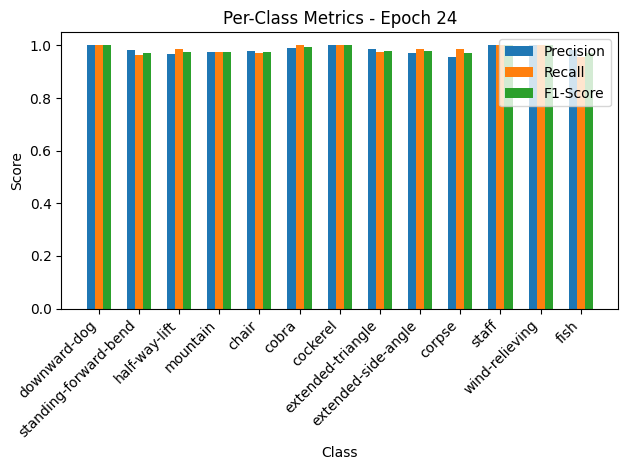

Validation: 100%|██████████| 10/10 [00:00<00:00, 28.63it/s, loss=0.0763, accuracy=97.3]


Per-Class Metrics for Epoch 24:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.98, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.96, Recall=0.99, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.96, F1-Score=0.97


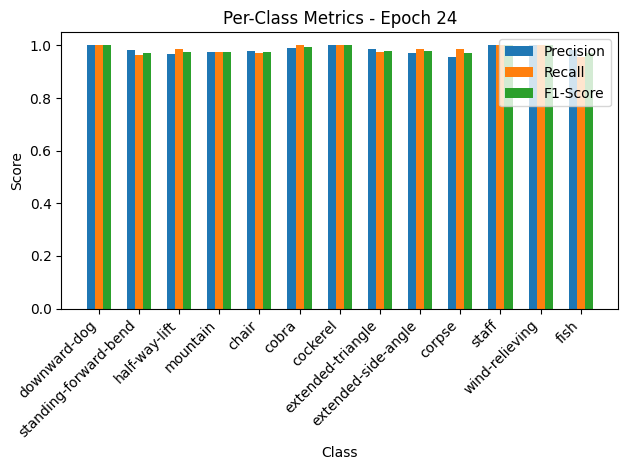


Epoch 25/50 Summary:
Train Loss: 0.0810 | Train Acc: 98.40% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.0836 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 26/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.04it/s, loss=0.0848, accuracy=98.1]


Per-Class Metrics for Epoch 25:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.97, Recall=0.98, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.96, F1-Score=0.97
mountain: Precision=0.97, Recall=0.98, F1-Score=0.97
chair: Precision=0.98, Recall=0.96, F1-Score=0.97
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.94, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.97, F1-Score=0.96


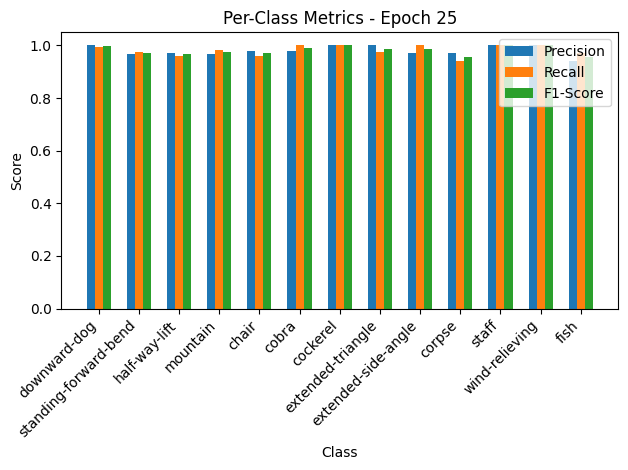

Validation: 100%|██████████| 10/10 [00:00<00:00, 26.55it/s, loss=0.0732, accuracy=97.3]


Per-Class Metrics for Epoch 25:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.97, Recall=0.98, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.96, F1-Score=0.97
mountain: Precision=0.97, Recall=0.98, F1-Score=0.97
chair: Precision=0.98, Recall=0.96, F1-Score=0.97
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.94, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.97, F1-Score=0.96


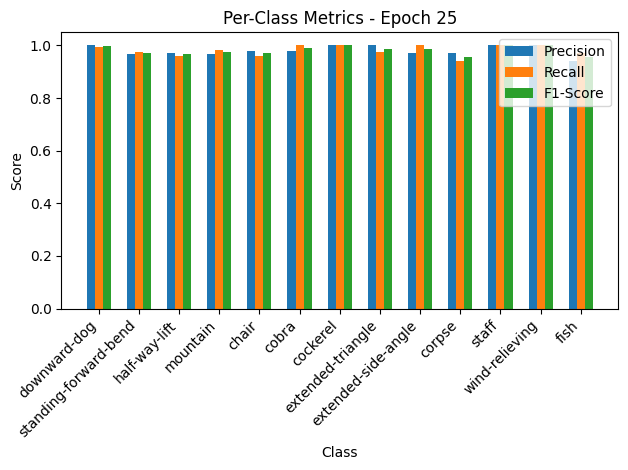


Epoch 26/50 Summary:
Train Loss: 0.0850 | Train Acc: 98.09% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.0802 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.97 | Val F1: 0.97
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_3.pth
Checkpoint saved at epoch 26
New best model saved! Validation Loss: 0.0802

Epoch 27/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:12<00:00,  6.72it/s, loss=0.0761, accuracy=98.5]


Per-Class Metrics for Epoch 26:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.97, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.96, F1-Score=0.97
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.99, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.99, F1-Score=0.99


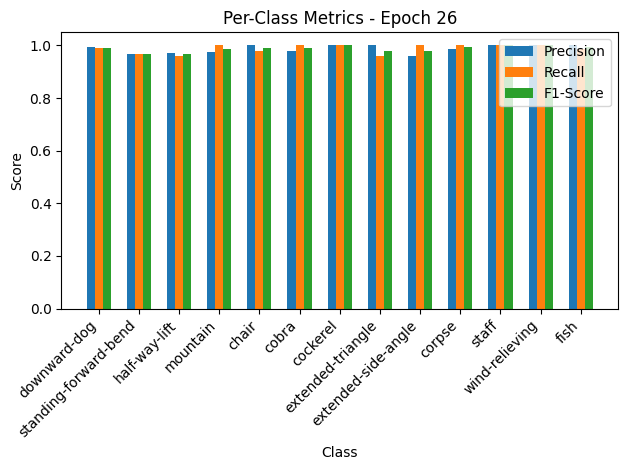

Validation: 100%|██████████| 10/10 [00:00<00:00, 29.09it/s, loss=0.101, accuracy=97.9]


Per-Class Metrics for Epoch 26:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.97, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.96, F1-Score=0.97
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.99, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.99, F1-Score=0.99


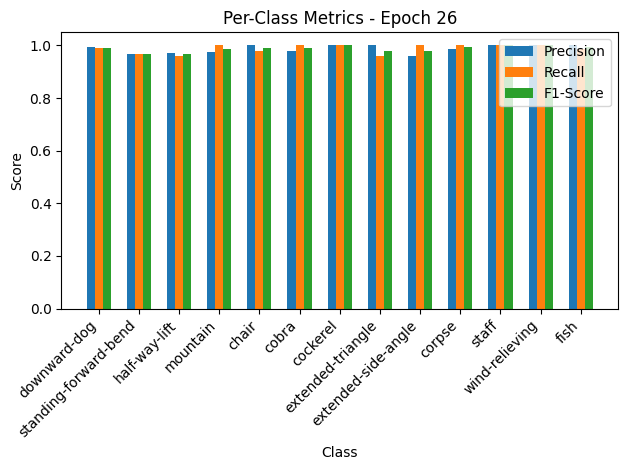


Epoch 27/50 Summary:
Train Loss: 0.0763 | Train Acc: 98.55% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1106 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 28/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  6.96it/s, loss=0.0814, accuracy=98.2]


Per-Class Metrics for Epoch 27:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.96, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=0.98, F1-Score=0.98
chair: Precision=0.99, Recall=0.98, F1-Score=0.99
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.96, Recall=0.99, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.98, Recall=0.97, F1-Score=0.98


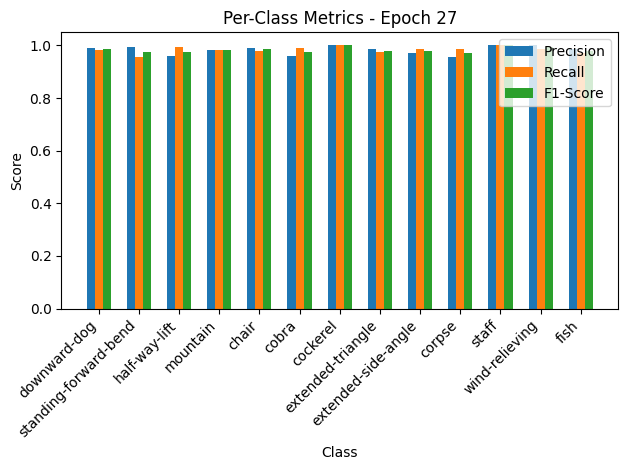

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.02it/s, loss=0.116, accuracy=97.3]


Per-Class Metrics for Epoch 27:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.96, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=0.98, F1-Score=0.98
chair: Precision=0.99, Recall=0.98, F1-Score=0.99
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.96, Recall=0.99, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.98, Recall=0.97, F1-Score=0.98


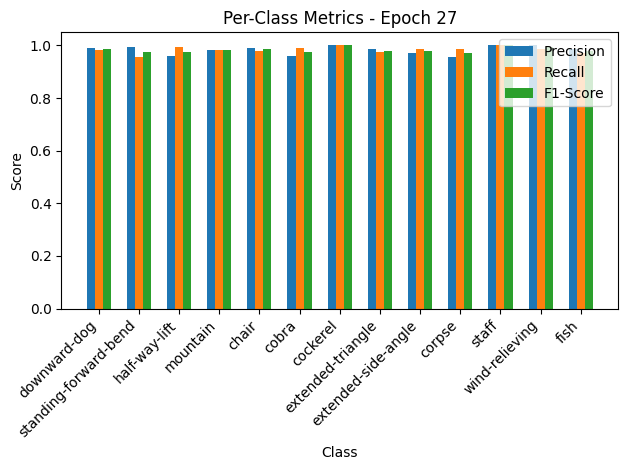


Epoch 28/50 Summary:
Train Loss: 0.0816 | Train Acc: 98.24% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1267 | Val Acc: 97.26% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 29/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.15it/s, loss=0.078, accuracy=98.5]


Per-Class Metrics for Epoch 28:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=1.00, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.96, Recall=1.00, F1-Score=0.98
mountain: Precision=0.98, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.99, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.97, F1-Score=0.98


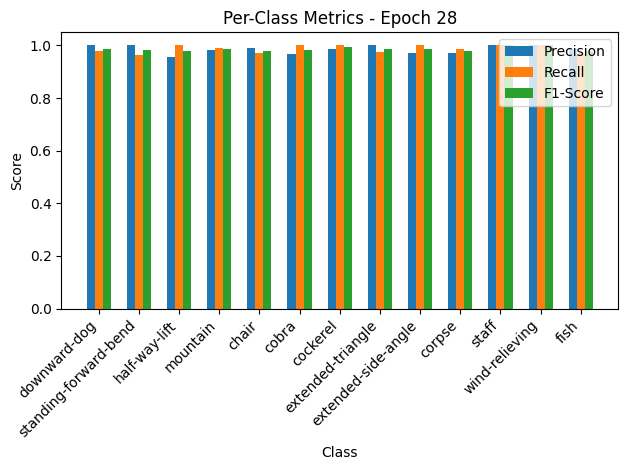

Validation: 100%|██████████| 10/10 [00:00<00:00, 28.51it/s, loss=0.107, accuracy=95.9]


Per-Class Metrics for Epoch 28:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=1.00, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.96, Recall=1.00, F1-Score=0.98
mountain: Precision=0.98, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.99, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.97, F1-Score=0.98


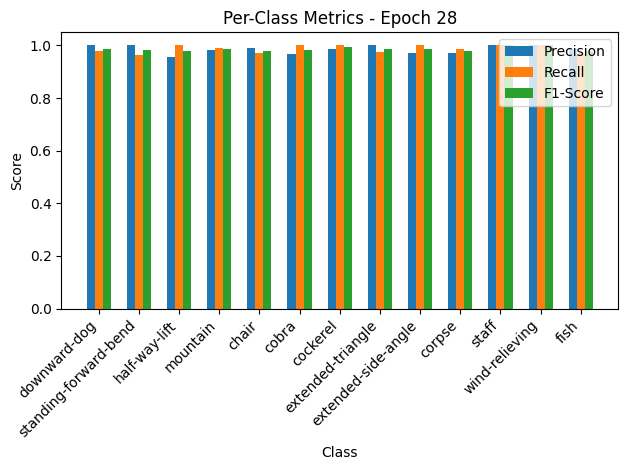


Epoch 29/50 Summary:
Train Loss: 0.0782 | Train Acc: 98.55% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1170 | Val Acc: 95.89% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 30/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.29it/s, loss=0.0834, accuracy=98.5]


Per-Class Metrics for Epoch 29:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=0.98, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.96, Recall=1.00, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.96, F1-Score=0.98


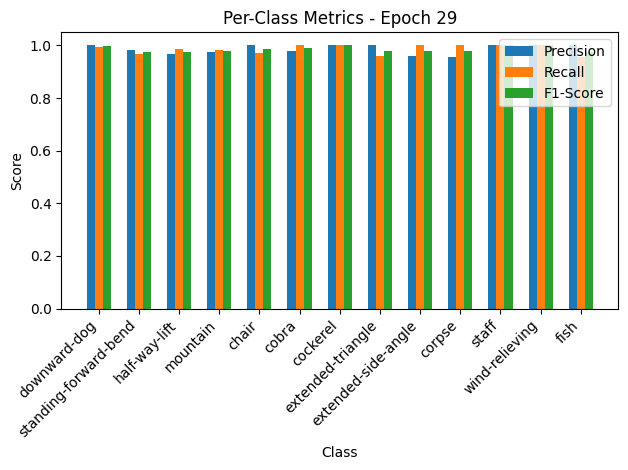

Validation: 100%|██████████| 10/10 [00:00<00:00, 23.73it/s, loss=0.0843, accuracy=97.3]


Per-Class Metrics for Epoch 29:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=0.98, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.96, Recall=1.00, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.96, F1-Score=0.98


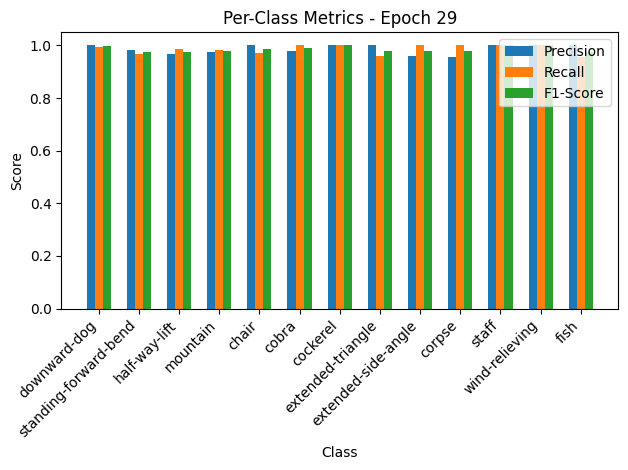


Epoch 30/50 Summary:
Train Loss: 0.0835 | Train Acc: 98.55% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0924 | Val Acc: 97.26% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 31/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.80it/s, loss=0.0784, accuracy=98.2]


Per-Class Metrics for Epoch 30:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.95, Recall=0.99, F1-Score=0.97
mountain: Precision=0.98, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.97, Recall=0.97, F1-Score=0.97
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.97, F1-Score=0.97


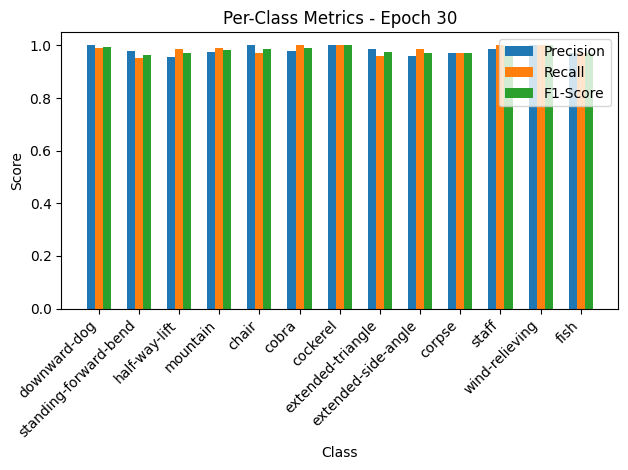

Validation: 100%|██████████| 10/10 [00:00<00:00, 22.73it/s, loss=0.0995, accuracy=97.9]


Per-Class Metrics for Epoch 30:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.95, Recall=0.99, F1-Score=0.97
mountain: Precision=0.98, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.97, Recall=0.97, F1-Score=0.97
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.97, F1-Score=0.97


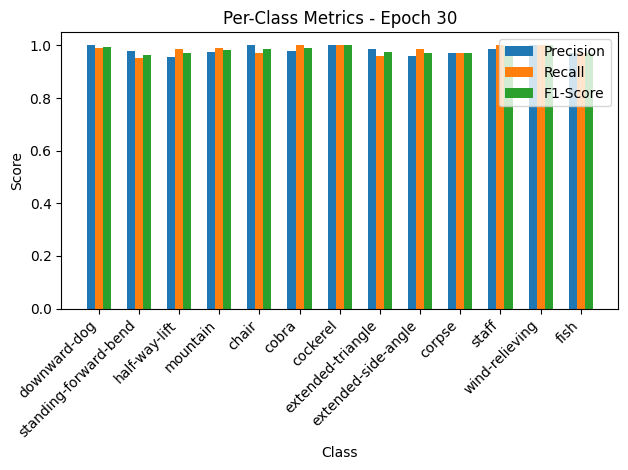


Epoch 31/50 Summary:
Train Loss: 0.0786 | Train Acc: 98.17% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1090 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 32/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.28it/s, loss=0.0862, accuracy=98.5]


Per-Class Metrics for Epoch 31:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.96, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.97, Recall=0.97, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.97, F1-Score=0.98


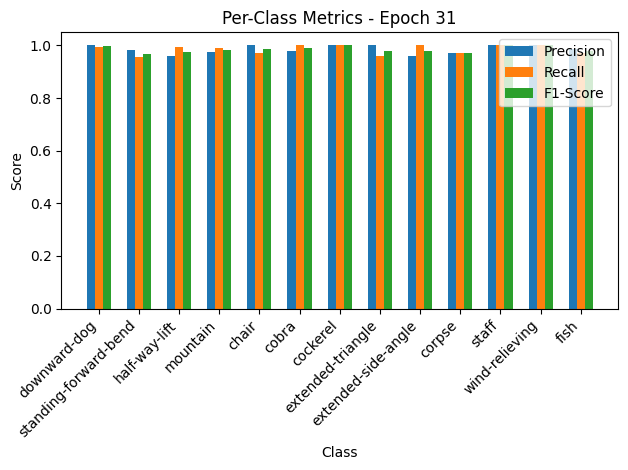

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.07it/s, loss=0.0896, accuracy=97.3]


Per-Class Metrics for Epoch 31:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.98, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.96, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.97, Recall=0.97, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.97, F1-Score=0.98


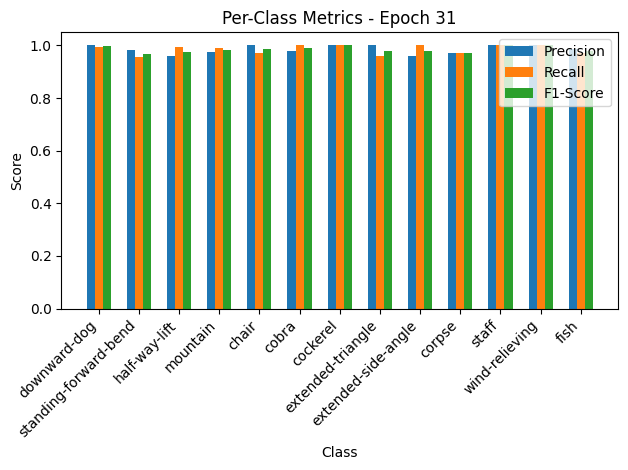


Epoch 32/50 Summary:
Train Loss: 0.0864 | Train Acc: 98.47% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0982 | Val Acc: 97.26% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 33/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:12<00:00,  6.74it/s, loss=0.0795, accuracy=98.2]


Per-Class Metrics for Epoch 32:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.95, Recall=0.98, F1-Score=0.96
mountain: Precision=0.99, Recall=0.99, F1-Score=0.99
chair: Precision=0.98, Recall=0.97, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.96, Recall=0.99, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.96, F1-Score=0.97


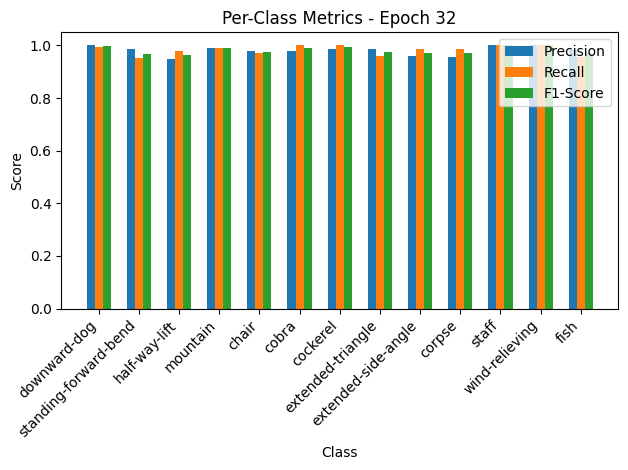

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.55it/s, loss=0.0817, accuracy=97.3]


Per-Class Metrics for Epoch 32:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.95, Recall=0.98, F1-Score=0.96
mountain: Precision=0.99, Recall=0.99, F1-Score=0.99
chair: Precision=0.98, Recall=0.97, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.96, Recall=0.99, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.96, F1-Score=0.97


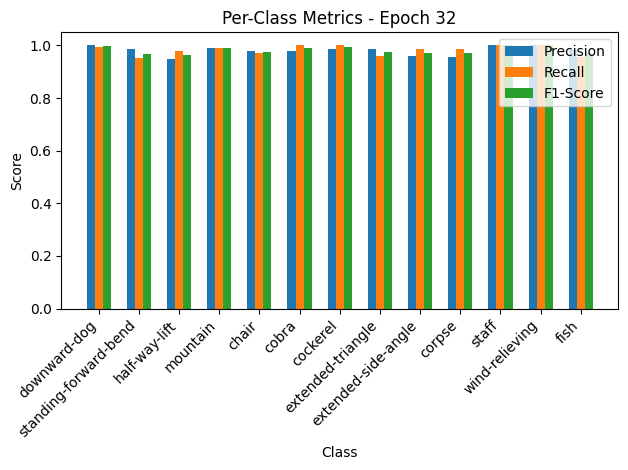


Epoch 33/50 Summary:
Train Loss: 0.0797 | Train Acc: 98.17% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.0895 | Val Acc: 97.26% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 34/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:11<00:00,  7.03it/s, loss=0.0661, accuracy=98.6]


Per-Class Metrics for Epoch 33:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=1.00, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.96, Recall=0.99, F1-Score=0.97
mountain: Precision=0.98, Recall=0.99, F1-Score=0.98
chair: Precision=0.98, Recall=0.96, F1-Score=0.97
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.97, F1-Score=0.98


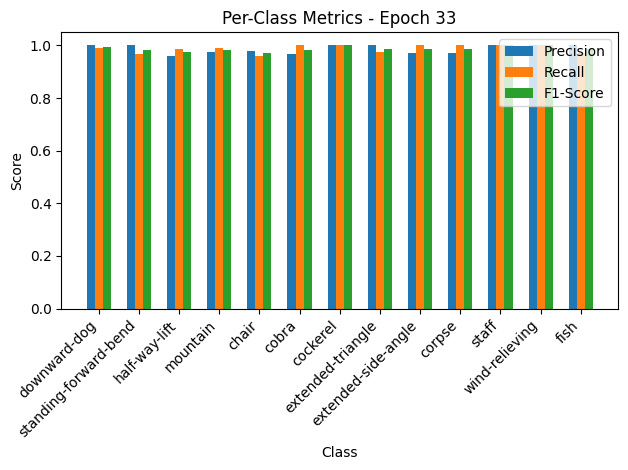

Validation: 100%|██████████| 10/10 [00:00<00:00, 26.06it/s, loss=0.0921, accuracy=97.9]


Per-Class Metrics for Epoch 33:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=1.00, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.96, Recall=0.99, F1-Score=0.97
mountain: Precision=0.98, Recall=0.99, F1-Score=0.98
chair: Precision=0.98, Recall=0.96, F1-Score=0.97
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.97, F1-Score=0.98


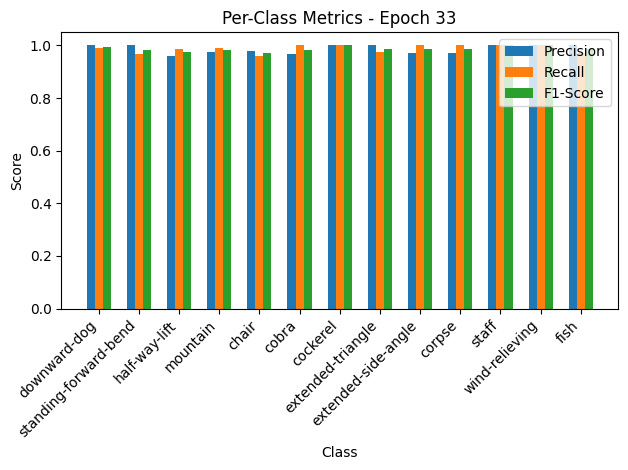


Epoch 34/50 Summary:
Train Loss: 0.0663 | Train Acc: 98.62% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1010 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 35/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:11<00:00,  7.07it/s, loss=0.0571, accuracy=98.9]


Per-Class Metrics for Epoch 34:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=0.99, F1-Score=0.98
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.99, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.99, F1-Score=0.99


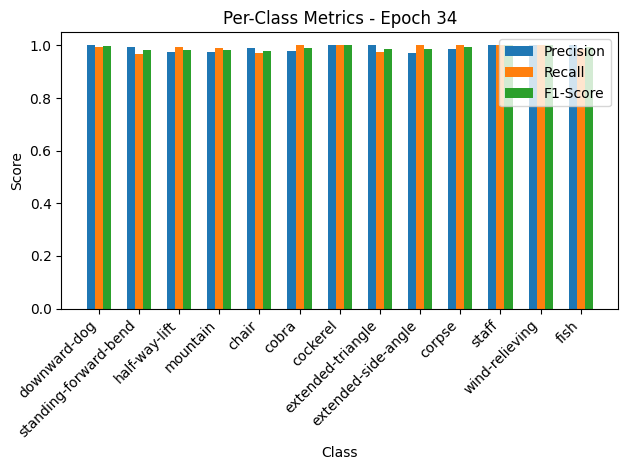

Validation: 100%|██████████| 10/10 [00:00<00:00, 28.86it/s, loss=0.0916, accuracy=97.9]


Per-Class Metrics for Epoch 34:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=0.99, F1-Score=0.98
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.99, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.99, F1-Score=0.99


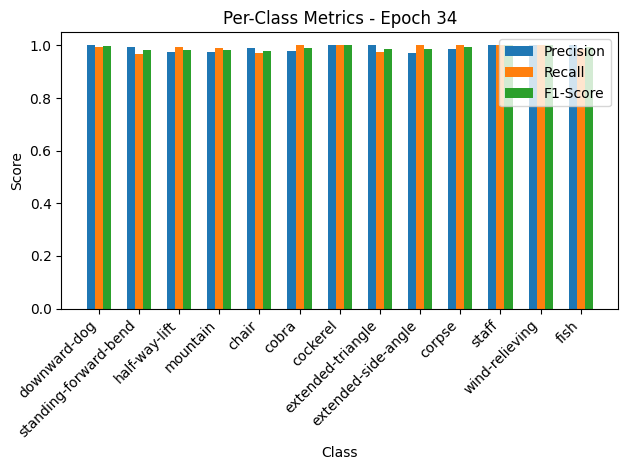


Epoch 35/50 Summary:
Train Loss: 0.0572 | Train Acc: 98.93% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1004 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 36/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:11<00:00,  7.45it/s, loss=0.0574, accuracy=98.9]


Per-Class Metrics for Epoch 35:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.96, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.97, F1-Score=0.98


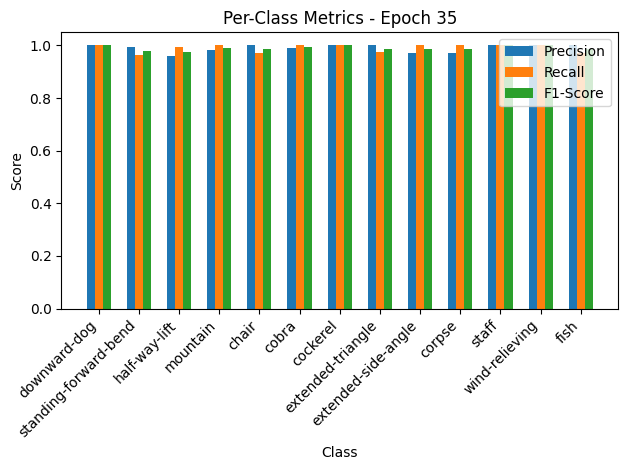

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.60it/s, loss=0.0914, accuracy=97.9]


Per-Class Metrics for Epoch 35:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.96, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.97, F1-Score=0.98


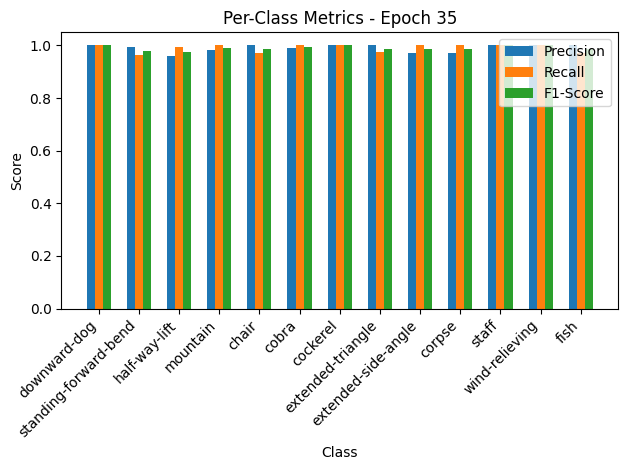


Epoch 36/50 Summary:
Train Loss: 0.0575 | Train Acc: 98.93% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1001 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 37/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:10<00:00,  7.61it/s, loss=0.0517, accuracy=99.2]


Per-Class Metrics for Epoch 36:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.99, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.99, F1-Score=0.99


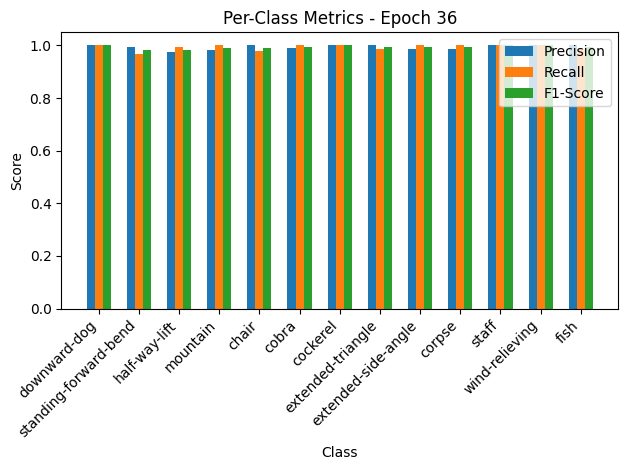

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.78it/s, loss=0.09, accuracy=97.3]


Per-Class Metrics for Epoch 36:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.99, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.99, F1-Score=0.99


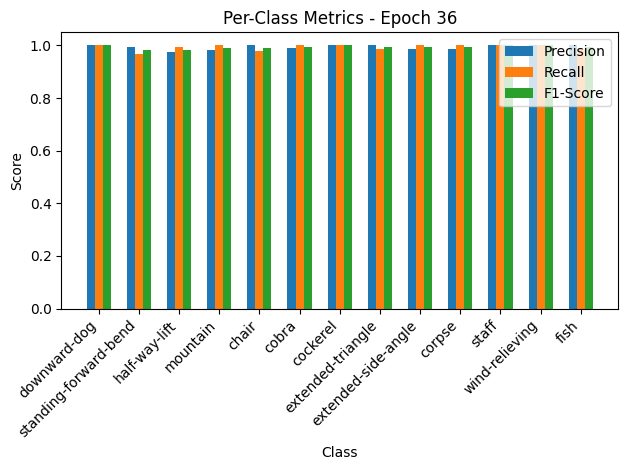


Epoch 37/50 Summary:
Train Loss: 0.0518 | Train Acc: 99.24% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0986 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.97 | Val F1: 0.97

Epoch 38/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:10<00:00,  7.56it/s, loss=0.0557, accuracy=99.1]


Per-Class Metrics for Epoch 37:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.98
mountain: Precision=0.99, Recall=0.99, F1-Score=0.99
chair: Precision=1.00, Recall=0.99, F1-Score=1.00
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.96, Recall=1.00, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.96, F1-Score=0.98


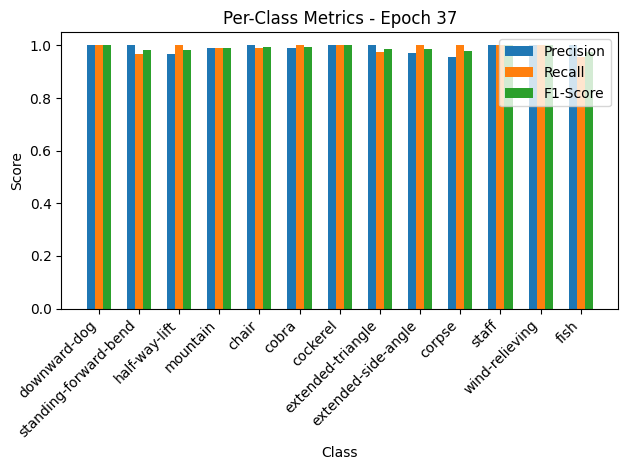

Validation: 100%|██████████| 10/10 [00:00<00:00, 26.43it/s, loss=0.0897, accuracy=97.9]


Per-Class Metrics for Epoch 37:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.98
mountain: Precision=0.99, Recall=0.99, F1-Score=0.99
chair: Precision=1.00, Recall=0.99, F1-Score=1.00
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.96, Recall=1.00, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.96, F1-Score=0.98


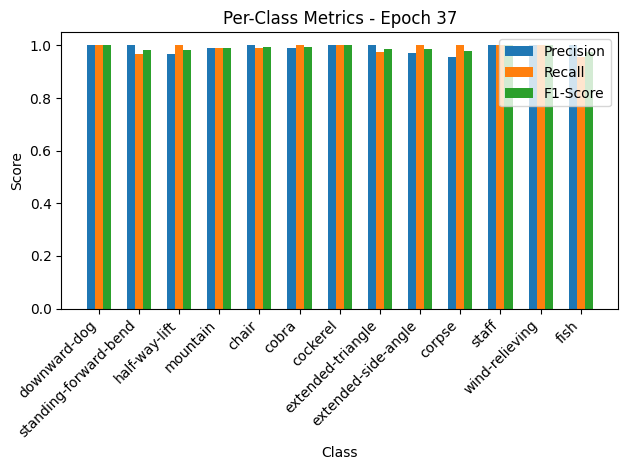


Epoch 38/50 Summary:
Train Loss: 0.0558 | Train Acc: 99.08% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0983 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 39/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:11<00:00,  7.25it/s, loss=0.0488, accuracy=99.3]


Per-Class Metrics for Epoch 38:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.99, F1-Score=0.99
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.99
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.99, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.99, F1-Score=0.99


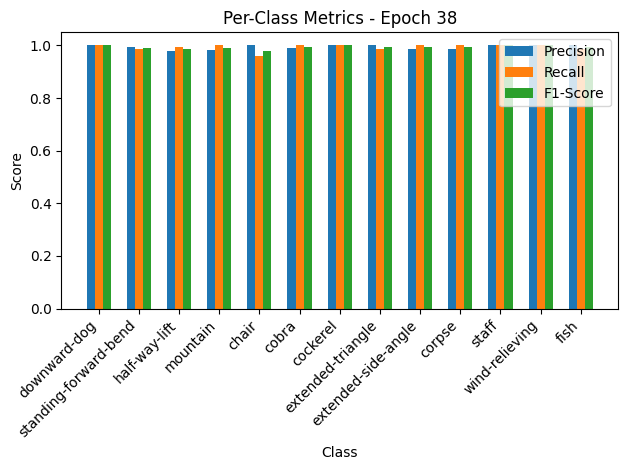

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.50it/s, loss=0.0898, accuracy=97.9]


Per-Class Metrics for Epoch 38:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.99, F1-Score=0.99
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.99
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.99, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.99, F1-Score=0.99


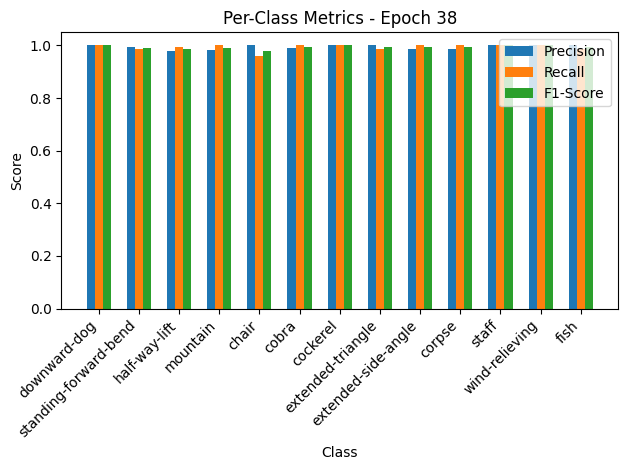


Epoch 39/50 Summary:
Train Loss: 0.0489 | Train Acc: 99.31% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0984 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 40/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:11<00:00,  7.42it/s, loss=0.0544, accuracy=99.3]


Per-Class Metrics for Epoch 39:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=1.00, F1-Score=0.99
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.96, Recall=1.00, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.96, F1-Score=0.98


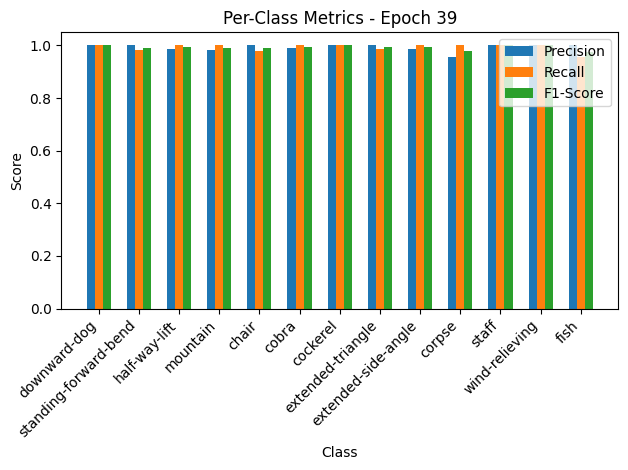

Validation: 100%|██████████| 10/10 [00:00<00:00, 28.14it/s, loss=0.0993, accuracy=97.3]


Per-Class Metrics for Epoch 39:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=1.00, F1-Score=0.99
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.96, Recall=1.00, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.96, F1-Score=0.98


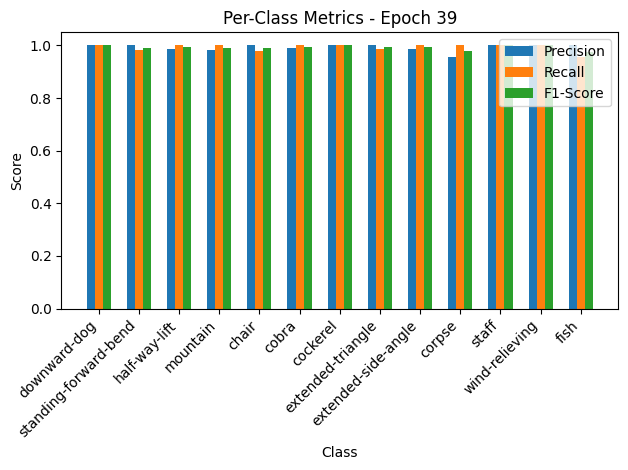


Epoch 40/50 Summary:
Train Loss: 0.0545 | Train Acc: 99.31% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1088 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.97 | Val F1: 0.97

Epoch 41/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:11<00:00,  7.01it/s, loss=0.0581, accuracy=98.8]


Per-Class Metrics for Epoch 40:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=0.99, F1-Score=0.98
chair: Precision=0.99, Recall=0.98, F1-Score=0.99
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.99, Recall=0.97, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.99, F1-Score=0.98


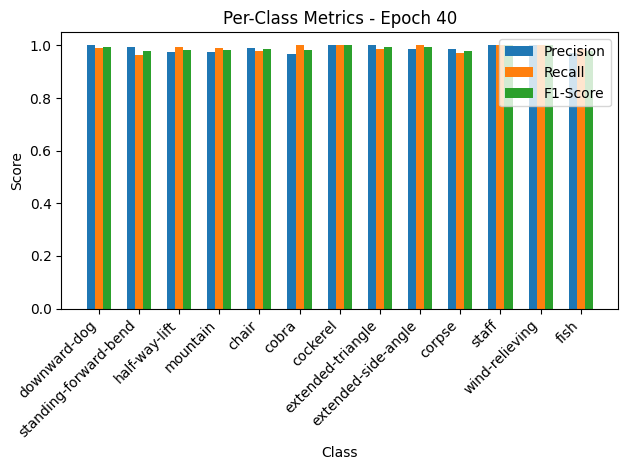

Validation: 100%|██████████| 10/10 [00:00<00:00, 28.18it/s, loss=0.0956, accuracy=97.3]


Per-Class Metrics for Epoch 40:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=0.99, F1-Score=0.98
chair: Precision=0.99, Recall=0.98, F1-Score=0.99
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.99, Recall=0.97, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.99, F1-Score=0.98


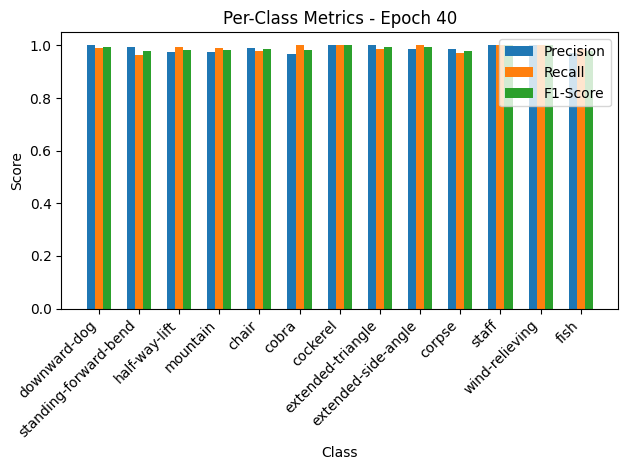


Epoch 41/50 Summary:
Train Loss: 0.0582 | Train Acc: 98.78% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1048 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.97 | Val F1: 0.97

Epoch 42/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:11<00:00,  7.16it/s, loss=0.0599, accuracy=99]


Per-Class Metrics for Epoch 41:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=0.99, F1-Score=0.99
mountain: Precision=0.98, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.98, F1-Score=0.99
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.99, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.97, F1-Score=0.98


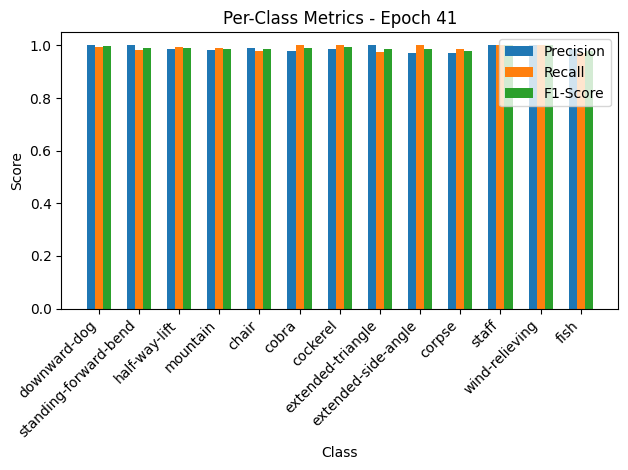

Validation: 100%|██████████| 10/10 [00:00<00:00, 23.39it/s, loss=0.1, accuracy=97.9]


Per-Class Metrics for Epoch 41:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=0.99, F1-Score=0.99
mountain: Precision=0.98, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.98, F1-Score=0.99
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.99, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.97, F1-Score=0.98


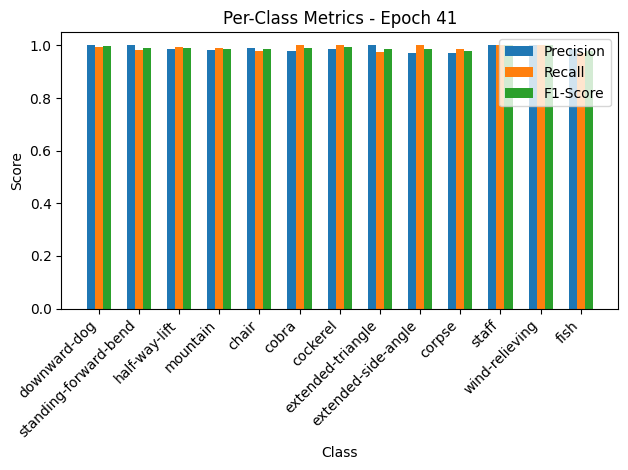


Epoch 42/50 Summary:
Train Loss: 0.0601 | Train Acc: 99.01% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1099 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 43/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:10<00:00,  7.70it/s, loss=0.0531, accuracy=98.9]


Per-Class Metrics for Epoch 42:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.96, Recall=1.00, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=1.00, Recall=0.96, F1-Score=0.98


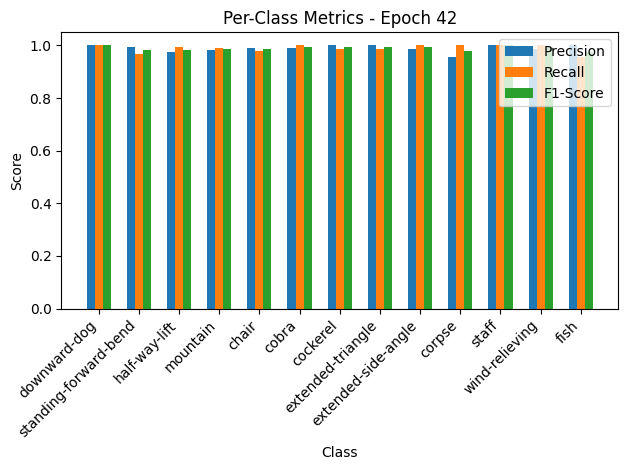

Validation: 100%|██████████| 10/10 [00:00<00:00, 26.82it/s, loss=0.0898, accuracy=97.3]


Per-Class Metrics for Epoch 42:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.96, Recall=1.00, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=1.00, Recall=0.96, F1-Score=0.98


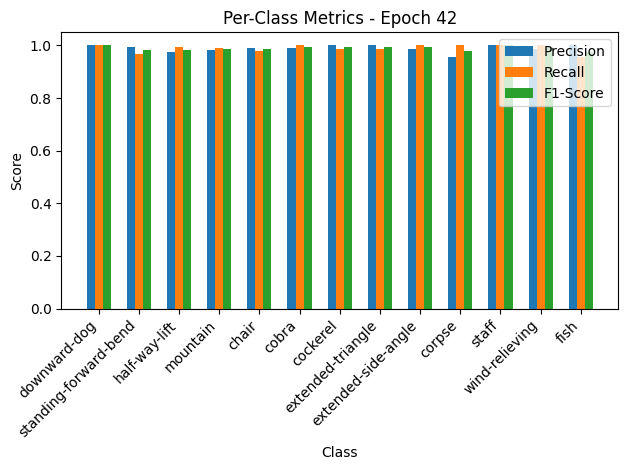


Epoch 43/50 Summary:
Train Loss: 0.0532 | Train Acc: 98.93% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0984 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.97 | Val F1: 0.97

Epoch 44/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:10<00:00,  7.54it/s, loss=0.0563, accuracy=99.2]


Per-Class Metrics for Epoch 43:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.98, Recall=1.00, F1-Score=0.99
mountain: Precision=0.99, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=0.99, F1-Score=1.00
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.97, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.97, F1-Score=0.98


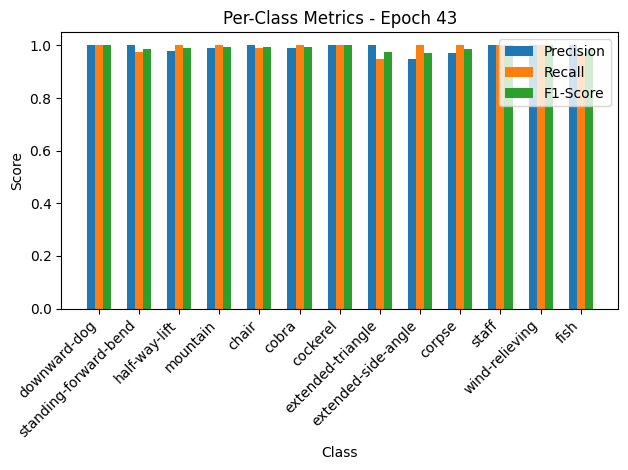

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.41it/s, loss=0.0922, accuracy=97.3]


Per-Class Metrics for Epoch 43:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.98, Recall=1.00, F1-Score=0.99
mountain: Precision=0.99, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=0.99, F1-Score=1.00
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.97, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.97, F1-Score=0.98


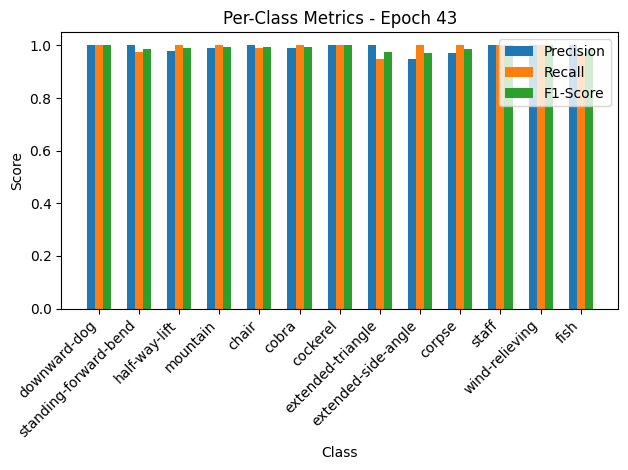


Epoch 44/50 Summary:
Train Loss: 0.0564 | Train Acc: 99.16% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1010 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.97 | Val F1: 0.97

Epoch 45/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:11<00:00,  7.31it/s, loss=0.0548, accuracy=99.1]


Per-Class Metrics for Epoch 44:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.99, Recall=0.99, F1-Score=0.99
mountain: Precision=0.98, Recall=0.99, F1-Score=0.99
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.99, Recall=0.97, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.99, F1-Score=0.98


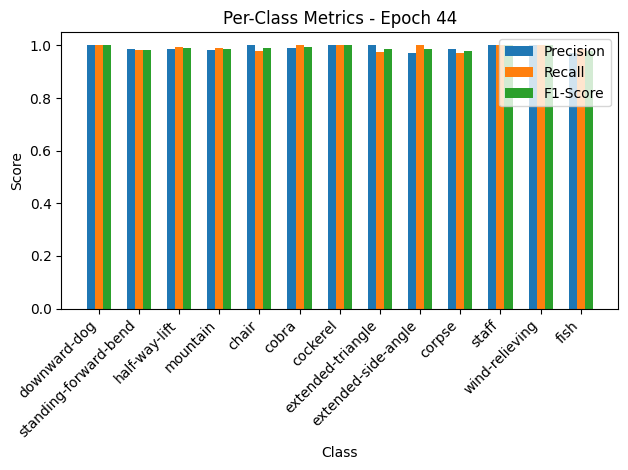

Validation: 100%|██████████| 10/10 [00:00<00:00, 28.30it/s, loss=0.0976, accuracy=97.3]


Per-Class Metrics for Epoch 44:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.99, Recall=0.99, F1-Score=0.99
mountain: Precision=0.98, Recall=0.99, F1-Score=0.99
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.99, Recall=0.97, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.99, F1-Score=0.98


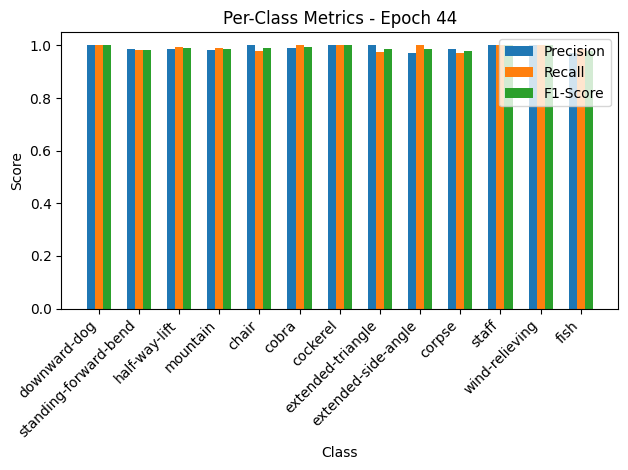


Epoch 45/50 Summary:
Train Loss: 0.0549 | Train Acc: 99.08% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1069 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.97 | Val F1: 0.97

Epoch 46/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:11<00:00,  7.26it/s, loss=0.0512, accuracy=99.3]


Per-Class Metrics for Epoch 45:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=1.00, F1-Score=0.99
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.97, F1-Score=0.98


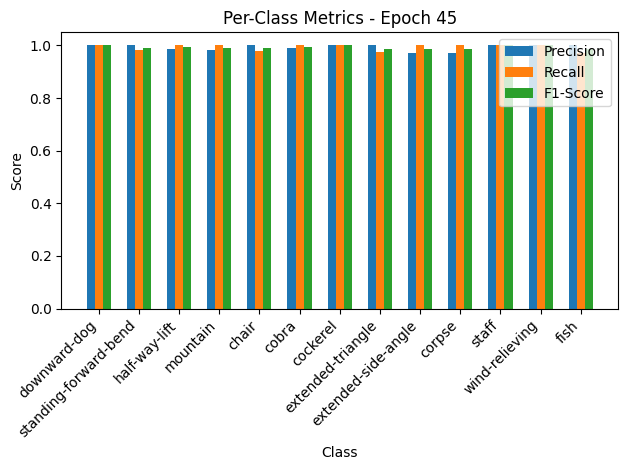

Validation: 100%|██████████| 10/10 [00:00<00:00, 29.21it/s, loss=0.101, accuracy=97.3]


Per-Class Metrics for Epoch 45:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=1.00, F1-Score=0.99
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.97, F1-Score=0.98


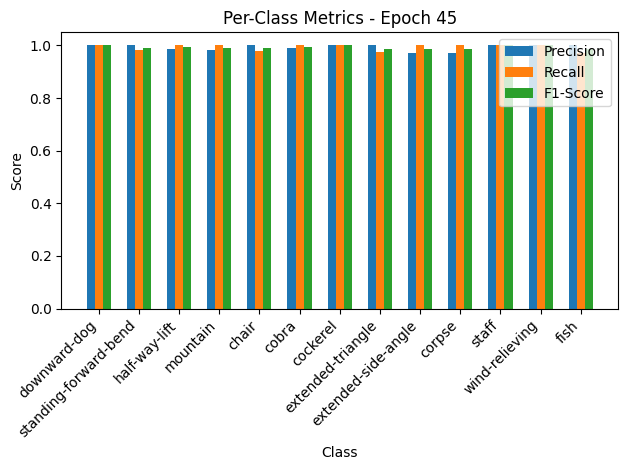


Epoch 46/50 Summary:
Train Loss: 0.0514 | Train Acc: 99.31% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1106 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.97 | Val F1: 0.97

Epoch 47/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:11<00:00,  7.22it/s, loss=0.0505, accuracy=99.2]


Per-Class Metrics for Epoch 46:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=0.99, F1-Score=0.99
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.96, Recall=1.00, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.96, F1-Score=0.98


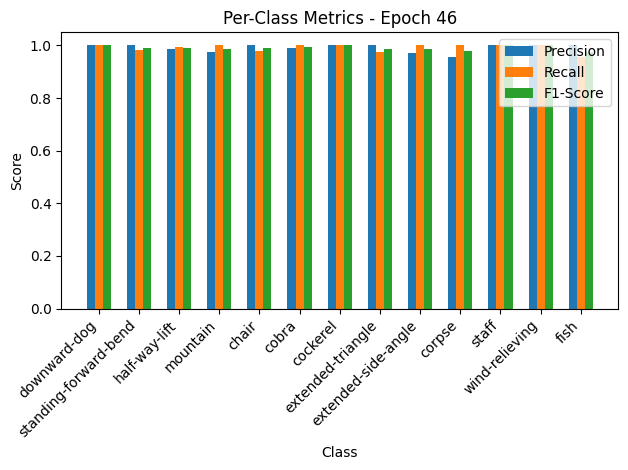

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.75it/s, loss=0.0919, accuracy=97.9]


Per-Class Metrics for Epoch 46:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.98, F1-Score=0.99
half-way-lift: Precision=0.99, Recall=0.99, F1-Score=0.99
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.96, Recall=1.00, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.96, F1-Score=0.98


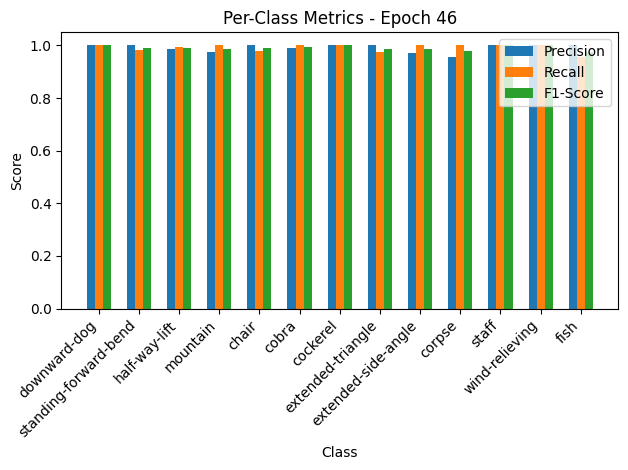


Epoch 47/50 Summary:
Train Loss: 0.0506 | Train Acc: 99.16% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1008 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 48/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:10<00:00,  7.77it/s, loss=0.0503, accuracy=99.2]


Per-Class Metrics for Epoch 47:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.99
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.97, F1-Score=0.98


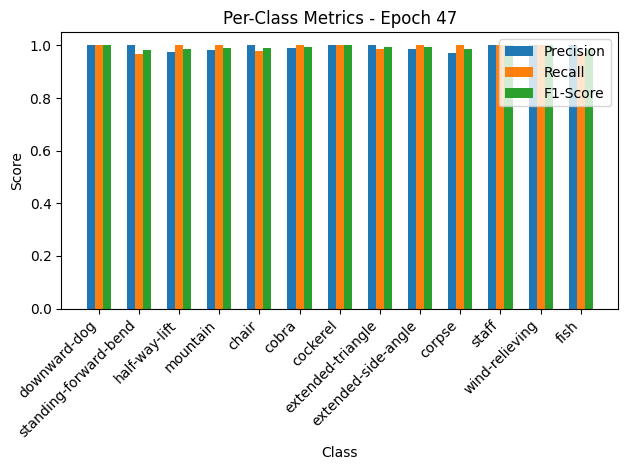

Validation: 100%|██████████| 10/10 [00:00<00:00, 21.54it/s, loss=0.0993, accuracy=97.9]


Per-Class Metrics for Epoch 47:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.99
mountain: Precision=0.98, Recall=1.00, F1-Score=0.99
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=1.00, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.97, F1-Score=0.98


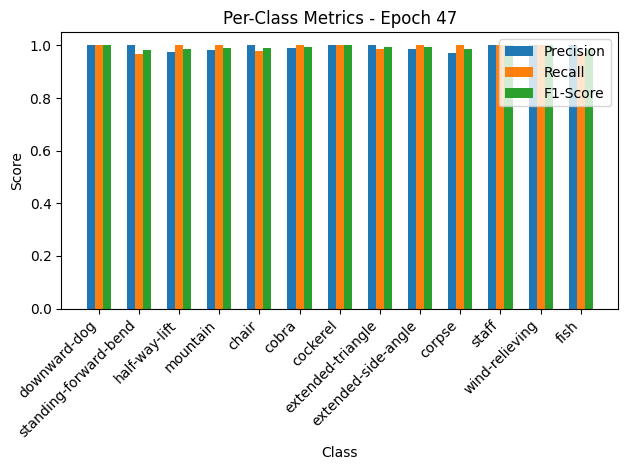


Epoch 48/50 Summary:
Train Loss: 0.0504 | Train Acc: 99.24% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1089 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 49/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:10<00:00,  7.68it/s, loss=0.055, accuracy=98.8]


Per-Class Metrics for Epoch 48:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.98
mountain: Precision=0.98, Recall=0.97, F1-Score=0.98
chair: Precision=0.98, Recall=0.98, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.99, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.97, F1-Score=0.98


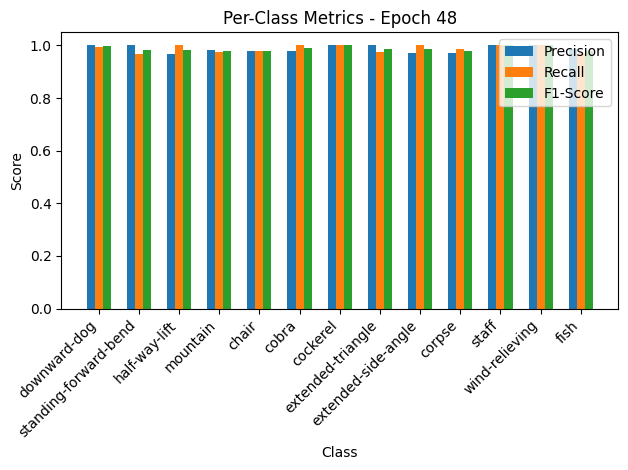

Validation: 100%|██████████| 10/10 [00:00<00:00, 23.23it/s, loss=0.0862, accuracy=97.3]


Per-Class Metrics for Epoch 48:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=1.00, F1-Score=0.98
mountain: Precision=0.98, Recall=0.97, F1-Score=0.98
chair: Precision=0.98, Recall=0.98, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.99, F1-Score=0.98
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.97, F1-Score=0.98


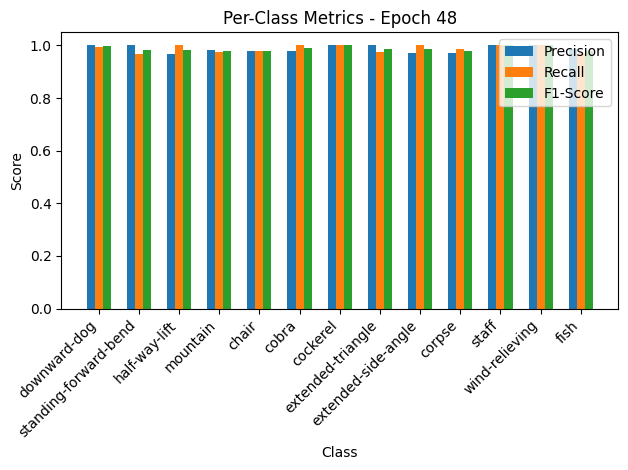


Epoch 49/50 Summary:
Train Loss: 0.0551 | Train Acc: 98.78% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.0945 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.97 | Val F1: 0.97

Epoch 50/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:11<00:00,  7.26it/s, loss=0.0548, accuracy=99.1]


Per-Class Metrics for Epoch 49:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.99
mountain: Precision=0.98, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.99, Recall=0.99, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.99, Recall=0.99, F1-Score=0.99


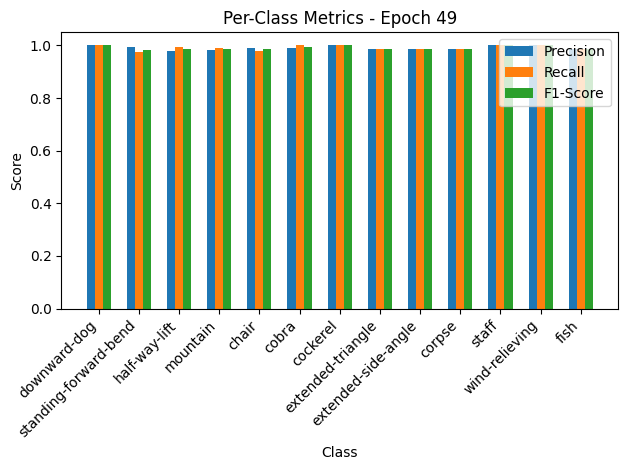

Validation: 100%|██████████| 10/10 [00:00<00:00, 26.56it/s, loss=0.0969, accuracy=97.3]


Per-Class Metrics for Epoch 49:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.99
mountain: Precision=0.98, Recall=0.99, F1-Score=0.99
chair: Precision=0.99, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.99, Recall=0.99, F1-Score=0.99
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.99, Recall=0.99, F1-Score=0.99


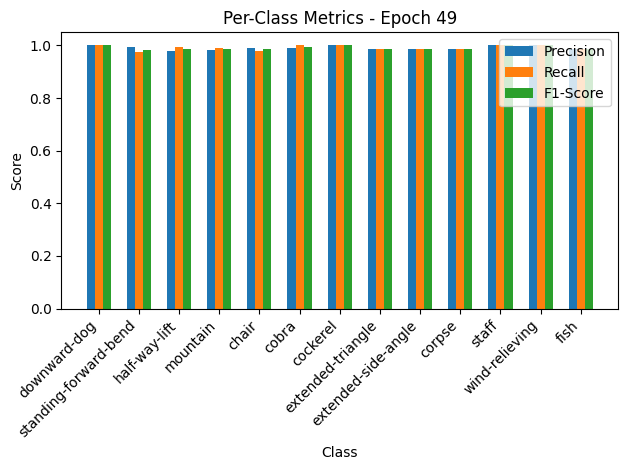


Epoch 50/50 Summary:
Train Loss: 0.0550 | Train Acc: 99.08% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1062 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.97 | Val F1: 0.97


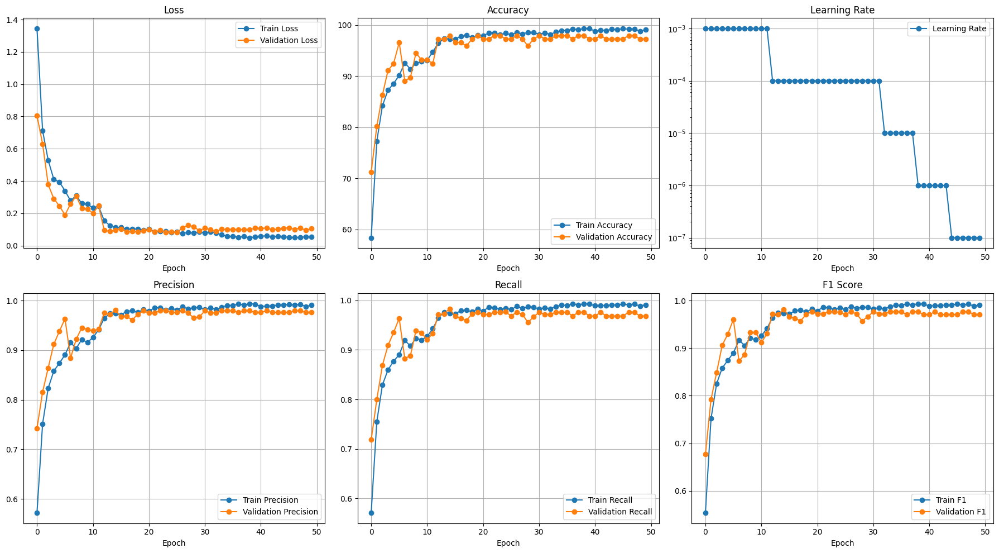

Testing: 100%|██████████| 23/23 [00:00<00:00, 25.66it/s]


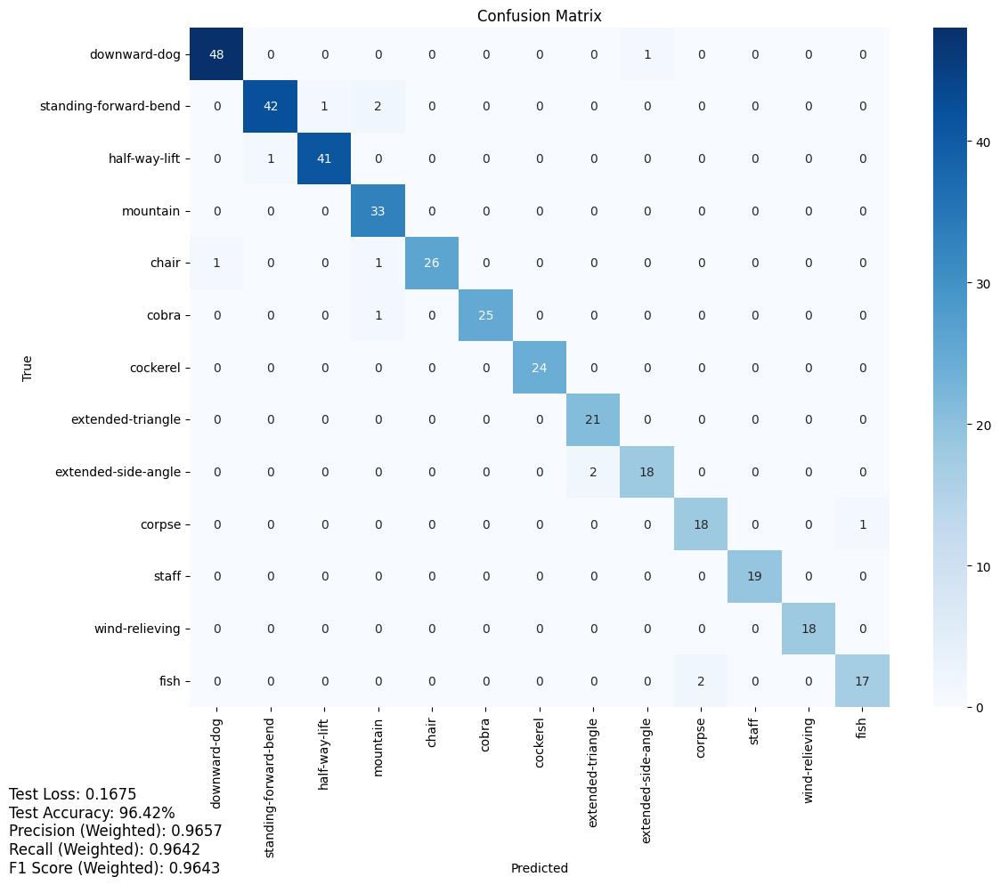

Test Loss: 0.1675
Test Accuracy: 96.42%
Precision (Weighted): 0.9657
Recall (Weighted): 0.9642
F1 Score (Weighted): 0.9643


Testing: 100%|██████████| 23/23 [00:00<00:00, 27.59it/s]


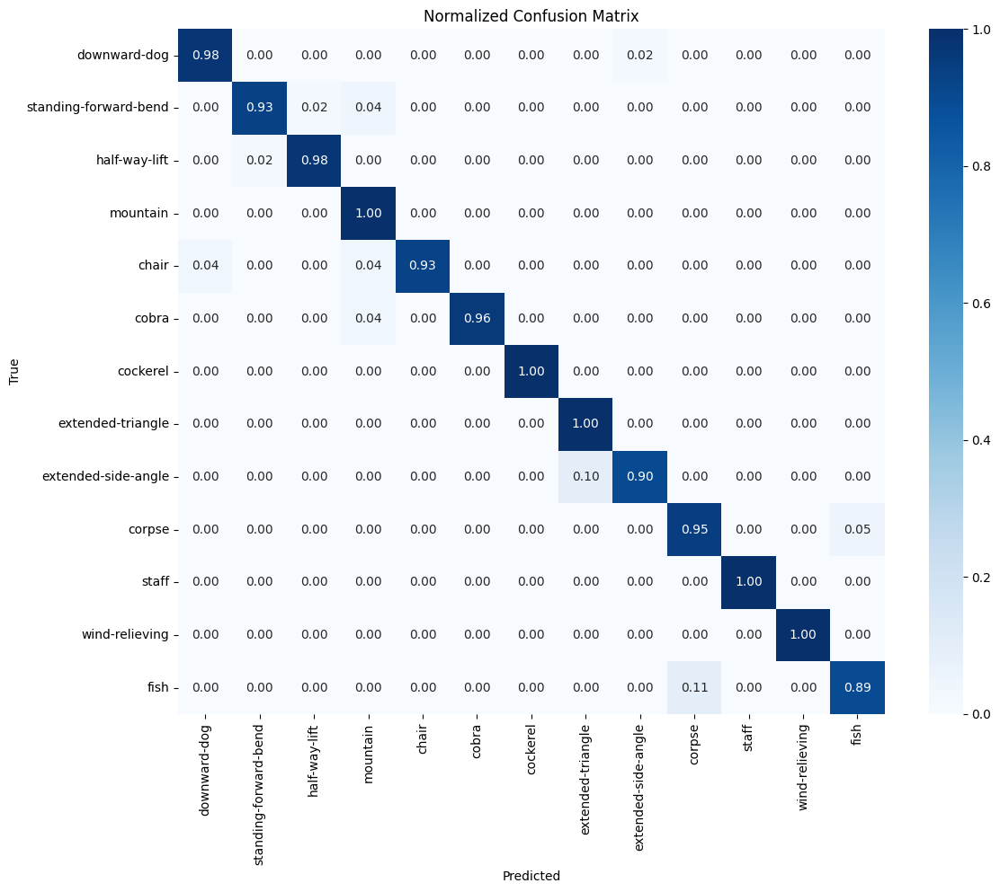

Test Loss: 0.1675
Test Accuracy: 96.42%
Precision (Macro): 0.9638
Recall (Macro): 0.9632
F1 Score (Macro): 0.9628
Saved checkpoint for fold 4
Fold 5/5
Loading cached criterion for fold 4
batch_norm.weight: 99
batch_norm.bias: 99
blocks.0.agcn.A: 3267
blocks.0.agcn.conv.weight: 1080
blocks.0.agcn.conv.bias: 360
blocks.0.agcn.batch_norm.weight: 120
blocks.0.agcn.batch_norm.bias: 120
blocks.0.sam.gs.weight: 3960
blocks.0.sam.gs.bias: 1
blocks.0.tam.gt.weight: 1080
blocks.0.tam.gt.bias: 1
blocks.0.cam.fc.0.weight: 7200
blocks.0.cam.fc.0.bias: 60
blocks.0.cam.fc.2.weight: 7200
blocks.0.cam.fc.2.bias: 120
blocks.0.mtcn.branches.0.0.weight: 2400
blocks.0.mtcn.branches.0.0.bias: 20
blocks.0.mtcn.branches.0.1.weight: 20
blocks.0.mtcn.branches.0.1.bias: 20
blocks.0.mtcn.branches.0.3.conv.weight: 1200
blocks.0.mtcn.branches.0.3.conv.bias: 20
blocks.0.mtcn.branches.0.3.bn.weight: 20
blocks.0.mtcn.branches.0.3.bn.bias: 20
blocks.0.mtcn.branches.1.0.weight: 2400
blocks.0.mtcn.branches.1.0.bias: 20
b

Training: 100%|██████████| 82/82 [00:11<00:00,  7.42it/s, loss=1.51, accuracy=53.1]


Per-Class Metrics for Epoch 0:
downward-dog: Precision=0.68, Recall=0.55, F1-Score=0.61
standing-forward-bend: Precision=0.80, Recall=0.28, F1-Score=0.41
half-way-lift: Precision=0.56, Recall=0.83, F1-Score=0.67
mountain: Precision=0.52, Recall=0.71, F1-Score=0.60
chair: Precision=0.55, Recall=0.24, F1-Score=0.33
cobra: Precision=0.57, Recall=0.67, F1-Score=0.61
cockerel: Precision=0.63, Recall=0.49, F1-Score=0.55
extended-triangle: Precision=0.49, Recall=0.51, F1-Score=0.50
extended-side-angle: Precision=0.36, Recall=0.41, F1-Score=0.38
corpse: Precision=0.30, Recall=0.25, F1-Score=0.27
staff: Precision=0.42, Recall=0.78, F1-Score=0.55
wind-relieving: Precision=0.50, Recall=0.57, F1-Score=0.53
fish: Precision=0.47, Recall=0.55, F1-Score=0.51


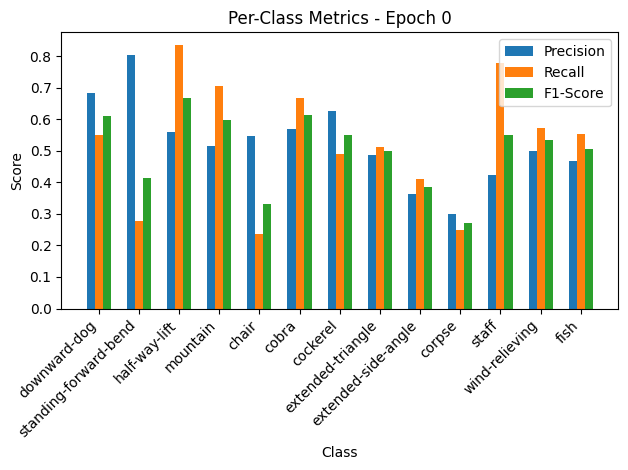

Validation: 100%|██████████| 10/10 [00:00<00:00, 22.87it/s, loss=0.699, accuracy=71.9]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 0:
downward-dog: Precision=0.68, Recall=0.55, F1-Score=0.61
standing-forward-bend: Precision=0.80, Recall=0.28, F1-Score=0.41
half-way-lift: Precision=0.56, Recall=0.83, F1-Score=0.67
mountain: Precision=0.52, Recall=0.71, F1-Score=0.60
chair: Precision=0.55, Recall=0.24, F1-Score=0.33
cobra: Precision=0.57, Recall=0.67, F1-Score=0.61
cockerel: Precision=0.63, Recall=0.49, F1-Score=0.55
extended-triangle: Precision=0.49, Recall=0.51, F1-Score=0.50
extended-side-angle: Precision=0.36, Recall=0.41, F1-Score=0.38
corpse: Precision=0.30, Recall=0.25, F1-Score=0.27
staff: Precision=0.42, Recall=0.78, F1-Score=0.55
wind-relieving: Precision=0.50, Recall=0.57, F1-Score=0.53
fish: Precision=0.47, Recall=0.55, F1-Score=0.51


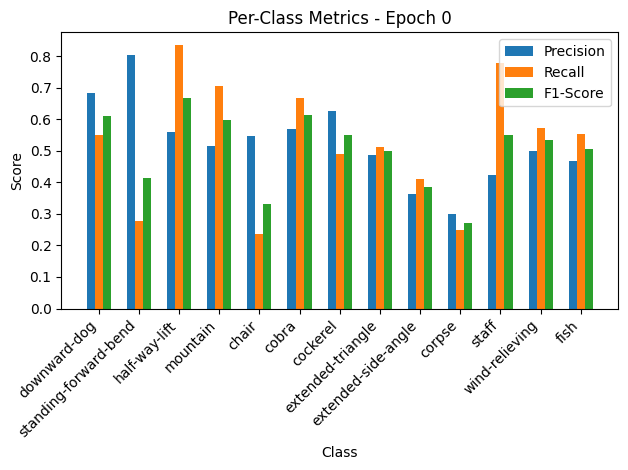


Epoch 1/50 Summary:
Train Loss: 1.5126 | Train Acc: 53.09% | Train Precision: 0.53 | Train Recall: 0.53 | Train F1: 0.50
Val Loss: 0.7662 | Val Acc: 71.92% | Val Precision: 0.71 | Val Recall: 0.71 | Val F1: 0.66
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_4.pth
Checkpoint saved at epoch 1
New best model saved! Validation Loss: 0.7662

Epoch 2/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.60it/s, loss=0.741, accuracy=77.1]


Per-Class Metrics for Epoch 1:
downward-dog: Precision=0.88, Recall=0.85, F1-Score=0.86
standing-forward-bend: Precision=0.83, Recall=0.65, F1-Score=0.73
half-way-lift: Precision=0.78, Recall=0.89, F1-Score=0.83
mountain: Precision=0.74, Recall=0.77, F1-Score=0.76
chair: Precision=0.74, Recall=0.70, F1-Score=0.72
cobra: Precision=0.89, Recall=0.89, F1-Score=0.89
cockerel: Precision=0.80, Recall=0.88, F1-Score=0.84
extended-triangle: Precision=0.70, Recall=0.69, F1-Score=0.70
extended-side-angle: Precision=0.65, Recall=0.71, F1-Score=0.68
corpse: Precision=0.60, Recall=0.41, F1-Score=0.49
staff: Precision=0.81, Recall=0.91, F1-Score=0.86
wind-relieving: Precision=0.79, Recall=0.88, F1-Score=0.83
fish: Precision=0.57, Recall=0.64, F1-Score=0.60


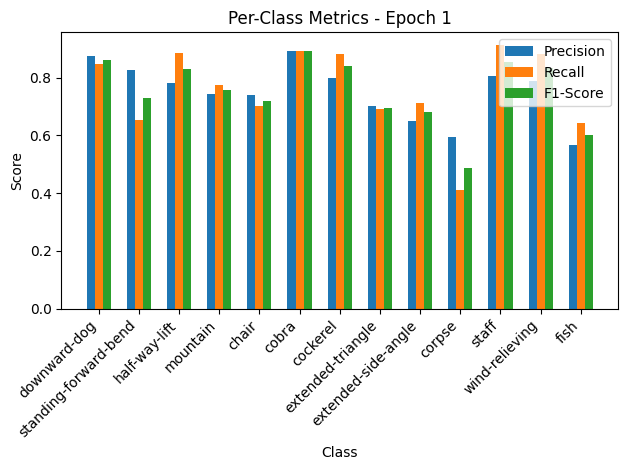

Validation: 100%|██████████| 10/10 [00:00<00:00, 20.62it/s, loss=0.503, accuracy=84.9]


Per-Class Metrics for Epoch 1:
downward-dog: Precision=0.88, Recall=0.85, F1-Score=0.86
standing-forward-bend: Precision=0.83, Recall=0.65, F1-Score=0.73
half-way-lift: Precision=0.78, Recall=0.89, F1-Score=0.83
mountain: Precision=0.74, Recall=0.77, F1-Score=0.76
chair: Precision=0.74, Recall=0.70, F1-Score=0.72
cobra: Precision=0.89, Recall=0.89, F1-Score=0.89
cockerel: Precision=0.80, Recall=0.88, F1-Score=0.84
extended-triangle: Precision=0.70, Recall=0.69, F1-Score=0.70
extended-side-angle: Precision=0.65, Recall=0.71, F1-Score=0.68
corpse: Precision=0.60, Recall=0.41, F1-Score=0.49
staff: Precision=0.81, Recall=0.91, F1-Score=0.86
wind-relieving: Precision=0.79, Recall=0.88, F1-Score=0.83
fish: Precision=0.57, Recall=0.64, F1-Score=0.60


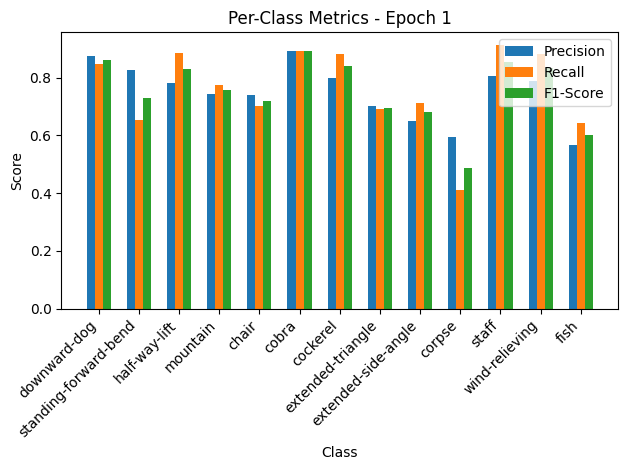


Epoch 2/50 Summary:
Train Loss: 0.7422 | Train Acc: 77.08% | Train Precision: 0.75 | Train Recall: 0.76 | Train F1: 0.75
Val Loss: 0.5512 | Val Acc: 84.93% | Val Precision: 0.89 | Val Recall: 0.85 | Val F1: 0.84
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_4.pth
Checkpoint saved at epoch 2
New best model saved! Validation Loss: 0.5512

Epoch 3/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.52it/s, loss=0.542, accuracy=84.3]


Per-Class Metrics for Epoch 2:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=0.91, Recall=0.78, F1-Score=0.84
half-way-lift: Precision=0.83, Recall=0.91, F1-Score=0.87
mountain: Precision=0.87, Recall=0.87, F1-Score=0.87
chair: Precision=0.84, Recall=0.90, F1-Score=0.87
cobra: Precision=0.90, Recall=0.96, F1-Score=0.93
cockerel: Precision=0.93, Recall=0.95, F1-Score=0.94
extended-triangle: Precision=0.81, Recall=0.81, F1-Score=0.81
extended-side-angle: Precision=0.75, Recall=0.75, F1-Score=0.75
corpse: Precision=0.55, Recall=0.53, F1-Score=0.54
staff: Precision=0.90, Recall=0.96, F1-Score=0.93
wind-relieving: Precision=0.86, Recall=0.90, F1-Score=0.88
fish: Precision=0.56, Recall=0.54, F1-Score=0.55


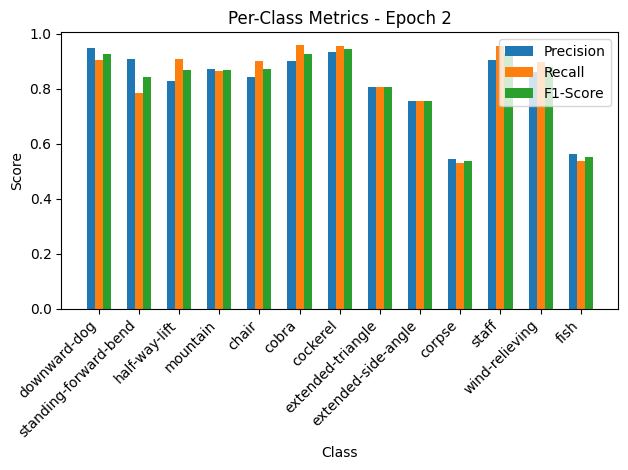

Validation: 100%|██████████| 10/10 [00:00<00:00, 26.06it/s, loss=0.475, accuracy=82.9]


Per-Class Metrics for Epoch 2:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=0.91, Recall=0.78, F1-Score=0.84
half-way-lift: Precision=0.83, Recall=0.91, F1-Score=0.87
mountain: Precision=0.87, Recall=0.87, F1-Score=0.87
chair: Precision=0.84, Recall=0.90, F1-Score=0.87
cobra: Precision=0.90, Recall=0.96, F1-Score=0.93
cockerel: Precision=0.93, Recall=0.95, F1-Score=0.94
extended-triangle: Precision=0.81, Recall=0.81, F1-Score=0.81
extended-side-angle: Precision=0.75, Recall=0.75, F1-Score=0.75
corpse: Precision=0.55, Recall=0.53, F1-Score=0.54
staff: Precision=0.90, Recall=0.96, F1-Score=0.93
wind-relieving: Precision=0.86, Recall=0.90, F1-Score=0.88
fish: Precision=0.56, Recall=0.54, F1-Score=0.55


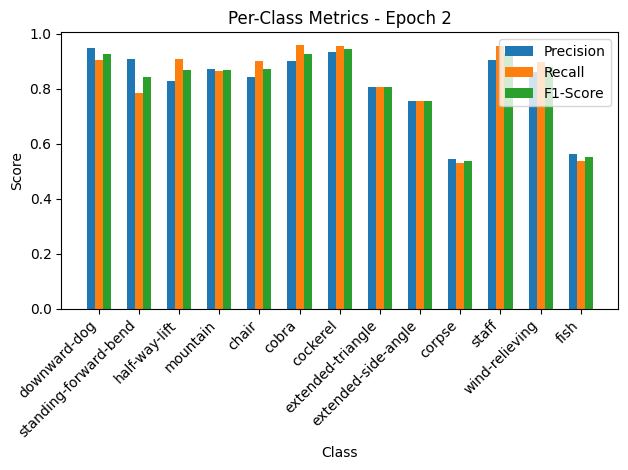


Epoch 3/50 Summary:
Train Loss: 0.5435 | Train Acc: 84.26% | Train Precision: 0.82 | Train Recall: 0.83 | Train F1: 0.82
Val Loss: 0.5200 | Val Acc: 82.88% | Val Precision: 0.85 | Val Recall: 0.83 | Val F1: 0.82
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_4.pth
Checkpoint saved at epoch 3
New best model saved! Validation Loss: 0.5200

Epoch 4/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.11it/s, loss=0.454, accuracy=86.6]


Per-Class Metrics for Epoch 3:
downward-dog: Precision=0.94, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=0.93, Recall=0.78, F1-Score=0.85
half-way-lift: Precision=0.83, Recall=0.87, F1-Score=0.85
mountain: Precision=0.89, Recall=0.91, F1-Score=0.90
chair: Precision=0.88, Recall=0.93, F1-Score=0.90
cobra: Precision=0.93, Recall=0.98, F1-Score=0.95
cockerel: Precision=0.91, Recall=0.91, F1-Score=0.91
extended-triangle: Precision=0.87, Recall=0.85, F1-Score=0.86
extended-side-angle: Precision=0.81, Recall=0.84, F1-Score=0.82
corpse: Precision=0.61, Recall=0.62, F1-Score=0.61
staff: Precision=0.89, Recall=0.99, F1-Score=0.94
wind-relieving: Precision=0.91, Recall=0.91, F1-Score=0.91
fish: Precision=0.66, Recall=0.60, F1-Score=0.62


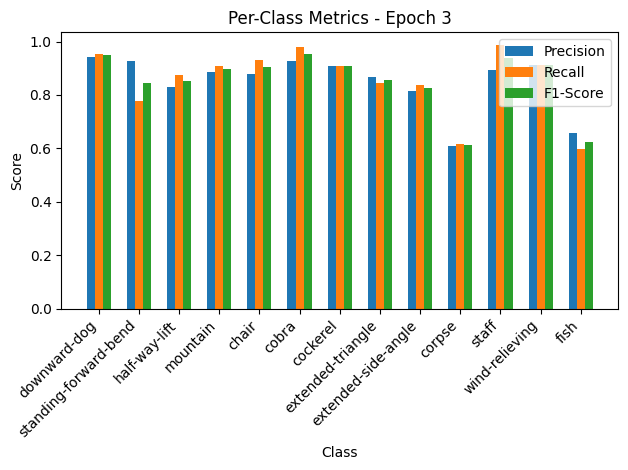

Validation: 100%|██████████| 10/10 [00:00<00:00, 25.83it/s, loss=0.339, accuracy=89]


Per-Class Metrics for Epoch 3:
downward-dog: Precision=0.94, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=0.93, Recall=0.78, F1-Score=0.85
half-way-lift: Precision=0.83, Recall=0.87, F1-Score=0.85
mountain: Precision=0.89, Recall=0.91, F1-Score=0.90
chair: Precision=0.88, Recall=0.93, F1-Score=0.90
cobra: Precision=0.93, Recall=0.98, F1-Score=0.95
cockerel: Precision=0.91, Recall=0.91, F1-Score=0.91
extended-triangle: Precision=0.87, Recall=0.85, F1-Score=0.86
extended-side-angle: Precision=0.81, Recall=0.84, F1-Score=0.82
corpse: Precision=0.61, Recall=0.62, F1-Score=0.61
staff: Precision=0.89, Recall=0.99, F1-Score=0.94
wind-relieving: Precision=0.91, Recall=0.91, F1-Score=0.91
fish: Precision=0.66, Recall=0.60, F1-Score=0.62


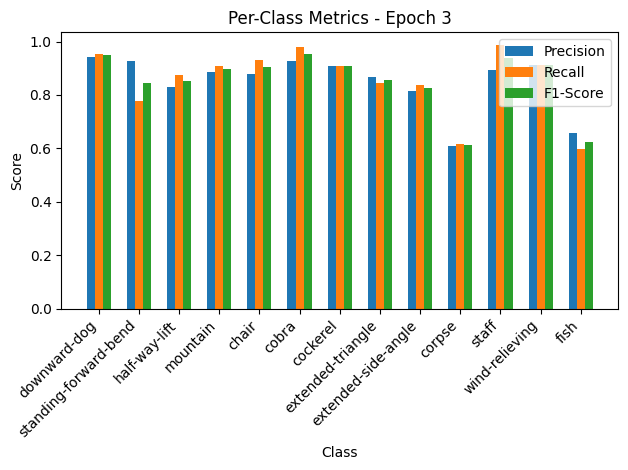


Epoch 4/50 Summary:
Train Loss: 0.4553 | Train Acc: 86.63% | Train Precision: 0.85 | Train Recall: 0.86 | Train F1: 0.85
Val Loss: 0.3710 | Val Acc: 89.04% | Val Precision: 0.90 | Val Recall: 0.90 | Val F1: 0.89
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_4.pth
Checkpoint saved at epoch 4
New best model saved! Validation Loss: 0.3710

Epoch 5/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.48it/s, loss=0.39, accuracy=88.9]


Per-Class Metrics for Epoch 4:
downward-dog: Precision=0.98, Recall=0.94, F1-Score=0.96
standing-forward-bend: Precision=0.94, Recall=0.81, F1-Score=0.87
half-way-lift: Precision=0.84, Recall=0.92, F1-Score=0.88
mountain: Precision=0.87, Recall=0.96, F1-Score=0.91
chair: Precision=0.90, Recall=0.91, F1-Score=0.91
cobra: Precision=0.95, Recall=0.94, F1-Score=0.94
cockerel: Precision=0.87, Recall=0.97, F1-Score=0.92
extended-triangle: Precision=0.95, Recall=0.91, F1-Score=0.93
extended-side-angle: Precision=0.88, Recall=0.88, F1-Score=0.88
corpse: Precision=0.73, Recall=0.60, F1-Score=0.66
staff: Precision=0.94, Recall=0.93, F1-Score=0.93
wind-relieving: Precision=0.92, Recall=0.97, F1-Score=0.94
fish: Precision=0.67, Recall=0.73, F1-Score=0.70


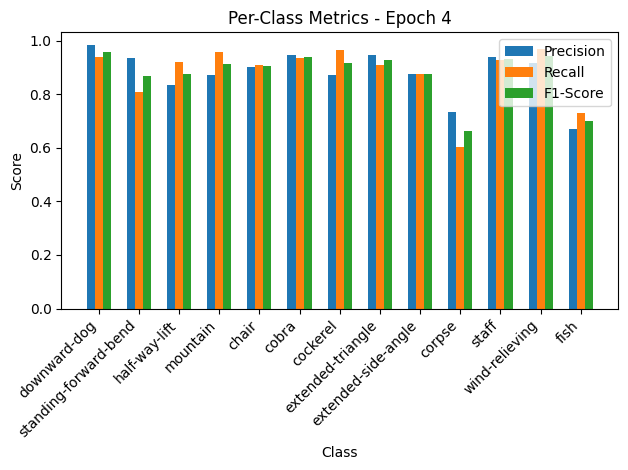

Validation: 100%|██████████| 10/10 [00:00<00:00, 26.44it/s, loss=0.285, accuracy=91.1]


Per-Class Metrics for Epoch 4:
downward-dog: Precision=0.98, Recall=0.94, F1-Score=0.96
standing-forward-bend: Precision=0.94, Recall=0.81, F1-Score=0.87
half-way-lift: Precision=0.84, Recall=0.92, F1-Score=0.88
mountain: Precision=0.87, Recall=0.96, F1-Score=0.91
chair: Precision=0.90, Recall=0.91, F1-Score=0.91
cobra: Precision=0.95, Recall=0.94, F1-Score=0.94
cockerel: Precision=0.87, Recall=0.97, F1-Score=0.92
extended-triangle: Precision=0.95, Recall=0.91, F1-Score=0.93
extended-side-angle: Precision=0.88, Recall=0.88, F1-Score=0.88
corpse: Precision=0.73, Recall=0.60, F1-Score=0.66
staff: Precision=0.94, Recall=0.93, F1-Score=0.93
wind-relieving: Precision=0.92, Recall=0.97, F1-Score=0.94
fish: Precision=0.67, Recall=0.73, F1-Score=0.70


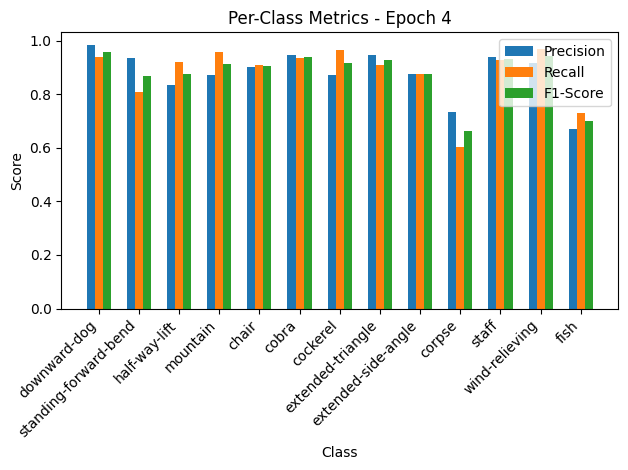


Epoch 5/50 Summary:
Train Loss: 0.3908 | Train Acc: 88.92% | Train Precision: 0.88 | Train Recall: 0.88 | Train F1: 0.88
Val Loss: 0.3123 | Val Acc: 91.10% | Val Precision: 0.91 | Val Recall: 0.92 | Val F1: 0.92
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_4.pth
Checkpoint saved at epoch 5
New best model saved! Validation Loss: 0.3123

Epoch 6/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.10it/s, loss=0.353, accuracy=89.8]


Per-Class Metrics for Epoch 5:
downward-dog: Precision=0.98, Recall=0.94, F1-Score=0.96
standing-forward-bend: Precision=0.93, Recall=0.85, F1-Score=0.88
half-way-lift: Precision=0.84, Recall=0.91, F1-Score=0.87
mountain: Precision=0.93, Recall=0.93, F1-Score=0.93
chair: Precision=0.90, Recall=0.93, F1-Score=0.91
cobra: Precision=0.95, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.92, Recall=0.88, F1-Score=0.90
extended-side-angle: Precision=0.85, Recall=0.86, F1-Score=0.86
corpse: Precision=0.68, Recall=0.69, F1-Score=0.69
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=0.94, F1-Score=0.96
fish: Precision=0.67, Recall=0.69, F1-Score=0.68


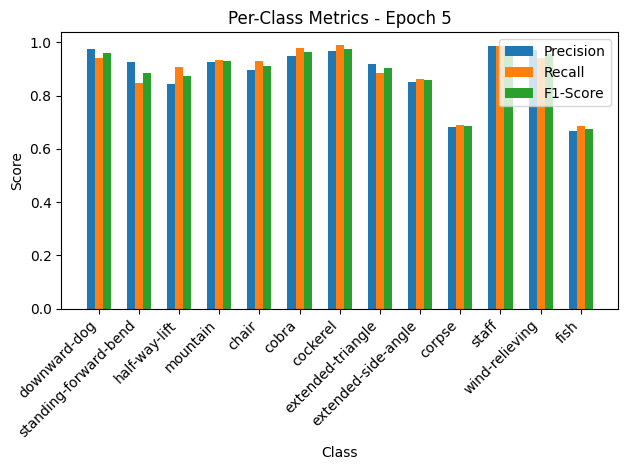

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.69it/s, loss=0.249, accuracy=92.5]


Per-Class Metrics for Epoch 5:
downward-dog: Precision=0.98, Recall=0.94, F1-Score=0.96
standing-forward-bend: Precision=0.93, Recall=0.85, F1-Score=0.88
half-way-lift: Precision=0.84, Recall=0.91, F1-Score=0.87
mountain: Precision=0.93, Recall=0.93, F1-Score=0.93
chair: Precision=0.90, Recall=0.93, F1-Score=0.91
cobra: Precision=0.95, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.92, Recall=0.88, F1-Score=0.90
extended-side-angle: Precision=0.85, Recall=0.86, F1-Score=0.86
corpse: Precision=0.68, Recall=0.69, F1-Score=0.69
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=0.94, F1-Score=0.96
fish: Precision=0.67, Recall=0.69, F1-Score=0.68


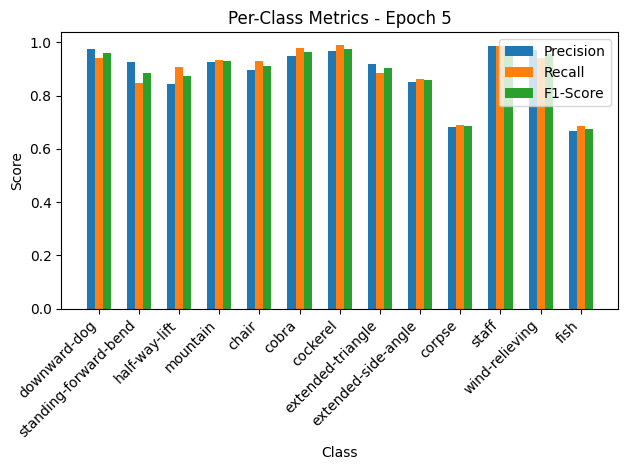


Epoch 6/50 Summary:
Train Loss: 0.3543 | Train Acc: 89.84% | Train Precision: 0.89 | Train Recall: 0.89 | Train F1: 0.89
Val Loss: 0.2727 | Val Acc: 92.47% | Val Precision: 0.93 | Val Recall: 0.93 | Val F1: 0.92
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_4.pth
Checkpoint saved at epoch 6
New best model saved! Validation Loss: 0.2727

Epoch 7/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:12<00:00,  6.77it/s, loss=0.307, accuracy=91.3]


Per-Class Metrics for Epoch 6:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.89, Recall=0.86, F1-Score=0.88
half-way-lift: Precision=0.87, Recall=0.89, F1-Score=0.88
mountain: Precision=0.93, Recall=0.94, F1-Score=0.93
chair: Precision=0.94, Recall=0.92, F1-Score=0.93
cobra: Precision=0.94, Recall=0.97, F1-Score=0.95
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.96, Recall=0.88, F1-Score=0.92
extended-side-angle: Precision=0.86, Recall=0.95, F1-Score=0.90
corpse: Precision=0.77, Recall=0.74, F1-Score=0.75
staff: Precision=0.99, Recall=0.97, F1-Score=0.98
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.75, Recall=0.78, F1-Score=0.76


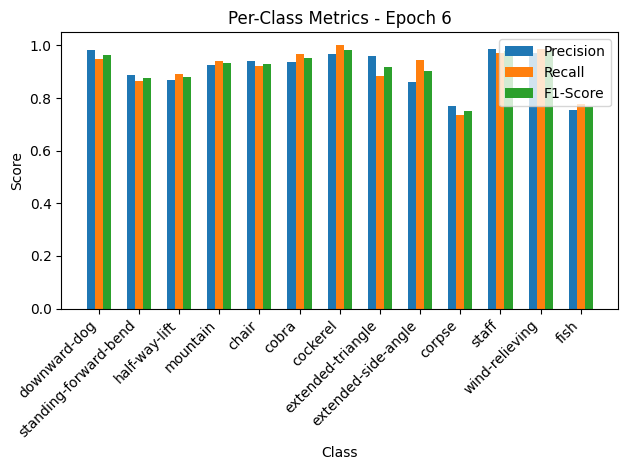

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.05it/s, loss=0.324, accuracy=87]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 6:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.89, Recall=0.86, F1-Score=0.88
half-way-lift: Precision=0.87, Recall=0.89, F1-Score=0.88
mountain: Precision=0.93, Recall=0.94, F1-Score=0.93
chair: Precision=0.94, Recall=0.92, F1-Score=0.93
cobra: Precision=0.94, Recall=0.97, F1-Score=0.95
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.96, Recall=0.88, F1-Score=0.92
extended-side-angle: Precision=0.86, Recall=0.95, F1-Score=0.90
corpse: Precision=0.77, Recall=0.74, F1-Score=0.75
staff: Precision=0.99, Recall=0.97, F1-Score=0.98
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.75, Recall=0.78, F1-Score=0.76


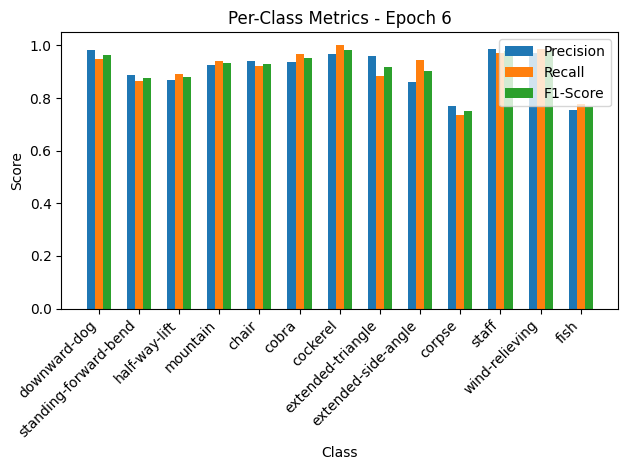


Epoch 7/50 Summary:
Train Loss: 0.3072 | Train Acc: 91.29% | Train Precision: 0.91 | Train Recall: 0.91 | Train F1: 0.91
Val Loss: 0.3546 | Val Acc: 86.99% | Val Precision: 0.83 | Val Recall: 0.87 | Val F1: 0.84

Epoch 8/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.80it/s, loss=0.298, accuracy=91.1]


Per-Class Metrics for Epoch 7:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.85, F1-Score=0.90
half-way-lift: Precision=0.86, Recall=0.92, F1-Score=0.89
mountain: Precision=0.90, Recall=0.94, F1-Score=0.92
chair: Precision=0.92, Recall=0.91, F1-Score=0.92
cobra: Precision=0.97, Recall=0.97, F1-Score=0.97
cockerel: Precision=0.98, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.91, Recall=0.92, F1-Score=0.92
extended-side-angle: Precision=0.86, Recall=0.89, F1-Score=0.87
corpse: Precision=0.73, Recall=0.71, F1-Score=0.72
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.98, Recall=0.96, F1-Score=0.97
fish: Precision=0.72, Recall=0.75, F1-Score=0.74


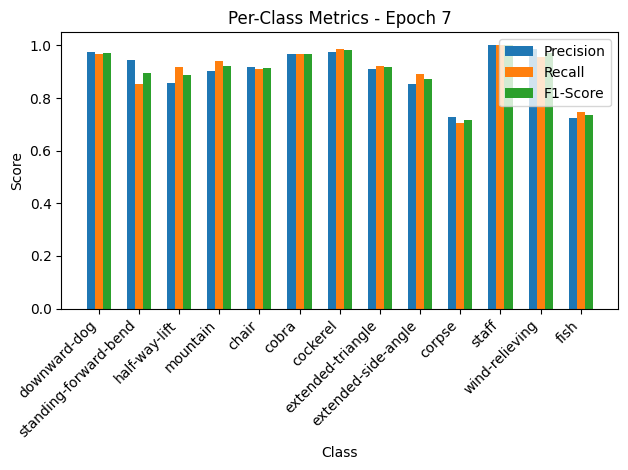

Validation: 100%|██████████| 10/10 [00:00<00:00, 24.05it/s, loss=0.246, accuracy=93.8]


Per-Class Metrics for Epoch 7:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.85, F1-Score=0.90
half-way-lift: Precision=0.86, Recall=0.92, F1-Score=0.89
mountain: Precision=0.90, Recall=0.94, F1-Score=0.92
chair: Precision=0.92, Recall=0.91, F1-Score=0.92
cobra: Precision=0.97, Recall=0.97, F1-Score=0.97
cockerel: Precision=0.98, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.91, Recall=0.92, F1-Score=0.92
extended-side-angle: Precision=0.86, Recall=0.89, F1-Score=0.87
corpse: Precision=0.73, Recall=0.71, F1-Score=0.72
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.98, Recall=0.96, F1-Score=0.97
fish: Precision=0.72, Recall=0.75, F1-Score=0.74


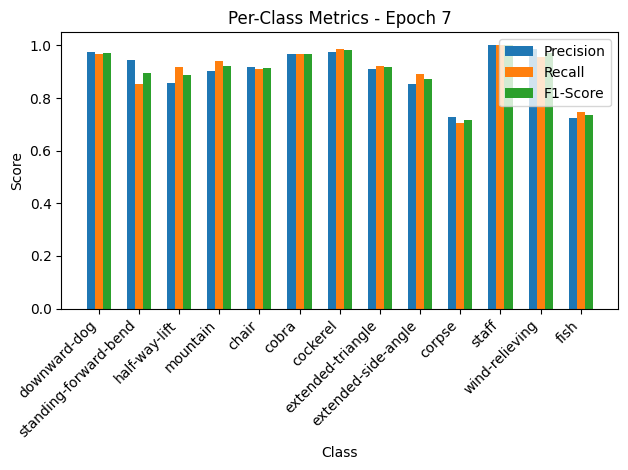


Epoch 8/50 Summary:
Train Loss: 0.2985 | Train Acc: 91.14% | Train Precision: 0.90 | Train Recall: 0.91 | Train F1: 0.90
Val Loss: 0.2701 | Val Acc: 93.84% | Val Precision: 0.95 | Val Recall: 0.96 | Val F1: 0.95
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_4.pth
Checkpoint saved at epoch 8
New best model saved! Validation Loss: 0.2701

Epoch 9/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.53it/s, loss=0.295, accuracy=92.6]


Per-Class Metrics for Epoch 8:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.90, F1-Score=0.92
half-way-lift: Precision=0.91, Recall=0.95, F1-Score=0.93
mountain: Precision=0.93, Recall=0.95, F1-Score=0.94
chair: Precision=0.90, Recall=0.92, F1-Score=0.91
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.93, Recall=0.95, F1-Score=0.94
extended-triangle: Precision=0.97, Recall=0.94, F1-Score=0.95
extended-side-angle: Precision=0.92, Recall=0.96, F1-Score=0.94
corpse: Precision=0.76, Recall=0.74, F1-Score=0.75
staff: Precision=0.93, Recall=0.97, F1-Score=0.95
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.75, Recall=0.78, F1-Score=0.76


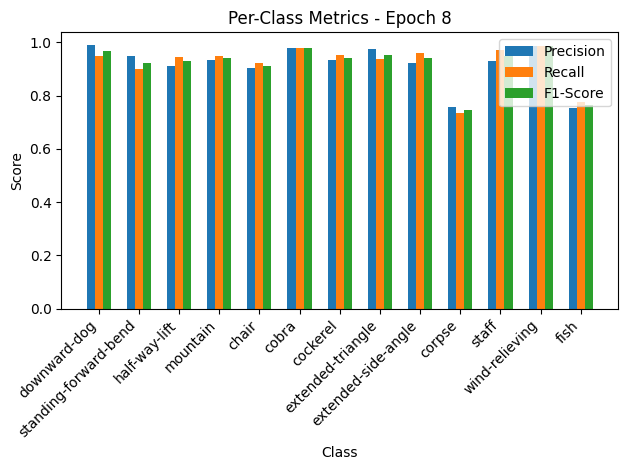

Validation: 100%|██████████| 10/10 [00:00<00:00, 29.27it/s, loss=0.273, accuracy=91.8]


Per-Class Metrics for Epoch 8:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.90, F1-Score=0.92
half-way-lift: Precision=0.91, Recall=0.95, F1-Score=0.93
mountain: Precision=0.93, Recall=0.95, F1-Score=0.94
chair: Precision=0.90, Recall=0.92, F1-Score=0.91
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.93, Recall=0.95, F1-Score=0.94
extended-triangle: Precision=0.97, Recall=0.94, F1-Score=0.95
extended-side-angle: Precision=0.92, Recall=0.96, F1-Score=0.94
corpse: Precision=0.76, Recall=0.74, F1-Score=0.75
staff: Precision=0.93, Recall=0.97, F1-Score=0.95
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.75, Recall=0.78, F1-Score=0.76


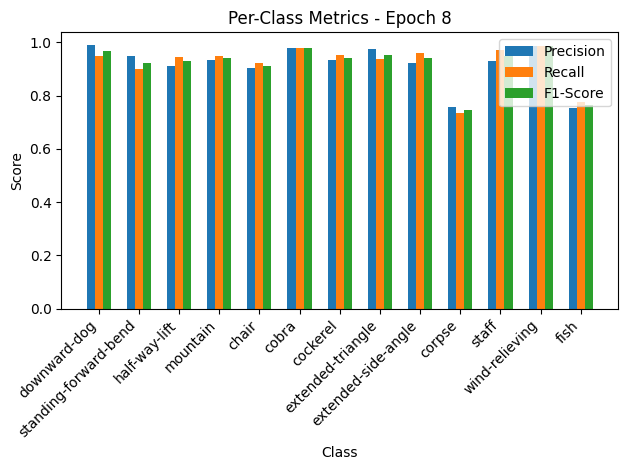


Epoch 9/50 Summary:
Train Loss: 0.2958 | Train Acc: 92.59% | Train Precision: 0.92 | Train Recall: 0.92 | Train F1: 0.92
Val Loss: 0.2996 | Val Acc: 91.78% | Val Precision: 0.93 | Val Recall: 0.92 | Val F1: 0.92

Epoch 10/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.25it/s, loss=0.278, accuracy=92.4]


Per-Class Metrics for Epoch 9:
downward-dog: Precision=0.97, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.96, Recall=0.87, F1-Score=0.91
half-way-lift: Precision=0.89, Recall=0.93, F1-Score=0.91
mountain: Precision=0.92, Recall=0.97, F1-Score=0.94
chair: Precision=0.96, Recall=0.95, F1-Score=0.96
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.94, Recall=0.97, F1-Score=0.95
extended-triangle: Precision=0.95, Recall=0.90, F1-Score=0.92
extended-side-angle: Precision=0.88, Recall=0.95, F1-Score=0.91
corpse: Precision=0.78, Recall=0.78, F1-Score=0.78
staff: Precision=0.97, Recall=0.99, F1-Score=0.98
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.77, Recall=0.76, F1-Score=0.77


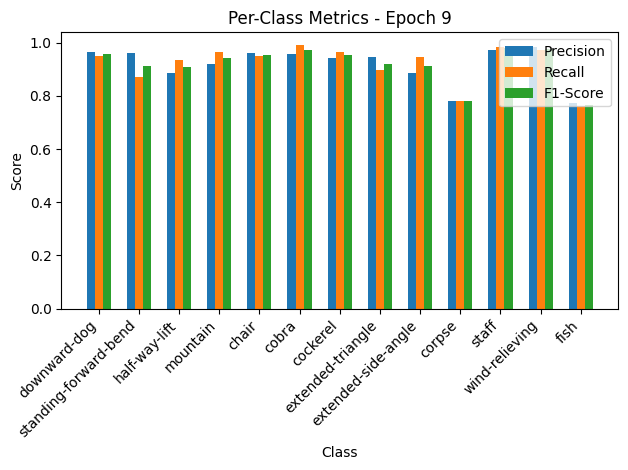

Validation: 100%|██████████| 10/10 [00:00<00:00, 24.93it/s, loss=0.216, accuracy=93.2]


Per-Class Metrics for Epoch 9:
downward-dog: Precision=0.97, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.96, Recall=0.87, F1-Score=0.91
half-way-lift: Precision=0.89, Recall=0.93, F1-Score=0.91
mountain: Precision=0.92, Recall=0.97, F1-Score=0.94
chair: Precision=0.96, Recall=0.95, F1-Score=0.96
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.94, Recall=0.97, F1-Score=0.95
extended-triangle: Precision=0.95, Recall=0.90, F1-Score=0.92
extended-side-angle: Precision=0.88, Recall=0.95, F1-Score=0.91
corpse: Precision=0.78, Recall=0.78, F1-Score=0.78
staff: Precision=0.97, Recall=0.99, F1-Score=0.98
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.77, Recall=0.76, F1-Score=0.77


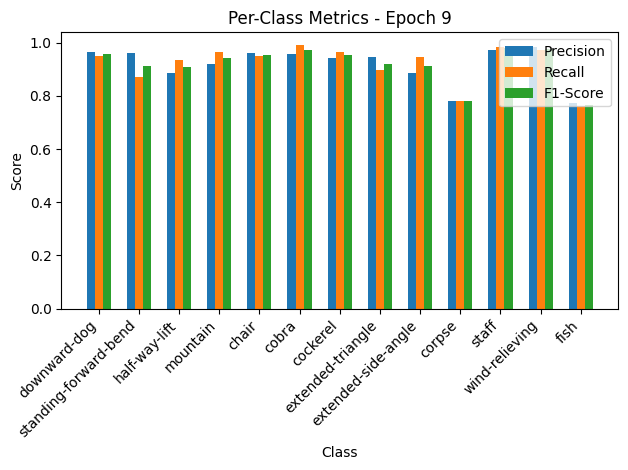


Epoch 10/50 Summary:
Train Loss: 0.2787 | Train Acc: 92.44% | Train Precision: 0.92 | Train Recall: 0.92 | Train F1: 0.92
Val Loss: 0.2368 | Val Acc: 93.15% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.94
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_4.pth
Checkpoint saved at epoch 10
New best model saved! Validation Loss: 0.2368

Epoch 11/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.22it/s, loss=0.249, accuracy=93.3]


Per-Class Metrics for Epoch 10:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.94, Recall=0.87, F1-Score=0.90
half-way-lift: Precision=0.89, Recall=0.92, F1-Score=0.90
mountain: Precision=0.92, Recall=0.97, F1-Score=0.95
chair: Precision=0.94, Recall=0.96, F1-Score=0.95
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.98, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=0.95, F1-Score=0.95
extended-side-angle: Precision=0.96, Recall=0.95, F1-Score=0.95
corpse: Precision=0.79, Recall=0.76, F1-Score=0.78
staff: Precision=0.94, Recall=1.00, F1-Score=0.97
wind-relieving: Precision=1.00, Recall=0.97, F1-Score=0.99
fish: Precision=0.78, Recall=0.79, F1-Score=0.79


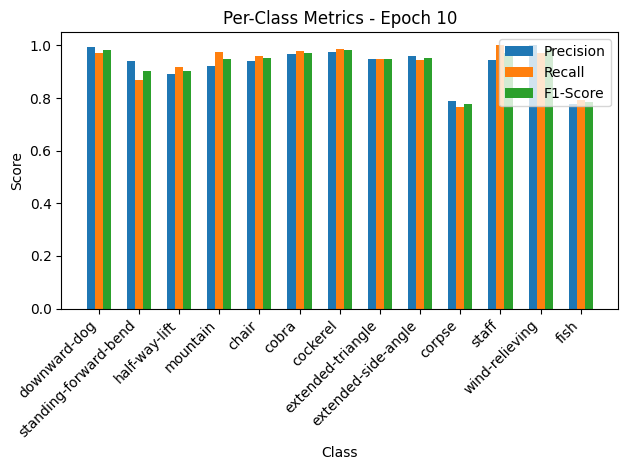

Validation: 100%|██████████| 10/10 [00:00<00:00, 25.57it/s, loss=0.186, accuracy=95.2]


Per-Class Metrics for Epoch 10:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.94, Recall=0.87, F1-Score=0.90
half-way-lift: Precision=0.89, Recall=0.92, F1-Score=0.90
mountain: Precision=0.92, Recall=0.97, F1-Score=0.95
chair: Precision=0.94, Recall=0.96, F1-Score=0.95
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.98, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=0.95, F1-Score=0.95
extended-side-angle: Precision=0.96, Recall=0.95, F1-Score=0.95
corpse: Precision=0.79, Recall=0.76, F1-Score=0.78
staff: Precision=0.94, Recall=1.00, F1-Score=0.97
wind-relieving: Precision=1.00, Recall=0.97, F1-Score=0.99
fish: Precision=0.78, Recall=0.79, F1-Score=0.79


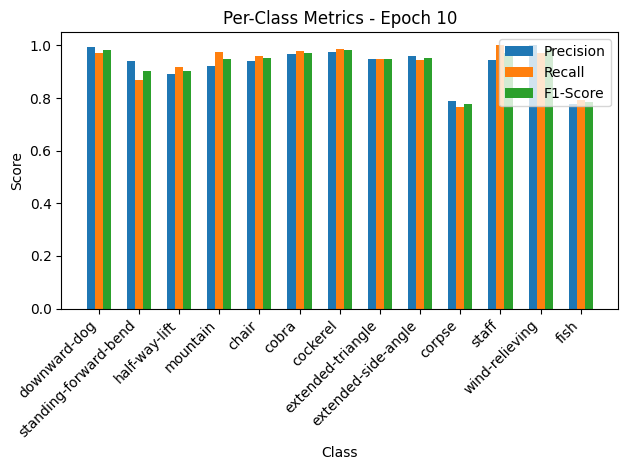


Epoch 11/50 Summary:
Train Loss: 0.2496 | Train Acc: 93.28% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.2038 | Val Acc: 95.21% | Val Precision: 0.96 | Val Recall: 0.95 | Val F1: 0.96
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_4.pth
Checkpoint saved at epoch 11
New best model saved! Validation Loss: 0.2038

Epoch 12/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.36it/s, loss=0.273, accuracy=91.9]


Per-Class Metrics for Epoch 11:
downward-dog: Precision=0.96, Recall=0.93, F1-Score=0.95
standing-forward-bend: Precision=0.95, Recall=0.86, F1-Score=0.90
half-way-lift: Precision=0.87, Recall=0.93, F1-Score=0.90
mountain: Precision=0.91, Recall=0.94, F1-Score=0.93
chair: Precision=0.91, Recall=0.93, F1-Score=0.92
cobra: Precision=0.96, Recall=0.97, F1-Score=0.96
cockerel: Precision=0.93, Recall=0.95, F1-Score=0.94
extended-triangle: Precision=0.90, Recall=0.95, F1-Score=0.93
extended-side-angle: Precision=0.94, Recall=0.89, F1-Score=0.92
corpse: Precision=0.84, Recall=0.82, F1-Score=0.83
staff: Precision=0.93, Recall=1.00, F1-Score=0.96
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.80, Recall=0.79, F1-Score=0.80


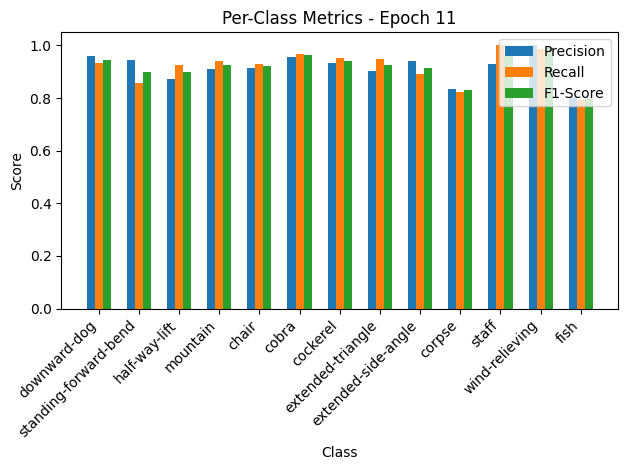

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.80it/s, loss=0.245, accuracy=91.1]


Per-Class Metrics for Epoch 11:
downward-dog: Precision=0.96, Recall=0.93, F1-Score=0.95
standing-forward-bend: Precision=0.95, Recall=0.86, F1-Score=0.90
half-way-lift: Precision=0.87, Recall=0.93, F1-Score=0.90
mountain: Precision=0.91, Recall=0.94, F1-Score=0.93
chair: Precision=0.91, Recall=0.93, F1-Score=0.92
cobra: Precision=0.96, Recall=0.97, F1-Score=0.96
cockerel: Precision=0.93, Recall=0.95, F1-Score=0.94
extended-triangle: Precision=0.90, Recall=0.95, F1-Score=0.93
extended-side-angle: Precision=0.94, Recall=0.89, F1-Score=0.92
corpse: Precision=0.84, Recall=0.82, F1-Score=0.83
staff: Precision=0.93, Recall=1.00, F1-Score=0.96
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.80, Recall=0.79, F1-Score=0.80


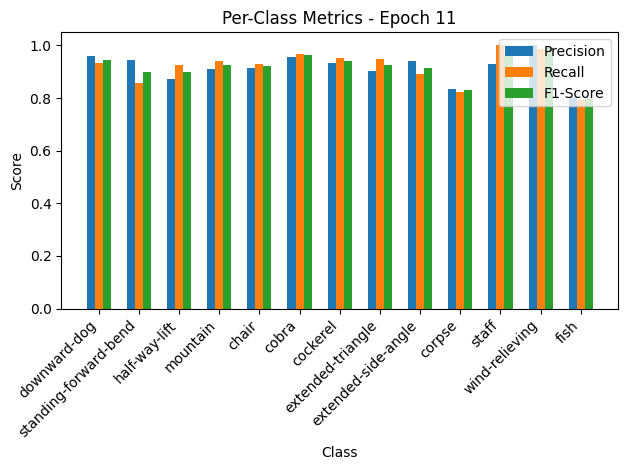


Epoch 12/50 Summary:
Train Loss: 0.2735 | Train Acc: 91.90% | Train Precision: 0.92 | Train Recall: 0.92 | Train F1: 0.92
Val Loss: 0.2680 | Val Acc: 91.10% | Val Precision: 0.93 | Val Recall: 0.91 | Val F1: 0.91

Epoch 13/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.08it/s, loss=0.271, accuracy=92.7]


Per-Class Metrics for Epoch 12:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.92, Recall=0.89, F1-Score=0.90
half-way-lift: Precision=0.90, Recall=0.90, F1-Score=0.90
mountain: Precision=0.92, Recall=0.95, F1-Score=0.93
chair: Precision=0.93, Recall=0.95, F1-Score=0.94
cobra: Precision=0.99, Recall=0.99, F1-Score=0.99
cockerel: Precision=0.91, Recall=1.00, F1-Score=0.96
extended-triangle: Precision=0.94, Recall=0.92, F1-Score=0.93
extended-side-angle: Precision=0.93, Recall=0.92, F1-Score=0.92
corpse: Precision=0.80, Recall=0.81, F1-Score=0.80
staff: Precision=0.96, Recall=0.99, F1-Score=0.97
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.82, Recall=0.79, F1-Score=0.80


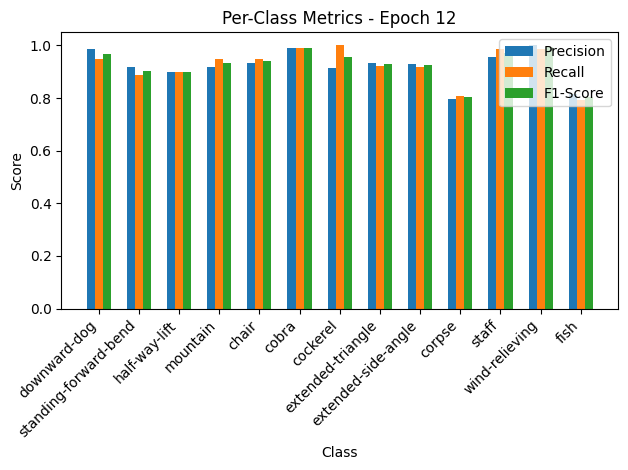

Validation: 100%|██████████| 10/10 [00:00<00:00, 26.87it/s, loss=0.347, accuracy=91.1]


Per-Class Metrics for Epoch 12:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.92, Recall=0.89, F1-Score=0.90
half-way-lift: Precision=0.90, Recall=0.90, F1-Score=0.90
mountain: Precision=0.92, Recall=0.95, F1-Score=0.93
chair: Precision=0.93, Recall=0.95, F1-Score=0.94
cobra: Precision=0.99, Recall=0.99, F1-Score=0.99
cockerel: Precision=0.91, Recall=1.00, F1-Score=0.96
extended-triangle: Precision=0.94, Recall=0.92, F1-Score=0.93
extended-side-angle: Precision=0.93, Recall=0.92, F1-Score=0.92
corpse: Precision=0.80, Recall=0.81, F1-Score=0.80
staff: Precision=0.96, Recall=0.99, F1-Score=0.97
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.82, Recall=0.79, F1-Score=0.80


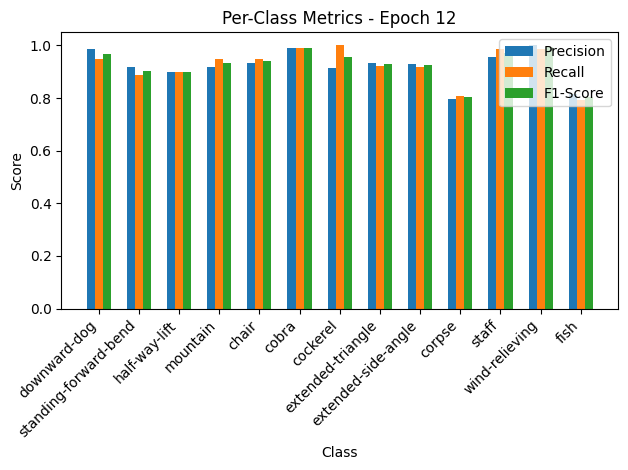


Epoch 13/50 Summary:
Train Loss: 0.2718 | Train Acc: 92.74% | Train Precision: 0.92 | Train Recall: 0.93 | Train F1: 0.92
Val Loss: 0.3807 | Val Acc: 91.10% | Val Precision: 0.93 | Val Recall: 0.89 | Val F1: 0.88

Epoch 14/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  6.98it/s, loss=0.258, accuracy=93.9]


Per-Class Metrics for Epoch 13:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.95, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.92, Recall=0.96, F1-Score=0.94
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.97, Recall=0.93, F1-Score=0.95
cobra: Precision=0.98, Recall=0.97, F1-Score=0.97
cockerel: Precision=0.95, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=0.94, Recall=0.92, F1-Score=0.93
extended-side-angle: Precision=0.91, Recall=0.92, F1-Score=0.91
corpse: Precision=0.82, Recall=0.82, F1-Score=0.82
staff: Precision=0.97, Recall=0.96, F1-Score=0.96
wind-relieving: Precision=0.96, Recall=0.99, F1-Score=0.97
fish: Precision=0.84, Recall=0.84, F1-Score=0.84


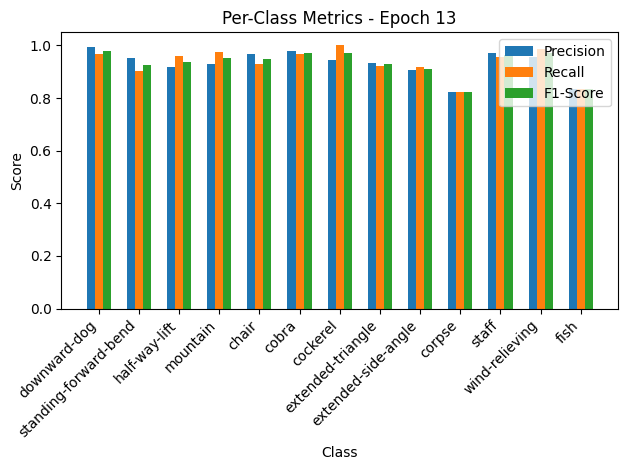

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.83it/s, loss=0.2, accuracy=96.6]


Per-Class Metrics for Epoch 13:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.95, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.92, Recall=0.96, F1-Score=0.94
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.97, Recall=0.93, F1-Score=0.95
cobra: Precision=0.98, Recall=0.97, F1-Score=0.97
cockerel: Precision=0.95, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=0.94, Recall=0.92, F1-Score=0.93
extended-side-angle: Precision=0.91, Recall=0.92, F1-Score=0.91
corpse: Precision=0.82, Recall=0.82, F1-Score=0.82
staff: Precision=0.97, Recall=0.96, F1-Score=0.96
wind-relieving: Precision=0.96, Recall=0.99, F1-Score=0.97
fish: Precision=0.84, Recall=0.84, F1-Score=0.84


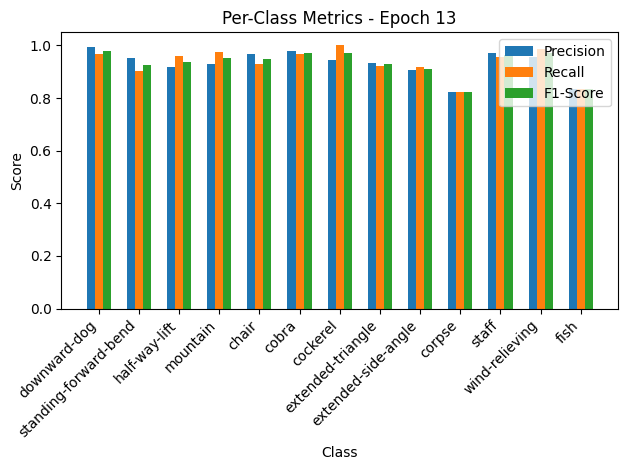


Epoch 14/50 Summary:
Train Loss: 0.2587 | Train Acc: 93.89% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.2188 | Val Acc: 96.58% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 15/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.20it/s, loss=0.24, accuracy=94.5]


Per-Class Metrics for Epoch 14:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.94, Recall=0.90, F1-Score=0.91
half-way-lift: Precision=0.89, Recall=0.94, F1-Score=0.92
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.98, Recall=0.94, F1-Score=0.96
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-triangle: Precision=0.97, Recall=0.94, F1-Score=0.95
extended-side-angle: Precision=0.92, Recall=0.97, F1-Score=0.95
corpse: Precision=0.84, Recall=0.90, F1-Score=0.87
staff: Precision=0.97, Recall=0.99, F1-Score=0.98
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.92, Recall=0.84, F1-Score=0.88


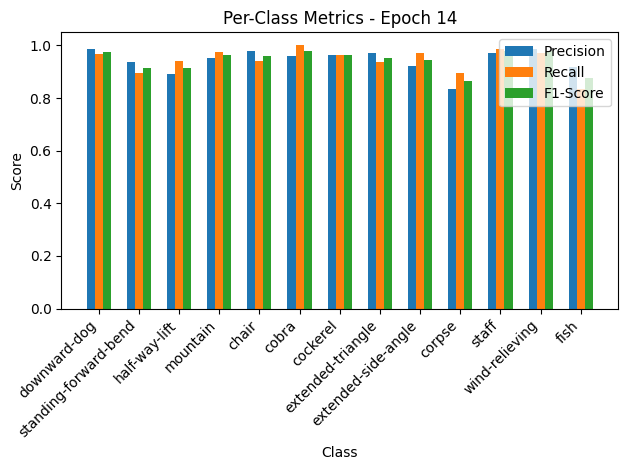

Validation: 100%|██████████| 10/10 [00:00<00:00, 19.32it/s, loss=0.203, accuracy=95.2]


Per-Class Metrics for Epoch 14:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.94, Recall=0.90, F1-Score=0.91
half-way-lift: Precision=0.89, Recall=0.94, F1-Score=0.92
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.98, Recall=0.94, F1-Score=0.96
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-triangle: Precision=0.97, Recall=0.94, F1-Score=0.95
extended-side-angle: Precision=0.92, Recall=0.97, F1-Score=0.95
corpse: Precision=0.84, Recall=0.90, F1-Score=0.87
staff: Precision=0.97, Recall=0.99, F1-Score=0.98
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.92, Recall=0.84, F1-Score=0.88


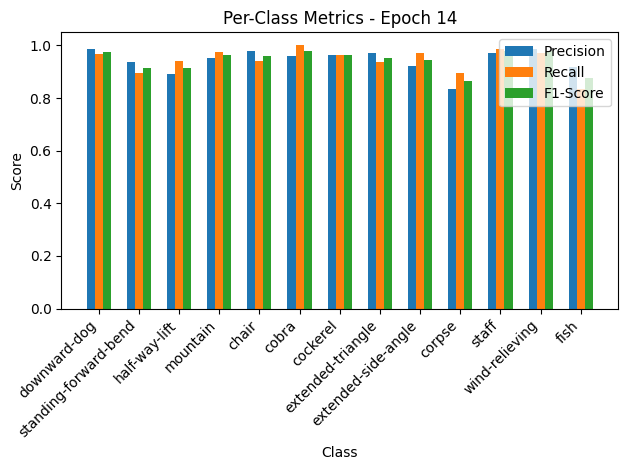


Epoch 15/50 Summary:
Train Loss: 0.2403 | Train Acc: 94.50% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.2230 | Val Acc: 95.21% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 16/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.28it/s, loss=0.228, accuracy=93.8]


Per-Class Metrics for Epoch 15:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.95, Recall=0.89, F1-Score=0.92
half-way-lift: Precision=0.90, Recall=0.95, F1-Score=0.92
mountain: Precision=0.93, Recall=0.95, F1-Score=0.94
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.94, Recall=0.95, F1-Score=0.94
extended-side-angle: Precision=0.94, Recall=0.93, F1-Score=0.94
corpse: Precision=0.81, Recall=0.81, F1-Score=0.81
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.81, Recall=0.81, F1-Score=0.81


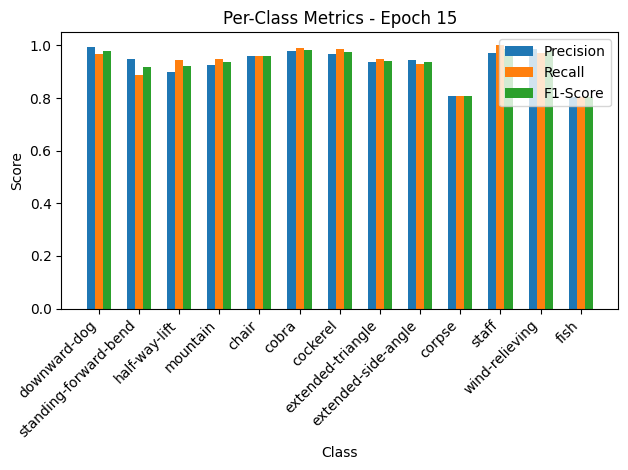

Validation: 100%|██████████| 10/10 [00:00<00:00, 24.25it/s, loss=0.21, accuracy=95.9]


Per-Class Metrics for Epoch 15:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.95, Recall=0.89, F1-Score=0.92
half-way-lift: Precision=0.90, Recall=0.95, F1-Score=0.92
mountain: Precision=0.93, Recall=0.95, F1-Score=0.94
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.94, Recall=0.95, F1-Score=0.94
extended-side-angle: Precision=0.94, Recall=0.93, F1-Score=0.94
corpse: Precision=0.81, Recall=0.81, F1-Score=0.81
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.81, Recall=0.81, F1-Score=0.81


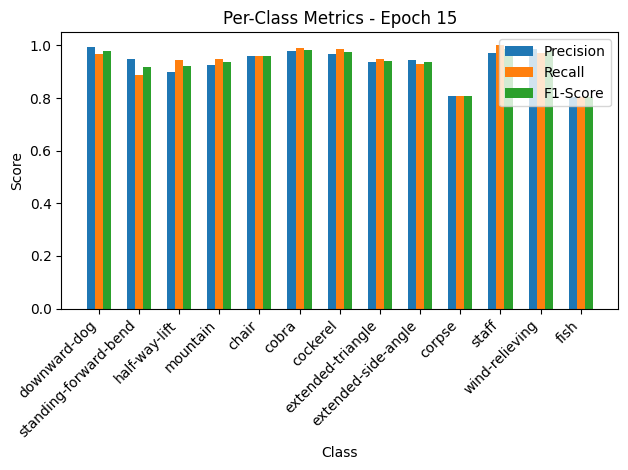


Epoch 16/50 Summary:
Train Loss: 0.2281 | Train Acc: 93.81% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.2302 | Val Acc: 95.89% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 17/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.44it/s, loss=0.232, accuracy=94]


Per-Class Metrics for Epoch 16:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.91, Recall=0.86, F1-Score=0.89
half-way-lift: Precision=0.88, Recall=0.88, F1-Score=0.88
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.93, Recall=0.96, F1-Score=0.95
cobra: Precision=0.95, Recall=1.00, F1-Score=0.97
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.96, Recall=0.92, F1-Score=0.94
extended-side-angle: Precision=0.92, Recall=0.97, F1-Score=0.95
corpse: Precision=0.90, Recall=0.91, F1-Score=0.91
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.92, Recall=0.88, F1-Score=0.90


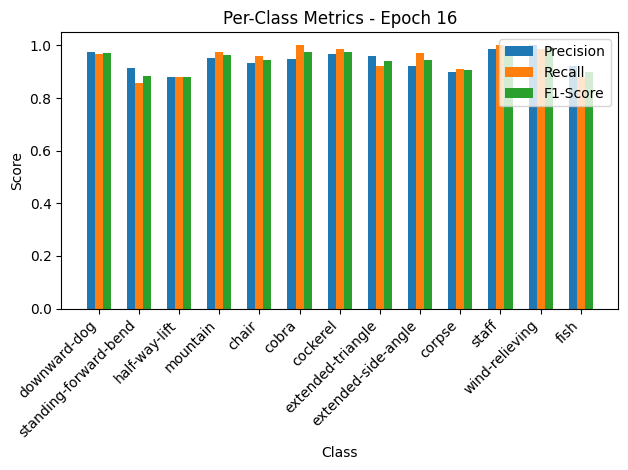

Validation: 100%|██████████| 10/10 [00:00<00:00, 25.64it/s, loss=0.198, accuracy=93.8]


Per-Class Metrics for Epoch 16:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.91, Recall=0.86, F1-Score=0.89
half-way-lift: Precision=0.88, Recall=0.88, F1-Score=0.88
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.93, Recall=0.96, F1-Score=0.95
cobra: Precision=0.95, Recall=1.00, F1-Score=0.97
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.96, Recall=0.92, F1-Score=0.94
extended-side-angle: Precision=0.92, Recall=0.97, F1-Score=0.95
corpse: Precision=0.90, Recall=0.91, F1-Score=0.91
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.92, Recall=0.88, F1-Score=0.90


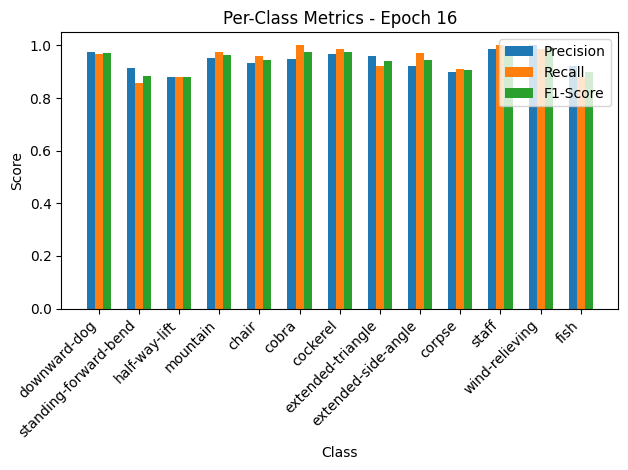


Epoch 17/50 Summary:
Train Loss: 0.2324 | Train Acc: 94.04% | Train Precision: 0.94 | Train Recall: 0.95 | Train F1: 0.94
Val Loss: 0.2165 | Val Acc: 93.84% | Val Precision: 0.96 | Val Recall: 0.95 | Val F1: 0.95

Epoch 18/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.27it/s, loss=0.158, accuracy=96]


Per-Class Metrics for Epoch 17:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.98, Recall=0.87, F1-Score=0.92
half-way-lift: Precision=0.88, Recall=0.97, F1-Score=0.93
mountain: Precision=0.92, Recall=0.98, F1-Score=0.95
chair: Precision=0.99, Recall=0.94, F1-Score=0.96
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.98, Recall=0.98, F1-Score=0.98
extended-triangle: Precision=0.96, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.97, Recall=0.96, F1-Score=0.97
corpse: Precision=0.94, Recall=0.96, F1-Score=0.95
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.95, Recall=0.94, F1-Score=0.95


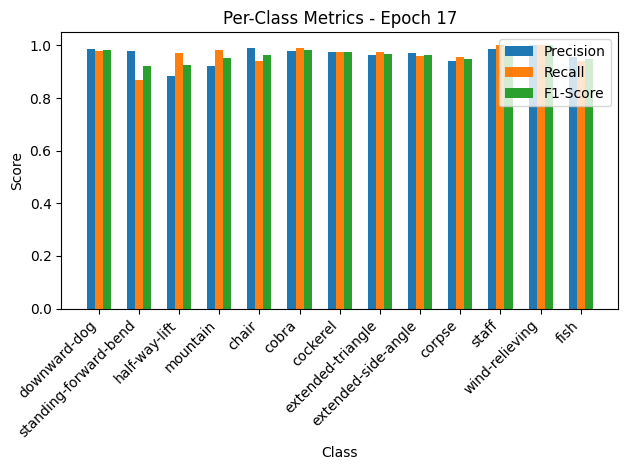

Validation: 100%|██████████| 10/10 [00:00<00:00, 26.47it/s, loss=0.112, accuracy=97.3]


Per-Class Metrics for Epoch 17:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.98, Recall=0.87, F1-Score=0.92
half-way-lift: Precision=0.88, Recall=0.97, F1-Score=0.93
mountain: Precision=0.92, Recall=0.98, F1-Score=0.95
chair: Precision=0.99, Recall=0.94, F1-Score=0.96
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.98, Recall=0.98, F1-Score=0.98
extended-triangle: Precision=0.96, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.97, Recall=0.96, F1-Score=0.97
corpse: Precision=0.94, Recall=0.96, F1-Score=0.95
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.95, Recall=0.94, F1-Score=0.95


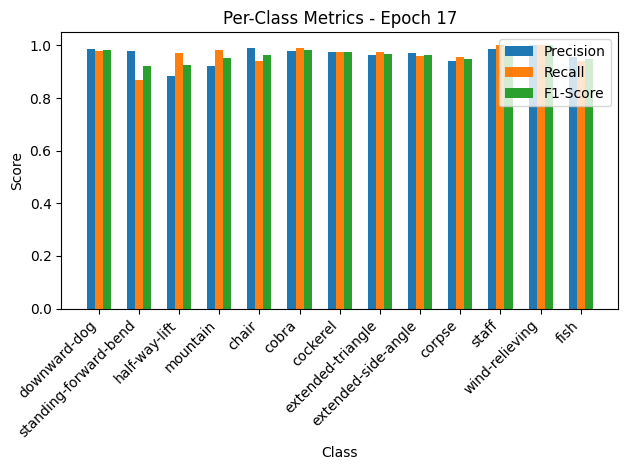


Epoch 18/50 Summary:
Train Loss: 0.1584 | Train Acc: 96.03% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.1223 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_4.pth
Checkpoint saved at epoch 18
New best model saved! Validation Loss: 0.1223

Epoch 19/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  6.88it/s, loss=0.123, accuracy=97.2]


Per-Class Metrics for Epoch 18:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.96, Recall=0.94, F1-Score=0.95
half-way-lift: Precision=0.94, Recall=0.96, F1-Score=0.95
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.99, Recall=0.94, F1-Score=0.96
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.95, Recall=0.91, F1-Score=0.93
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.91, Recall=0.96, F1-Score=0.93


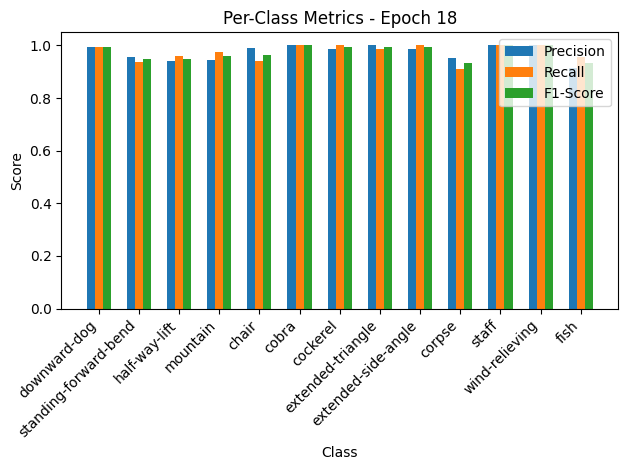

Validation: 100%|██████████| 10/10 [00:00<00:00, 26.13it/s, loss=0.113, accuracy=97.3]


Per-Class Metrics for Epoch 18:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.96, Recall=0.94, F1-Score=0.95
half-way-lift: Precision=0.94, Recall=0.96, F1-Score=0.95
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.99, Recall=0.94, F1-Score=0.96
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.95, Recall=0.91, F1-Score=0.93
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.91, Recall=0.96, F1-Score=0.93


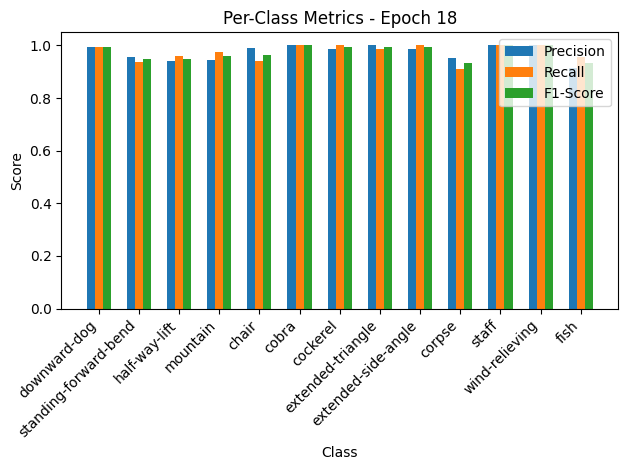


Epoch 19/50 Summary:
Train Loss: 0.1233 | Train Acc: 97.25% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.1239 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 20/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.39it/s, loss=0.12, accuracy=97.2]


Per-Class Metrics for Epoch 19:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.93, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.98, F1-Score=0.96
mountain: Precision=0.96, Recall=0.97, F1-Score=0.97
chair: Precision=0.98, Recall=0.98, F1-Score=0.98
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.93, Recall=0.93, F1-Score=0.93
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.91, Recall=0.93, F1-Score=0.92


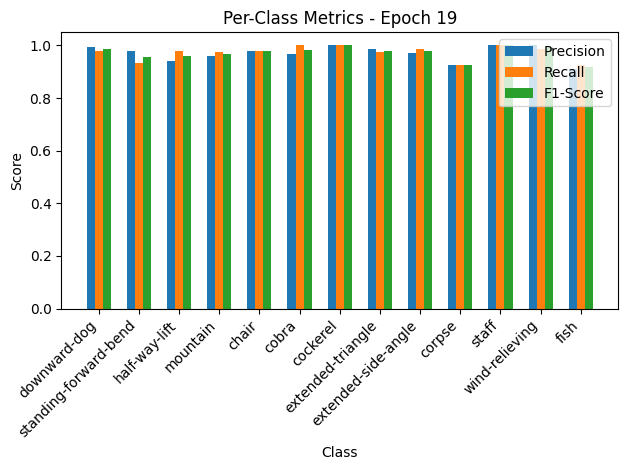

Validation: 100%|██████████| 10/10 [00:00<00:00, 26.87it/s, loss=0.105, accuracy=97.3]


Per-Class Metrics for Epoch 19:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.93, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.98, F1-Score=0.96
mountain: Precision=0.96, Recall=0.97, F1-Score=0.97
chair: Precision=0.98, Recall=0.98, F1-Score=0.98
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.93, Recall=0.93, F1-Score=0.93
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.91, Recall=0.93, F1-Score=0.92


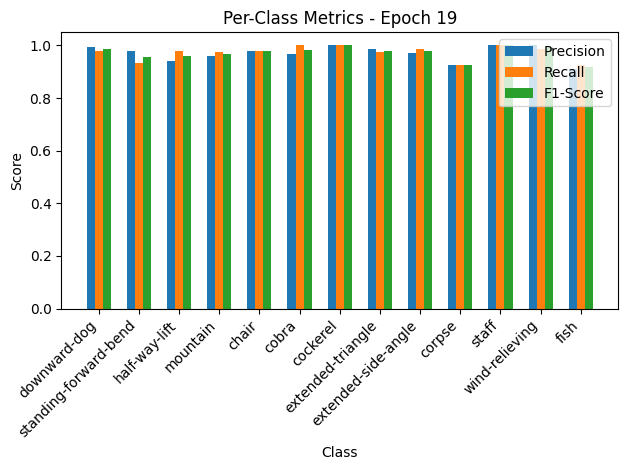


Epoch 20/50 Summary:
Train Loss: 0.1202 | Train Acc: 97.17% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.1146 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_4.pth
Checkpoint saved at epoch 20
New best model saved! Validation Loss: 0.1146

Epoch 21/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.77it/s, loss=0.108, accuracy=97.7]


Per-Class Metrics for Epoch 20:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.96, Recall=0.97, F1-Score=0.96
mountain: Precision=0.95, Recall=0.99, F1-Score=0.97
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.89, Recall=0.99, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.88, F1-Score=0.93


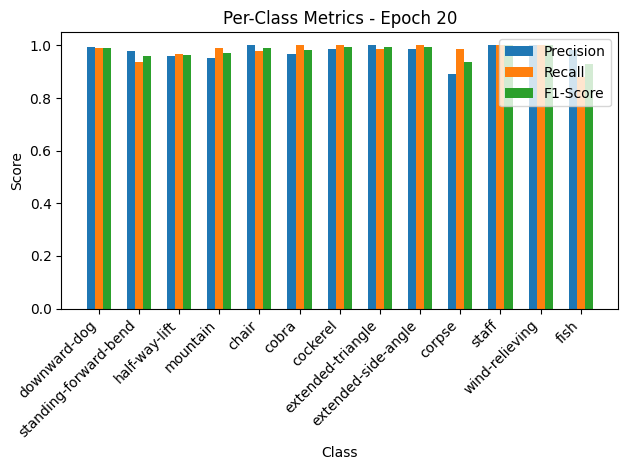

Validation: 100%|██████████| 10/10 [00:00<00:00, 21.40it/s, loss=0.101, accuracy=97.3]


Per-Class Metrics for Epoch 20:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.96, Recall=0.97, F1-Score=0.96
mountain: Precision=0.95, Recall=0.99, F1-Score=0.97
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.89, Recall=0.99, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.88, F1-Score=0.93


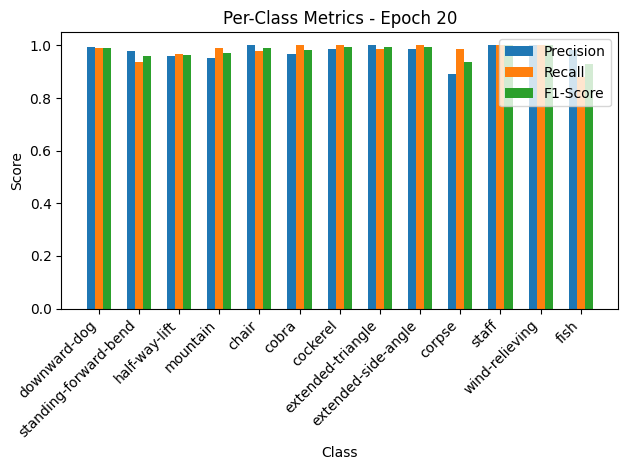


Epoch 21/50 Summary:
Train Loss: 0.1079 | Train Acc: 97.71% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1106 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_4.pth
Checkpoint saved at epoch 21
New best model saved! Validation Loss: 0.1106

Epoch 22/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:10<00:00,  7.67it/s, loss=0.103, accuracy=97.8]


Per-Class Metrics for Epoch 21:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.97, Recall=0.93, F1-Score=0.95
half-way-lift: Precision=0.94, Recall=0.97, F1-Score=0.96
mountain: Precision=0.96, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.93, Recall=0.94, F1-Score=0.93
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.93, F1-Score=0.93


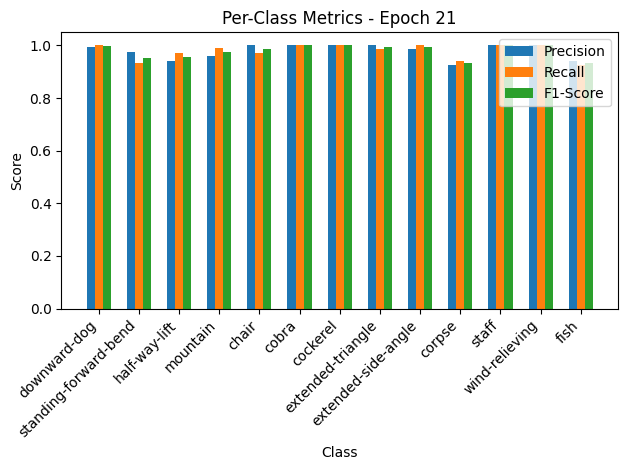

Validation: 100%|██████████| 10/10 [00:00<00:00, 22.28it/s, loss=0.101, accuracy=97.3]


Per-Class Metrics for Epoch 21:
downward-dog: Precision=0.99, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.97, Recall=0.93, F1-Score=0.95
half-way-lift: Precision=0.94, Recall=0.97, F1-Score=0.96
mountain: Precision=0.96, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.93, Recall=0.94, F1-Score=0.93
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.93, F1-Score=0.93


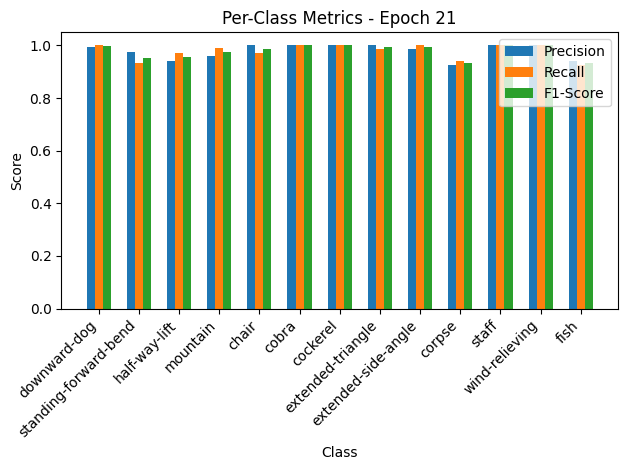


Epoch 22/50 Summary:
Train Loss: 0.1030 | Train Acc: 97.78% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1105 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_4.pth
Checkpoint saved at epoch 22
New best model saved! Validation Loss: 0.1105

Epoch 23/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.45it/s, loss=0.108, accuracy=97.8]


Per-Class Metrics for Epoch 22:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.97, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.95, Recall=0.97, F1-Score=0.96
mountain: Precision=0.96, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=0.99, Recall=0.98, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.92, Recall=0.99, F1-Score=0.95
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.90, F1-Score=0.94


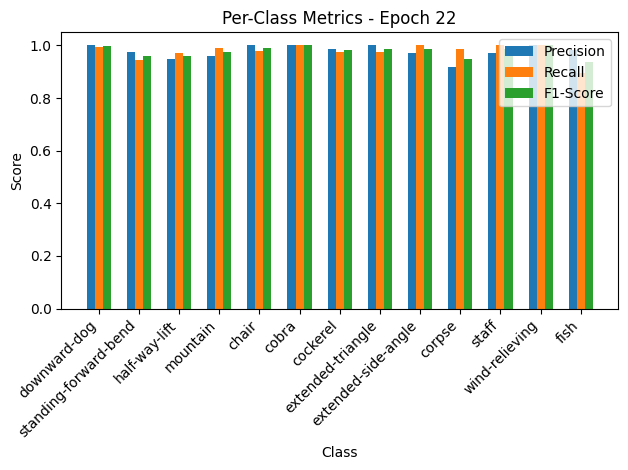

Validation: 100%|██████████| 10/10 [00:00<00:00, 28.27it/s, loss=0.103, accuracy=96.6]


Per-Class Metrics for Epoch 22:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.97, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.95, Recall=0.97, F1-Score=0.96
mountain: Precision=0.96, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=0.99, Recall=0.98, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.92, Recall=0.99, F1-Score=0.95
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.90, F1-Score=0.94


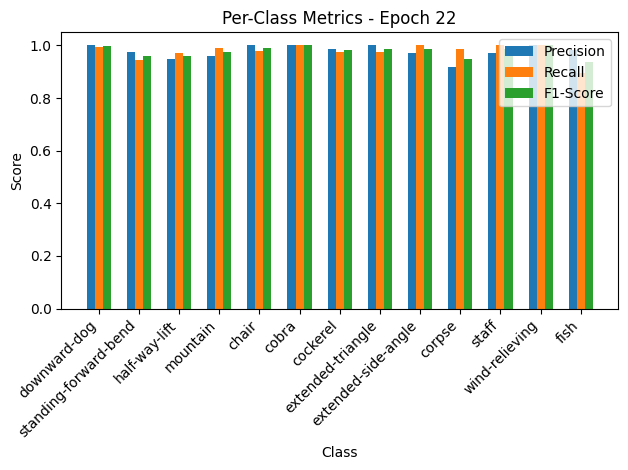


Epoch 23/50 Summary:
Train Loss: 0.1082 | Train Acc: 97.78% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1129 | Val Acc: 96.58% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 24/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  6.86it/s, loss=0.0979, accuracy=97.6]


Per-Class Metrics for Epoch 23:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.97, F1-Score=0.95
mountain: Precision=0.96, Recall=0.97, F1-Score=0.97
chair: Precision=0.97, Recall=0.96, F1-Score=0.97
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.94, F1-Score=0.94


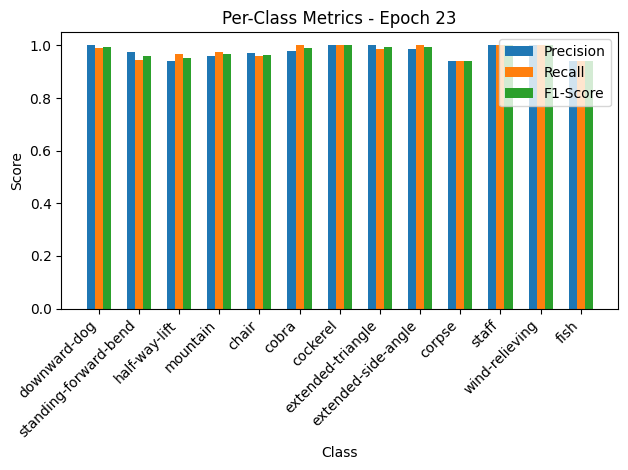

Validation: 100%|██████████| 10/10 [00:00<00:00, 26.07it/s, loss=0.11, accuracy=97.3]


Per-Class Metrics for Epoch 23:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.97, F1-Score=0.95
mountain: Precision=0.96, Recall=0.97, F1-Score=0.97
chair: Precision=0.97, Recall=0.96, F1-Score=0.97
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.94, F1-Score=0.94


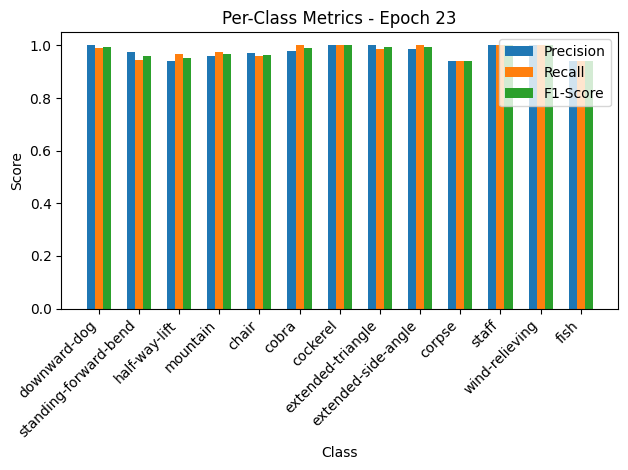


Epoch 24/50 Summary:
Train Loss: 0.0982 | Train Acc: 97.56% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1202 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 25/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:12<00:00,  6.54it/s, loss=0.104, accuracy=97.9]


Per-Class Metrics for Epoch 24:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.96, Recall=0.97, F1-Score=0.97
mountain: Precision=0.96, Recall=0.98, F1-Score=0.97
chair: Precision=0.98, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.93, Recall=0.99, F1-Score=0.96
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.93, F1-Score=0.95


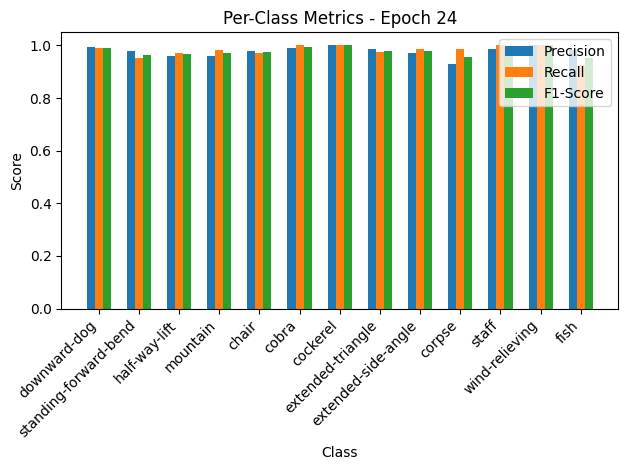

Validation: 100%|██████████| 10/10 [00:00<00:00, 26.43it/s, loss=0.1, accuracy=97.3]


Per-Class Metrics for Epoch 24:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.96, Recall=0.97, F1-Score=0.97
mountain: Precision=0.96, Recall=0.98, F1-Score=0.97
chair: Precision=0.98, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.93, Recall=0.99, F1-Score=0.96
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.93, F1-Score=0.95


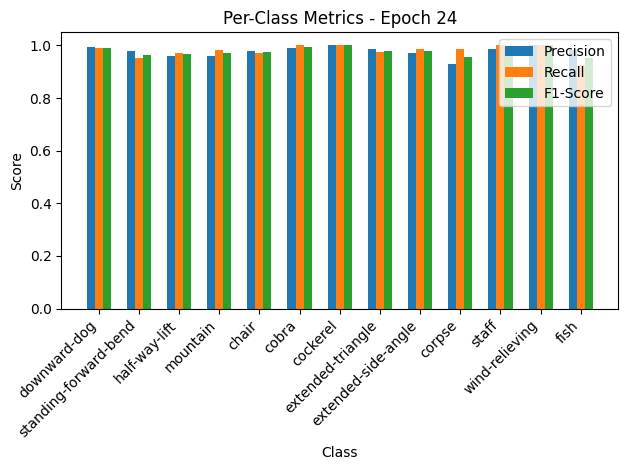


Epoch 25/50 Summary:
Train Loss: 0.1046 | Train Acc: 97.86% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1099 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98
/content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/STSAE_GCN_COMP/LOSS_FIXED_2025-02-27_B9_HC120_LR0.001_WD0.005_DATrue_VS0.1/best_model_fold_4.pth
Checkpoint saved at epoch 25
New best model saved! Validation Loss: 0.1099

Epoch 26/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:12<00:00,  6.68it/s, loss=0.0824, accuracy=98.2]


Per-Class Metrics for Epoch 25:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.97, F1-Score=0.97
mountain: Precision=0.95, Recall=0.98, F1-Score=0.97
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.96, Recall=0.99, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.96, F1-Score=0.97


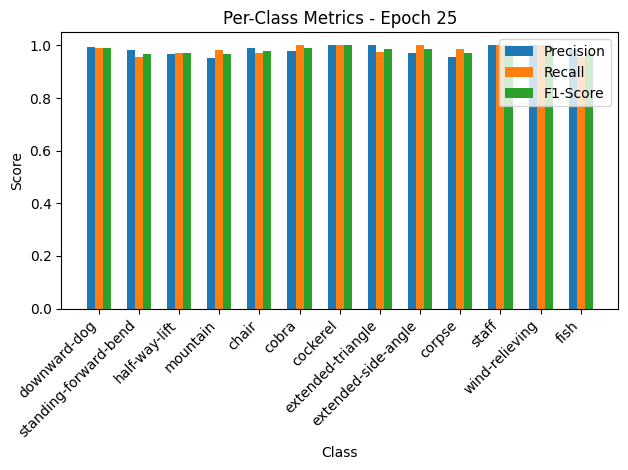

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.38it/s, loss=0.103, accuracy=97.3]


Per-Class Metrics for Epoch 25:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.97, F1-Score=0.97
mountain: Precision=0.95, Recall=0.98, F1-Score=0.97
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.96, Recall=0.99, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.96, F1-Score=0.97


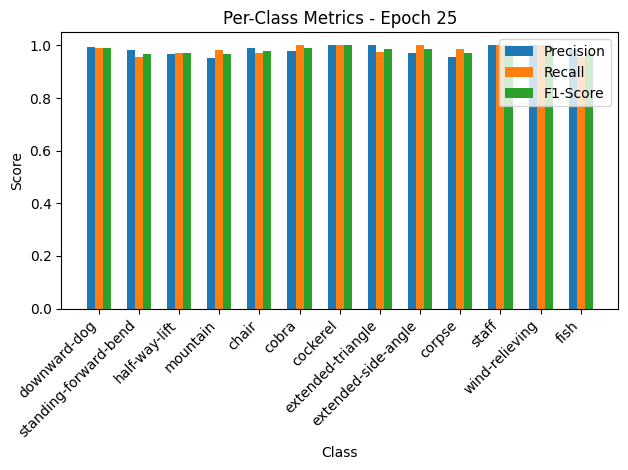


Epoch 26/50 Summary:
Train Loss: 0.0826 | Train Acc: 98.17% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1126 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 27/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.34it/s, loss=0.0999, accuracy=97.6]


Per-Class Metrics for Epoch 26:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.96, Recall=0.97, F1-Score=0.97
mountain: Precision=0.95, Recall=0.98, F1-Score=0.97
chair: Precision=0.97, Recall=0.96, F1-Score=0.97
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.94, Recall=0.96, F1-Score=0.95
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.95, Recall=0.94, F1-Score=0.95


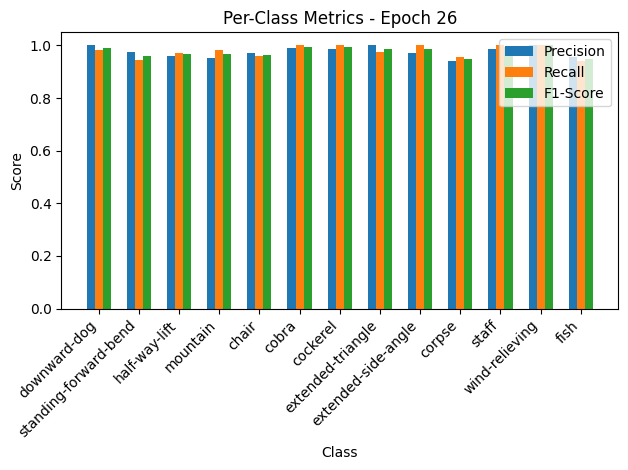

Validation: 100%|██████████| 10/10 [00:00<00:00, 26.94it/s, loss=0.101, accuracy=97.3]


Per-Class Metrics for Epoch 26:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.96, Recall=0.97, F1-Score=0.97
mountain: Precision=0.95, Recall=0.98, F1-Score=0.97
chair: Precision=0.97, Recall=0.96, F1-Score=0.97
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.94, Recall=0.96, F1-Score=0.95
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.95, Recall=0.94, F1-Score=0.95


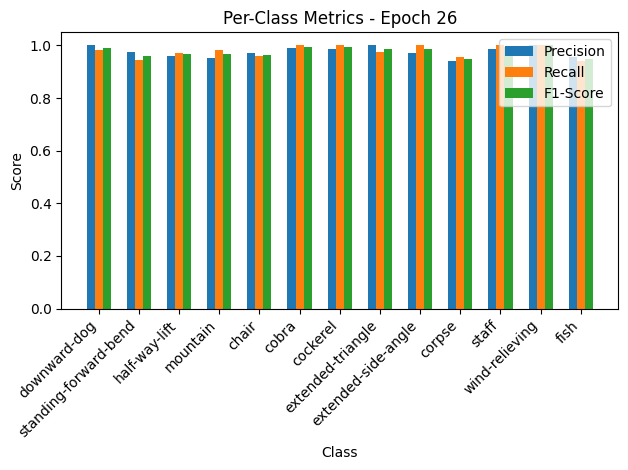


Epoch 27/50 Summary:
Train Loss: 0.1001 | Train Acc: 97.63% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1112 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 28/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:12<00:00,  6.78it/s, loss=0.0851, accuracy=97.7]


Per-Class Metrics for Epoch 27:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.96, Recall=0.94, F1-Score=0.95
half-way-lift: Precision=0.97, Recall=0.97, F1-Score=0.97
mountain: Precision=0.96, Recall=0.98, F1-Score=0.97
chair: Precision=0.98, Recall=0.98, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.93, Recall=0.97, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.93, F1-Score=0.95


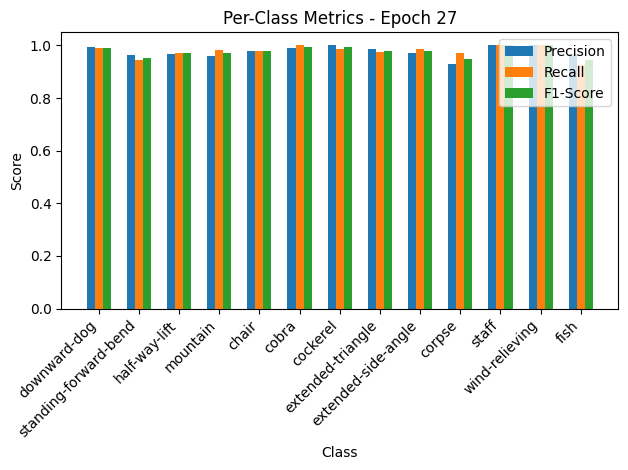

Validation: 100%|██████████| 10/10 [00:00<00:00, 24.79it/s, loss=0.105, accuracy=96.6]


Per-Class Metrics for Epoch 27:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.96, Recall=0.94, F1-Score=0.95
half-way-lift: Precision=0.97, Recall=0.97, F1-Score=0.97
mountain: Precision=0.96, Recall=0.98, F1-Score=0.97
chair: Precision=0.98, Recall=0.98, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.93, Recall=0.97, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.97, Recall=0.93, F1-Score=0.95


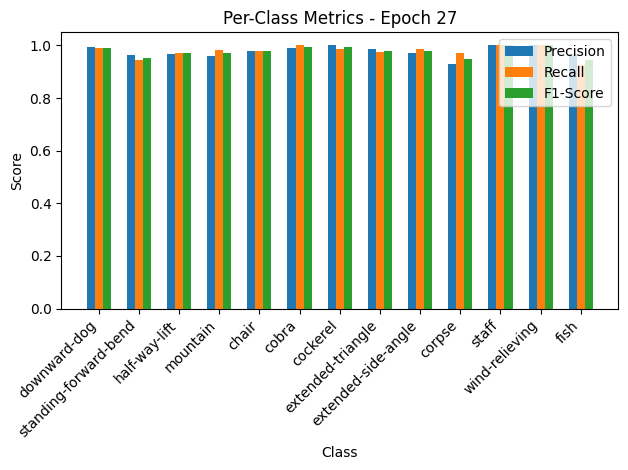


Epoch 28/50 Summary:
Train Loss: 0.0853 | Train Acc: 97.71% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1156 | Val Acc: 96.58% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 29/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.40it/s, loss=0.0917, accuracy=97.7]


Per-Class Metrics for Epoch 28:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.96, Recall=0.98, F1-Score=0.97
mountain: Precision=0.96, Recall=0.98, F1-Score=0.97
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.91, Recall=0.93, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.92, Recall=0.91, F1-Score=0.92


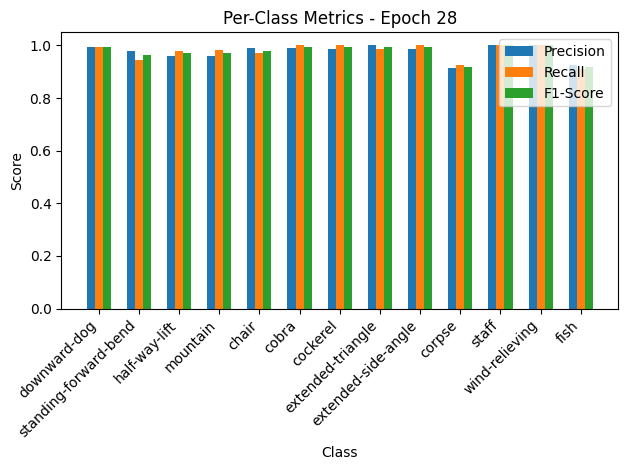

Validation: 100%|██████████| 10/10 [00:00<00:00, 19.08it/s, loss=0.111, accuracy=96.6]


Per-Class Metrics for Epoch 28:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.96, Recall=0.98, F1-Score=0.97
mountain: Precision=0.96, Recall=0.98, F1-Score=0.97
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.91, Recall=0.93, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.92, Recall=0.91, F1-Score=0.92


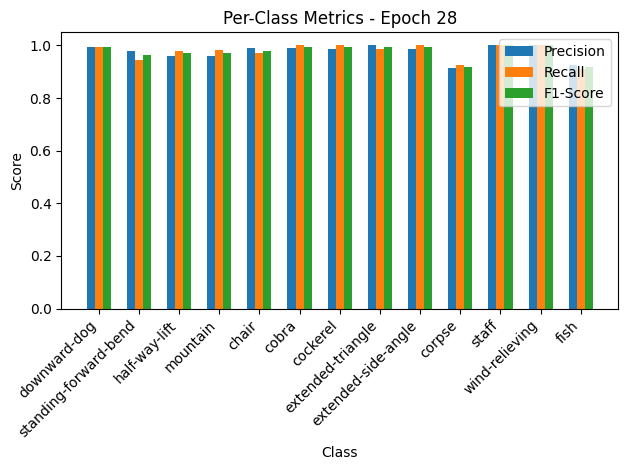


Epoch 29/50 Summary:
Train Loss: 0.0919 | Train Acc: 97.71% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1212 | Val Acc: 96.58% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 30/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.41it/s, loss=0.101, accuracy=97.6]


Per-Class Metrics for Epoch 29:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.96, Recall=0.99, F1-Score=0.97
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.98, Recall=0.95, F1-Score=0.96
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.90, Recall=0.97, F1-Score=0.94
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.97, Recall=0.90, F1-Score=0.93


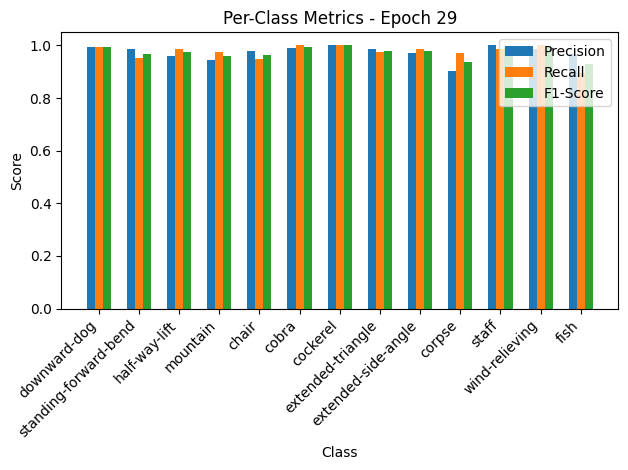

Validation: 100%|██████████| 10/10 [00:00<00:00, 25.68it/s, loss=0.115, accuracy=97.3]


Per-Class Metrics for Epoch 29:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.96, Recall=0.99, F1-Score=0.97
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.98, Recall=0.95, F1-Score=0.96
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.90, Recall=0.97, F1-Score=0.94
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.97, Recall=0.90, F1-Score=0.93


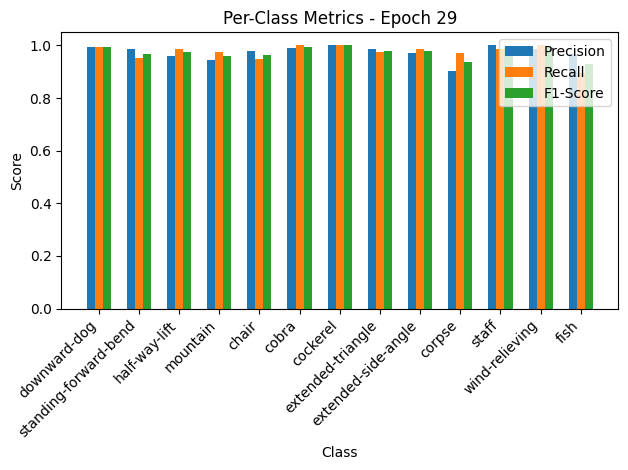


Epoch 30/50 Summary:
Train Loss: 0.1017 | Train Acc: 97.56% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.1256 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 31/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.05it/s, loss=0.0847, accuracy=98.2]


Per-Class Metrics for Epoch 30:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.98, F1-Score=0.98
mountain: Precision=0.96, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.93, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.97, F1-Score=0.95


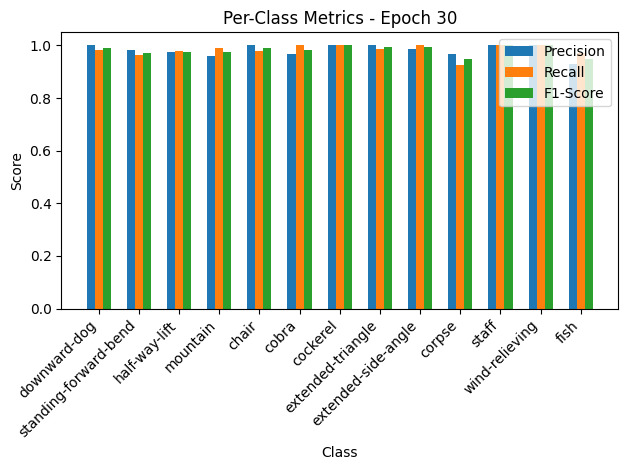

Validation: 100%|██████████| 10/10 [00:00<00:00, 25.00it/s, loss=0.118, accuracy=96.6]


Per-Class Metrics for Epoch 30:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.98, F1-Score=0.98
mountain: Precision=0.96, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.97, Recall=0.93, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.97, F1-Score=0.95


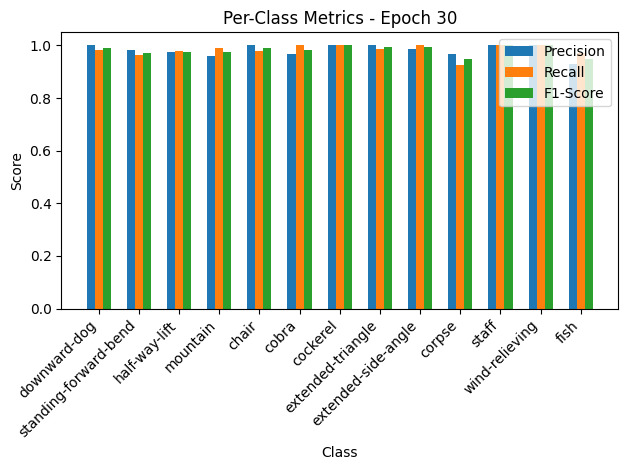


Epoch 31/50 Summary:
Train Loss: 0.0849 | Train Acc: 98.24% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1298 | Val Acc: 96.58% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 32/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:11<00:00,  6.98it/s, loss=0.0758, accuracy=98.5]


Per-Class Metrics for Epoch 31:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.98
mountain: Precision=0.96, Recall=1.00, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.93, Recall=1.00, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.93, F1-Score=0.96


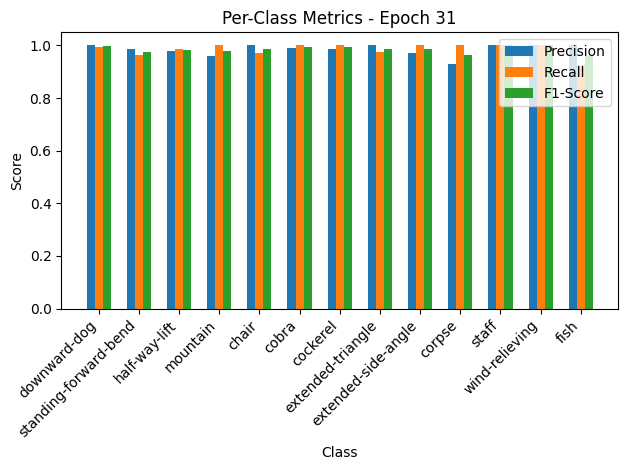

Validation: 100%|██████████| 10/10 [00:00<00:00, 28.20it/s, loss=0.117, accuracy=96.6]


Per-Class Metrics for Epoch 31:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.98
mountain: Precision=0.96, Recall=1.00, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.93, Recall=1.00, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.93, F1-Score=0.96


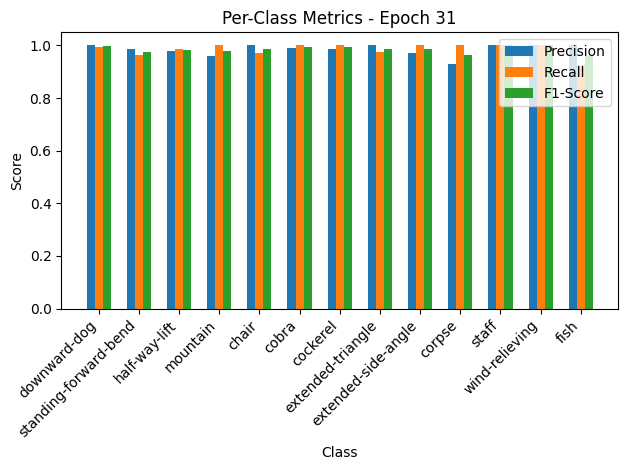


Epoch 32/50 Summary:
Train Loss: 0.0760 | Train Acc: 98.55% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1279 | Val Acc: 96.58% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 33/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:12<00:00,  6.70it/s, loss=0.0846, accuracy=98.5]


Per-Class Metrics for Epoch 32:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.96, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.92, Recall=1.00, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.91, F1-Score=0.95


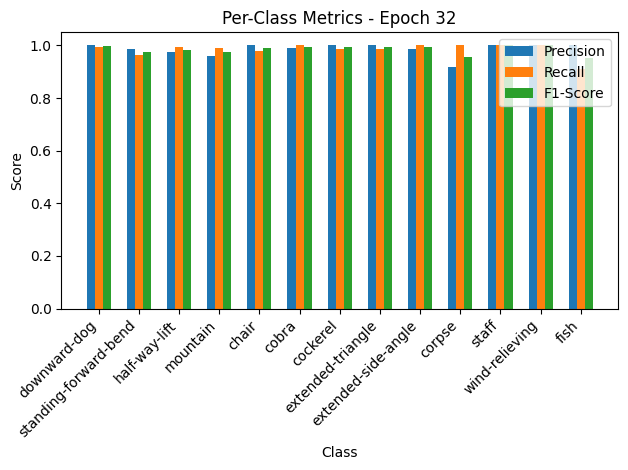

Validation: 100%|██████████| 10/10 [00:00<00:00, 26.85it/s, loss=0.107, accuracy=97.3]


Per-Class Metrics for Epoch 32:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.96, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.92, Recall=1.00, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.91, F1-Score=0.95


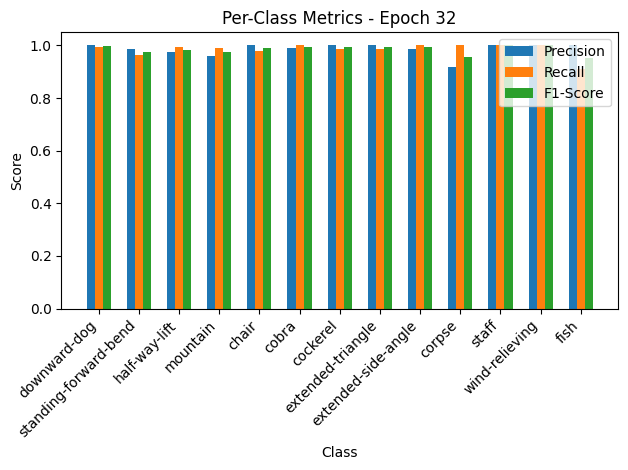


Epoch 33/50 Summary:
Train Loss: 0.0848 | Train Acc: 98.55% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1171 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 34/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:11<00:00,  6.96it/s, loss=0.0685, accuracy=98.7]


Per-Class Metrics for Epoch 33:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=1.00, F1-Score=0.98
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.93, Recall=0.99, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.93, F1-Score=0.95


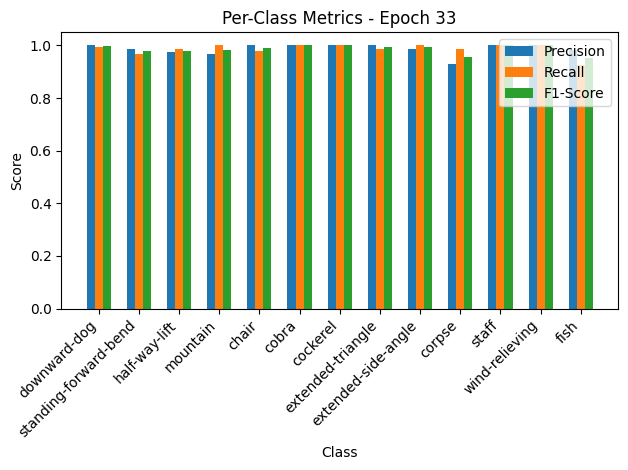

Validation: 100%|██████████| 10/10 [00:00<00:00, 26.09it/s, loss=0.109, accuracy=97.3]


Per-Class Metrics for Epoch 33:
downward-dog: Precision=1.00, Recall=0.99, F1-Score=1.00
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=1.00, F1-Score=0.98
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.93, Recall=0.99, F1-Score=0.96
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.93, F1-Score=0.95


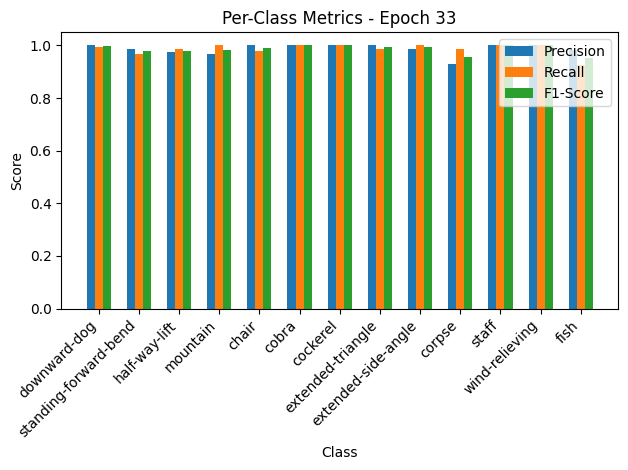


Epoch 34/50 Summary:
Train Loss: 0.0687 | Train Acc: 98.70% | Train Precision: 0.99 | Train Recall: 0.99 | Train F1: 0.99
Val Loss: 0.1199 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 35/50
Current Learning Rate: 1e-05


Training:  68%|██████▊   | 56/82 [00:08<00:04,  6.25it/s, loss=0.0699, accuracy=98.5]

In [ ]:
if __name__ == "__main__":
    main()

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
import seaborn as sns
import torch
import numpy as np
import os
from tqdm import tqdm
import csv

def find_sus(model, test_loader, criterion, class_names, spath=SAVE_PATH, fsave='confusion_matrix_all.png'):
    """
    Evaluate model on test set

    Args:
        model: PyTorch model
        test_loader: DataLoader for test data
        criterion: Loss function
        class_names: List of class names
        save_path: Directory to save the plot
        fsave: Filename for confusion matrix plot
    """
    csave = os.path.join(spath, fsave)
    sussave = os.path.join(spath, 'sus.csv')
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = model.to(device)
    model.eval()

    test_loss = 0.0
    test_correct = 0
    test_total = 0
    all_predictions = []
    all_labels = []
    misclassified_data = []

    # Create progress bar
    test_loader_tqdm = tqdm(test_loader, desc="Testing")

    with torch.no_grad():
        for batch_idx, (inputs, labels) in enumerate(test_loader_tqdm):
            inputs = inputs.to(device)
            labels = labels.to(device)
            # Forward pass
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            test_loss += loss.item() * inputs.size(0)

            # Get predictions
            _, predicted = torch.max(outputs, 1)
            # Calculate accuracy
            test_correct += (predicted == labels).sum().item()
            test_total += labels.size(0)

            # Store predictions and labels for confusion matrix
            all_predictions.extend(predicted.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())

            # Check if the sample is misclassified
            misclassified_indices = (predicted != labels).nonzero(as_tuple=True)[0]
            for misclassified_idx in misclassified_indices:
                global_idx = batch_idx * inputs.size(0) + misclassified_idx.item()
                sequence_id = test_loader.dataset.idx_to_seq[global_idx]
                correct_label = class_names[labels[misclassified_idx].item()]
                prediction = class_names[predicted[misclassified_idx].item()]
                misclassified_data.append([sequence_id, correct_label, prediction])

    # Calculate metrics
    test_loss = test_loss / len(test_loader.dataset)
    accuracy = 100 * test_correct / test_total

    # Create confusion matrix
    cm = confusion_matrix(all_labels, all_predictions)

    # Plot confusion matrix
    plt.figure(figsize=(10, 8))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=pose_list, yticklabels=pose_list)
    plt.title('Confusion Matrix')
    plt.xlabel('Predicted')
    plt.ylabel('True')

    # Save the plot
    plt.savefig(csave)
    plt.show()
    plt.close()

    # Save misclassified data to CSV
    with open(sussave, mode='w', newline='') as file:
        writer = csv.writer(file)
        writer.writerow(['sequence_id', 'correct_label', 'prediction'])
        writer.writerows(misclassified_data)

    print(f'Test Loss: {test_loss:.4f}')
    print(f'Test Accuracy: {accuracy:.2f}%')

    return test_loss, accuracy

In [ ]:
dataset = Yoga3DDataset(read_meta_data())
label_to_pose = {v:k for k,v in dataset.pose_to_label.items()}

model = STSAE_GCN(3, HIDDEN_CHANNELS, NUM_CLASSES, 20, NUM_BLOCKS)
# criterion = nn.CrossEntropyLoss()
all_labels = [dataset[i][1] for i in range(len(dataset))]
criterion = create_weighted_criterion(
        all_labels,
        num_classes= NUM_CLASSES,
        strategy='inverse'  # Try different strategies
    )
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

checkpoint_path = os.path.join(SAVE_PATH, 'best_model.pth')
# Plot the training curves
if checkpoint_path and os.path.exists(checkpoint_path):
        model, optimizer, start_epoch, history = load_checkpoint(
            model, optimizer, checkpoint_path
        )
        print(f"Resuming training from epoch {start_epoch}")
loader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=False)
# plot_training_curves(history)
find_sus(model, loader, criterion, label_to_pose)

In [ ]:
dataset = Yoga3DDataset(read_meta_data())
label_to_pose = {v:k for k,v in dataset.pose_to_label.items()}

model = STSAE_GCN(3, HIDDEN_CHANNELS, NUM_CLASSES, 20, NUM_BLOCKS)
# criterion = nn.CrossEntropyLoss()
all_labels = [dataset[i][1] for i in range(len(dataset))]
dataset, train_dataset, test_dataset = prepare_dataset()
criterion = create_weighted_criterion(
        all_labels,
        num_classes= NUM_CLASSES,
        strategy='effective_samples'  # Try different strategies
    )
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

checkpoint_path = os.path.join(SAVE_PATH, 'best_model.pth')
# Plot the training curves
if checkpoint_path and os.path.exists(checkpoint_path):
        model, optimizer, start_epoch, history = load_checkpoint(
            model, optimizer, checkpoint_path
        )
        print(f"Resuming training from epoch {start_epoch}")
loader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)
evaluate_model(model, test_loader, criterion, pose_list, fsave= 'outward_confusion_matrix.png')
evaluate_model_normalized(model, test_loader, criterion, pose_list, fsave= 'outward_normalized_confusion_matrix.png')